## Understand the business scenario and problem

The HR department at Salifort Motors wants to take some initiatives to improve employee satisfaction levels at the company. They collected data from employees, but now they don’t know what to do with it. They refer to you as a data analytics professional and ask you to provide data-driven suggestions based on your understanding of the data. They have the following question: what’s likely to make the employee leave the company?

Your goals in this project are to analyze the data collected by the HR department and to build a model that predicts whether or not an employee will leave the company.

If you can predict employees likely to quit, it might be possible to identify factors that contribute to their leaving. Because it is time-consuming and expensive to find, interview, and hire new employees, increasing employee retention will be beneficial to the company.

### Familiarize with the HR dataset

|Variable  |Description |
|-----|-----|
|satisfaction_level|Employee-reported job satisfaction level [0&ndash;1]|
|last_evaluation|Score of employee's last performance review [0&ndash;1]|
|number_project|Number of projects employee contributes to|
|average_monthly_hours|Average number of hours employee worked per month|
|time_spend_company|How long the employee has been with the company (years)|
|Work_accident|Whether or not the employee experienced an accident while at work|
|left|Whether or not the employee left the company|
|promotion_last_5years|Whether or not the employee was promoted in the last 5 years|
|Department|The employee's department|
|salary|The employee's salary (U.S. dollars)|


>Who are your stakeholders for this project?

* HR department at Salifort Motors
* Employees who works at Salifort Motors
* Managers/Leaders of each department
* Salifort’s senior leadership team
* Data team

>What are you trying to solve or accomplish?

* Identify factors that likely to make the employee leave the company
* Build a model that predicts whether or not an employee will leave the company
* Come up with ideas for how to increase employee retention and job satisfaction

>What are your initial observations when you explore the data?

* This dataset didn't have columns that could distinguish employees who quit(Not company let them go)
* `left` would be the target variable for this project if we use classcification model, limitation is `left` include employees who quit and company let them go.
* `satisfaction_level` could be the target variable, limitation is in some case employees will leave even they are satisfacied, in some case employees will not leave even they are very dissatisfacied, besides that some groups may prefer to give high score and some give low score.
* The above description of dataset in this lab is different from the data dictionary(e.g. salary is string in data dictionary but looks float/integer in the lab description)
* Some features like `salary`, `Work_accident` and so on might associated with the reason, feature like `satisfaction_level` may could help us make prediction but doesn't look like a reason.
* `number_project` might be difficult to compare since projects have different scale and difficulity.
* No value description about `Work_accident`, `left`, `promotion_last_5years`(what did 0 and 1 mean)
* calculation of average_monthly_hours is unknown

>What resources do you find yourself using as you complete this stage? (Make sure to include the links.)
* [9 Causes of High Employee Turnover and How To Prevent It](https://www.indeed.com/career-advice/career-development/high-employee-turnover)

    * What causes high employee turnover?
        * Overwork
        * Inconsistent management styles
        * Lack of team member recognition
        * Few opportunities for professional development
        * Little to no career advancement
        * Low salaries and low pay raises
        * Inadequate benefits
        * Poor company culture
        * Incompatibilities between team members and management
* [12 common causes of employee turnover](https://business.talkspace.com/articles/12-common-causes-of-employee-turnover)
    * Lack of growth opportunities
    * Inadequate compensation and benefits
    * Poor management and leadership
    * Unhealthy work-life balance
    * Lack of recognition and appreciation
    * Unengaging work environment
    * Mismatched job roles
    * Limited flexibility
    * Inadequate training and development
    * Toxic work environment
    * Lack of transparent communication
    * Boredom and monotony
* [Employee turnover: Causes, cost and how to prevent it](https://www.qualtrics.com/experience-management/employee/employee-turnover/)
    * The 6 types of employee turnover
        * Voluntary employee turnover
        * Involuntary employee turnover
        * Retirement
        * Internal transfer
        * Functional employee turnover
        * Dysfunctional employee turnover
    * The cost of employee turnover rate
        * The financial costs
            * 1,500 dollors for hourly employees
            * 100 to 150% of a salary for an employee in a technical position
            * Up to 213% of a C-suite employee’s salary
            * Recruitment costs of new hires
            * Employee onboarding costs
            * Training costs
            * Decreased productivity
        * The human costs
            * Less engagement
            * Loss of institutional knowledge and thought leadership
            * A culture of fear
            * Cultural impact
        * The brand costs
            * Dip in customer service and rookie errors
            * Decreased quality
            * Disgruntled employees
            * A high new hire turnover rate 

            
>Do you have any ethical considerations in this stage?

* How to distinguish employees who quit their job from employees the company let them go.
* How did they conduct survey?
* Is this dataset representative?
* What will the HR department do if we predict someone will leave? Will they take measures to prevent employee from leaving or using the prediction result to evaluate the performance of an employee?
* Will they use the 'factors' to make employees leaving by themselves instead of following the rule/law(e.g. provide packages)
* Assume the HR only take measures to prevent employee from leaving and the prediction will not affect the employee performance evaluation and other employee performance evaluations as well as their career, if we predict someone will leave but they actually won't leave, the company may spend money and time.  If we predict someone will not leave but they actually will leave, since the company won't take any measures, the employee will leave and the company will spend time and money to hire new employee.

## Imports

*   Import packages
*   Load dataset



### Import packages

In [1]:
# Import packages
import numpy as np
import pandas as pd

import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.model_selection import PredefinedSplit
from sklearn.ensemble import RandomForestClassifier

from xgboost import XGBClassifier
from xgboost import plot_importance

from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import plot_tree

from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score,f1_score, make_scorer, fbeta_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import roc_curve, roc_auc_score

import pickle
import math

import statsmodels.api as sm
from scipy import stats
from sklearn import preprocessing


#test
from scipy.stats import kruskal, friedmanchisquare
from scipy.stats import ks_2samp
from scipy.stats import levene
from scipy.stats import mannwhitneyu
from statsmodels.stats.proportion import proportions_ztest

In [2]:
pd.set_option('display.max_columns', None)

input_file_path='/kaggle/input/hr-analytics-and-job-prediction/'

import warnings
warnings.filterwarnings('ignore')

### Load dataset

**DataFrame Used in this Lab**

* df0: the original dataset, only changed column names
* df_drop: deleted duplicated rows in df0

In [3]:
# Load dataset into a dataframe
# dataset from Google Advanced Data Analytics Certificate by Coursera
#df0 = pd.read_csv("HR_capstone_dataset.csv")
# you can also found this dataset in https://www.kaggle.com/datasets/mfaisalqureshi/hr-analytics-and-job-prediction
df0 = pd.read_csv(input_file_path+"HR_comma_sep.csv")

# Display first few rows of the dataframe
df0.head(10)

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,Work_accident,left,promotion_last_5years,Department,salary
0,0.38,0.53,2,157,3,0,1,0,sales,low
1,0.80,0.86,5,262,6,0,1,0,sales,medium
2,0.11,0.88,7,272,4,0,1,0,sales,medium
3,0.72,0.87,5,223,5,0,1,0,sales,low
4,0.37,0.52,2,159,3,0,1,0,sales,low
5,0.41,0.50,2,153,3,0,1,0,sales,low
6,0.10,0.77,6,247,4,0,1,0,sales,low
7,0.92,0.85,5,259,5,0,1,0,sales,low
8,0.89,1.00,5,224,5,0,1,0,sales,low
9,0.42,0.53,2,142,3,0,1,0,sales,low


## Data Exploration (Initial EDA and data cleaning)

- Understand your variables
- Clean your dataset (missing data, redundant data, outliers)



In [4]:
# Gather basic information about the data
df0.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14999 entries, 0 to 14998
Data columns (total 10 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   satisfaction_level     14999 non-null  float64
 1   last_evaluation        14999 non-null  float64
 2   number_project         14999 non-null  int64  
 3   average_montly_hours   14999 non-null  int64  
 4   time_spend_company     14999 non-null  int64  
 5   Work_accident          14999 non-null  int64  
 6   left                   14999 non-null  int64  
 7   promotion_last_5years  14999 non-null  int64  
 8   Department             14999 non-null  object 
 9   salary                 14999 non-null  object 
dtypes: float64(2), int64(6), object(2)
memory usage: 1.1+ MB


In [5]:
# Gather descriptive statistics about the data
df0.describe()
#average_montly_hours ranged 96 hours-310 hours, it might indicate different employment type

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,Work_accident,left,promotion_last_5years
count,14999.000000,14999.000000,14999.000000,14999.000000,14999.000000,14999.000000,14999.000000,14999.000000
mean,0.612834,0.716102,3.803054,201.050337,3.498233,0.144610,0.238083,0.021268
std,0.248631,0.171169,1.232592,49.943099,1.460136,0.351719,0.425924,0.144281
min,0.090000,0.360000,2.000000,96.000000,2.000000,0.000000,0.000000,0.000000
25%,0.440000,0.560000,3.000000,156.000000,3.000000,0.000000,0.000000,0.000000
50%,0.640000,0.720000,4.000000,200.000000,3.000000,0.000000,0.000000,0.000000
75%,0.820000,0.870000,5.000000,245.000000,4.000000,0.000000,0.000000,0.000000
max,1.000000,1.000000,7.000000,310.000000,10.000000,1.000000,1.000000,1.000000


### Rename columns

In [6]:
# Display all column names
df0.columns

Index(['satisfaction_level', 'last_evaluation', 'number_project',
       'average_montly_hours', 'time_spend_company', 'Work_accident', 'left',
       'promotion_last_5years', 'Department', 'salary'],
      dtype='object')

In [7]:
# Rename columns as needed
df0.columns=['satisfaction_level', 'last_evaluation', 'number_project',
       'average_monthly_hours', 'time_spend_company', 'work_accident', 'left',
       'promotion_last_5years', 'department', 'salary']

# Display all column names after the update
df0.columns

Index(['satisfaction_level', 'last_evaluation', 'number_project',
       'average_monthly_hours', 'time_spend_company', 'work_accident', 'left',
       'promotion_last_5years', 'department', 'salary'],
      dtype='object')

### Check missing values

In [8]:
# Check for missing values

print(f"missing rows: {df0.isna().any(axis=1).sum()}")

missing rows: 0


### Check duplicates

In [9]:
# Check for duplicates
df0.duplicated().sum()

3008

In [10]:
# Inspect some rows containing duplicates as needed
df0[df0.duplicated()].head()

,satisfaction_level,last_evaluation,number_project,average_monthly_hours,time_spend_company,work_accident,left,promotion_last_5years,department,salary
396,0.46,0.57,2,139,3,0,1,0,sales,low
866,0.41,0.46,2,128,3,0,1,0,accounting,low
1317,0.37,0.51,2,127,3,0,1,0,sales,medium
1368,0.41,0.52,2,132,3,0,1,0,RandD,low
1461,0.42,0.53,2,142,3,0,1,0,sales,low


In [11]:
df0[df0.duplicated()]['left'].value_counts()

left
1    1580
0    1428
Name: count, dtype: int64

In [12]:
# Drop duplicates and save resulting dataframe in a new variable as needed
df_drop=df0.drop_duplicates()
print(f'Row count: {df_drop.shape[0]}')

# Display first few rows of new dataframe as needed
df_drop.head()

Row count: 11991


,satisfaction_level,last_evaluation,number_project,average_monthly_hours,time_spend_company,work_accident,left,promotion_last_5years,department,salary
0,0.38,0.53,2,157,3,0,1,0,sales,low
1,0.80,0.86,5,262,6,0,1,0,sales,medium
2,0.11,0.88,7,272,4,0,1,0,sales,medium
3,0.72,0.87,5,223,5,0,1,0,sales,low
4,0.37,0.52,2,159,3,0,1,0,sales,low


In [13]:
df_drop.describe()

,satisfaction_level,last_evaluation,number_project,average_monthly_hours,time_spend_company,work_accident,left,promotion_last_5years
count,11991.000000,11991.000000,11991.000000,11991.000000,11991.000000,11991.000000,11991.000000,11991.000000
mean,0.629658,0.716683,3.802852,200.473522,3.364857,0.154282,0.166041,0.016929
std,0.241070,0.168343,1.163238,48.727813,1.330240,0.361234,0.372133,0.129012
min,0.090000,0.360000,2.000000,96.000000,2.000000,0.000000,0.000000,0.000000
25%,0.480000,0.570000,3.000000,157.000000,3.000000,0.000000,0.000000,0.000000
50%,0.660000,0.720000,4.000000,200.000000,3.000000,0.000000,0.000000,0.000000
75%,0.820000,0.860000,5.000000,243.000000,4.000000,0.000000,0.000000,0.000000
max,1.000000,1.000000,7.000000,310.000000,10.000000,1.000000,1.000000,1.000000


### Validate data

In [14]:
def check_incomplete(chk_data,full_set,chk_item_name:str):
    """
        Check if a variable contains all values described in the dictionary
        Input:
            chk_data: Series
            full_set: Set(all possible values)
            chk_item_name: string, variable/column name
        Return:
            None
    """
    diff_result=full_set.symmetric_difference(chk_data)
    if len(diff_result)==0:
        print(f'Check {chk_item_name}: No difference between dataset value and dictionary')
    else:
        print(f"Check {chk_item_name}: There's difference between dataset value and dictionary {diff_result}")

def check_missing_in_range(chk_data,full_set,chk_item_name:str):
    """
        Check if a variable contains all values within a range
        Input:
            chk_data: Series
            full_set: Set(all possible values within a range)
            chk_item_name: string, variable/column name
        Return:
            None
    """
    diff_result=full_set.symmetric_difference(chk_data)
    if len(diff_result)==0:
        print(f'Check {chk_item_name}: Contains all values within the range')
    else:
        print(f"Check {chk_item_name}: There're missing values not in the range {diff_result}")


### Check outliers

In [15]:
#********************************#
#check time_spend_company 
#********************************#
#check time_spend_company value incomplete
time_spend_company_set=set(range(df_drop['time_spend_company'].min(),df_drop['time_spend_company'].max()+1))
check_missing_in_range(df_drop['time_spend_company'],time_spend_company_set,'time_spend_company')
#==>No employees who stayed 9 years

#********************************#
#check number_project 
#********************************#
#check number_project value incomplete
time_spend_company_set=set(range(df_drop['number_project'].min(),df_drop['number_project'].max()+1))
check_missing_in_range(df_drop['number_project'],time_spend_company_set,'number_project')
#==>no diff

#********************************#
#check salary 
#********************************#
#check salary value incomplete
salary_set={'low','medium','high'}
check_incomplete(df_drop['salary'],salary_set,'salary')
#==>no diff

#********************************#
#check work_accident 
#********************************#
#check work_accident value incomplete
accident_set={0,1}
check_incomplete(df_drop['work_accident'],accident_set,'work_accident')
#==>no diff

#********************************#
#check promotion_last_5years 
#********************************#
#check promotion_last_5years value incomplete
promotion_set={0,1}
check_incomplete(df_drop['promotion_last_5years'],promotion_set,'promotion_last_5years')
#==>no diff

#********************************#
#check left 
#********************************#
#check promotion_last_5years value incomplete
left_set={0,1}
check_incomplete(df_drop['left'],left_set,'left')
#==>no diff

#display department
df_drop['department'].unique()

Check time_spend_company: There're missing values not in the range {9}
Check number_project: Contains all values within the range
Check salary: No difference between dataset value and dictionary
Check work_accident: No difference between dataset value and dictionary
Check promotion_last_5years: No difference between dataset value and dictionary
Check left: No difference between dataset value and dictionary


array(['sales', 'accounting', 'hr', 'technical', 'support', 'management',
       'IT', 'product_mng', 'marketing', 'RandD'], dtype=object)

Check for outliers in the data.

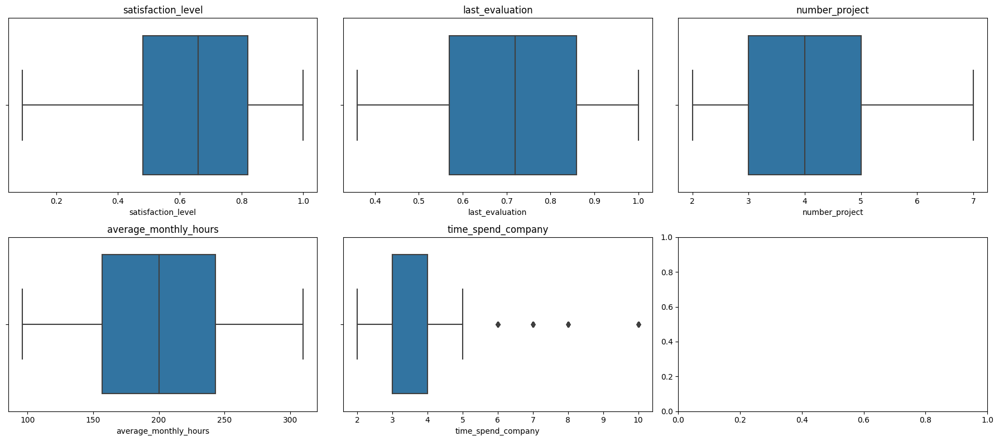

In [16]:
# Create a boxplot to visualize distribution of bellowing features and detect any outliers
chk_columns=['satisfaction_level', 'last_evaluation', 'number_project',
       'average_monthly_hours', 'time_spend_company']

rowCnt=math.ceil(len(chk_columns)/3)

fig, axes=plt.subplots(rowCnt,3,figsize=(18,rowCnt*4))
for col,ax in zip(chk_columns, axes.ravel()):
    sns.boxplot(data=df_drop, x=col, ax=ax)
    ax.set_title(col)

plt.tight_layout()
plt.show()
#=>time_spend_company had outliers

In [17]:
###################################################
# Determine the number of rows containing outliers
###################################################
# IQR
Q1 = np.percentile(df_drop['time_spend_company'], 25)
Q3 = np.percentile(df_drop['time_spend_company'], 75)
IQR = Q3 - Q1

# Above Upper bound
upper = Q3+1.5*IQR
upper_array = np.array(df_drop['time_spend_company'] >= upper)
print("Upper Bound:", upper)
print(upper_array.sum())

# Below Lower bound
lower = Q1-1.5*IQR
lower_array = np.array(df_drop['time_spend_company'] <= lower)
print("Lower Bound:", lower)
print(lower_array.sum())

#df_drop[df_drop['time_spend_company']>5]

Upper Bound: 5.5
824
Lower Bound: 1.5
0


### Encode Data

In [18]:
###########################################
#Encode salary
###########################################
# Create categorical designations
salary_order = ['low', 'medium', 'high']
# Encode `df_drop` column as categoricals 
df_drop['salary'] = pd.Categorical(df_drop['salary'], categories=salary_order, ordered=True)

df_drop['salary_encoding']=df_drop['salary'].cat.codes

In [19]:
###################################################
#create a column to store full time or part time
###################################################
def compute_emp_type(average_monthly_hours):
    """
        Assume average_monthly_hours <= 160 part time
        Assume average_monthly_hours > 160 full time
    """
    if average_monthly_hours <=160:
        result='part time'
    else:
        result='full time'
    return result

df_drop['emp_type']=df_drop['average_monthly_hours'].apply(compute_emp_type)
df_drop[['average_monthly_hours','emp_type']].info()
df_drop[['average_monthly_hours','emp_type']].head()

<class 'pandas.core.frame.DataFrame'>
Index: 11991 entries, 0 to 11999
Data columns (total 2 columns):
 #   Column                 Non-Null Count  Dtype 
---  ------                 --------------  ----- 
 0   average_monthly_hours  11991 non-null  int64 
 1   emp_type               11991 non-null  object
dtypes: int64(1), object(1)
memory usage: 281.0+ KB


,average_monthly_hours,emp_type
0,157,part time
1,262,full time
2,272,full time
3,223,full time
4,159,part time


In [20]:
def evaluation_range(last_evaluation):
    if (0<=last_evaluation)&(last_evaluation<=0.2):
        result='[0,0.2]'
    elif (0.2<=last_evaluation)&(last_evaluation<=0.4):
        result='(0.2,0.4]'
    elif (0.4<=last_evaluation)&(last_evaluation<=0.6):
        result='(0.4,0.6]'
    elif (0.6<=last_evaluation)&(last_evaluation<=0.8):
        result='(0.6,0.8]'
    elif (0.8<=last_evaluation)&(last_evaluation<=1):
        result='(0.8,1]'
    else:
        result=None
    return result

df_drop['evaluation_range']=df_drop['last_evaluation'].apply(evaluation_range)

# Create categorical designations
evaluation_range_order = ['[0,0.2]', '(0.2,0.4]', '(0.4,0.6]', '(0.6,0.8]', '(0.8,1]']
# Encode `evaluation_range` column as categoricals 
df_drop['evaluation_range'] = pd.Categorical(df_drop['evaluation_range'], categories=evaluation_range_order, ordered=True)

df_drop[['last_evaluation','evaluation_range']].info()

<class 'pandas.core.frame.DataFrame'>
Index: 11991 entries, 0 to 11999
Data columns (total 2 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   last_evaluation   11991 non-null  float64 
 1   evaluation_range  11991 non-null  category
dtypes: category(1), float64(1)
memory usage: 199.3 KB


In [21]:
def average_monthly_hours_range(average_monthly_hours):
    if (0<=average_monthly_hours)&(average_monthly_hours<=125):
        result='[0,125]'
    elif (125<average_monthly_hours)&(average_monthly_hours<=160):
        result='(125,160]'
    elif (160<average_monthly_hours)&(average_monthly_hours<=200):
        result='(160,200]'
    elif (200<average_monthly_hours)&(average_monthly_hours<=240):
        result='(200,240]'
    elif (240<average_monthly_hours)&(average_monthly_hours<=280):
        result='(240,280]'
    else:
        result='(280,inf)'
    return result

df_drop['average_monthly_hours_range']=df_drop['average_monthly_hours'].apply(average_monthly_hours_range)

# Create categorical designations
average_monthly_hours_range_order = ['[0,125]', '(125,160]', '(160,200]', '(200,240]', '(240,280]','(280,inf)']
# Encode `average_monthly_hours_range` column as categoricals 
df_drop['average_monthly_hours_range'] = pd.Categorical(df_drop['average_monthly_hours_range'], categories=average_monthly_hours_range_order, ordered=True)

df_drop[['average_monthly_hours','average_monthly_hours_range']].info()

<class 'pandas.core.frame.DataFrame'>
Index: 11991 entries, 0 to 11999
Data columns (total 2 columns):
 #   Column                       Non-Null Count  Dtype   
---  ------                       --------------  -----   
 0   average_monthly_hours        11991 non-null  int64   
 1   average_monthly_hours_range  11991 non-null  category
dtypes: category(1), int64(1)
memory usage: 199.3 KB


In [22]:
def compute_time_spend_company_range(time_spend_company):
    if (0<=time_spend_company)&(time_spend_company<2):
        result='<2'
    elif time_spend_company==2:
        result='2'
    elif time_spend_company==3:
        result='3'
    elif time_spend_company==4:
        result='4'
    elif time_spend_company==5:
        result='5'
    else:
        result='>=6'
    return result

df_drop['time_spend_company_range']=df_drop['time_spend_company'].apply(compute_time_spend_company_range)

# Create categorical designations
time_spend_company_range_order = ['<2', '2', '3', '4', '5','>=6']
# Encode `average_monthly_hours_range` column as categoricals 
df_drop['time_spend_company_range'] = pd.Categorical(df_drop['time_spend_company_range'], categories=time_spend_company_range_order, ordered=True)

df_drop[['time_spend_company','time_spend_company_range']].info()

<class 'pandas.core.frame.DataFrame'>
Index: 11991 entries, 0 to 11999
Data columns (total 2 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   time_spend_company        11991 non-null  int64   
 1   time_spend_company_range  11991 non-null  category
dtypes: category(1), int64(1)
memory usage: 199.3 KB


[Double-click to enter your responses here.]

>What did you observe about the relationships between variables?

Some of them were correlated

>What do you observe about the distributions in the data?

Continuous variables don't follow normal distribution.


>What transformations did you make with your data? Why did you chose to make those decisions?

Create 'emp_type' variable. Because this dataset had different patterns amoung different work hour range and according to net search weekly work hour of many countries are 40 hours, it indicate there are different employment type.

>What are some purposes of EDA before constructing a predictive model?

Check out the overall shape, size, and content of the dataset to familiar with the dataset. Join more data to gain more insights. Structure data to understand trends and patterns. Clean and validate data to make sure data are correct and reliable. Evaluate bias. 

>What resources do you find yourself using as you complete this stage? (Make sure to include the links.)

Please refer the bellowing `About this dataset` part

>Do you have any ethical considerations in this stage?

Yes, this dataset may not be representative and may include employees that company let them go.

* Some typical automotive departments are not in this dataset. 
* Average work hour is far high than EU and OECD countries, Salifort Motors is a French-based global company, this dataset may only include employees in a certain region, this region's data could not represent others.
* Need to know the total departments and employees information

**About this dataset**


* confirmation date: 2025/03
* The [original dataset](https://www.kaggle.com/datasets/giripujar/hr-analytics) was updated 7 years ago
* The [dataset we used](https://www.kaggle.com/datasets/mfaisalqureshi/hr-analytics-and-job-prediction/data) was updated 4 years ago, copied from the above kaggle
* In this dataset, median average_montly_hours was 200 hours, mean average_montly_hours was 201 hours.


* [Average Working Hours (Statistical Data 2025)](https://clockify.me/working-hours)
    * The average workweek varies by country. However, it can range from less than 40 hours to about 50 hours per week (and sometimes even more). 
    * On average, a full-time employee in an OECD country works 37.1 hours per week.
    * On average, a full-time employee in the European Union works 36.8 hours per week (main job).
    * On average, a full-time employee in the United Kingdom works 1,867 hours per year or 35.9 weekly hours.
    * A full-time employee in the United States works 1,976 hours per year, or 38 hours per week, which is a bit more than most other OECD countries.On average, employees from the US work about 62 hours per year more than workers from the EU.
    * In the case of China, an average full-time employee spends about 2,397 hours a year or 46.1 hours a week working.
    * When it comes to India, a full-time employee has an average work week of 46.7 hours, which translates to circa 2,428 annual work hours.
    * Pakistan Annual working hours per employee: 2,439h
    * In most of the world, the workweek is from Monday to Friday. However, in Muslim-majority countries, the usual workweek is from Sunday to Thursday.

* [Working Hours in India 2024](https://www.jibble.io/labor-laws/india-labour-laws/working-hours)
    * The standard working hours in India, as governed by the Factories Act, 1948 and the Shops and Establishment Acts (SEA), is not more than 9 hours per day or 48 hours per week. This includes a mandatory one-hour rest or meal break. If an employee exceeds the normal working hours, they are entitled to overtime pay.
    * According to the [Code](https://www.dgms.net/Occupational%20Safety,%20Health%20And%20Working%20Conditions%20Code,%202020.pdf), employees are generally required to work no more than 8 to 9 hours per day (12 hours in some regions) and 48 hours per week. Any work beyond these limits is considered overtime.
    * Further, the total number of hours of work, including overtime, should not exceed ten and a half hours in a day and 60 hours in a week.
    * In India, overtime pay does not apply to all employees. Eligibility depends on factors such as job nature and labour laws. Under the OSH Code, certain categories are exempt from overtime pay, which includes:
        * Managers or supervisors
        * Employees holding administrative, executive, or managerial positions
        * Employees engaged in confidential or security-related work
        * Government employees
        * Contractual workers
        * Freelancers
    * Non-exempt employees in India are entitled to overtime pay, calculated at twice the employee’s regular rate, commonly referred to as “double pay.”
    * Under Indian labour law, the maximum duration of overtime allowed per day is two hours.

* According to [reddit](https://www.reddit.com/), many indian companies didn't pay overtime work.

* [Average Working Hours in India in 2024: A Complete Guide](https://desktrack.timentask.com/blog/average-working-hours-in-india/)
    * Part-time jobs in India typically involve a commitment of fewer than 30 hours per week. These roles offer flexibility to individuals who may have other commitments, such as education or familial responsibilities. The gig economy and freelance opportunities have further contributed to the opportunities of part-time work options for Indians.
    * Full-time employment in India generally involves a commitment of 40 hours per week. These roles often come with benefits such as health insurance, paid time off, and job stability. The traditional 9-to-5 structure is still prevalent in India, but the evolving work cultures have introduced more flexibility to meet the diverse needs of the workforce.
    

* [The Effect of Long Working Hours and Overtime on Occupational Health: A Meta-Analysis of Evidence from 1998 to 2018
](https://pmc.ncbi.nlm.nih.gov/articles/PMC6617405/)

* [Which companies in India have laid off the most workers in the past 10 years?](https://www.quora.com/Which-companies-in-India-have-laid-off-the-most-workers-in-the-past-10-years)

* [Indian Startup Layoff Tracker: 37,260+ Employees Laid Off By 130+ Startups Since 2022](https://inc42.com/features/indian-startup-layoffs-tracker/)

* [Layoffs Begin At Ola Again, 90 Let Go In Mumbai, 40 In Bengaluru Yesterday](https://officechai.com/news/layoffs-begin-ola-90-let-go-mumbai-40-bengaluru-yesterday/)

* [What are the various departments in a typical automotive manufacturing setup?](https://www.quora.com/What-are-the-various-departments-in-a-typical-automotive-manufacturing-setup)
    * Finance & Cost Control.
    * Sales and Marketing.
    * HR, IR (Industrial Relations) and Administration.
    * IT.
    * Production/Manufacturing.
    * Maintenance and Utilities
    * Manufacturing Engineering.
    * Quality Assurance and Quality Systems.
    * Packaging and Dispatch.
    * Production Engineering.
    * Supply Chain and Logistics.
    * Design & Development.
    * Research & Development.
    * Testing and Validation.
    * Production Planning and Control (PPC).

* [Ford’s Organizational Structure](https://www.organimi.com/organizational-structures/ford/)
* [SAIC Motor Corporation Limited](https://www.saicmotor.com/chinese/gsgk/zzjg/index.shtml)
* [FAW Group Organizational Structure](https://www.faw.com.cn/fawcn/fzlm/xxgkzl/zzjg32/index.html)
* [TOYATA Structure](https://www.toyota-tsusho.com/english/ir/library/integrated-report/pdf/ar2024e_04.pdf)

## Data Exploration (Continue EDA)

Begin by understanding how many employees left and what percentage of all employees this figure represents.

In [23]:
# Get numbers of people who left vs. stayed
display(df_drop['left'].value_counts())

# Get percentages of people who left vs. stayed
display(df_drop['left'].value_counts(normalize=True))


left
0    10000
1     1991
Name: count, dtype: int64

left
0    0.833959
1    0.166041
Name: proportion, dtype: float64

### Data visualizations

In [24]:
#format of pie plot
def autopct_format(values):
        def my_format(pct):
            total = sum(values)
            val = int(round(pct*total/100.0))
            return '{:.1f}%\n({v:d})'.format(pct, v=val)
        return my_format

def show_test_result(statistic, p_value,significance_level):    
    if p_value <= significance_level:
        print(f'Reject H0 at significance level {significance_level} (Pvalue={round(p_value,3)}, Statistic={round(statistic,2)})')
    else:
        print(f'Fail to reject H0 at significance level {significance_level} (Pvalue={round(p_value,3)}, Statistic={round(statistic,2)})')

def report_convidence_intervals(low,upper,convidence_level,statistic_type=None):
    if statistic_type is not None:
        print(f'Percentile bootstrap of {statistic_type} {convidence_level:.0%} CI [{round(low,2)}, {round(upper,2)}]')
    else:
        print(f'Percentile bootstrap {convidence_level:.0%} CI [{round(low,2)}, {round(upper,2)}]')

def draw_bs_sample(data):
    """Draw a bootstrap sample from a 1D data set."""
    return np.random.choice(data, size=len(data), replace=True)

def percentile_bootstrap_ci(
    data,
    statfunction=np.mean,
    resample_count=10000,
    convidence_level=0.95,
):
    '''return convidenve interval for given data'''
    test_statistic_list=np.empty(resample_count)
    for i in range(resample_count):
        #draw a bootstrap sample from original sample
        sample = draw_bs_sample(data)
        #recompute the statistic on outter bootstrap samples
        test_statistic = statfunction(sample)
        test_statistic_list[i]=test_statistic
    alphas = np.array([(1-convidence_level)/2., 1-(1-convidence_level)/2.])
    lower,upper=np.quantile(test_statistic_list,alphas)
    return (lower,upper,test_statistic_list)


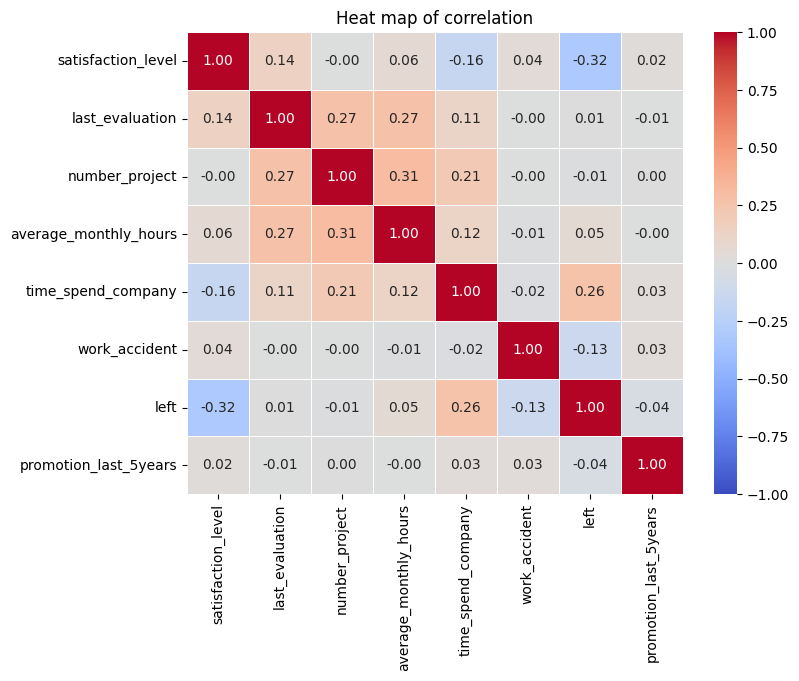

In [25]:
#########################################################
#visualize relationships between variables in the data
#########################################################
plt.figure(figsize=(8,6))
col_list=df_drop.select_dtypes(include=[float,int,]).columns
df_heatmap = df_drop[col_list].corr(method='spearman')
sns.heatmap(df_heatmap,annot=True, vmin=-1, vmax=1,cmap="coolwarm", linewidth=.5,fmt='.2f')
plt.title('Heat map of correlation')
plt.show()
#=>some features seems correlated

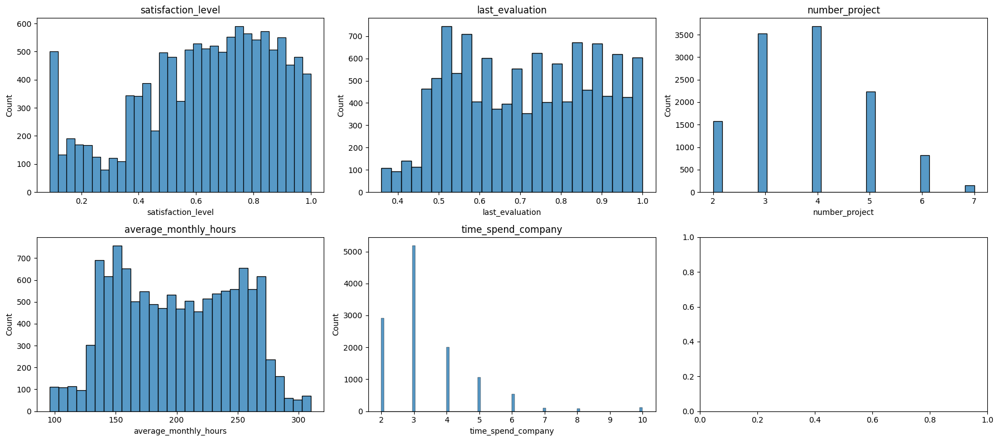

In [26]:
#########################################################
#visualize distribution
#########################################################
chk_columns=['satisfaction_level', 'last_evaluation', 'number_project',
       'average_monthly_hours', 'time_spend_company']

rowCnt=math.ceil(len(chk_columns)/3)

fig, axes=plt.subplots(rowCnt,3,figsize=(18,rowCnt*4))
for col,ax in zip(chk_columns, axes.ravel()):
    sns.histplot(data=df_drop, x=col, ax=ax)
    ax.set_title(col)

plt.tight_layout()
plt.show()

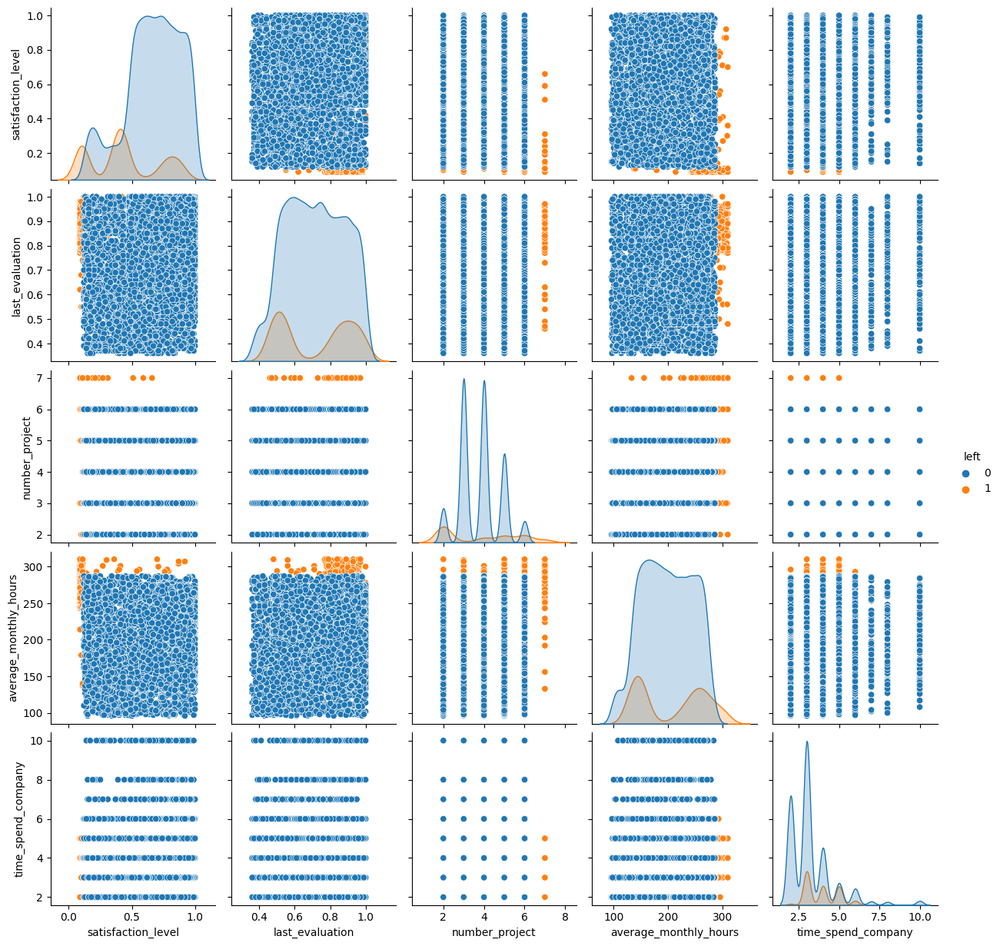

In [27]:
###########################
# Create a pair plot
###########################
chk_columns=['satisfaction_level', 'last_evaluation', 'number_project',
       'average_monthly_hours', 'time_spend_company','left']
sns.pairplot(data=df_drop[chk_columns], hue="left")
plt.show()

#### left

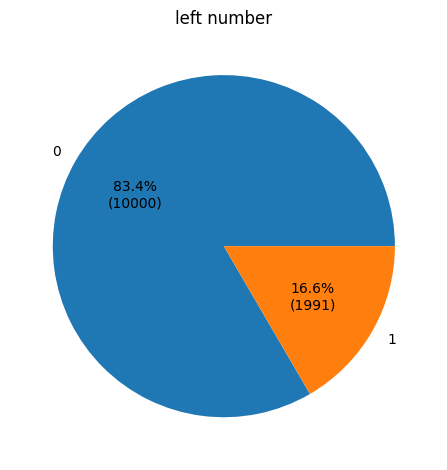

In [28]:
result=df_drop.groupby(['left'])[['number_project']].count().reset_index().rename(columns={'number_project':'count'})
plt.pie(result['count'],labels = result["left"], autopct=autopct_format(result['count']))
plt.title(f"left number")
plt.tight_layout()
plt.show()

##### left vs number_project

number_project,left,2,3,4,5,6,7
0,0,725,3482,3448,1890,455,0
1,1,857,38,237,343,371,145


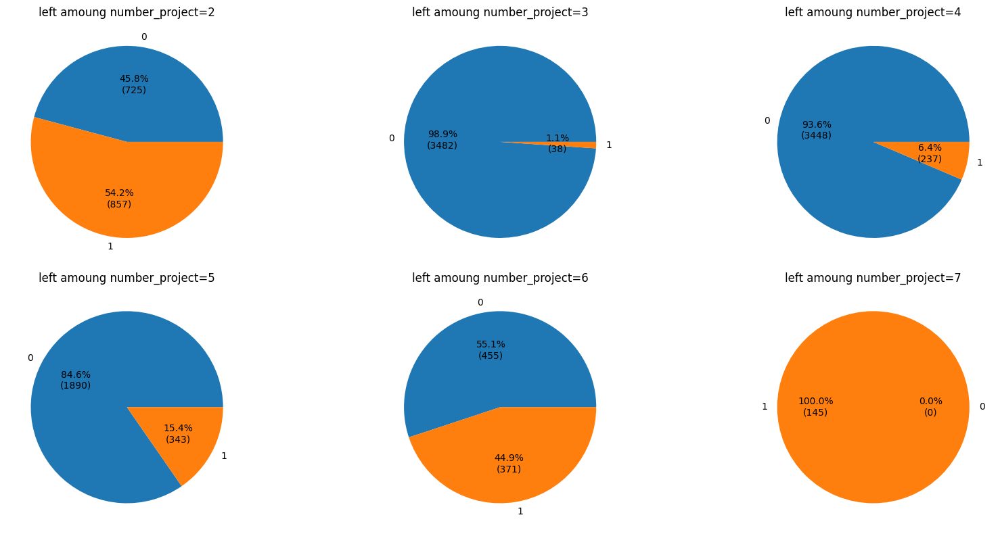

In [29]:
#######################################
#P(left | number_project)
#######################################
result=pd.crosstab(df_drop['left'],df_drop['number_project'],margins=False).reset_index()

display(result)
col_nm=df_drop['number_project'].unique().tolist()
col_nm.sort()

#######################################
#Pie Chart
#######################################
colCnt=3
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["left"], autopct=autopct_format(result[col]))
    ax.set_title(f"left amoung number_project={col}")
plt.tight_layout()
plt.show()

#employees who had 7 projects all left
#employees who had 6 projects around 45% left
#employees who had 2 projects around 54% left

#amoung employee who had 7 projects most of them were 4,5 years


#if all projects had the same scale, difficulty, work hour, 
#employee left with 2 projects might due to skill/job unmatch
#employee left with 7 projects might due to future career plan/growth

#more projects, higher average monthly hours
#=>if all projects had the same scale, difficulty, employees who did 7 projects might have too much work and worked overtime


In [30]:
display(df_drop.groupby(['left'])['number_project'].agg(['min','max','std','mean','median','count']).reset_index())

,left,min,max,std,mean,median,count
0,0,2,6,0.981755,3.786800,4.0,10000
1,1,2,7,1.817139,3.883476,4.0,1991


In [31]:
#$H_{0}$: No association between number_project and left
#$H_{A}$: There is an association between number_project and left
result=pd.crosstab(df_drop['number_project'], df_drop['left'])
display(result)

significance_level=0.01

statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(result, correction=False)

show_test_result(statistic, pvalue,significance_level)

left,0,1
number_project,,
2,725,857
3,3482,38
4,3448,237
5,1890,343
6,455,371
7,0,145


Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=3709.36)


##### left vs time_spend_company

time_spend_company_range,left,2,3,4,5,>=6
0,0,2879,4316,1510,580,715
1,1,31,874,495,482,109


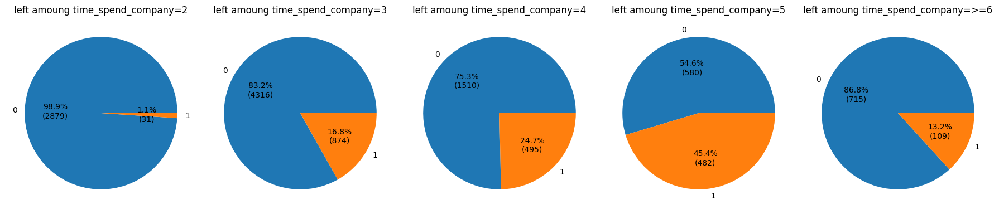

In [32]:
#######################################
#P(left | time_spend_company_range)
#######################################
result=pd.crosstab(df_drop['left'],df_drop['time_spend_company_range'],margins=False).reset_index()

display(result)
col_nm=df_drop['time_spend_company_range'].unique().tolist()
col_nm.sort()

#######################################
#Pie Chart
#######################################
colCnt=5
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["left"], autopct=autopct_format(result[col]))
    ax.set_title(f"left amoung time_spend_company={col}")
plt.tight_layout()
plt.show()

time_spend_company,left,2,3,4,5,6,7,8,10
0,0,2879,4316,1510,580,433,94,81,107
1,1,31,874,495,482,109,0,0,0


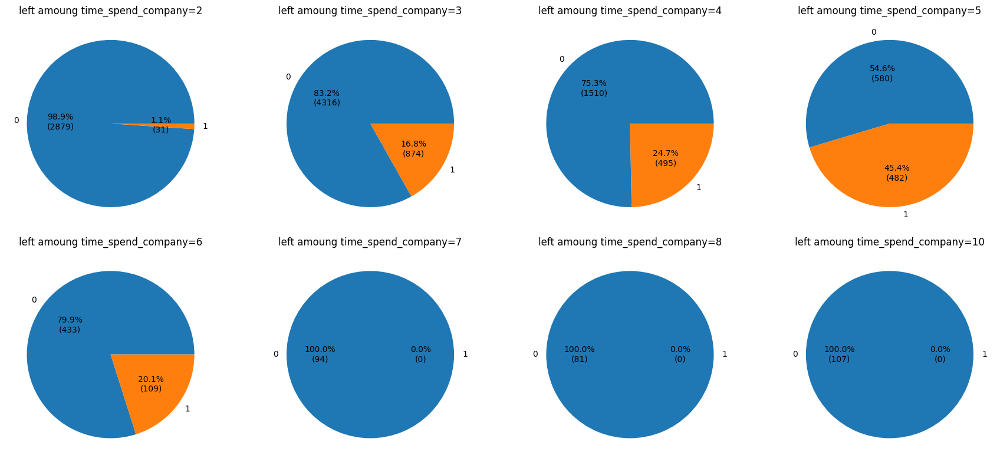

In [33]:
#######################################
#P(left | time_spend_company)
#######################################
result=pd.crosstab(df_drop['left'],df_drop['time_spend_company'],margins=False).reset_index()

display(result)
col_nm=df_drop['time_spend_company'].unique().tolist()
col_nm.sort()

#######################################
#Pie Chart
#######################################
colCnt=4
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["left"], autopct=autopct_format(result[col]))
    ax.set_title(f"left amoung time_spend_company={col}")
plt.tight_layout()
plt.show()

#Employees who worked for 5 years had the highest left ratio
#left ratio of employees who worked for 2-5 years keep increasing, peak at 5th year, decreased at 6th year.
#=>it might associated with carrer path/skill development

In [34]:
#$H_{0}$: No association between time_spend_company and left
#$H_{A}$: There is an association between time_spend_company and left
result=pd.crosstab(df_drop['time_spend_company'], df_drop['left'])
display(result)

significance_level=0.01

statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(result, correction=False)

show_test_result(statistic, pvalue,significance_level)

left,0,1
time_spend_company,,
2,2879,31
3,4316,874
4,1510,495
5,580,482
6,433,109
7,94,0
8,81,0
10,107,0


Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=1298.56)


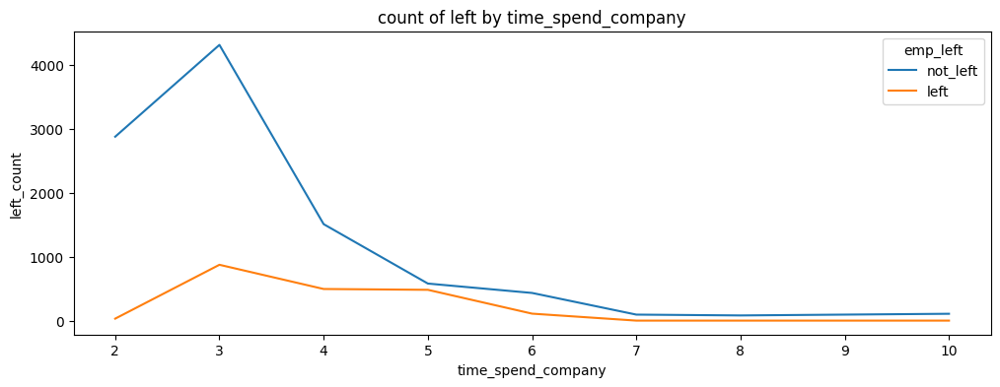

In [35]:
############################################
#count
############################################
plt.figure(figsize=(12,4))
result=pd.crosstab(df_drop['time_spend_company'],df_drop['left'],margins=False).reset_index()
result.columns=['time_spend_company','company_not_left','company_left']
result=pd.wide_to_long(result, stubnames='company', i=['time_spend_company'], j='emp_left',sep='_', suffix=r'\w+').reset_index().rename(columns={
    'company':'left_count'
})
sns.lineplot(data=result, x="time_spend_company", y="left_count",hue='emp_left')
plt.title('count of left by time_spend_company')
plt.show()

#=>employees who worked for 3 years had the highest left count

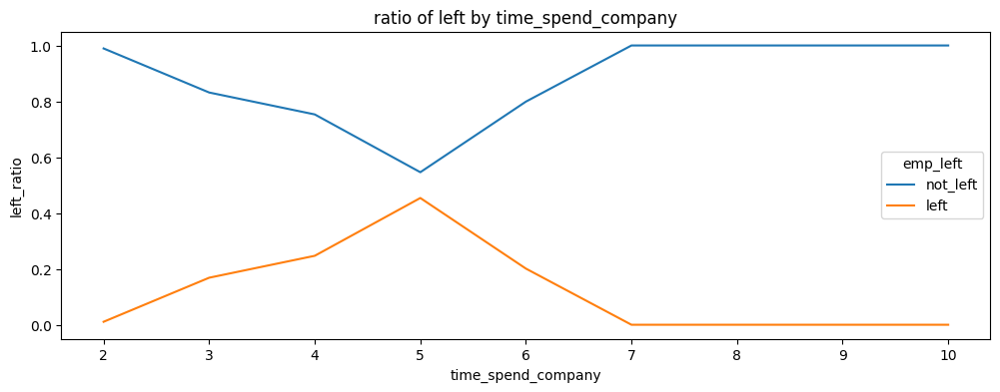

In [36]:
############################################
#ratio
############################################
plt.figure(figsize=(12,4))
result=pd.crosstab(df_drop['time_spend_company'],df_drop['left'],margins=False,normalize='index').reset_index()
result.columns=['time_spend_company','company_not_left','company_left']
result=pd.wide_to_long(result, stubnames='company', i=['time_spend_company'], j='emp_left',sep='_', suffix=r'\w+').reset_index().rename(columns={
    'company':'left_ratio'
})
sns.lineplot(data=result, x="time_spend_company", y="left_ratio",hue='emp_left')
plt.title('ratio of left by time_spend_company')
plt.show()

#=>employees who worked for 5 years had the highest left ratio

In [37]:
#post hoc test for proportion 

#https://www.statsmodels.org/dev/generated/statsmodels.stats.proportion.proportions_ztest.html
#$H_{0}$: left proportion of two compared time_spend_company were identical
#$H_{A}$: left proportion of two compared time_spend_company were not identical
significance_level=0.01

print('proportions_ztest test result of left')
results = {}
cal_result=pd.crosstab(df_drop['time_spend_company'], df_drop['left']).reset_index()
cal_result['All']=cal_result[0]+cal_result[1]
display(cal_result)

for i, item1 in enumerate(sorted(cal_result['time_spend_company'].unique().tolist())):
    for j, item2 in enumerate(sorted(cal_result['time_spend_company'].unique().tolist())):
        if i < j:
            
            statistic, pvalue = proportions_ztest(cal_result[cal_result['time_spend_company'].isin([item1,item2])][1],
                                                 cal_result[cal_result['time_spend_company'].isin([item1,item2])]['All'])
            if pvalue<=significance_level:
                result='Reject H0'
            else:
                result='Fail reject'
            results[f"{item1} vs {item2}"] = (statistic, pvalue ,result)

# Convert the results into a DataFrame
result_df = pd.DataFrame(results).transpose()
result_df.columns = ['Statistic', 'Pvalue','Result']
result_df.reset_index(inplace=True)
result_df.rename(columns={'index': 'time_spend_company_compared'}, inplace=True)

result_df

proportions_ztest test result of left


left,time_spend_company,0,1,All
0,2,2879,31,2910
1,3,4316,874,5190
2,4,1510,495,2005
3,5,580,482,1062
4,6,433,109,542
5,7,94,0,94
6,8,81,0,81
7,10,107,0,107


,time_spend_company_compared,Statistic,Pvalue,Result
0,2 vs 3,-21.622029,0.0,Reject H0
1,2 vs 4,-26.328408,0.0,Reject H0
2,2 vs 5,-36.862665,0.0,Reject H0
3,2 vs 6,-20.637765,0.0,Reject H0
4,2 vs 7,1.005891,0.314468,Fail reject
5,2 vs 8,0.933768,0.350423,Fail reject
6,2 vs 10,1.073171,0.283194,Fail reject
7,3 vs 4,-7.603954,0.0,Reject H0
8,3 vs 5,-20.566005,0.0,Reject H0
9,3 vs 6,-1.922158,0.054586,Fail reject


##### left vs work_accident

work_accident,left,0,1
0,0,8255,1745
1,1,1886,105


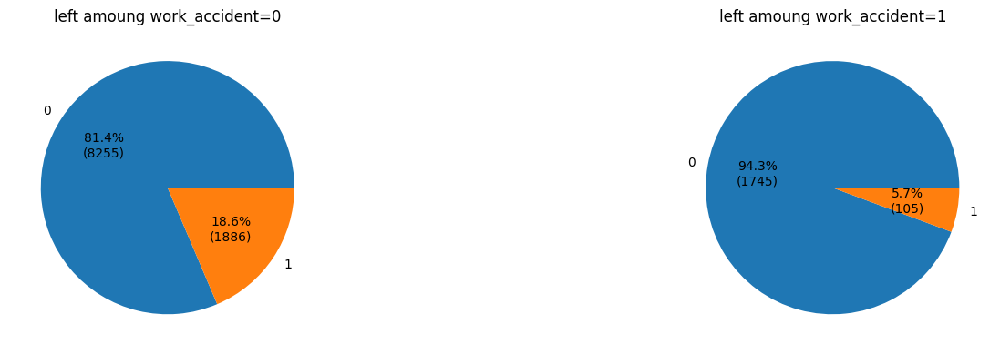

In [38]:
#######################################
#P(left | work_accident)
#######################################
result=pd.crosstab(df_drop['left'],df_drop['work_accident'],margins=False).reset_index()

display(result)
col_nm=df_drop['work_accident'].unique().tolist()
col_nm.sort()

#######################################
#Pie Chart
#######################################
colCnt=2
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["left"], autopct=autopct_format(result[col]))
    ax.set_title(f"left amoung work_accident={col}")
plt.tight_layout()
plt.show()

#left ratio of employees who had work_accident seemed lower than employees who didn't have work_accident
#possible reasons:
#=>employees who had work_accident may in the management position, they need to take responsability
#=>employees who had work_accident may have sense of responsability
#=>employees who had work_accident may be honest
#=>employees who had work_accident may do more difficult and challenging work

In [39]:
#$H_{0}$: No association between work_accident and left
#$H_{A}$: There is an association between work_accident and left
result=pd.crosstab(df_drop['work_accident'], df_drop['left'])
display(result)

significance_level=0.01

statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(result, correction=False)

show_test_result(statistic, pvalue,significance_level)

left,0,1
work_accident,,
0,8255,1886
1,1745,105


Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=188.67)


In [40]:
from statsmodels.stats.proportion import proportions_ztest
#https://www.statsmodels.org/dev/generated/statsmodels.stats.proportion.proportions_ztest.html
#$H_{0}$: left employee proportion of employees who had accident was great equal than employees who didn't have accident
#$H_{A}$: left employee proportion of employees who had accident was lower than employees who didn't have accident
result=pd.crosstab(df_drop['work_accident'], df_drop['left'],margins=True)
display(result)

significance_level=0.01

left_count=result[[1]][:2]
trials_count=result[['All']][:2]
display(left_count)
display(trials_count)

#not promoted, promoted
statistic, pvalue  = proportions_ztest(left_count, trials_count,alternative='larger')

show_test_result(statistic[0], pvalue[0],significance_level)

left,0,1,All
work_accident,,,
0,8255,1886,10141
1,1745,105,1850
All,10000,1991,11991


left,1
work_accident,
0,1886
1,105


left,All
work_accident,
0,10141
1,1850


Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=13.74)


##### left vs promotion_last_5years

promotion_last_5years,left,0,1
0,0,9805,195
1,1,1983,8


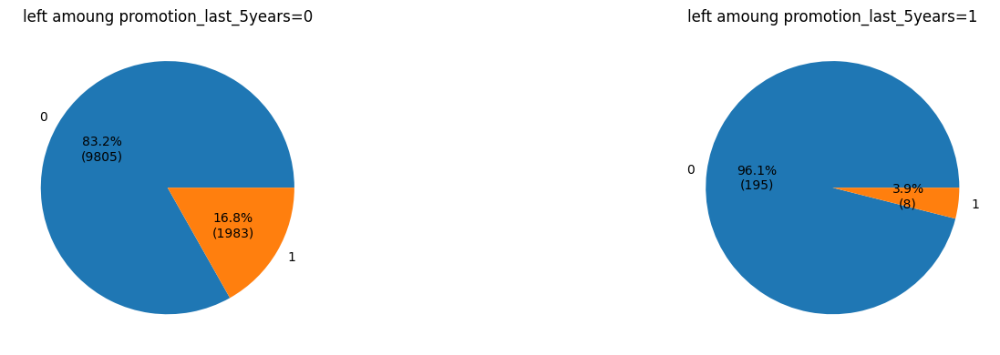

In [41]:
#######################################
#P(left | promotion_last_5years)
#######################################
result=pd.crosstab(df_drop['left'],df_drop['promotion_last_5years'],margins=False).reset_index()

display(result)
col_nm=df_drop['promotion_last_5years'].unique().tolist()
col_nm.sort()

#######################################
#Pie Chart
#######################################
colCnt=2
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["left"], autopct=autopct_format(result[col]))
    ax.set_title(f"left amoung promotion_last_5years={col}")
plt.tight_layout()
plt.show()


In [42]:
#$H_{0}$: No association between promotion_last_5years and left
#$H_{A}$: There is an association between promotion_last_5years and left
result=pd.crosstab(df_drop['promotion_last_5years'], df_drop['left'])
display(result)

significance_level=0.01

statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(result, correction=False)

show_test_result(statistic, pvalue,significance_level)

left,0,1
promotion_last_5years,,
0,9805,1983
1,195,8


Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=23.91)


In [43]:
from statsmodels.stats.proportion import proportions_ztest
#https://www.statsmodels.org/dev/generated/statsmodels.stats.proportion.proportions_ztest.html
#$H_{0}$: left employee proportion of promoted employees was great equal than not promoted employees
#$H_{A}$: left employee proportion of promoted employees was lower than not promoted employees
result=pd.crosstab(df_drop['promotion_last_5years'], df_drop['left'],margins=True)
display(result)

significance_level=0.01

left_count=result[[1]][:2]
trials_count=result[['All']][:2]
display(left_count)
display(trials_count)

#not promoted, promoted
statistic, pvalue  = proportions_ztest(left_count, trials_count,alternative='larger')

show_test_result(statistic[0], pvalue[0],significance_level)

#left employee proportion of promoted employees was lower than not promoted employees


left,0,1,All
promotion_last_5years,,,
0,9805,1983,11788
1,195,8,203
All,10000,1991,11991


left,1
promotion_last_5years,
0,1983
1,8


left,All
promotion_last_5years,
0,11788
1,203


Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=4.89)


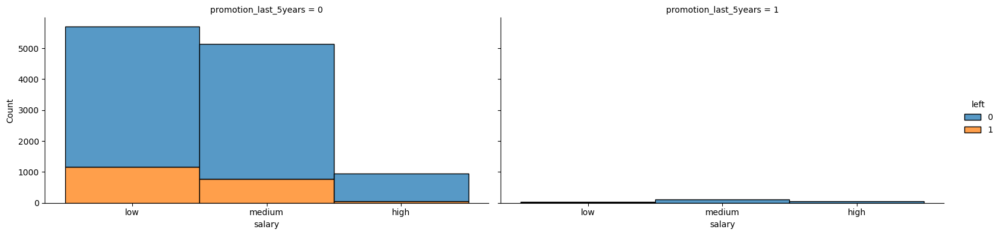

In [44]:
############################################
#left
#keep salary and promotion_last_5years constant
############################################
g=sns.displot(
    data=df_drop, x='salary',  hue='left',col="promotion_last_5years",
    kind="hist", height=4, aspect=2,col_wrap=2, multiple='stack',
    facet_kws=dict(sharex=False)
)

plt.show()

##### left vs department

department,left,IT,RandD,accounting,hr,management,marketing,product_mng,sales,support,technical
0,0,818,609,512,488,384,561,576,2689,1509,1854
1,1,158,85,109,113,52,112,110,550,312,390


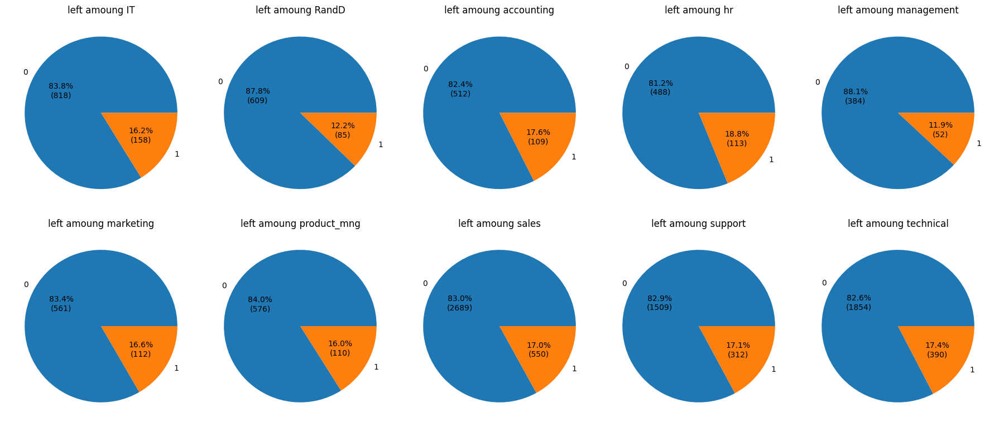

In [45]:
#######################################
#P(left | department)
#######################################
result=pd.crosstab(df_drop['left'],df_drop['department'],margins=False).reset_index()

display(result)
col_nm=df_drop['department'].unique().tolist()
col_nm.sort()

#######################################
#Pie Chart
#######################################
colCnt=5
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["left"], autopct=autopct_format(result[col]))
    ax.set_title(f"left amoung {col}")
plt.tight_layout()
plt.show()

#=>Some typical departments like Manufacturing, Packaging, Qulity control, Supply Chain and Logistics , etc 
#are not in this dataset, this dataset may not be representative

In [46]:
#$H_{0}$: No association between department and left
#$H_{A}$: There is an association between department and left
result=pd.crosstab(df_drop['department'], df_drop['left'])
display(result)

significance_level=0.01

statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(result, correction=False)

show_test_result(statistic, pvalue,significance_level)

left,0,1
department,,
IT,818,158
RandD,609,85
accounting,512,109
hr,488,113
management,384,52
marketing,561,112
product_mng,576,110
sales,2689,550
support,1509,312


Fail to reject H0 at significance level 0.01 (Pvalue=0.013, Statistic=20.86)


left,department,0,1
0,IT,818,158
1,RandD,609,85
2,accounting,512,109
3,hr,488,113
4,management,384,52
5,marketing,561,112
6,product_mng,576,110
7,sales,2689,550
8,support,1509,312
9,technical,1854,390


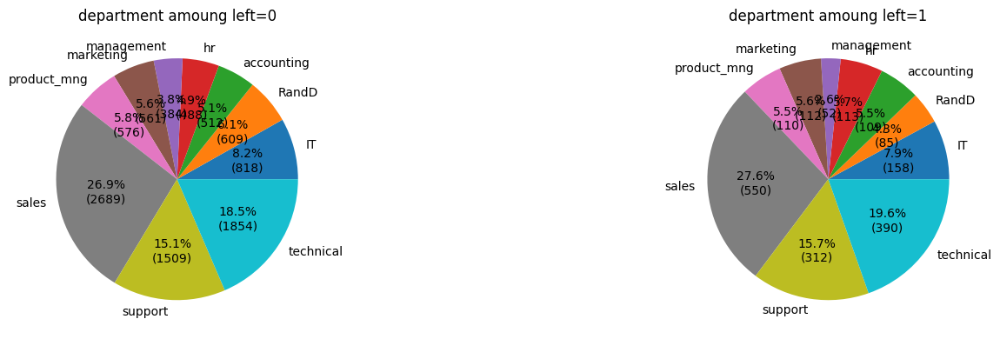

In [47]:
#######################################
#P(department | left)
#######################################
result=pd.crosstab(df_drop['department'],df_drop['left'],margins=False).reset_index()

display(result)
col_nm=df_drop['left'].unique().tolist()
col_nm.sort()

#######################################
#Pie Chart
#######################################
colCnt=2
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["department"], autopct=autopct_format(result[col]))
    ax.set_title(f"department amoung left={col}")
plt.tight_layout()
plt.show()


##### left vs salary

salary,left,low,medium,high
0,0,4566,4492,942
1,1,1174,769,48


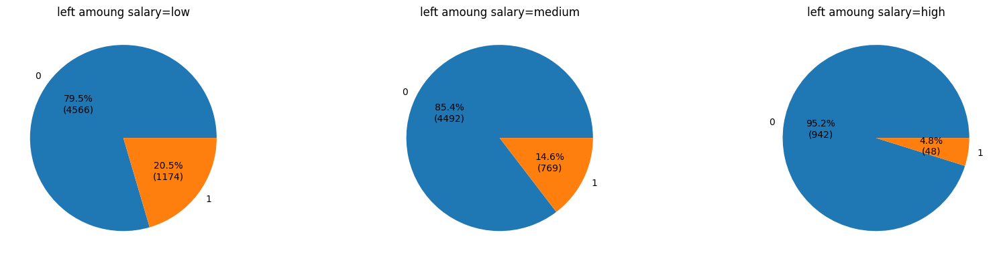

In [48]:
#######################################
#P(left | salary)
#######################################
result=pd.crosstab(df_drop['left'],df_drop['salary'],margins=False).reset_index()

display(result)
col_nm=df_drop['salary'].unique().tolist()

#######################################
#Pie Chart
#######################################
colCnt=3
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["left"], autopct=autopct_format(result[col]))
    ax.set_title(f"left amoung salary={col}")
plt.tight_layout()
plt.show()

#higher salary tend to have lower employee left ratio 

In [49]:
#$H_{0}$: No association between salary and left
#$H_{A}$: There is an association between salary and left
result=pd.crosstab(df_drop['salary'], df_drop['left'])
display(result)

significance_level=0.01

statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(result, correction=False)

show_test_result(statistic, pvalue,significance_level)

left,0,1
salary,,
low,4566,1174
medium,4492,769
high,942,48


Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=175.21)


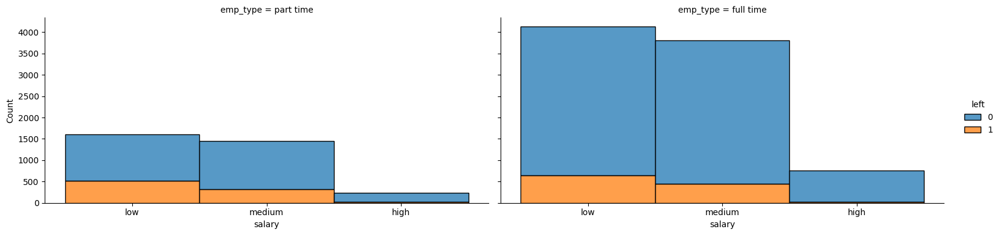

In [50]:
############################################
#salary by left
#keep emp_type constant
############################################
g=sns.displot(
    data=df_drop, x='salary',  hue='left',col="emp_type",
    kind="hist", height=4, aspect=2,col_wrap=2, multiple='stack',
    facet_kws=dict(sharex=False)
)

plt.show()

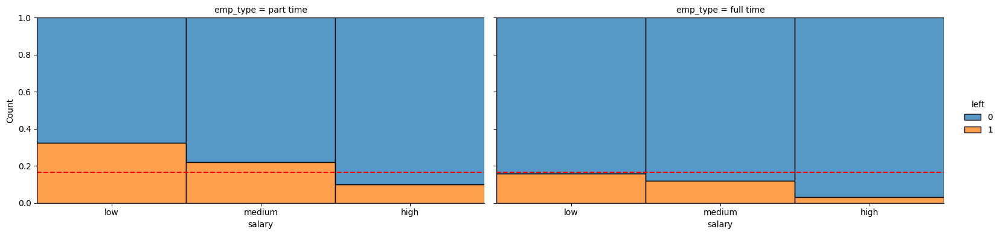

In [51]:
############################################
#salary by left
#keep emp_type constant
############################################
g=sns.displot(
    data=df_drop, x='salary',  hue='left',col="emp_type",
    kind="hist", height=4, aspect=2,col_wrap=2, multiple='fill',
    facet_kws=dict(sharex=False)
)
axes = g.fig.axes

total_left_ratio=(df_drop['left'].sum())/df_drop.shape[0]
for ax in axes:
    ax.axhline(total_left_ratio,color='red',linestyle='--')
plt.show()

In [52]:
#post hoc test for proportion 

#https://www.statsmodels.org/dev/generated/statsmodels.stats.proportion.proportions_ztest.html
#$H_{0}$: left proportion of two compared salary were identical
#$H_{A}$: left proportion of two compared salary were not identical
significance_level=0.01

print('proportions_ztest test result of left')
results = {}
cal_result=pd.crosstab(df_drop['salary'], df_drop['left']).reset_index()
cal_result['All']=cal_result[0]+cal_result[1]
display(cal_result)

for i, item1 in enumerate(sorted(cal_result['salary'].unique().tolist())):
    for j, item2 in enumerate(sorted(cal_result['salary'].unique().tolist())):
        if i < j:
            
            statistic, pvalue = proportions_ztest(cal_result[cal_result['salary'].isin([item1,item2])][1],
                                                 cal_result[cal_result['salary'].isin([item1,item2])]['All'])
            if pvalue<=significance_level:
                result='Reject H0'
            else:
                result='Fail reject'
            results[f"{item1} vs {item2}"] = (statistic, pvalue ,result)

# Convert the results into a DataFrame
result_df = pd.DataFrame(results).transpose()
result_df.columns = ['Statistic', 'Pvalue','Result']
result_df.reset_index(inplace=True)
result_df.rename(columns={'index': 'salary_compared'}, inplace=True)

result_df

proportions_ztest test result of left


left,salary,0,1,All
0,low,4566,1174,5740
1,medium,4492,769,5261
2,high,942,48,990


,salary_compared,Statistic,Pvalue,Result
0,high vs low,11.762448,0.0,Reject H0
1,high vs medium,8.365346,0.0,Reject H0
2,low vs medium,8.01801,0.0,Reject H0


##### left vs satisfaction_level

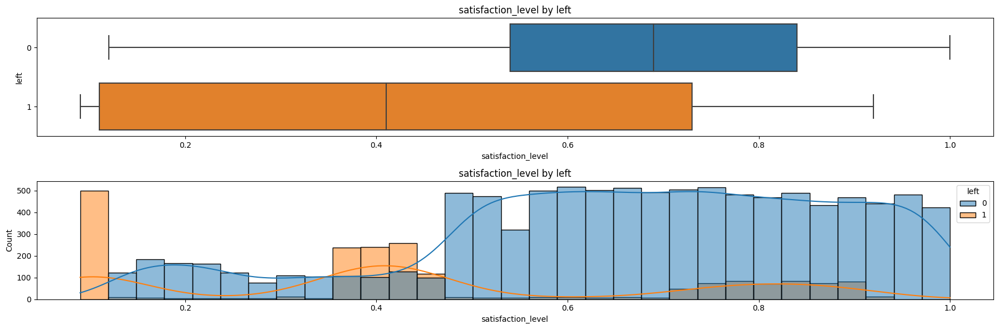

,left,min,max,std,mean,median,count
0,0,0.12,1.00,0.217082,0.667365,0.69,10000
1,1,0.09,0.92,0.265207,0.440271,0.41,1991


In [53]:
#############################################
#satisfaction_level and left
#############################################
fig, axs = plt.subplots(2,1,figsize=(18,6))

sns.boxplot(data=df_drop,y=df_drop['left'],x='satisfaction_level',ax=axs[0],orient='h')
axs[0].set_title('satisfaction_level by left')

sns.histplot(data=df_drop,hue=df_drop['left'],x='satisfaction_level',palette='tab10',ax=axs[1],kde=True)
axs[1].set_title('satisfaction_level by left')

plt.tight_layout()
plt.show()

display(df_drop.groupby(['left'])['satisfaction_level'].agg(['min','max','std','mean','median','count']).reset_index())

#left employees had lower satisfaction level than employee who don't leave

In [54]:
# Levene test for equal variances.
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.levene.html
#H0:All input samples are from populations with equal variances
#HA:At least one input sample are from populations with different variance
significance_level=0.01
print('Levene test result of satisfaction_level')
statistic, p_value = levene(*[df_drop['satisfaction_level'][df_drop['left'] == item]
                                    for item in df_drop['left'].unique()])
show_test_result(statistic, p_value,significance_level)

Levene test result of satisfaction_level
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=88.15)


In [55]:
# Kruskal-Wallis test
#H0:The population median of left and not left are equal
#HA:The population median of left and not left are not equal
significance_level=0.01
print('Kruskal-Wallis test result of satisfaction_level')
statistic, p_value = kruskal(*[df_drop['satisfaction_level'][df_drop['left'] == item]
                                    for item in df_drop['left'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis test result of satisfaction_level
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=1215.81)


In [56]:
# Mann-Whitney U rank test
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.mannwhitneyu.html
#H0:The population median of left employee great equal than employee who didn't leave
#HA:The population median of left employee less than employee who didn't leave
significance_level=0.01
print('Mann-Whitney test result of satisfaction_level')
statistic, p_value = mannwhitneyu(df_drop[df_drop['left']==1]['satisfaction_level'], 
                                  df_drop[df_drop['left']==0]['satisfaction_level'],
                                  alternative="less")
show_test_result(statistic, p_value,significance_level)

Mann-Whitney test result of satisfaction_level
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=5037062.0)


In [57]:
# Kolmogorov-Smirnov
# https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.ks_2samp.html
# https://stats.stackexchange.com/questions/617880/p-value-1-of-two-sided-kolmogorov-smirnov-test-for-clearly-distinct-distribut
#H0:The distributions of satisfaction_level for left are identical.
#HA:The distributions of satisfaction_level for left are different.
#set significance_level 0.01
significance_level=0.01
print('Kolmogorov-Smirnov test result of satisfaction_level')
statistic, p_value = ks_2samp(*[df_drop['satisfaction_level'][df_drop['left'] == item]
                                    for item in df_drop['left'].unique()],alternative='two-sided', mode='asymp')
show_test_result(statistic, p_value,significance_level)

Kolmogorov-Smirnov test result of satisfaction_level
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=0.56)


In [58]:
###############################################
#satisfaction_level of left employees
###############################################
lower,upper,_=percentile_bootstrap_ci(df_drop[df_drop['left']==1]['satisfaction_level'],np.median,convidence_level=0.95)
report_convidence_intervals(lower,upper,0.95,'median')

lower,upper,_=percentile_bootstrap_ci(df_drop[df_drop['left']==1]['satisfaction_level'],np.mean,convidence_level=0.95)
report_convidence_intervals(lower,upper,0.95,'mean')

###############################################
#satisfaction_level of not left employees
###############################################
lower,upper,_=percentile_bootstrap_ci(df_drop[df_drop['left']==0]['satisfaction_level'],np.median,convidence_level=0.95)
report_convidence_intervals(lower,upper,0.95,'median')

lower,upper,_=percentile_bootstrap_ci(df_drop[df_drop['left']==0]['satisfaction_level'],np.mean,convidence_level=0.95)
report_convidence_intervals(lower,upper,0.95,'mean')

Percentile bootstrap of median 95% CI [0.4, 0.42]
Percentile bootstrap of mean 95% CI [0.43, 0.45]
Percentile bootstrap of median 95% CI [0.68, 0.69]
Percentile bootstrap of mean 95% CI [0.66, 0.67]


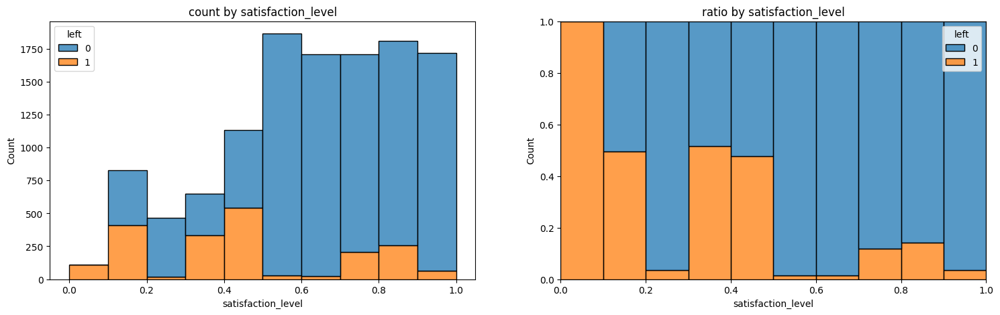

In [59]:
fig, axs = plt.subplots(1,2,figsize=(18,5))
sns.histplot(data=df_drop,hue='left',x='satisfaction_level',palette='tab10',multiple='stack',binwidth=0.1,binrange=(0,1),ax=axs[0])
axs[0].set_title('count by satisfaction_level')
sns.histplot(data=df_drop,hue='left',x='satisfaction_level',palette='tab10',multiple='fill',binwidth=0.1,binrange=(0,1),ax=axs[1])
axs[1].set_title('ratio by satisfaction_level')
plt.show()

##### left vs last_evaluation

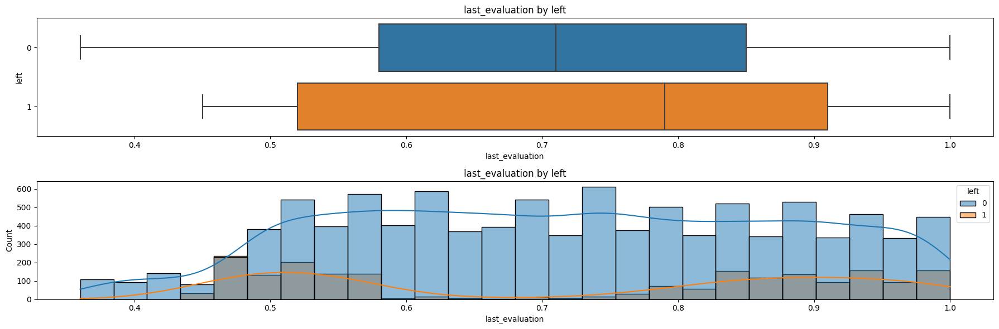

,left,min,max,std,mean,median,count
0,0,0.36,1.0,0.161919,0.715667,0.71,10000
1,1,0.45,1.0,0.197436,0.721783,0.79,1991


In [60]:
#############################################
#last_evaluation and left
#############################################
fig, axs = plt.subplots(2,1,figsize=(18,6))

sns.boxplot(data=df_drop,y=df_drop['left'],x='last_evaluation',ax=axs[0],orient='h')
axs[0].set_title('last_evaluation by left')

sns.histplot(data=df_drop,hue='left',x='last_evaluation',palette='tab10',ax=axs[1],kde=True)
axs[1].set_title('last_evaluation by left')

plt.tight_layout()
plt.show()

display(df_drop.groupby(['left'])['last_evaluation'].agg(['min','max','std','mean','median','count']).reset_index())

In [61]:
# Levene test for equal variances.
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.levene.html
#H0:All input samples are from populations with equal variances
#HA:At least one input sample are from populations with different variance
significance_level=0.01

print('Levene test result of last_evaluation')
statistic, p_value = levene(*[df_drop['last_evaluation'][df_drop['left'] == item]
                                    for item in df_drop['left'].unique()])
show_test_result(statistic, p_value,significance_level)

Levene test result of last_evaluation
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=452.23)


In [62]:
# Kruskal-Wallis test
#H0:The population median of all of the groups are equal
#HA:At least one group has different median
#set significance_level 0.01
significance_level=0.01

print('Kruskal-Wallis testresult of last_evaluation')
statistic, p_value = kruskal(*[df_drop['last_evaluation'][df_drop['left'] == item]
                                    for item in df_drop['left'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis testresult of last_evaluation
Fail to reject H0 at significance level 0.01 (Pvalue=0.528, Statistic=0.4)


In [63]:
# Kolmogorov-Smirnov
# https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.ks_2samp.html
#H0:The distributions of last_evaluation for left are identical.
#HA:The distributions of last_evaluation for left are different.
#set significance_level 0.01
significance_level=0.01

print('Kolmogorov-Smirnov test result of last_evaluation')
statistic, p_value = ks_2samp(*[df_drop['last_evaluation'][df_drop['left'] == item]
                                    for item in df_drop['left'].unique()],alternative='two-sided', mode='auto')
show_test_result(statistic, p_value,significance_level)

Kolmogorov-Smirnov test result of last_evaluation
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=0.2)


In [64]:
# Mann-Whitney U rank test
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.mannwhitneyu.html
#H0:The population median of left employee less equal than employee who didn't leave
#HA:The population median of left employee greater than employee who didn't leave
significance_level=0.01
print('Mann-Whitney test result of satisfaction_level')
statistic, p_value = mannwhitneyu(df_drop[df_drop['left']==1]['last_evaluation'], 
                                  df_drop[df_drop['left']==0]['last_evaluation'],
                                  alternative="greater")
show_test_result(statistic, p_value,significance_level)

Mann-Whitney test result of satisfaction_level
Fail to reject H0 at significance level 0.01 (Pvalue=0.264, Statistic=10044036.0)


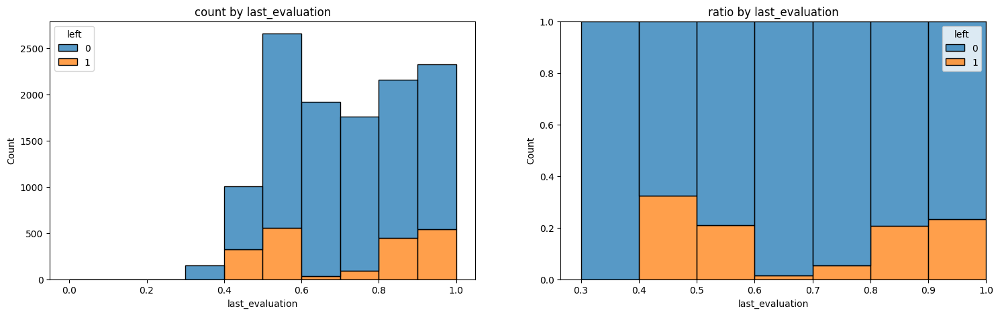

In [65]:
fig, axs = plt.subplots(1,2,figsize=(18,5))
sns.histplot(data=df_drop,hue='left',x='last_evaluation',palette='tab10',multiple='stack',binwidth=0.1,binrange=(0,1),ax=axs[0])
axs[0].set_title('count by last_evaluation')
sns.histplot(data=df_drop,hue='left',x='last_evaluation',palette='tab10',multiple='fill',binwidth=0.1,binrange=(0,1),ax=axs[1])
axs[1].set_title('ratio by last_evaluation')
plt.show()

In [66]:
##############################################
#Transform last_evaluation to categorical
##############################################
def evaluation_range(last_evaluation):
    if (0<=last_evaluation)&(last_evaluation<=0.2):
        result='[0,0.2]'
    elif (0.2<=last_evaluation)&(last_evaluation<=0.4):
        result='(0.2,0.4]'
    elif (0.4<=last_evaluation)&(last_evaluation<=0.6):
        result='(0.4,0.6]'
    elif (0.6<=last_evaluation)&(last_evaluation<=0.8):
        result='(0.6,0.8]'
    elif (0.8<=last_evaluation)&(last_evaluation<=1):
        result='(0.8,1]'
    else:
        result=None
    return result

df_drop['evaluation_range']=df_drop['last_evaluation'].apply(evaluation_range)

# Create categorical designations
evaluation_range_order = ['[0,0.2]', '(0.2,0.4]', '(0.4,0.6]', '(0.6,0.8]', '(0.8,1]']
# Encode `evaluation_range` column as categoricals 
df_drop['evaluation_range'] = pd.Categorical(df_drop['evaluation_range'], categories=evaluation_range_order, ordered=True)

df_drop[['last_evaluation','evaluation_range']].info()
    


<class 'pandas.core.frame.DataFrame'>
Index: 11991 entries, 0 to 11999
Data columns (total 2 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   last_evaluation   11991 non-null  float64 
 1   evaluation_range  11991 non-null  category
dtypes: category(1), float64(1)
memory usage: 457.3 KB


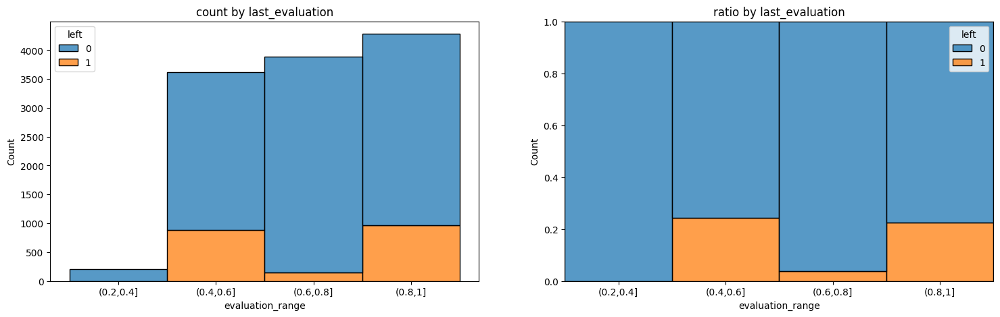

In [67]:
fig, axs = plt.subplots(1,2,figsize=(18,5))
sns.histplot(data=df_drop,hue='left',x='evaluation_range',palette='tab10',multiple='stack',discrete=True,ax=axs[0])
axs[0].set_title('count by last_evaluation')
sns.histplot(data=df_drop,hue='left',x='evaluation_range',palette='tab10',multiple='fill',discrete=True,ax=axs[1])
axs[1].set_title('ratio by last_evaluation')
plt.show()

In [68]:
###############################################
#last_evaluation of left employees
###############################################
lower,upper,_=percentile_bootstrap_ci(df_drop[df_drop['left']==1]['last_evaluation'],np.median,convidence_level=0.95)
report_convidence_intervals(lower,upper,0.95,'median')

lower,upper,_=percentile_bootstrap_ci(df_drop[df_drop['left']==1]['last_evaluation'],np.mean,convidence_level=0.95)
report_convidence_intervals(lower,upper,0.95,'mean')

###############################################
#last_evaluation of not left employees
###############################################
lower,upper,_=percentile_bootstrap_ci(df_drop[df_drop['left']==0]['last_evaluation'],np.median,convidence_level=0.95)
report_convidence_intervals(lower,upper,0.95,'median')

lower,upper,_=percentile_bootstrap_ci(df_drop[df_drop['left']==0]['last_evaluation'],np.mean,convidence_level=0.95)
report_convidence_intervals(lower,upper,0.95,'mean')

Percentile bootstrap of median 95% CI [0.77, 0.81]
Percentile bootstrap of mean 95% CI [0.71, 0.73]
Percentile bootstrap of median 95% CI [0.71, 0.72]
Percentile bootstrap of mean 95% CI [0.71, 0.72]


##### left vs average_monthly_hours

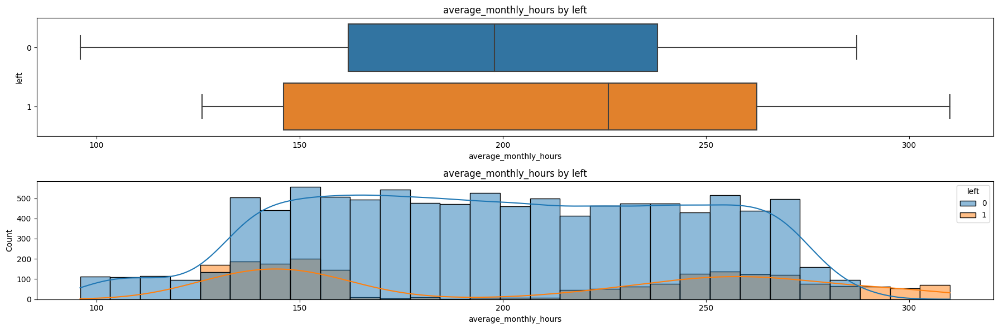

,left,min,max,std,mean,median,count
0,0,96,287,45.665507,198.94270,198.0,10000
1,1,126,310,61.295145,208.16223,226.0,1991


In [69]:
#############################################
#average_monthly_hours and left
#############################################
fig, axs = plt.subplots(2,1,figsize=(18,6))

sns.boxplot(data=df_drop,y=df_drop['left'],x='average_monthly_hours',ax=axs[0],orient='h')
axs[0].set_title('average_monthly_hours by left')

sns.histplot(data=df_drop,hue='left',x='average_monthly_hours',palette='tab10',ax=axs[1],kde=True)
axs[1].set_title('average_monthly_hours by left')

plt.tight_layout()
plt.show()

display(df_drop.groupby(['left'])['average_monthly_hours'].agg(['min','max','std','mean','median','count']).reset_index())
#in many countries full time job seems to be 8 or 9 hours per day
#if a month has 22 work days the stardard work hours will be 176 hours(8 hours per day) or 198 hours(9 hours per day)
#if a month has 20 work days the stardard work hours will be 160 hours(8 hours per day) or 180 hours(9 hours per day)
#=>we can observe average_monthly_hours ranges from  96 hours to 310 hours
#=>it might because there were full time, part time, short time workers in this dataset

In [70]:
# Levene test for equal variances.
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.levene.html
#H0:All input samples are from populations with equal variances
#HA:At least one input sample are from populations with different variance
significance_level=0.01
print('Levene test result of average_monthly_hours')
statistic, p_value = levene(*[df_drop['average_monthly_hours'][df_drop['left'] == item]
                                    for item in df_drop['left'].unique()])
show_test_result(statistic, p_value,significance_level)

Levene test result of average_monthly_hours
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=870.18)


In [71]:
# Kruskal-Wallis test
#H0:The population median of all of the groups are equal
#HA:At least one group has different median
#set significance_level 0.01
significance_level=0.01

print('Kruskal-Wallis testresult of average_monthly_hours')
statistic, p_value = kruskal(*[df_drop['average_monthly_hours'][df_drop['left'] == item]
                                    for item in df_drop['left'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis testresult of average_monthly_hours
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=27.2)


In [72]:
# Kolmogorov-Smirnov
# https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.ks_2samp.html
#H0:The distributions of average_monthly_hours for left are identical.
#HA:The distributions of average_monthly_hours for left are different.
#set significance_level 0.01
significance_level=0.01

print('Kolmogorov-Smirnov test result of average_monthly_hours')
statistic, p_value = ks_2samp(*[df_drop['average_monthly_hours'][df_drop['left'] == item]
                                    for item in df_drop['left'].unique()],alternative='two-sided', mode='auto')
show_test_result(statistic, p_value,significance_level)

Kolmogorov-Smirnov test result of average_monthly_hours
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=0.21)


In [73]:
# Mann-Whitney U rank test
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.mannwhitneyu.html
#H0:The population median of left employee less equal than employee who didn't leave
#HA:The population median of left employee greater than employee who didn't leave
significance_level=0.01
print('Mann-Whitney test result of satisfaction_level')
statistic, p_value = mannwhitneyu(df_drop[df_drop['left']==1]['average_monthly_hours'], 
                                  df_drop[df_drop['left']==0]['average_monthly_hours'],
                                  alternative="greater")
show_test_result(statistic, p_value,significance_level)

Mann-Whitney test result of satisfaction_level
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=10690674.0)


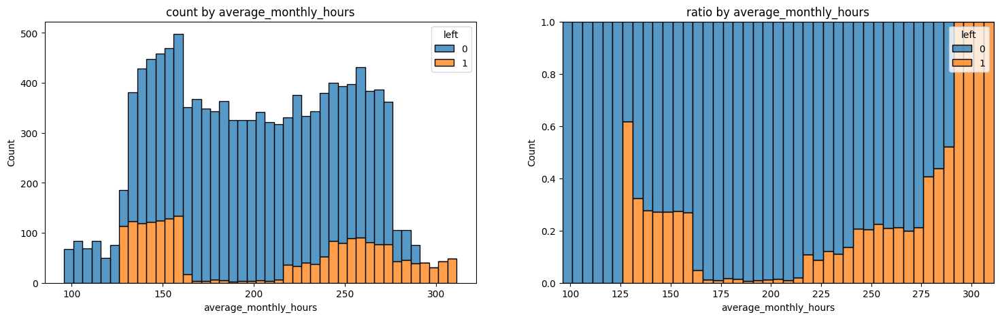

In [74]:
#https://worldpopulationreview.com/country-rankings/average-work-week-by-country
#https://www.oecd.org/en/data/indicators/hours-worked.html

#https://www.kaggle.com/datasets/giripujar/hr-analytics
#confirmed in 2025
#The original dataset was updated 7 years ago（Owner was from India）
#The dataset we used was updated 4 years ago（Owner was from Pakistan） copied from the above dataset
#############################################
#Histplot of average_monthly_hours
#############################################
fig, axs = plt.subplots(1,2,figsize=(18,5))
sns.histplot(data=df_drop,hue='left',x='average_monthly_hours',palette='tab10',multiple='stack',binwidth=5,ax=axs[0])
axs[0].set_title('count by average_monthly_hours')
sns.histplot(data=df_drop,hue='left',x='average_monthly_hours',palette='tab10',multiple='fill',binwidth=5,ax=axs[1])
axs[1].set_title('ratio by average_monthly_hours')
plt.show()

#=>from around 220 hours, higher average_monthly_hours higher left ratio
#=>long time work might make some employees leave

#=>it might have two types of employees, one full time, one part time
#=>we can observe that from around 126-160, left ratio was around 0.3,
#=>161-215 left ratio was low(close to 0), from around 220-310 left ratio tend to increase when average_monthly_hours increase
#=>maybe work hours <160 were part time workers, work hours >=160 were full time workers


In [75]:
###############################################
#average_monthly_hours of left employees
###############################################
lower,upper,_=percentile_bootstrap_ci(df_drop[df_drop['left']==1]['average_monthly_hours'],np.median,convidence_level=0.95)
report_convidence_intervals(lower,upper,0.95,'median')

lower,upper,_=percentile_bootstrap_ci(df_drop[df_drop['left']==1]['average_monthly_hours'],np.mean,convidence_level=0.95)
report_convidence_intervals(lower,upper,0.95,'mean')

Percentile bootstrap of median 95% CI [219.0, 232.0]
Percentile bootstrap of mean 95% CI [205.48, 210.9]


In [76]:
###############################################
#average_monthly_hours of not left employees
###############################################
lower,upper,_=percentile_bootstrap_ci(df_drop[df_drop['left']==0]['average_monthly_hours'],np.median,convidence_level=0.95)
report_convidence_intervals(lower,upper,0.95,'median')

lower,upper,_=percentile_bootstrap_ci(df_drop[df_drop['left']==0]['average_monthly_hours'],np.mean,convidence_level=0.95)
report_convidence_intervals(lower,upper,0.95,'mean')

Percentile bootstrap of median 95% CI [197.0, 200.0]
Percentile bootstrap of mean 95% CI [198.03, 199.85]


##### left vs emp_type

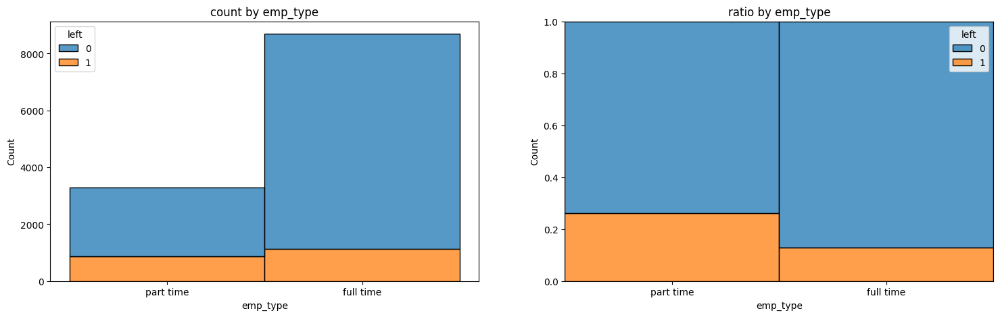

In [77]:
############################################
#left by emp_type
############################################
fig, axs = plt.subplots(1,2,figsize=(18,5))
sns.histplot(data=df_drop,hue='left',x='emp_type',palette='tab10',multiple='stack',binwidth=0.1,binrange=(0,1),ax=axs[0])
axs[0].set_title('count by emp_type')
sns.histplot(data=df_drop,hue='left',x='emp_type',palette='tab10',multiple='fill',binwidth=0.1,binrange=(0,1),ax=axs[1])
axs[1].set_title('ratio by emp_type')
plt.show()

In [78]:
#$H_{0}$: No association between emp_type and left
#$H_{A}$: There is an association between emp_type and left
result=pd.crosstab(df_drop['emp_type'], df_drop['left'])
display(result)

significance_level=0.01

statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(result, correction=False)

show_test_result(statistic, pvalue,significance_level)

left,0,1
emp_type,,
full time,7571,1125
part time,2429,866


Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=307.34)


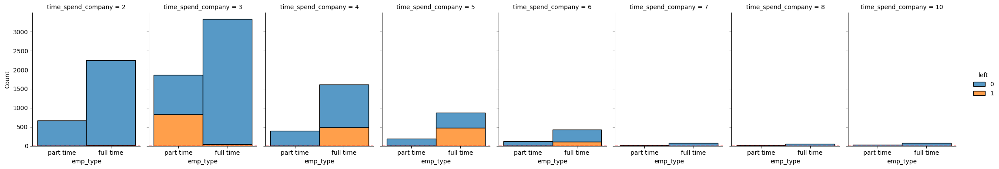

In [79]:
############################################
#left by emp_type
#keep time_spend_company constant
############################################
g=sns.displot(
    data=df_drop, x='emp_type',  hue='left',col="time_spend_company",
    kind="hist", height=4, aspect=.7,col_wrap=8, multiple='stack',
)
axes = g.fig.axes
total_left_ratio=(df_drop['left'].sum())/df_drop.shape[0]
for ax in axes:
    ax.axhline(total_left_ratio,color='red',linestyle='--')
plt.show()

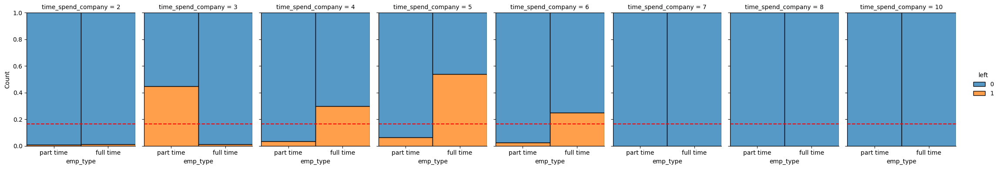

In [80]:
############################################
#left by emp_type
#keep time_spend_company constant
############################################
g=sns.displot(
    data=df_drop, x='emp_type',  hue='left',col="time_spend_company",
    kind="hist", height=4, aspect=.7,col_wrap=8, multiple='fill',
)
axes = g.fig.axes
total_left_ratio=(df_drop['left'].sum())/df_drop.shape[0]
for ax in axes:
    ax.axhline(total_left_ratio,color='red',linestyle='--')
plt.show()
#=>amoung time_spend_company=3, part time had higher left ratio
#=>amoung time_spend_company=4,5,6 full time had higher left ratio

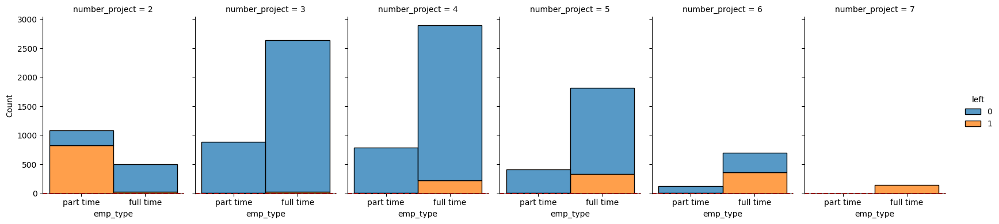

In [81]:
############################################
#left by emp_type
#keep number_project constant
############################################
g=sns.displot(
    data=df_drop, x='emp_type',  hue='left',col="number_project",
    kind="hist", height=4, aspect=.7,multiple='stack',
)
axes = g.fig.axes
total_left_ratio=(df_drop['left'].sum())/df_drop.shape[0]
for ax in axes:
    ax.axhline(total_left_ratio,color='red',linestyle='--')
plt.show()

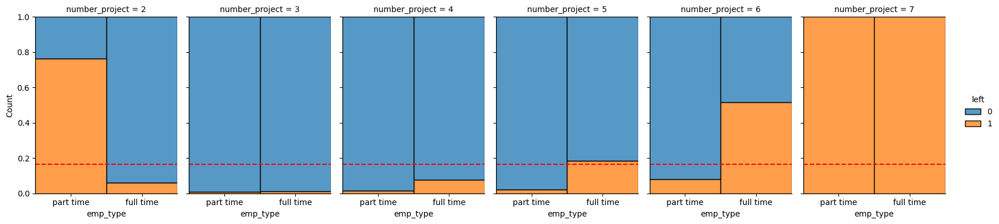

In [82]:
############################################
#left by emp_type
#keep number_project constant
############################################
g=sns.displot(
    data=df_drop, x='emp_type',  hue='left',col="number_project",
    kind="hist", height=4, aspect=.7,multiple='fill',
)
axes = g.fig.axes
total_left_ratio=(df_drop['left'].sum())/df_drop.shape[0]
for ax in axes:
    ax.axhline(total_left_ratio,color='red',linestyle='--')
plt.show()
#=>amoung number_project=2, part time had higher left ratio(78%)
#=>amoung number_project=4,5,6 full time had higher left ratio
#=>amoung number_project=7, all part time and full time left

##### left vs average_monthly_hours by emp_type

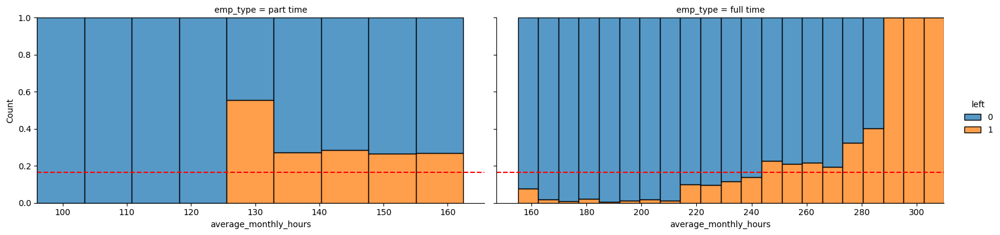

In [83]:
############################################
#average_monthly_hours by left
#keep emp_type constant
############################################
g=sns.displot(
    data=df_drop, x='average_monthly_hours',  hue='left',col="emp_type",
    kind="hist", height=4, aspect=2,col_wrap=2, multiple='fill',
    facet_kws=dict(sharex=False)
)
axes = g.fig.axes

total_left_ratio=(df_drop['left'].sum())/df_drop.shape[0]
for ax in axes:
    ax.axhline(total_left_ratio,color='red',linestyle='--')
plt.show()


In [84]:
display(df_drop.groupby(["emp_type",'left'])['average_monthly_hours'].agg(['min','max','std','mean','median','count']).reset_index())
#=>both part time and full time employee left people had higher average_monthly_hours

,emp_type,left,min,max,std,mean,median,count
0,full time,0,161,287,34.251671,218.013076,217.0,7571
1,full time,1,161,310,29.403036,257.975111,259.0,1125
2,part time,0,96,160,16.168863,139.501853,143.0,2429
3,part time,1,126,160,10.030731,143.451501,144.0,866


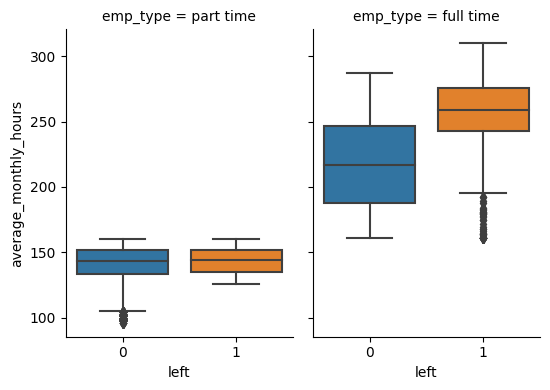

In [85]:
#############################################
#average_monthly_hours by left
#keep emp_type constant
#############################################
sns.catplot(
    data=df_drop, x='left',y="average_monthly_hours",  col="emp_type",
    kind="box", height=4, aspect=.7,col_wrap=2
)
plt.show()

##### left vs satisfaction_level by emp_type

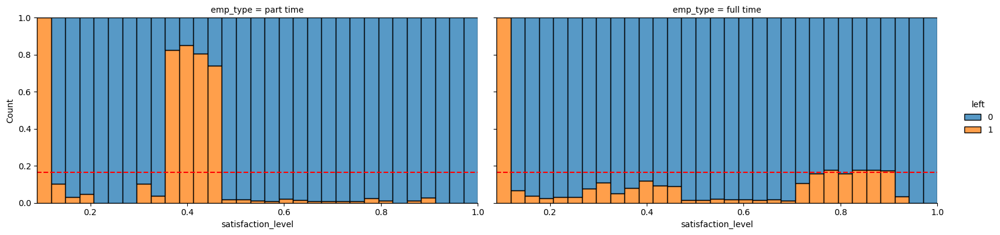

In [86]:
############################################
#satisfaction_level by left
#keep emp_type constant
############################################
g=sns.displot(
    data=df_drop, x='satisfaction_level',  hue='left',col="emp_type",
    kind="hist", height=4, aspect=2,col_wrap=2, multiple='fill',
    facet_kws=dict(sharex=False)
)
axes = g.fig.axes

total_left_ratio=(df_drop['left'].sum())/df_drop.shape[0]
for ax in axes:
    ax.axhline(total_left_ratio,color='red',linestyle='--')
plt.show()

#some employees who had high satisfaction score also left
#possible reasons:
#=>company let them go (reduce cost/reconstruct)
#=>retirement
#=>satisfaction score could not refect how likely they want to work in this company

In [87]:
display(df_drop.groupby(["emp_type",'left'])['satisfaction_level'].agg(['min','max','std','mean','median','count']).reset_index())

,emp_type,left,min,max,std,mean,median,count
0,full time,0,0.12,1.00,0.216303,0.673620,0.70,7571
1,full time,1,0.09,0.92,0.346973,0.461671,0.47,1125
2,part time,0,0.12,1.00,0.218391,0.647867,0.66,2429
3,part time,1,0.11,0.90,0.063270,0.412471,0.41,866


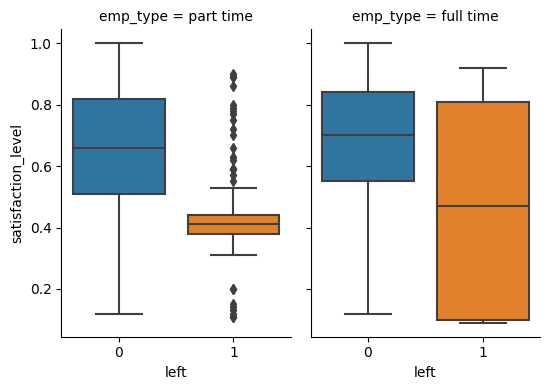

In [88]:
#############################################
#satisfaction_level by left
#keep emp_type constant
#############################################
sns.catplot(
    data=df_drop, x='left',y="satisfaction_level",  col="emp_type",
    kind="box", height=4, aspect=.7,col_wrap=2
)
plt.show()

##### left vs last_evaluation by emp_type

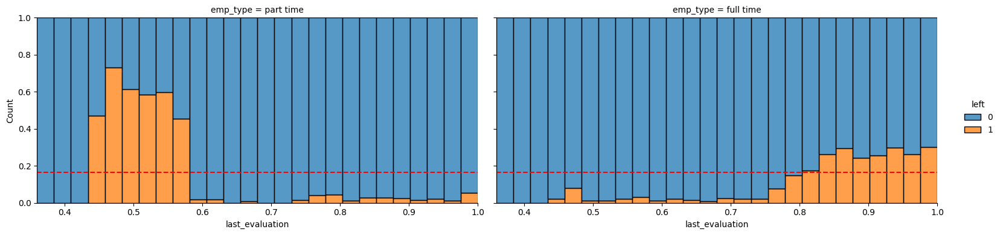

In [89]:
############################################
#last_evaluation by left
#keep emp_type constant
############################################
g=sns.displot(
    data=df_drop, x='last_evaluation',  hue='left',col="emp_type",
    kind="hist", height=4, aspect=2,col_wrap=2, multiple='fill',
    facet_kws=dict(sharex=False)
)
axes = g.fig.axes

total_left_ratio=(df_drop['left'].sum())/df_drop.shape[0]
for ax in axes:
    ax.axhline(total_left_ratio,color='red',linestyle='--')
plt.show()

#=>there are many possibilities
#=>maybe these employees have other career plan
#=>maybe these employee's salary could not increase if they didn't get promotion even though they got high evaluation score.
#=>maybe the company need to reconstruct and laid off these employees
#=>maybe private reason

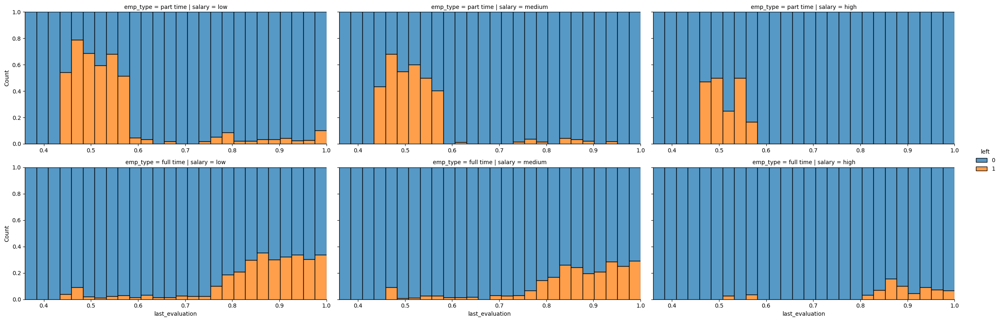

In [90]:
############################################
#last_evaluation by left
#keep emp_type and salary constant
############################################
g=sns.displot(
    data=df_drop, x='last_evaluation',  hue='left',row="emp_type",col='salary',
    kind="hist", height=4, aspect=2, multiple='fill',
    facet_kws=dict(sharex=False)
)

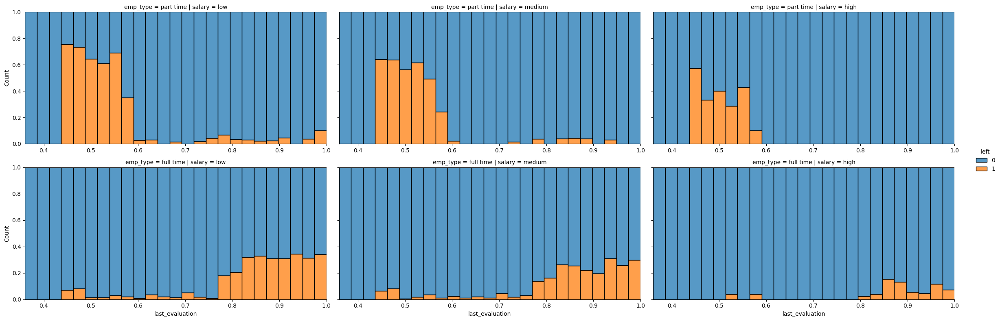

In [91]:
############################################
#last_evaluation by left
#keep emp_type and salary constant
#promotion_last_5years=0
############################################
mask=df_drop['promotion_last_5years']==0
g=sns.displot(
    data=df_drop[mask], x='last_evaluation',  hue='left',row="emp_type",col='salary',
    kind="hist", height=4, aspect=2, multiple='fill',
    facet_kws=dict(sharex=False)
)

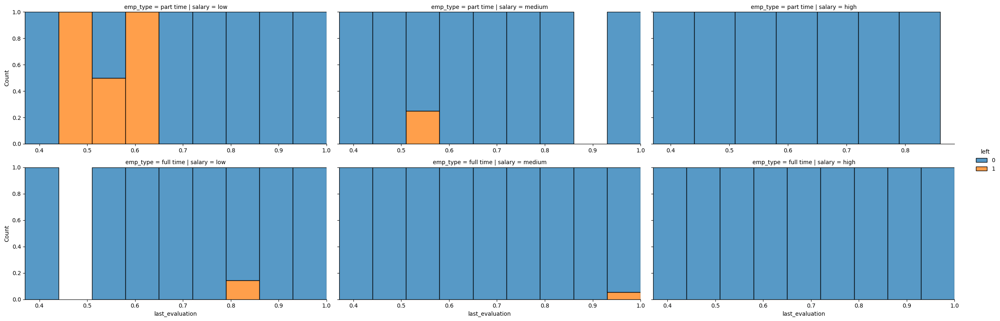

In [92]:
############################################
#last_evaluation by left
#keep emp_type and salary constant
#promotion_last_5years=1
############################################
mask=df_drop['promotion_last_5years']==1
g=sns.displot(
    data=df_drop[mask], x='last_evaluation',  hue='left',row="emp_type",col='salary',
    kind="hist", height=4, aspect=2, multiple='fill',
    facet_kws=dict(sharex=False)
)

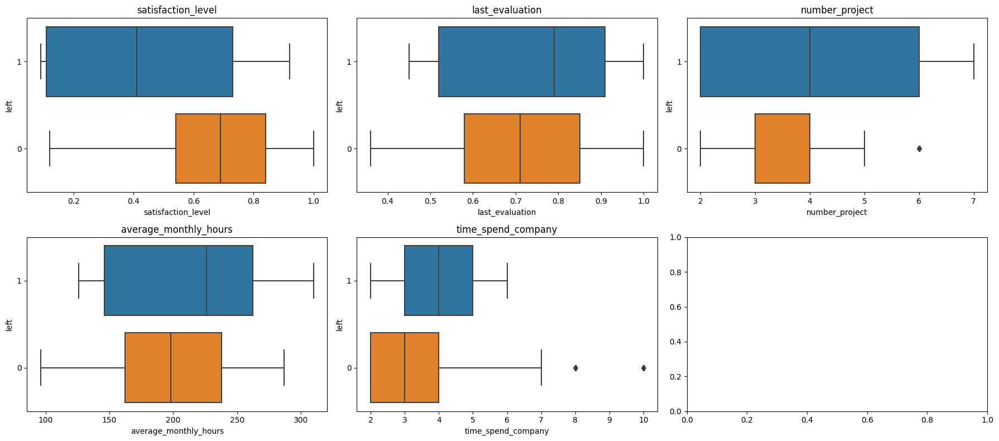

In [93]:
############################################
#Box plot of features
############################################
chk_columns=['satisfaction_level', 'last_evaluation', 'number_project',
       'average_monthly_hours', 'time_spend_company']

rowCnt=math.ceil(len(chk_columns)/3)

fig, axes=plt.subplots(rowCnt,3,figsize=(18,rowCnt*4))
for col,ax in zip(chk_columns, axes.ravel()):
    sns.boxplot(data=df_drop, y=df_drop['left'].astype(str), x=col, ax=ax)
    ax.set_title(col)

plt.tight_layout()
plt.show()



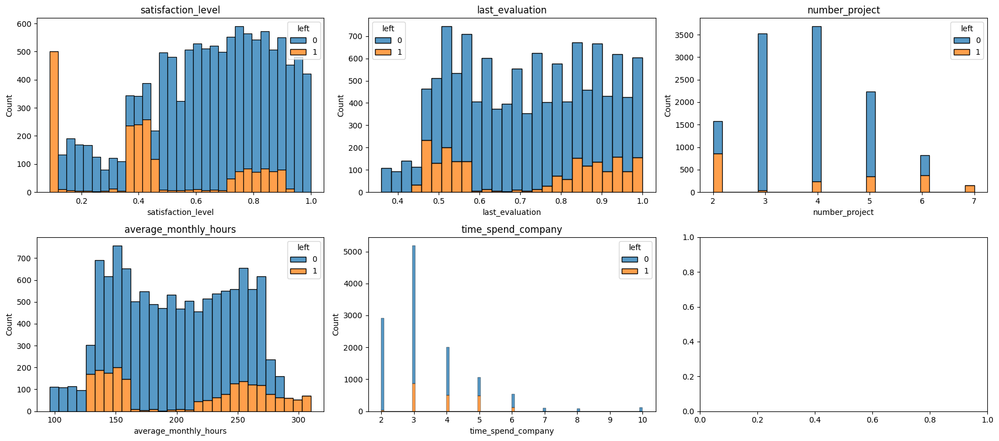

In [94]:
chk_columns=['satisfaction_level', 'last_evaluation', 'number_project',
       'average_monthly_hours', 'time_spend_company']

rowCnt=math.ceil(len(chk_columns)/3)

fig, axes=plt.subplots(rowCnt,3,figsize=(18,rowCnt*4))
for col,ax in zip(chk_columns, axes.ravel()):
    sns.histplot(data=df_drop, x=col, multiple='stack', hue='left',ax=ax)
    ax.set_title(col)

plt.tight_layout()
plt.show()

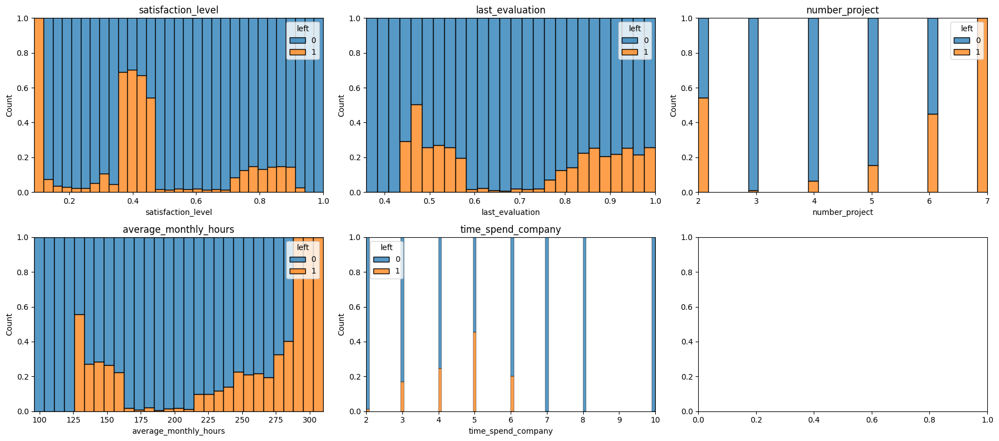

In [95]:
chk_columns=['satisfaction_level', 'last_evaluation', 'number_project',
       'average_monthly_hours', 'time_spend_company']

rowCnt=math.ceil(len(chk_columns)/3)

fig, axes=plt.subplots(rowCnt,3,figsize=(18,rowCnt*4))
for col,ax in zip(chk_columns, axes.ravel()):
    sns.histplot(data=df_drop, x=col, multiple='fill', hue='left',ax=ax)
    ax.set_title(col)

plt.tight_layout()
plt.show()

#### number_project

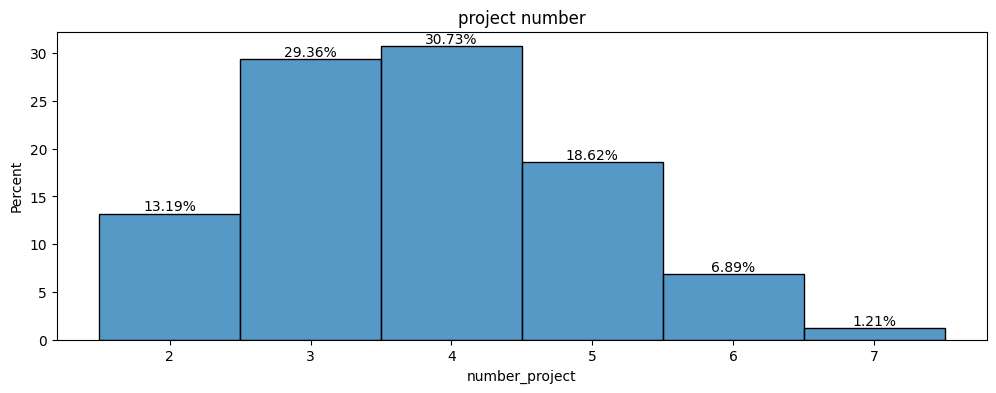

In [96]:
plt.figure(figsize=(12,4))
ax=sns.histplot(data=df_drop,x='number_project',stat='percent',discrete=True)
for container in ax.containers:
    ax.bar_label(container, fmt='%.2f%%')
plt.title(f"project number")
plt.show()

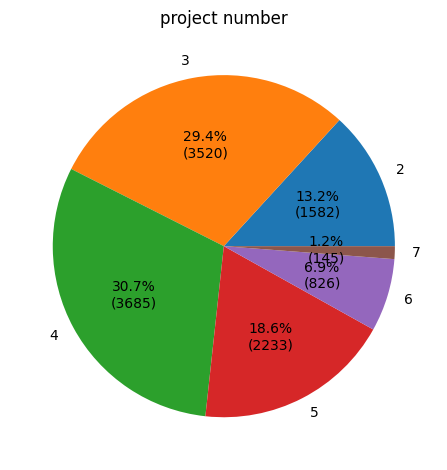

In [97]:
result=df_drop.groupby(['number_project'])[['left']].count().reset_index().rename(columns={'left':'count'})
plt.pie(result['count'],labels = result["number_project"], autopct=autopct_format(result['count']))
plt.title(f"project number")
plt.tight_layout()
plt.show()

##### number_project vs time_spend_company

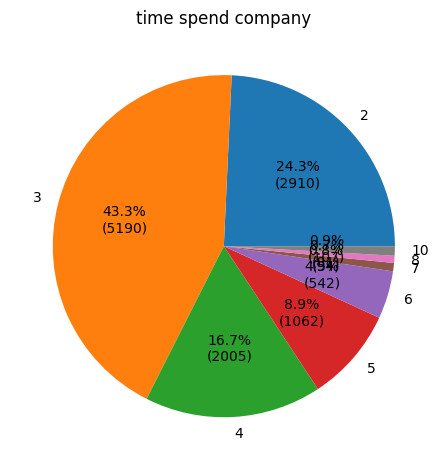

In [98]:
result=df_drop.groupby(['time_spend_company'])[['left']].count().reset_index().rename(columns={'left':'count'})
plt.pie(result['count'],labels = result["time_spend_company"], autopct=autopct_format(result['count']))
plt.title(f"time spend company")
plt.tight_layout()
plt.show()

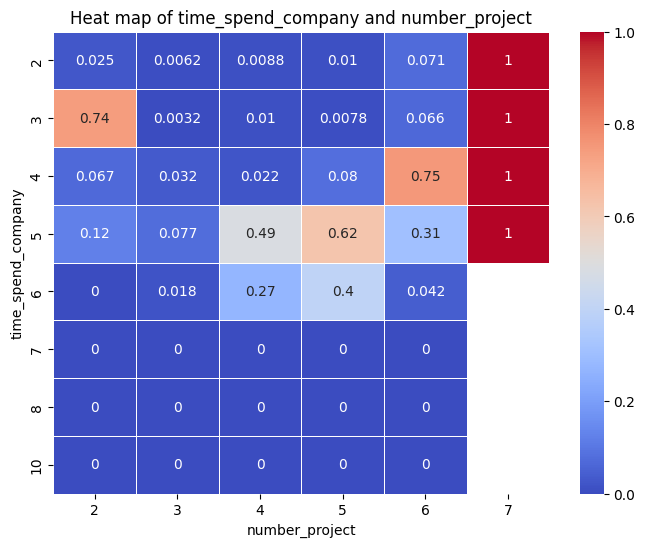

In [99]:
#########################################
#time_spend_company and number_project
#########################################
plt.figure(figsize=(8,6))
df_heatmap = df_drop.pivot_table(values='left',index='time_spend_company',columns='number_project',aggfunc=np.mean)
sns.heatmap(df_heatmap,annot=True, vmin=0, vmax=1,cmap="coolwarm", linewidth=.5)
plt.title('Heat map of time_spend_company and number_project')
plt.show()

In [100]:
#$H_{0}$: No association between time_spend_company and number_project
#$H_{A}$: There is an association between time_spend_company salary and number_project
result=pd.crosstab(df_drop['time_spend_company'], df_drop['number_project'])
display(result)

significance_level=0.01

statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(result, correction=False)

show_test_result(statistic, pvalue,significance_level)

number_project,2,3,4,5,6,7
time_spend_company,,,,,,
2,200,1133,1019,501,56,1
3,1129,1577,1590,770,121,3
4,119,475,503,374,414,120
5,66,117,326,385,147,21
6,49,111,154,156,72,0
7,8,29,32,19,6,0
8,6,31,23,17,4,0
10,5,47,38,11,6,0


Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=2470.86)


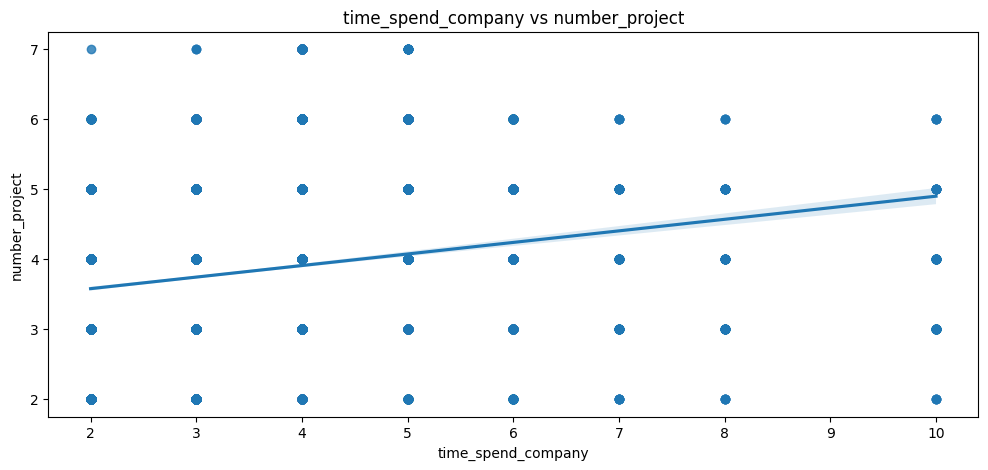

In [101]:
#########################################
#time_spend_company and number_project
#########################################
plt.figure(figsize=(12,5))
sns.regplot(data=df_drop, x="time_spend_company", y="number_project")
plt.title('time_spend_company vs number_project')
plt.show()

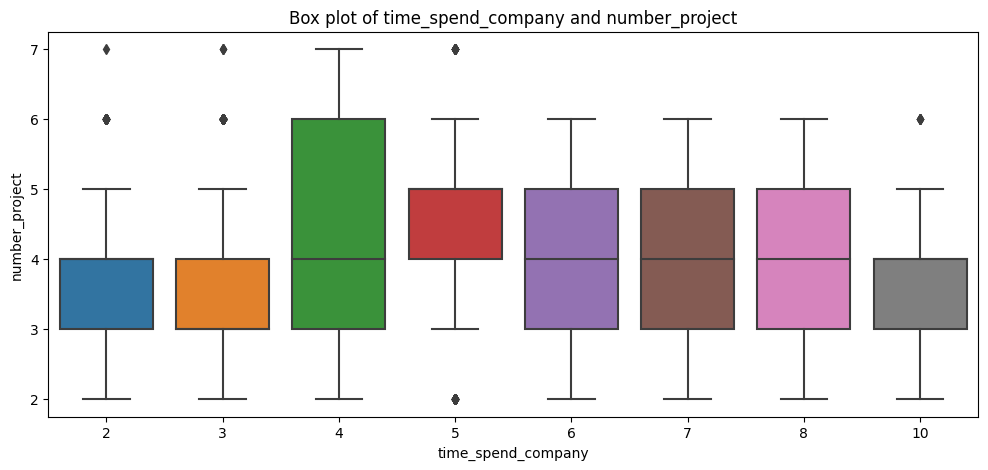

In [102]:
#########################################
#box plot
#time_spend_company and number_project
#########################################
plt.figure(figsize=(12,5))
sns.boxplot(
    data=df_drop, x="time_spend_company",  y="number_project",
    
)
plt.title('Box plot of time_spend_company and number_project')
plt.show()

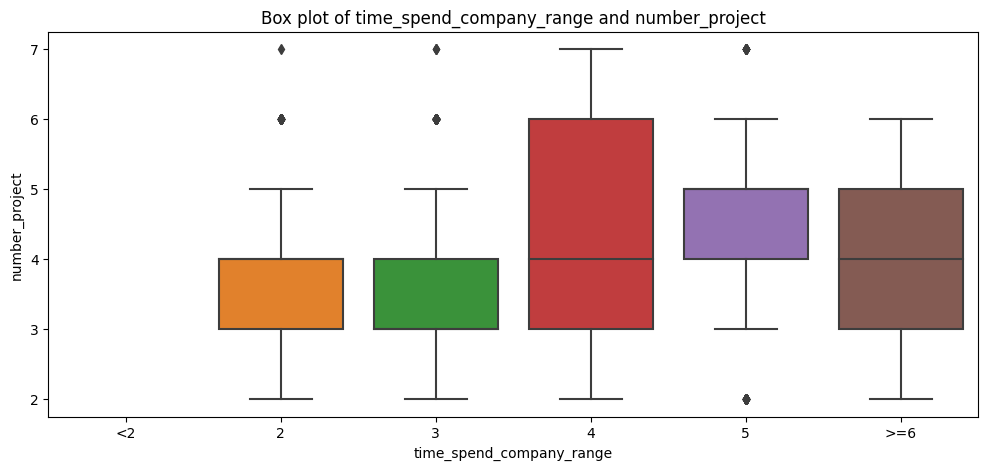

In [103]:
#########################################
#box plot
#time_spend_company_range and number_project
#########################################
plt.figure(figsize=(12,5))
sns.boxplot(
    data=df_drop, x="time_spend_company_range",  y="number_project",
    
)
plt.title('Box plot of time_spend_company_range and number_project')
plt.show()

time_spend_company,number_project,2,3,4,5,6,7,8,10
0,2,200,1129,119,66,49,8,6,5
1,3,1133,1577,475,117,111,29,31,47
2,4,1019,1590,503,326,154,32,23,38
3,5,501,770,374,385,156,19,17,11
4,6,56,121,414,147,72,6,4,6
5,7,1,3,120,21,0,0,0,0


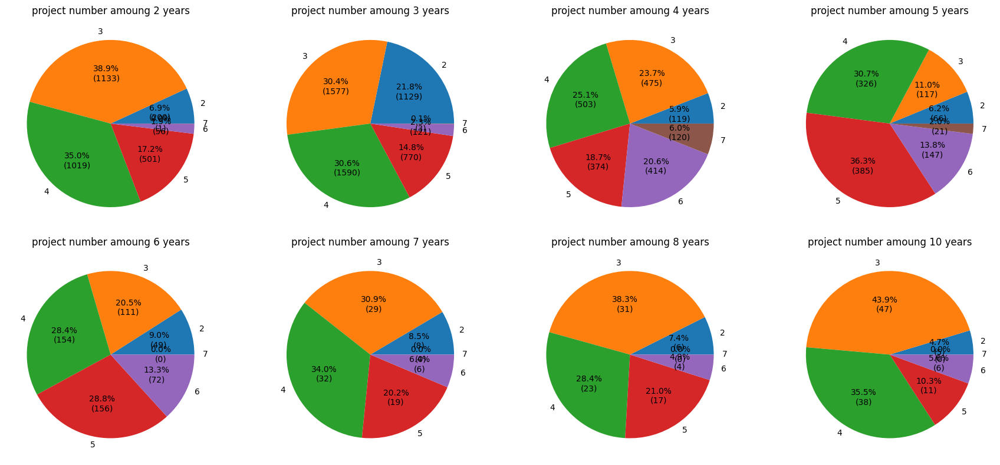

In [104]:
#######################################
#P(number_project | time_spend_company)
#######################################
result=pd.crosstab(df_drop['number_project'],df_drop['time_spend_company'],margins=False).reset_index()

display(result)
col_nm=df_drop['time_spend_company'].unique().tolist()
col_nm.sort()

#######################################
#Pie Chart
#######################################
colCnt=4
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["number_project"], autopct=autopct_format(result[col]))
    ax.set_title(f"project number amoung {col} years")
plt.tight_layout()
plt.show()

number_project,time_spend_company,2,3,4,5,6,7
0,2,200,1133,1019,501,56,1
1,3,1129,1577,1590,770,121,3
2,4,119,475,503,374,414,120
3,5,66,117,326,385,147,21
4,6,49,111,154,156,72,0
5,7,8,29,32,19,6,0
6,8,6,31,23,17,4,0
7,10,5,47,38,11,6,0


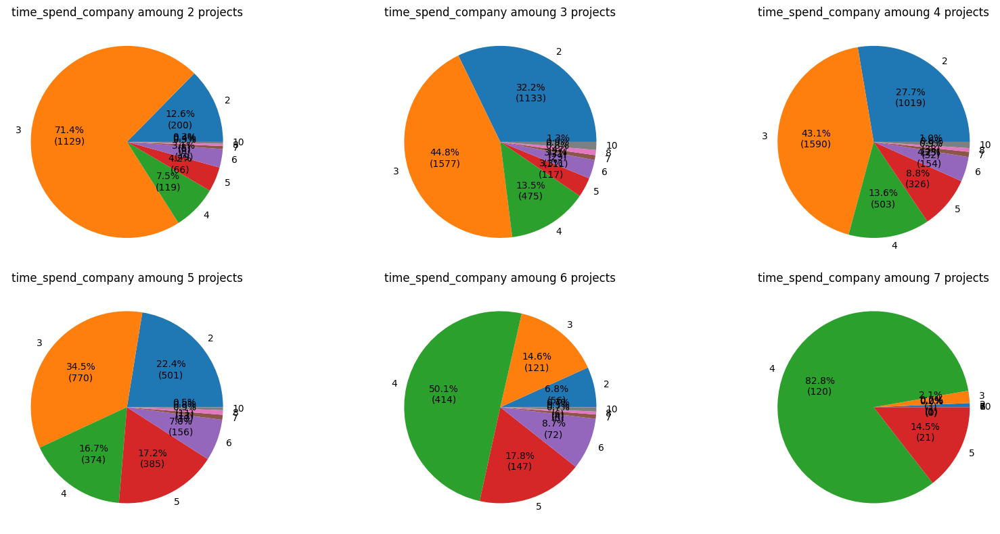

In [105]:
#######################################
#P(time_spend_company | number_project)
#######################################
result=pd.crosstab(df_drop['time_spend_company'],df_drop['number_project'],margins=False).reset_index()

display(result)
col_nm=df_drop['number_project'].unique().tolist()
col_nm.sort()

#######################################
#Pie Chart
#######################################
colCnt=3
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["time_spend_company"], autopct=autopct_format(result[col]))
    ax.set_title(f"time_spend_company amoung {col} projects")
plt.tight_layout()
plt.show()

#=>amoung 7 projects, most of them were 4 years in company, then 5 years
#=>amoung 2 projects, most of them were 3 years in company, then 2 years

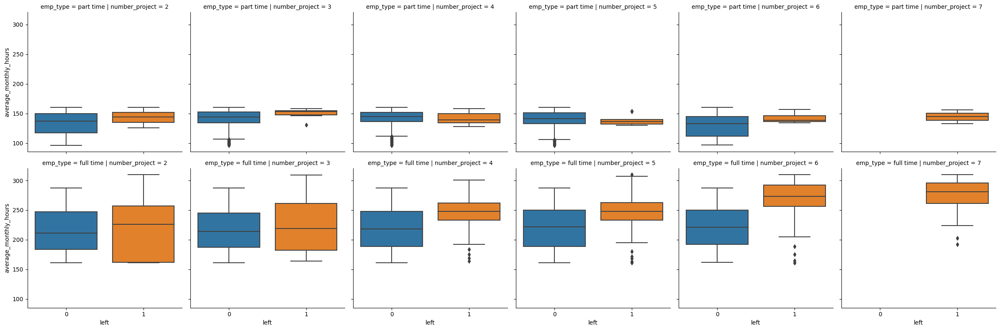

In [106]:
#############################################
#average_monthly_hours by number_project
#keep emp_type constant
#############################################
sns.catplot(
    data=df_drop, x='left',y="average_monthly_hours",  col="number_project",
    kind="box", height=4, aspect=1,row='emp_type',
)
plt.show()

In [107]:
df_drop.groupby(['emp_type',"time_spend_company"])['average_monthly_hours'].agg(['min','max','std','mean','median','count'])

min  max        std        mean  median  count
emp_type  time_spend_company                                                
full time 2                   161  296  33.666718  217.002670   216.0   2247
          3                   161  310  34.429141  217.359544   217.0   3332
          4                   161  310  40.266315  234.886068   241.0   1615
          5                   161  310  33.517986  236.797251   243.0    873
          6                   161  293  33.501975  230.292453   234.0    424
          7                   161  286  35.603010  219.944444   215.0     72
          8                   162  279  33.302154  220.196429   218.0     56
          10                  162  284  35.483835  221.766234   221.0     77
part time 2                    96  160  14.403831  141.720965   144.0    663
          3                    96  160  12.694151  142.348224   144.0   1858
          4                    96  160  17.940270  137.538462   142.0    390
          5                    98  160  18.828463  132.370370   134.0    189
          6                    97  160  19.889178  129.957627   133.5    118
          7                   102  158  19.656355  137.909091   145.0     22
          8                   100  158  16.982147  134.680000   139.0     25
          10                  108  160  12.625872  141.366667   143.0     30

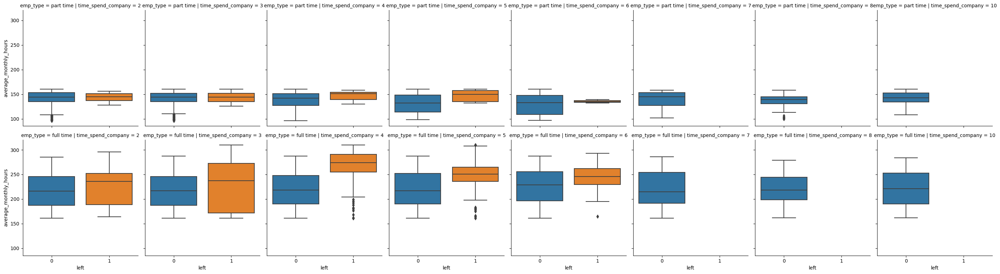

In [108]:
#############################################
#average_monthly_hours by time_spend_company
#keep emp_type constant
#############################################
sns.catplot(
    data=df_drop, x='left',y="average_monthly_hours",  col="time_spend_company",
    kind="box", height=4, aspect=0.9,row='emp_type',
)
plt.show()
#=>in most case, left employees had higher median average_monthly_hours

##### number_project vs work_accident

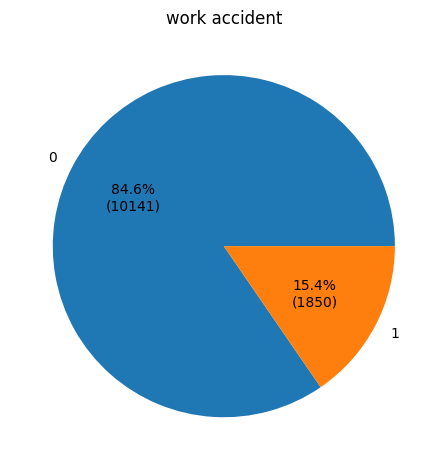

In [109]:
result=df_drop.groupby(['work_accident'])[['left']].count().reset_index().rename(columns={'left':'count'})
plt.pie(result['count'],labels = result["work_accident"], autopct=autopct_format(result['count']))
plt.title(f"work accident")
plt.tight_layout()
plt.show()

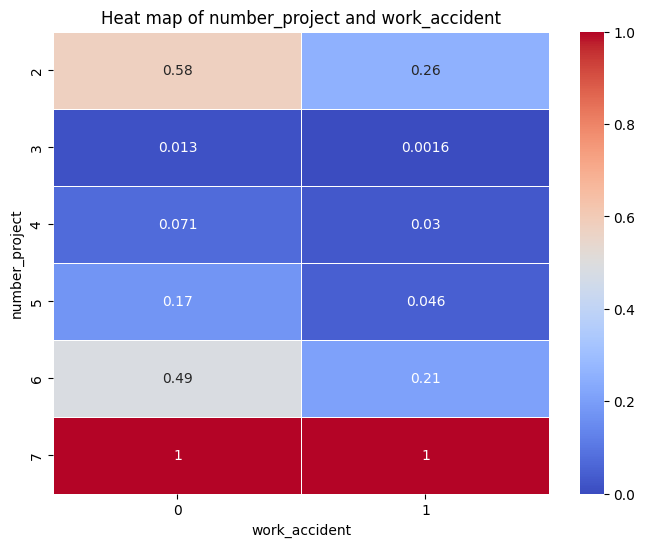

In [110]:
#########################################
#number_project and work_accident
#########################################
plt.figure(figsize=(8,6))
df_heatmap = df_drop.pivot_table(values='left',index='number_project',columns='work_accident',aggfunc=np.mean)
sns.heatmap(df_heatmap,annot=True, vmin=0, vmax=1,cmap="coolwarm", linewidth=.5)
plt.title('Heat map of number_project and work_accident')
plt.show()

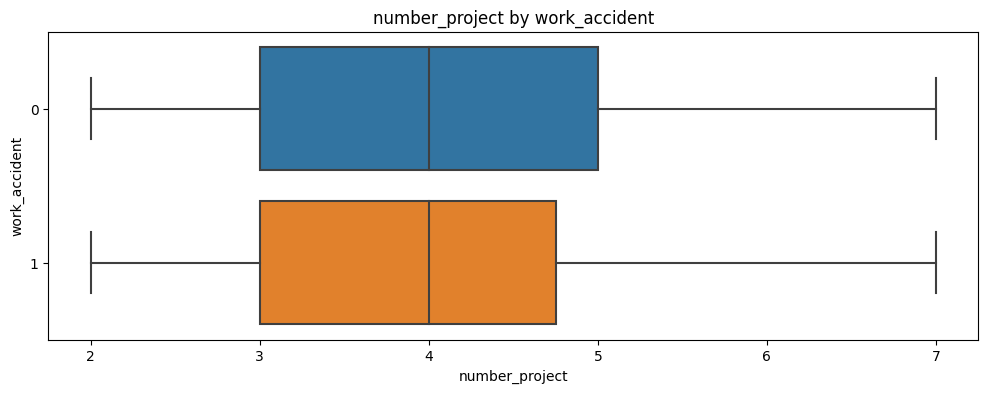

In [111]:
#############################################
#show number_project by work_accident
#############################################
plt.figure(figsize=(12,4))

sns.boxplot(data=df_drop,y=df_drop['work_accident'].astype(str),x='number_project')
plt.title('number_project by work_accident')
plt.show()

In [112]:
#$H_{0}$: No association between number_project and work_accident
#$H_{A}$: There is an association between number_project salary and work_accident
result=pd.crosstab(df_drop['number_project'], df_drop['work_accident'])
display(result)

significance_level=0.01

statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(result, correction=False)

show_test_result(statistic, pvalue,significance_level)

work_accident,0,1
number_project,,
2,1406,176
3,2901,619
4,3093,592
5,1883,350
6,715,111
7,143,2


Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=60.69)


work_accident,number_project,0,1
0,2,1406,176
1,3,2901,619
2,4,3093,592
3,5,1883,350
4,6,715,111
5,7,143,2


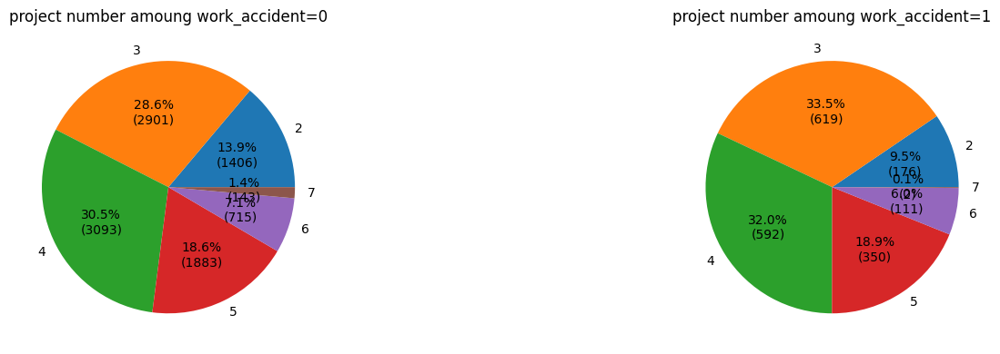

In [113]:
#######################################
#P(number_project | work_accident)
#######################################
result=pd.crosstab(df_drop['number_project'],df_drop['work_accident'],margins=False).reset_index()

display(result)
col_nm=df_drop['work_accident'].unique().tolist()

#######################################
#Pie Chart
#######################################
colCnt=2
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["number_project"], autopct=autopct_format(result[col]))
    ax.set_title(f"project number amoung work_accident={col}")
plt.tight_layout()
plt.show()

number_project,work_accident,2,3,4,5,6,7
0,0,1406,2901,3093,1883,715,143
1,1,176,619,592,350,111,2


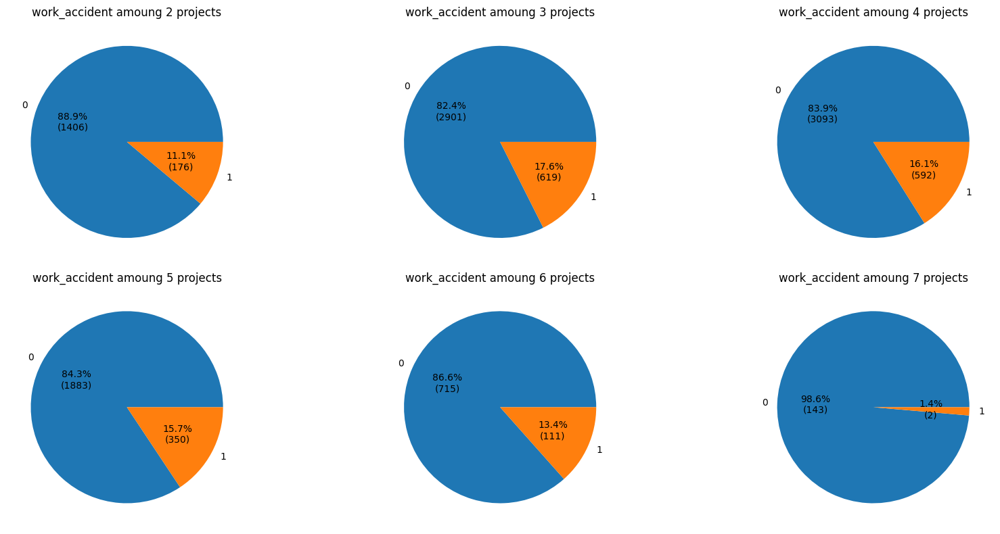

In [114]:
#######################################
#P(work_accident | number_project)
#######################################
result=pd.crosstab(df_drop['work_accident'],df_drop['number_project'],margins=False).reset_index()

display(result)
col_nm=df_drop['number_project'].unique().tolist()
col_nm.sort()

#######################################
#Pie Chart
#######################################
colCnt=3
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["work_accident"], autopct=autopct_format(result[col]))
    ax.set_title(f"work_accident amoung {col} projects")
plt.tight_layout()
plt.show()

##### number_project vs promotion_last_5years

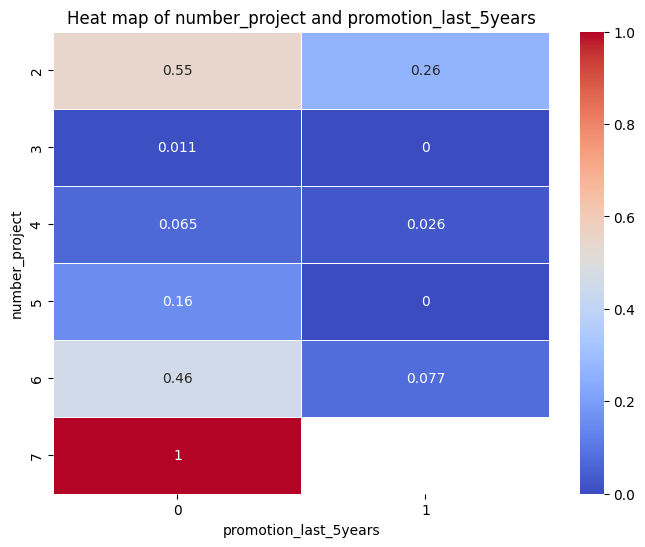

In [115]:
#########################################
#number_project and promotion_last_5years
#########################################
plt.figure(figsize=(8,6))
df_heatmap = df_drop.pivot_table(values='left',index='number_project',columns='promotion_last_5years',aggfunc=np.mean)
sns.heatmap(df_heatmap,annot=True, vmin=0, vmax=1,cmap="coolwarm", linewidth=.5)
plt.title('Heat map of number_project and promotion_last_5years')
plt.show()

In [116]:
#$H_{0}$: No association between number_project and promotion_last_5years
#$H_{A}$: There is an association between number_project salary and promotion_last_5years
result=pd.crosstab(df_drop['number_project'], df_drop['promotion_last_5years'])
display(result)

significance_level=0.01

statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(result, correction=False)

show_test_result(statistic, pvalue,significance_level)

promotion_last_5years,0,1
number_project,,
2,1563,19
3,3458,62
4,3609,76
5,2200,33
6,813,13
7,145,0


Fail to reject H0 at significance level 0.01 (Pvalue=0.126, Statistic=8.61)


promotion_last_5years,number_project,0,1
0,2,1563,19
1,3,3458,62
2,4,3609,76
3,5,2200,33
4,6,813,13
5,7,145,0


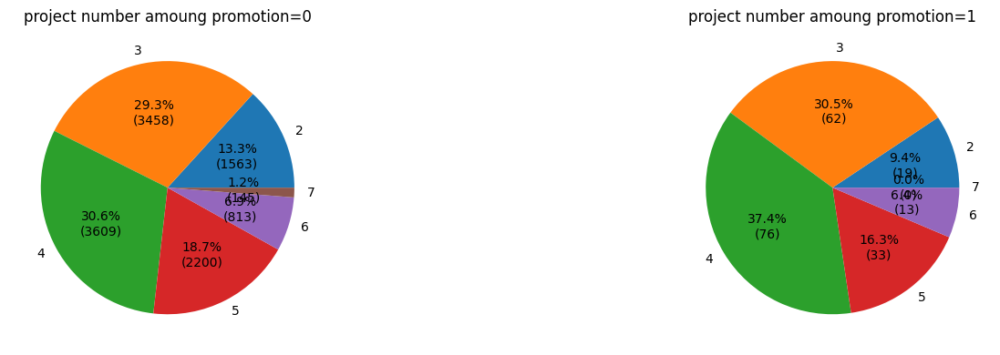

In [117]:
#######################################
#P(number_project | promotion_last_5years)
#######################################
result=pd.crosstab(df_drop['number_project'],df_drop['promotion_last_5years'],margins=False).reset_index()

display(result)
col_nm=df_drop['promotion_last_5years'].unique().tolist()

#######################################
#Pie Chart
#######################################
colCnt=2
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["number_project"], autopct=autopct_format(result[col]))
    ax.set_title(f"project number amoung promotion={col}")
plt.tight_layout()
plt.show()

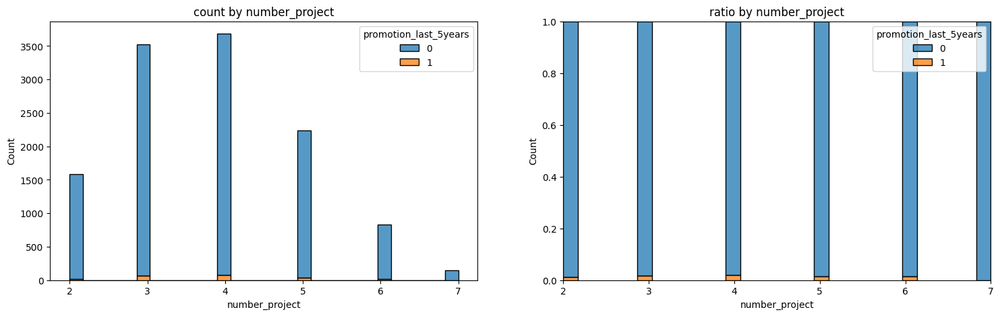

In [118]:
############################################
#number_project by promotion_last_5years
############################################
fig, axs = plt.subplots(1,2,figsize=(18,5))
sns.histplot(data=df_drop,hue='promotion_last_5years',x='number_project',palette='tab10',multiple='stack',ax=axs[0])
axs[0].set_title('count by number_project')
sns.histplot(data=df_drop,hue='promotion_last_5years',x='number_project',palette='tab10',multiple='fill',ax=axs[1])
axs[1].set_title('ratio by number_project')
plt.show()

number_project,promotion_last_5years,2,3,4,5,6,7
0,0,1563,3458,3609,2200,813,145
1,1,19,62,76,33,13,0


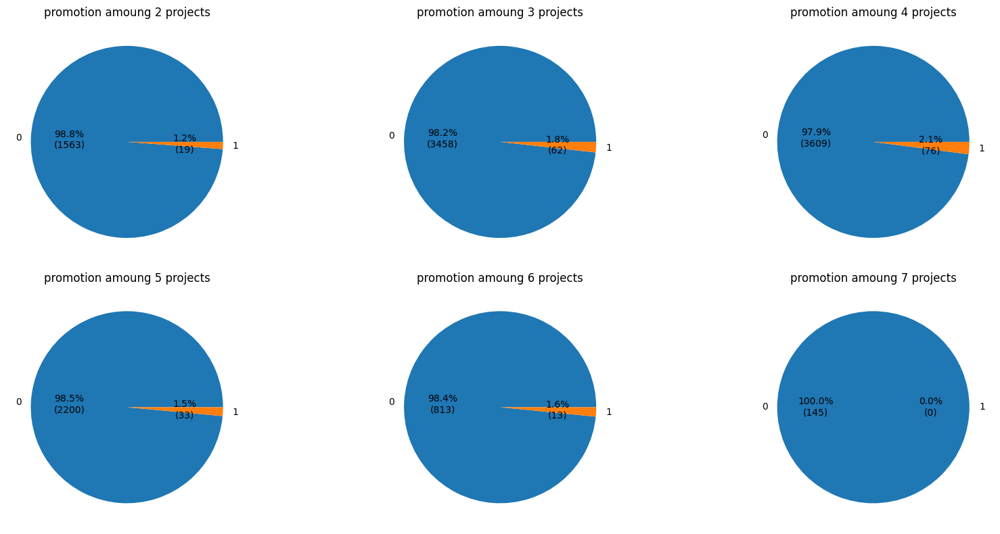

In [119]:
############################################
#P(promotion_last_5years | number_project)
############################################
result=pd.crosstab(df_drop['promotion_last_5years'],df_drop['number_project'],margins=False).reset_index()

display(result)
col_nm=df_drop['number_project'].unique().tolist()
col_nm.sort()

#######################################
#Pie Chart
#######################################
colCnt=3
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["promotion_last_5years"], autopct=autopct_format(result[col]))
    ax.set_title(f"promotion amoung {col} projects")
plt.tight_layout()
plt.show()

##### number_project vs department

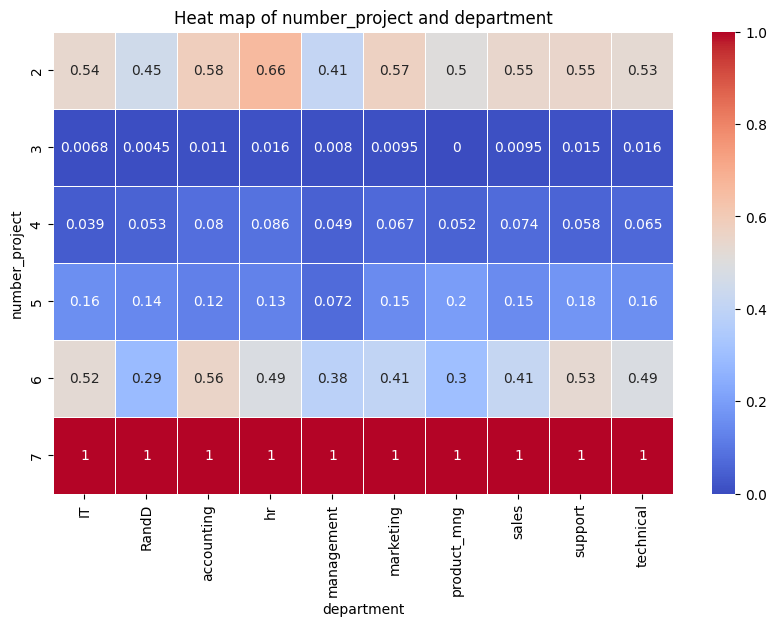

In [120]:
#########################################
#number_project and department
#########################################
plt.figure(figsize=(10,6))
df_heatmap = df_drop.pivot_table(values='left',index='number_project',columns='department',aggfunc=np.mean)
sns.heatmap(df_heatmap,annot=True, vmin=0, vmax=1,cmap="coolwarm", linewidth=.5)
plt.title('Heat map of number_project and department')
plt.show()

In [121]:
#$H_{0}$: No association between number_project and department
#$H_{A}$: There is an association between number_project salary and department
result=pd.crosstab(df_drop['number_project'], df_drop['department'])
display(result)

significance_level=0.01

statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(result, correction=False)

show_test_result(statistic, pvalue,significance_level)

department,IT,RandD,accounting,hr,management,marketing,product_mng,sales,support,technical
number_project,,,,,,,,,,
2,129,71,77,88,51,96,101,460,227,282
3,295,221,182,193,125,210,190,945,528,631
4,282,206,188,197,144,208,213,988,568,691
5,197,140,123,79,83,113,121,584,359,434
6,61,49,43,37,26,37,53,227,120,173
7,12,7,8,7,7,9,8,35,19,33


Fail to reject H0 at significance level 0.01 (Pvalue=0.367, Statistic=47.61)


department,number_project,IT,RandD,accounting,hr,management,marketing,product_mng,sales,support,technical
0,2,129,71,77,88,51,96,101,460,227,282
1,3,295,221,182,193,125,210,190,945,528,631
2,4,282,206,188,197,144,208,213,988,568,691
3,5,197,140,123,79,83,113,121,584,359,434
4,6,61,49,43,37,26,37,53,227,120,173
5,7,12,7,8,7,7,9,8,35,19,33


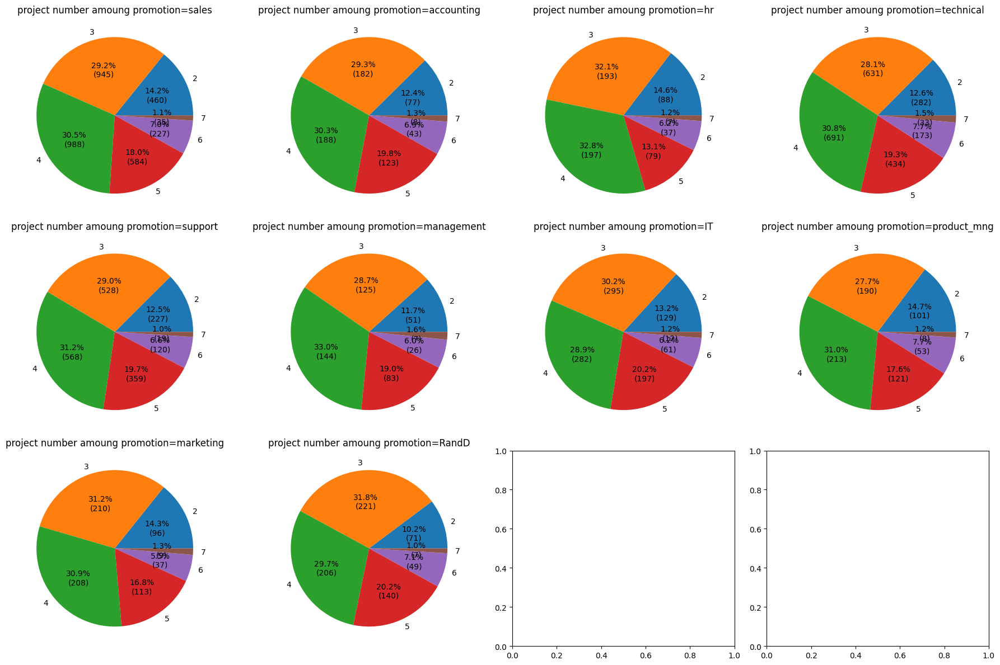

In [122]:
#######################################
#P(number_project | department)
#######################################
result=pd.crosstab(df_drop['number_project'],df_drop['department'],margins=False).reset_index()

display(result)
col_nm=df_drop['department'].unique().tolist()

#######################################
#Pie Chart
#######################################
colCnt=4
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["number_project"], autopct=autopct_format(result[col]))
    ax.set_title(f"project number amoung promotion={col}")
plt.tight_layout()
plt.show()

number_project,department,2,3,4,5,6,7
0,IT,129,295,282,197,61,12
1,RandD,71,221,206,140,49,7
2,accounting,77,182,188,123,43,8
3,hr,88,193,197,79,37,7
4,management,51,125,144,83,26,7
5,marketing,96,210,208,113,37,9
6,product_mng,101,190,213,121,53,8
7,sales,460,945,988,584,227,35
8,support,227,528,568,359,120,19
9,technical,282,631,691,434,173,33


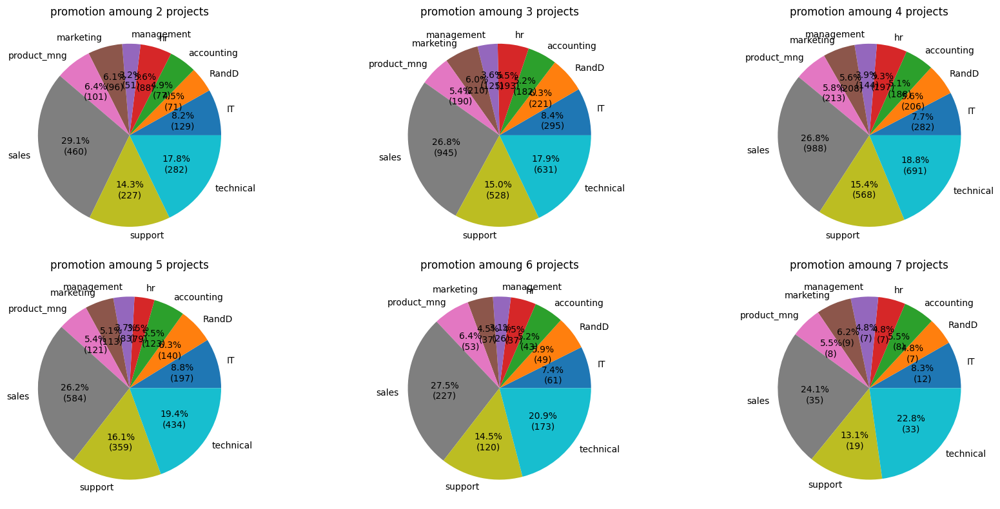

In [123]:
############################################
#P(department | number_project)
############################################
result=pd.crosstab(df_drop['department'],df_drop['number_project'],margins=False).reset_index()

display(result)
col_nm=df_drop['number_project'].unique().tolist()
col_nm.sort()

#######################################
#Pie Chart
#######################################
colCnt=3
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["department"], autopct=autopct_format(result[col]))
    ax.set_title(f"promotion amoung {col} projects")
plt.tight_layout()
plt.show()

##### number_project vs salary

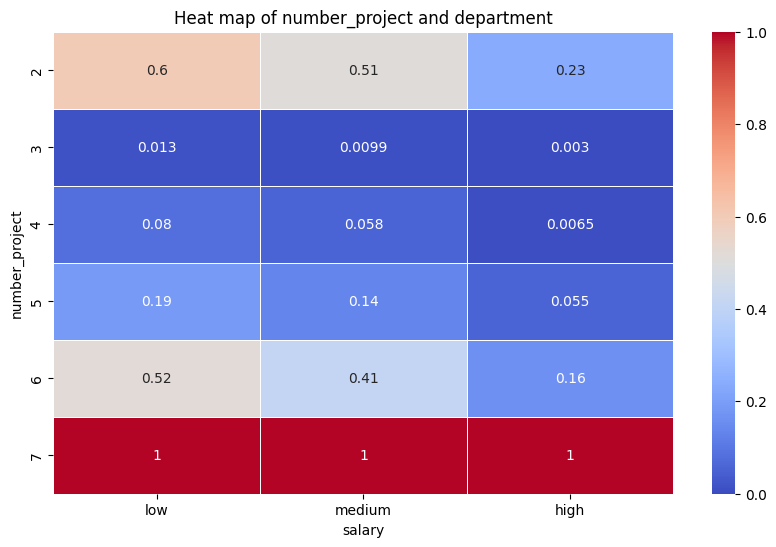

In [124]:
#########################################
#number_project and salary
#########################################
plt.figure(figsize=(10,6))
df_heatmap = df_drop.pivot_table(values='left',index='number_project',columns='salary',aggfunc=np.mean)
sns.heatmap(df_heatmap,annot=True, vmin=0, vmax=1,cmap="coolwarm", linewidth=.5)
plt.title('Heat map of number_project and department')
plt.show()

In [125]:
#$H_{0}$: No association between number_project and salary
#$H_{A}$: There is an association between number_project and salary

result=pd.crosstab(df_drop['number_project'], df_drop['salary'])
display(result)
#plt.figure(figsize=(10,6))
#sns.heatmap(result,annot=True, cmap="Greens", linewidth=.5, fmt=".1f")
#plt.title('count of number_project and salary')
#plt.show()

significance_level=0.01
statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(result, correction=False)
show_test_result(statistic, pvalue,significance_level)

salary,low,medium,high
number_project,,,
2,854,630,98
3,1577,1615,328
4,1754,1625,306
5,1045,988,200
6,428,342,56
7,82,61,2


Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=60.13)


salary,number_project,low,medium,high
0,2,854,630,98
1,3,1577,1615,328
2,4,1754,1625,306
3,5,1045,988,200
4,6,428,342,56
5,7,82,61,2


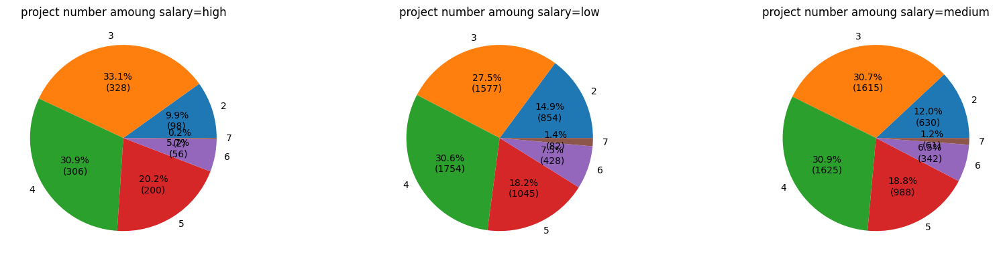

In [126]:
#######################################
#P(number_project | salary)
#######################################
result=pd.crosstab(df_drop['number_project'],df_drop['salary'],margins=False).reset_index()

display(result)
col_nm=df_drop['salary'].unique().tolist()
col_nm.sort()

#######################################
#Pie Chart
#######################################
colCnt=3
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["number_project"], autopct=autopct_format(result[col]))
    ax.set_title(f"project number amoung salary={col}")
plt.tight_layout()
plt.show()

number_project,salary,2,3,4,5,6,7
0,low,854,1577,1754,1045,428,82
1,medium,630,1615,1625,988,342,61
2,high,98,328,306,200,56,2


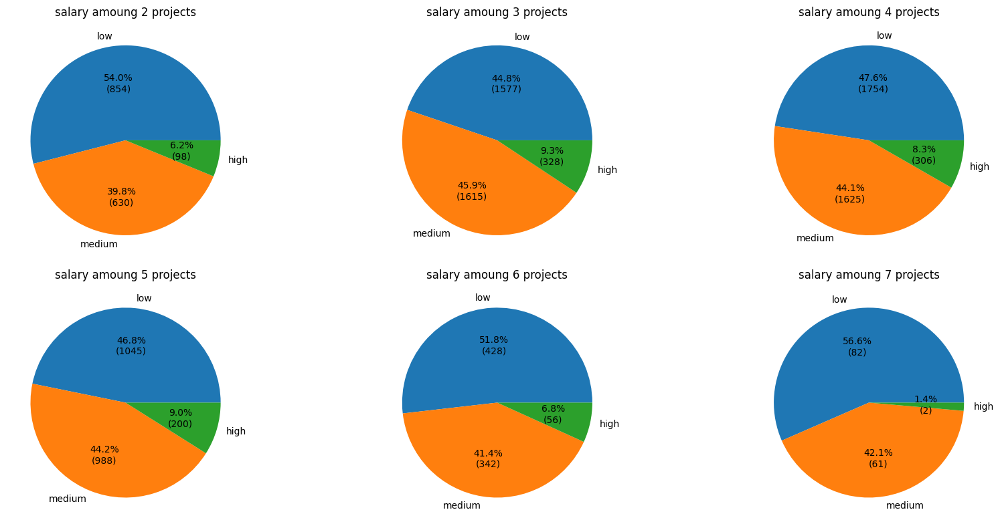

In [127]:
############################################
#P(salary | number_project)
############################################
result=pd.crosstab(df_drop['salary'],df_drop['number_project'],margins=False).reset_index()

display(result)
col_nm=df_drop['number_project'].unique().tolist()
col_nm.sort()

#######################################
#Pie Chart
#######################################
colCnt=3
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["salary"], autopct=autopct_format(result[col]))
    ax.set_title(f"salary amoung {col} projects")
plt.tight_layout()
plt.show()

In [128]:
#post hoc test for proportion 

#https://www.statsmodels.org/dev/generated/statsmodels.stats.proportion.proportions_ztest.html
#$H_{0}$: low salary proportion of all number_project were identical
#$H_{A}$: at least one low salary proportion of number_project were not identical
significance_level=0.01

print('proportions_ztest test result of satisfaction_level')
results = {}
cal_result=pd.crosstab(df_drop['number_project'], df_drop['salary']).reset_index()
cal_result['All']=cal_result['low']+cal_result['medium']+cal_result['high']
display(cal_result)

for i, item1 in enumerate(sorted(cal_result['number_project'].unique().tolist())):
    for j, item2 in enumerate(sorted(cal_result['number_project'].unique().tolist())):
        if i < j:
            
            statistic, pvalue = proportions_ztest(cal_result[cal_result['number_project'].isin([item1,item2])]['low'],
                                                 cal_result[cal_result['number_project'].isin([item1,item2])]['All'])
            if pvalue<=significance_level:
                result='Reject H0'
            else:
                result='Fail reject'
            results[f"{item1} vs {item2}"] = (statistic, pvalue ,result)

# Convert the results into a DataFrame
result_df = pd.DataFrame(results).transpose()
result_df.columns = ['Statistic', 'Pvalue','Result']
result_df.reset_index(inplace=True)
result_df.rename(columns={'index': 'project_number_compared'}, inplace=True)

result_df
#2 and 6,7
#3 and 4,5
#4 and 5,6,7
#5 and 5,7
#6 and 7

proportions_ztest test result of satisfaction_level


salary,number_project,low,medium,high,All
0,2,854,630,98,1582
1,3,1577,1615,328,3520
2,4,1754,1625,306,3685
3,5,1045,988,200,2233
4,6,428,342,56,826
5,7,82,61,2,145


,project_number_compared,Statistic,Pvalue,Result
0,2 vs 3,6.073138,0.0,Reject H0
1,2 vs 4,4.247944,0.000022,Reject H0
2,2 vs 5,4.372375,0.000012,Reject H0
3,2 vs 6,1.011419,0.311816,Fail reject
4,2 vs 7,-0.594351,0.552277,Fail reject
5,3 vs 4,-2.380504,0.017289,Fail reject
6,3 vs 5,-1.48204,0.13833,Fail reject
7,3 vs 6,-3.639706,0.000273,Reject H0
8,3 vs 7,-2.785885,0.005338,Reject H0
9,4 vs 5,0.597747,0.550009,Fail reject


In [129]:
#post hoc test for proportion 

#https://www.statsmodels.org/dev/generated/statsmodels.stats.proportion.proportions_ztest.html
#$H_{0}$: high salary proportion of all number_project were identical
#$H_{A}$: at least one high salary proportion of number_project were not identical
significance_level=0.01

print('proportions_ztest test result of satisfaction_level')
results = {}
cal_result=pd.crosstab(df_drop['number_project'], df_drop['salary']).reset_index()
cal_result['All']=cal_result['low']+cal_result['medium']+cal_result['high']
display(cal_result)

for i, item1 in enumerate(sorted(cal_result['number_project'].unique().tolist())):
    for j, item2 in enumerate(sorted(cal_result['number_project'].unique().tolist())):
        if i < j:
            
            statistic, pvalue = proportions_ztest(cal_result[cal_result['number_project'].isin([item1,item2])]['high'],
                                                 cal_result[cal_result['number_project'].isin([item1,item2])]['All'])
            if pvalue<=significance_level:
                result='Reject H0'
            else:
                result='Fail reject'
            results[f"{item1} vs {item2}"] = (statistic, pvalue ,result)

# Convert the results into a DataFrame
result_df = pd.DataFrame(results).transpose()
result_df.columns = ['Statistic', 'Pvalue','Result']
result_df.reset_index(inplace=True)
result_df.rename(columns={'index': 'project_number_compared'}, inplace=True)

result_df

proportions_ztest test result of satisfaction_level


salary,number_project,low,medium,high,All
0,2,854,630,98,1582
1,3,1577,1615,328,3520
2,4,1754,1625,306,3685
3,5,1045,988,200,2233
4,6,428,342,56,826
5,7,82,61,2,145


,project_number_compared,Statistic,Pvalue,Result
0,2 vs 3,-3.730294,0.000191,Reject H0
1,2 vs 4,-2.636864,0.008368,Reject H0
2,2 vs 5,-3.131871,0.001737,Reject H0
3,2 vs 6,-0.556953,0.57756,Fail reject
4,2 vs 7,2.37613,0.017495,Fail reject
5,3 vs 4,1.519114,0.128734,Fail reject
6,3 vs 5,0.462974,0.643383,Fail reject
7,3 vs 6,2.313471,0.020697,Fail reject
8,3 vs 7,3.273001,0.001064,Reject H0
9,4 vs 5,-0.870283,0.384146,Fail reject


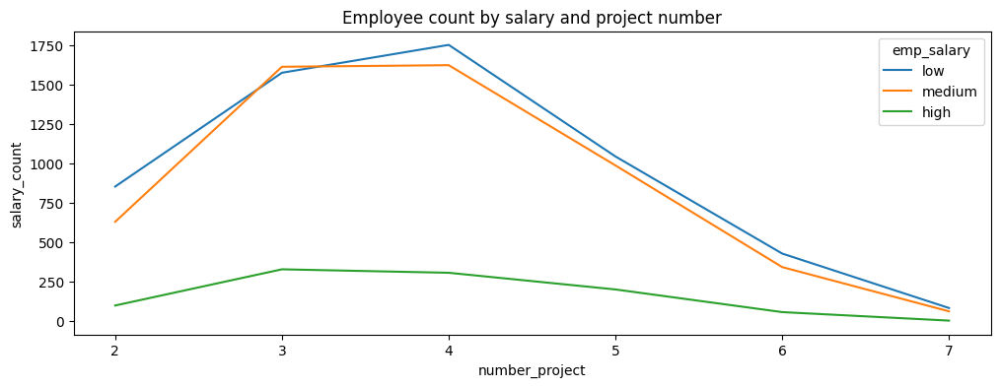

In [130]:
############################################
#salary count
############################################
plt.figure(figsize=(12,4))
result=pd.crosstab(df_drop['number_project'],df_drop['salary'],margins=False).reset_index()
result.columns=['number_project','salary_low','salary_medium','salary_high']
result=pd.wide_to_long(result, stubnames='salary', i=['number_project'], j='emp_salary',sep='_', suffix=r'\w+').reset_index().rename(columns={
    'salary':'salary_count'
})
sns.lineplot(data=result, x="number_project", y="salary_count",hue='emp_salary')
plt.title('Employee count by salary and project number')
plt.show()

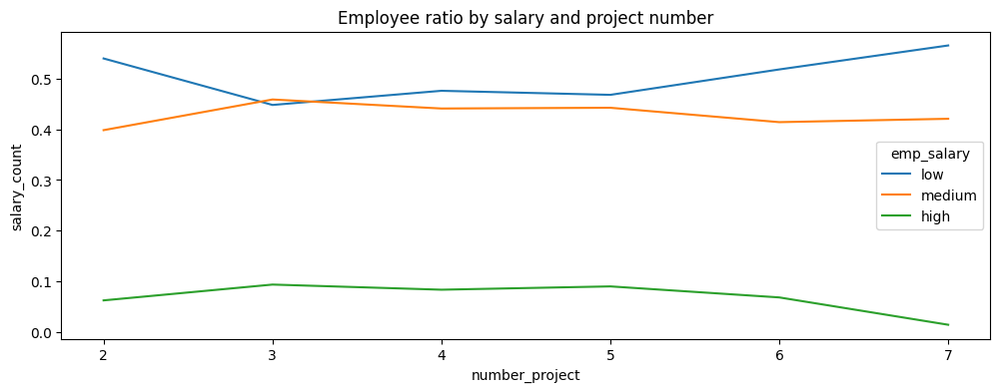

In [131]:
############################################
#salary ratio
############################################
plt.figure(figsize=(12,4))
result=pd.crosstab(df_drop['number_project'],df_drop['salary'],margins=False,normalize='index').reset_index()
result.columns=['number_project','salary_low','salary_medium','salary_high']
result=pd.wide_to_long(result, stubnames='salary', i=['number_project'], j='emp_salary',sep='_', suffix=r'\w+').reset_index().rename(columns={
    'salary':'salary_count'
})
sns.lineplot(data=result, x="number_project", y="salary_count",hue='emp_salary')
plt.title('Employee ratio by salary and project number')
plt.show()

In [132]:
#salary ratio of whole sample
df_drop['salary'].value_counts(normalize=True)

salary
low       0.478692
medium    0.438746
high      0.082562
Name: proportion, dtype: float64

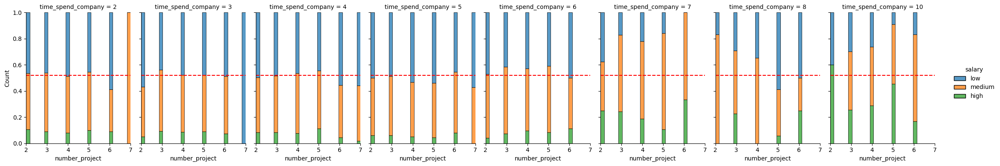

In [133]:
############################################
#salary ratio by number_project
#keep time_spend_company constant
############################################
g=sns.displot(
    data=df_drop, x='number_project',  hue='salary',col="time_spend_company",
    kind="hist", height=4, aspect=.7,col_wrap=8, multiple='fill',
)
axes = g.fig.axes

for ax in axes:
    ax.axhline(0.52,color='red',linestyle='--')
plt.show()
#=>for employees time_spend_company>=6, they had higher midian/high salary ratio

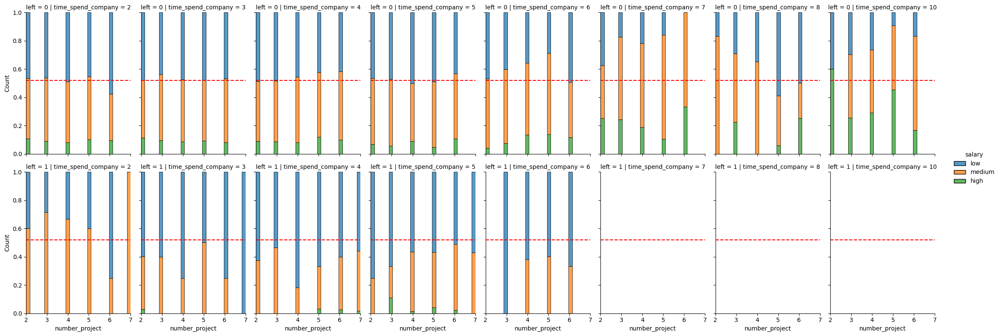

In [134]:
############################################
#salary ratio by number_project
#keep time_spend_company and left constant
############################################
g=sns.displot(
    data=df_drop, x='number_project',  hue='salary',col="time_spend_company",row='left',
    kind="hist", height=4, aspect=.7, multiple='fill',
)
axes = g.fig.axes

for ax in axes:
    ax.axhline(0.52,color='red',linestyle='--')
plt.show()
#=>for time_spend_company>2, amoung employee who left, they had lower median/high salary ratio 
#=>for time_spend_company=2, amoung employee who left most of them had higher median/high salary ratio 

##### number_project vs emp_type

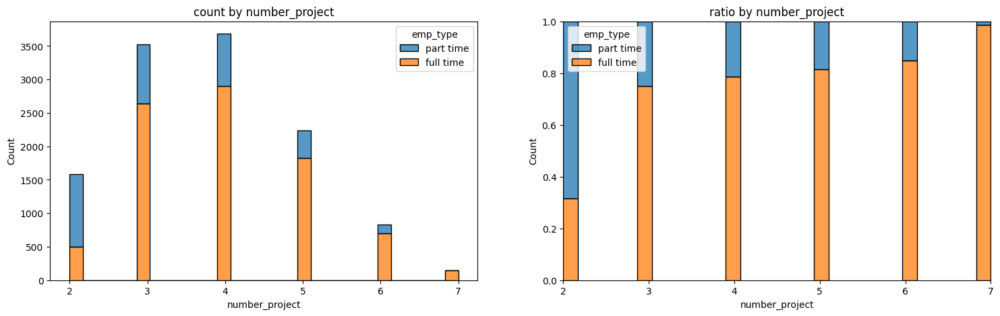

In [135]:
############################################
#number_project by emp_type
############################################
fig, axs = plt.subplots(1,2,figsize=(18,5))
sns.histplot(data=df_drop,hue='emp_type',x='number_project',palette='tab10',multiple='stack',ax=axs[0])
axs[0].set_title('count by number_project')
sns.histplot(data=df_drop,hue='emp_type',x='number_project',palette='tab10',multiple='fill',ax=axs[1])
axs[1].set_title('ratio by number_project')
plt.show()

number_project,emp_type,2,3,4,5,6,7
0,full time,500,2637,2896,1820,700,143
1,part time,1082,883,789,413,126,2


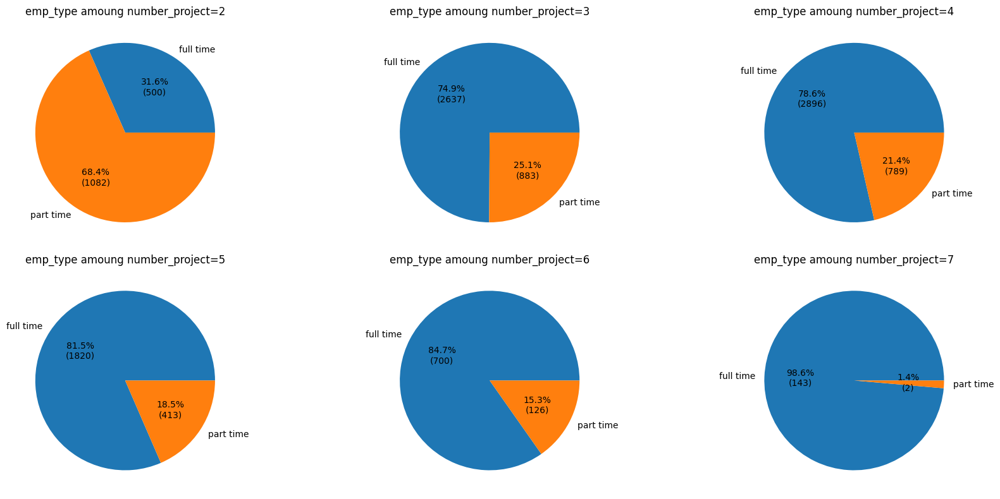

In [136]:
#######################################
#P(emp_type | number_project)
#######################################
result=pd.crosstab(df_drop['emp_type'],df_drop['number_project'],margins=False).reset_index()

display(result)
col_nm=df_drop['number_project'].unique().tolist()
col_nm.sort()

#######################################
#Pie Chart
#######################################
colCnt=3
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["emp_type"], autopct=autopct_format(result[col]))
    ax.set_title(f"emp_type amoung number_project={col}")
plt.tight_layout()
plt.show()
#=>amoung number_project=2, 68% of them were part time
#=>amoung number_project>2, more than 75% of them were full time
#=>as number_project increase, full time ratio tend to increase

In [137]:
#$H_{0}$: No association between emp_type and number_project
#$H_{A}$: There is an association between emp_type and number_project
result=pd.crosstab(df_drop['emp_type'], df_drop['number_project'])
display(result)

significance_level=0.01

statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(result, correction=False)

show_test_result(statistic, pvalue,significance_level)

number_project,2,3,4,5,6,7
emp_type,,,,,,
full time,500,2637,2896,1820,700,143
part time,1082,883,789,413,126,2


Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=1609.12)


#### time_spend_company

##### time_spend_company vs work_accident

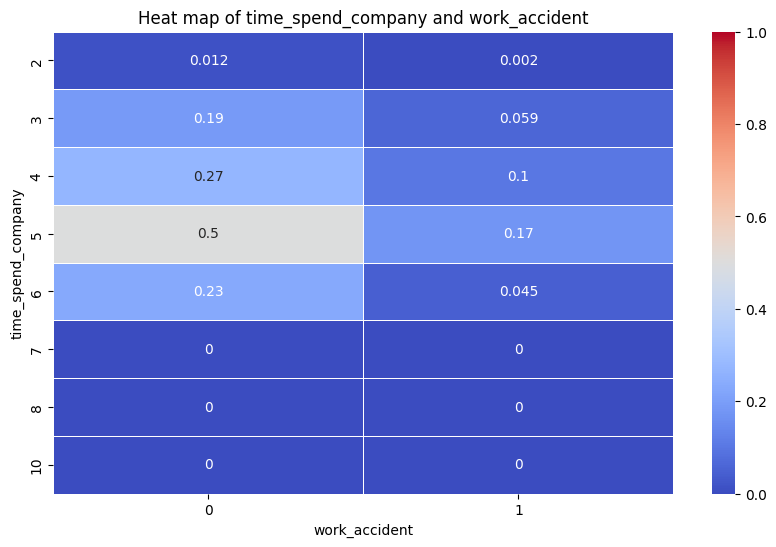

In [138]:
#########################################
#time_spend_company and work_accident
#########################################
plt.figure(figsize=(10,6))
df_heatmap = df_drop.pivot_table(values='left',index='time_spend_company',columns='work_accident',aggfunc=np.mean)
sns.heatmap(df_heatmap,annot=True, vmin=0, vmax=1,cmap="coolwarm", linewidth=.5)
plt.title('Heat map of time_spend_company and work_accident')
plt.show()

In [139]:
#$H_{0}$: No association between time_spend_company and work_accident
#$H_{A}$: There is an association between time_spend_company and work_accident

result=pd.crosstab(df_drop['time_spend_company'], df_drop['work_accident'])
display(result)
#plt.figure(figsize=(10,6))
#sns.heatmap(result,annot=True, cmap="Greens", linewidth=.5, fmt=".1f")
#plt.title('count of time_spend_company and work_accident')
#plt.show()

significance_level=0.01
statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(result, correction=False)
show_test_result(statistic, pvalue,significance_level)

work_accident,0,1
time_spend_company,,
2,2410,500
3,4413,777
4,1729,276
5,913,149
6,454,88
7,81,13
8,59,22
10,82,25


Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=27.7)


work_accident,time_spend_company,0,1
0,2,2410,500
1,3,4413,777
2,4,1729,276
3,5,913,149
4,6,454,88
5,7,81,13
6,8,59,22
7,10,82,25


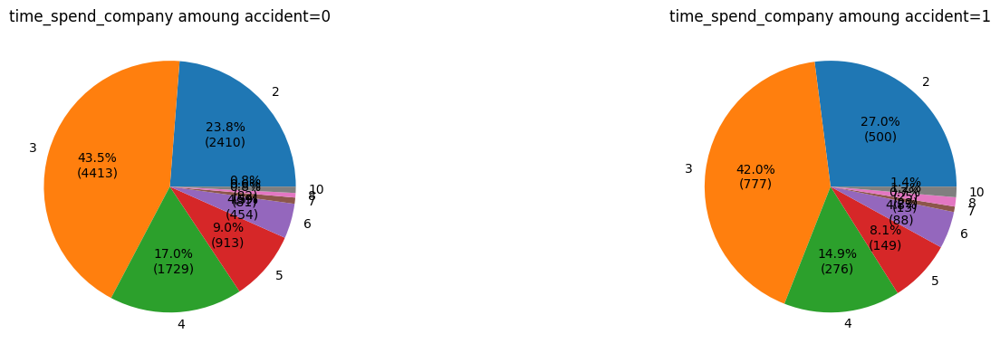

In [140]:
#######################################
#P(time_spend_company | work_accident)
#######################################
result=pd.crosstab(df_drop['time_spend_company'],df_drop['work_accident'],margins=False).reset_index()

display(result)
col_nm=df_drop['work_accident'].unique().tolist()
col_nm.sort()

#######################################
#Pie Chart
#######################################
colCnt=2
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["time_spend_company"], autopct=autopct_format(result[col]))
    ax.set_title(f"time_spend_company amoung accident={col}")
plt.tight_layout()
plt.show()

time_spend_company,work_accident,2,3,4,5,6,7,8,10
0,0,2410,4413,1729,913,454,81,59,82
1,1,500,777,276,149,88,13,22,25


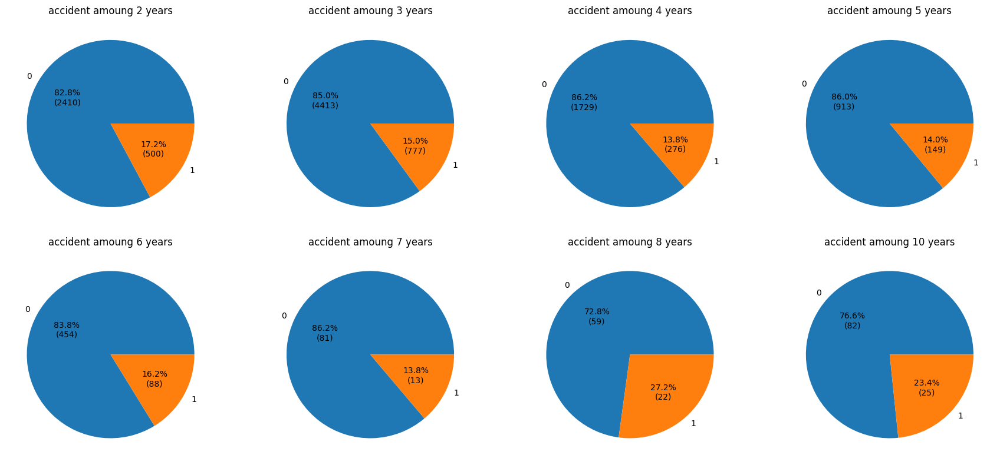

In [141]:
############################################
#P(work_accident | time_spend_company)
############################################
result=pd.crosstab(df_drop['work_accident'],df_drop['time_spend_company'],margins=False).reset_index()

display(result)
col_nm=df_drop['time_spend_company'].unique().tolist()
col_nm.sort()

#######################################
#Pie Chart
#######################################
colCnt=4
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["work_accident"], autopct=autopct_format(result[col]))
    ax.set_title(f"accident amoung {col} years")
plt.tight_layout()
plt.show()

#=>maybe time_spend_company>7 had more management level and they need to take responsibility.

##### time_spend_company vs promotion_last_5years

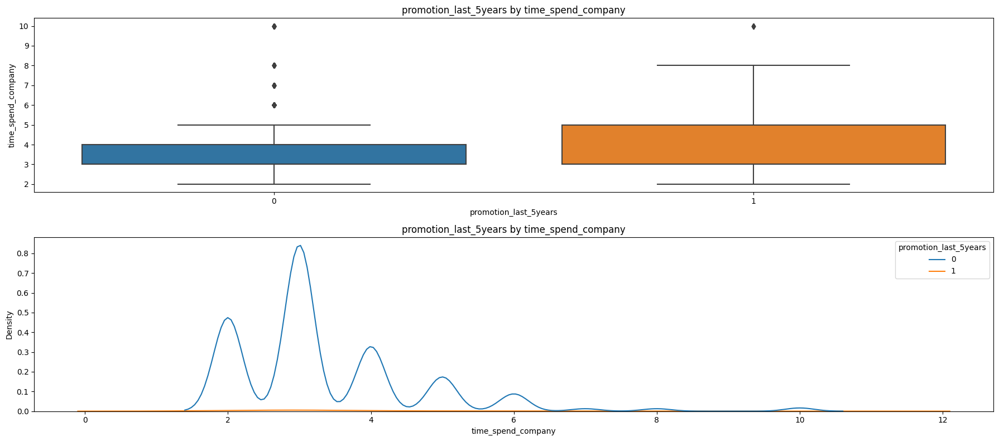

,promotion_last_5years,min,max,std,mean,median,count
0,0,2,10,1.312952,3.354937,3.0,11788
1,1,2,10,2.026178,3.940887,3.0,203


In [142]:
#############################################
#satisfaction_level and time_spend_company
#############################################
fig, axs = plt.subplots(2,1,figsize=(18,8))

sns.boxplot(data=df_drop,y='time_spend_company',x='promotion_last_5years',ax=axs[0])
axs[0].set_title('promotion_last_5years by time_spend_company')

sns.kdeplot(data=df_drop,hue='promotion_last_5years',x='time_spend_company',palette='tab10',ax=axs[1])
axs[1].set_title('promotion_last_5years by time_spend_company')

plt.tight_layout()
plt.show()

display(df_drop.groupby(['promotion_last_5years'])['time_spend_company'].agg(['min','max','std','mean','median','count']).reset_index())

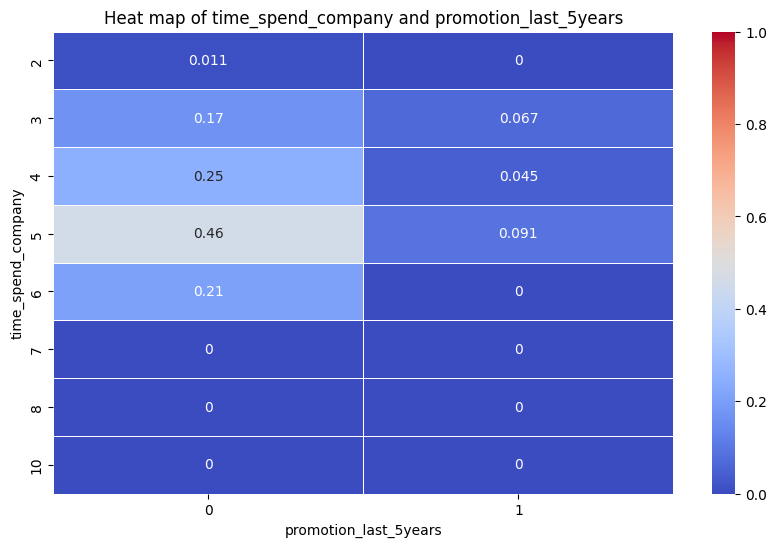

In [143]:
#############################################
#time_spend_company and promotion_last_5years
#############################################
plt.figure(figsize=(10,6))
df_heatmap = df_drop.pivot_table(values='left',index='time_spend_company',columns='promotion_last_5years',aggfunc=np.mean)
sns.heatmap(df_heatmap,annot=True, vmin=0, vmax=1,cmap="coolwarm", linewidth=.5)
plt.title('Heat map of time_spend_company and promotion_last_5years')
plt.show()

In [144]:
#$H_{0}$: No association between time_spend_company and promotion_last_5years
#$H_{A}$: There is an association time_spend_company and promotion_last_5years

result=pd.crosstab(df_drop['time_spend_company'], df_drop['promotion_last_5years'])
display(result)
#plt.figure(figsize=(10,6))
#sns.heatmap(result,annot=True, cmap="Greens", linewidth=.5, fmt=".1f")
#plt.title('count of time_spend_company and promotion_last_5years')
#plt.show()

significance_level=0.01
statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(result, correction=False)
show_test_result(statistic, pvalue,significance_level)

promotion_last_5years,0,1
time_spend_company,,
2,2871,39
3,5101,89
4,1983,22
5,1051,11
6,531,11
7,76,18
8,76,5
10,99,8


Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=212.97)


promotion_last_5years,time_spend_company,0,1
0,2,2871,39
1,3,5101,89
2,4,1983,22
3,5,1051,11
4,6,531,11
5,7,76,18
6,8,76,5
7,10,99,8


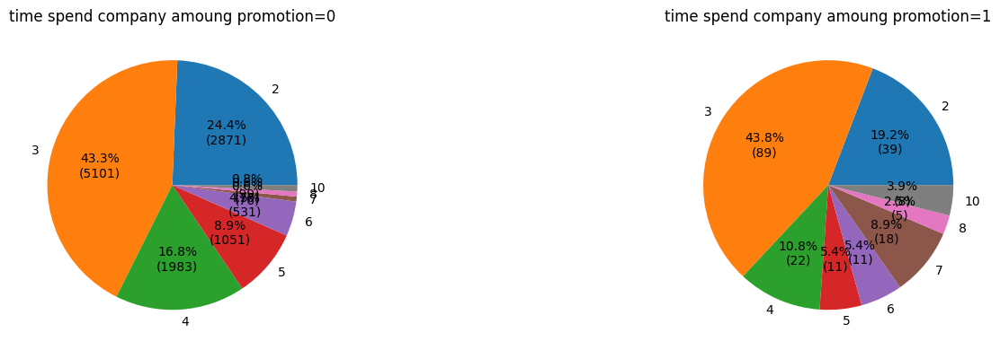

In [145]:
#####################################################
#P(time_spend_company | promotion_last_5years)
#####################################################
result=pd.crosstab(df_drop['time_spend_company'],df_drop['promotion_last_5years'],margins=False).reset_index()

display(result)
col_nm=df_drop['promotion_last_5years'].unique().tolist()
col_nm.sort()

#######################################
#Pie Chart
#######################################
colCnt=2
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["time_spend_company"], autopct=autopct_format(result[col]))
    ax.set_title(f"time spend company amoung promotion={col}")
plt.tight_layout()
plt.show()

time_spend_company,promotion_last_5years,2,3,4,5,6,7,8,10
0,0,2871,5101,1983,1051,531,76,76,99
1,1,39,89,22,11,11,18,5,8


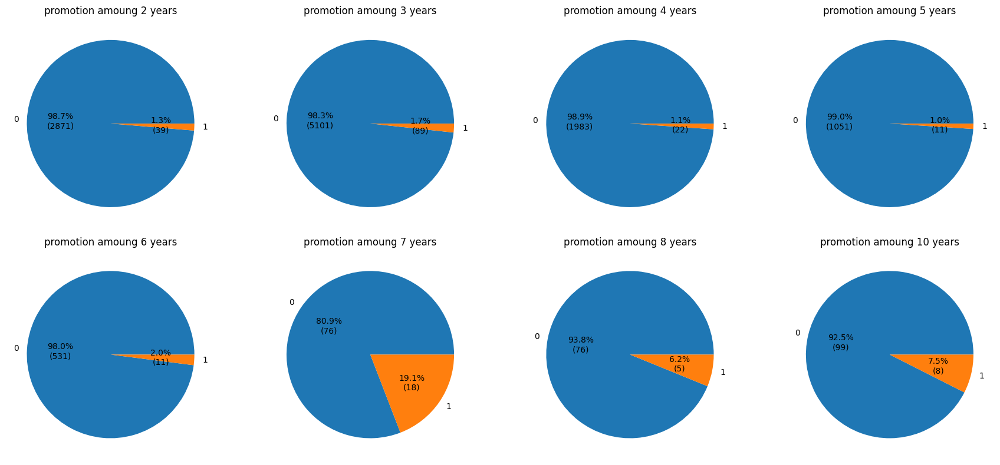

In [146]:
#####################################################
#P(promotion_last_5years | time_spend_company)
#####################################################
result=pd.crosstab(df_drop['promotion_last_5years'],df_drop['time_spend_company'],margins=False).reset_index()

display(result)
col_nm=df_drop['time_spend_company'].unique().tolist()
col_nm.sort()

#######################################
#Pie Chart
#######################################
colCnt=4
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["promotion_last_5years"], autopct=autopct_format(result[col]))
    ax.set_title(f"promotion amoung {col} years")
plt.tight_layout()
plt.show()

#####  time_spend_company vs department

In [147]:
df_drop.groupby(['department'])['time_spend_company'].agg(['min','max','std','mean','median','count'])
#=>average time_spend_company of management department seems higher than others

,min,max,std,mean,median,count
department,,,,,,
IT,2,10,1.300162,3.350410,3.0,976
RandD,2,8,1.180032,3.319885,3.0,694
accounting,2,10,1.287376,3.404187,3.0,621
hr,2,8,1.122897,3.256240,3.0,601
management,2,10,2.191862,3.981651,3.0,436
marketing,2,10,1.385595,3.421991,3.0,673
product_mng,2,10,1.309249,3.341108,3.0,686
sales,2,10,1.372728,3.380673,3.0,3239
support,2,10,1.240567,3.292696,3.0,1821


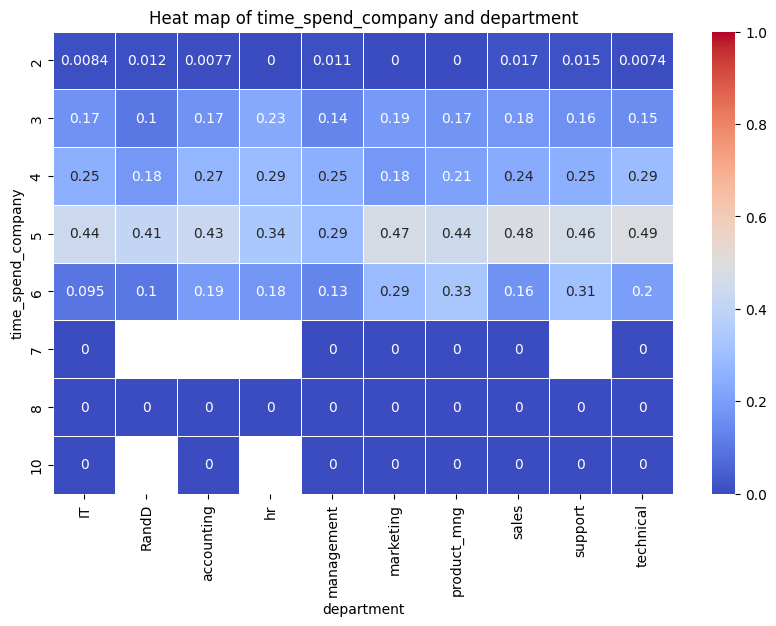

In [148]:
#############################################
#time_spend_company and department
#############################################
plt.figure(figsize=(10,6))
df_heatmap = df_drop.pivot_table(values='left',index='time_spend_company',columns='department',aggfunc=np.mean)
sns.heatmap(df_heatmap,annot=True, vmin=0, vmax=1,cmap="coolwarm", linewidth=.5)
plt.title('Heat map of time_spend_company and department')
plt.show()

In [149]:
#$H_{0}$: No association between time_spend_company and department
#$H_{A}$: There is an association time_spend_company and department

result=pd.crosstab(df_drop['time_spend_company'], df_drop['department'])
display(result)
#plt.figure(figsize=(10,6))
#sns.heatmap(result,annot=True, cmap="Greens", linewidth=.5, fmt=".1f")
#plt.title('count of time_spend_company and department')
#plt.show()

significance_level=0.01
statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(result, correction=False)
show_test_result(statistic, pvalue,significance_level)

department,IT,RandD,accounting,hr,management,marketing,product_mng,sales,support,technical
time_spend_company,,,,,,,,,,
2,239,171,130,151,89,151,171,803,466,539
3,420,296,276,269,176,299,296,1388,790,980
4,162,116,121,94,67,116,115,521,295,398
5,94,66,56,56,28,51,59,285,170,197
6,42,40,26,28,15,35,27,134,81,114
7,6,0,0,0,18,5,9,55,0,1
8,5,5,7,3,12,10,4,24,6,5
10,8,0,5,0,31,6,5,29,13,10


Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=428.4)


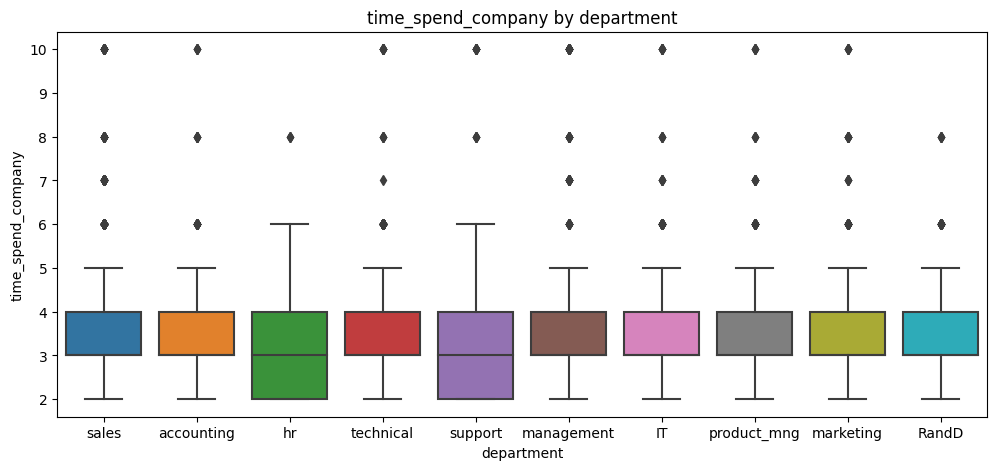

In [150]:
#############################################
#show time_spend_company by department
#############################################
plt.figure(figsize=(12,5))

sns.boxplot(data=df_drop,x='department',y='time_spend_company')
plt.title('time_spend_company by department')
plt.show()


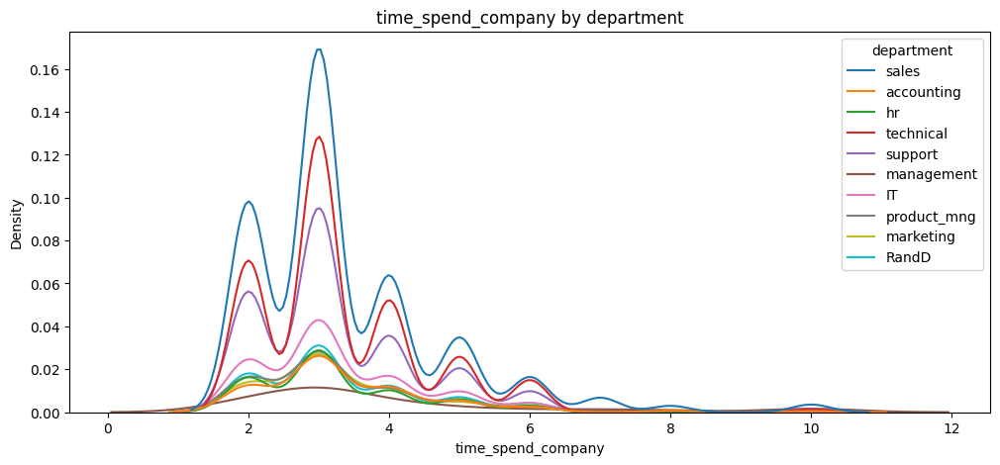

In [151]:
#############################################
#show time_spend_company by department
#############################################
plt.figure(figsize=(12,5))

sns.kdeplot(data=df_drop,hue='department',x='time_spend_company')
plt.title('time_spend_company by department')
plt.show()


department,time_spend_company,IT,RandD,accounting,hr,management,marketing,product_mng,sales,support,technical
0,2,239,171,130,151,89,151,171,803,466,539
1,3,420,296,276,269,176,299,296,1388,790,980
2,4,162,116,121,94,67,116,115,521,295,398
3,5,94,66,56,56,28,51,59,285,170,197
4,6,42,40,26,28,15,35,27,134,81,114
5,7,6,0,0,0,18,5,9,55,0,1
6,8,5,5,7,3,12,10,4,24,6,5
7,10,8,0,5,0,31,6,5,29,13,10


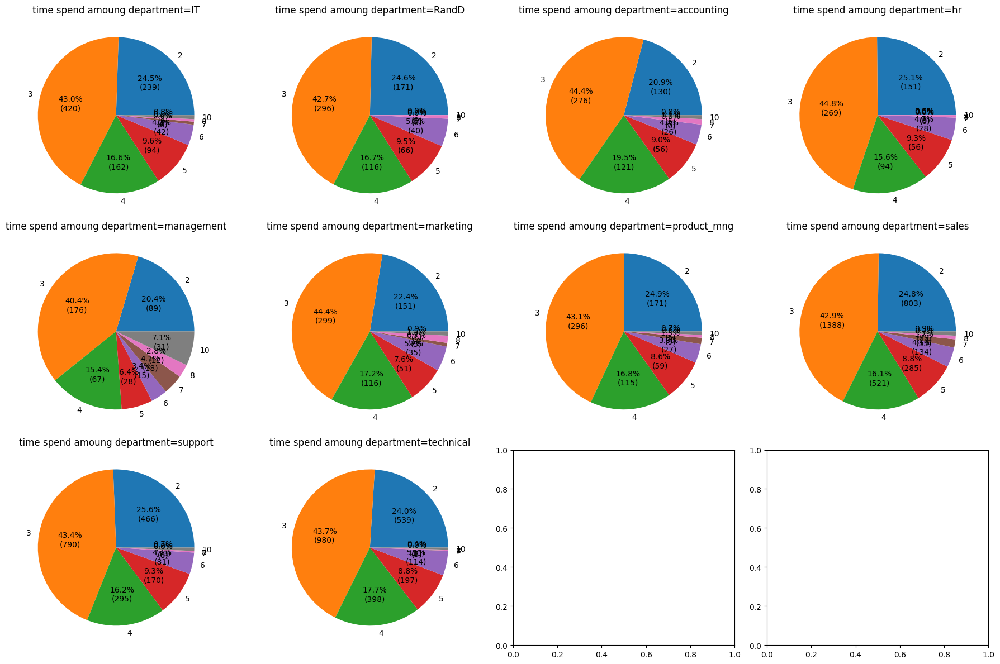

In [152]:
#####################################################
#P(time_spend_company | department)
#####################################################
result=pd.crosstab(df_drop['time_spend_company'],df_drop['department'],margins=False).reset_index()

display(result)
col_nm=df_drop['department'].unique().tolist()
col_nm.sort()

#######################################
#Pie Chart
#######################################
colCnt=4
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["time_spend_company"], autopct=autopct_format(result[col]))
    ax.set_title(f"time spend amoung department={col}")
plt.tight_layout()
plt.show()

time_spend_company,department,2,3,4,5,6,7,8,10
0,IT,239,420,162,94,42,6,5,8
1,RandD,171,296,116,66,40,0,5,0
2,accounting,130,276,121,56,26,0,7,5
3,hr,151,269,94,56,28,0,3,0
4,management,89,176,67,28,15,18,12,31
5,marketing,151,299,116,51,35,5,10,6
6,product_mng,171,296,115,59,27,9,4,5
7,sales,803,1388,521,285,134,55,24,29
8,support,466,790,295,170,81,0,6,13
9,technical,539,980,398,197,114,1,5,10


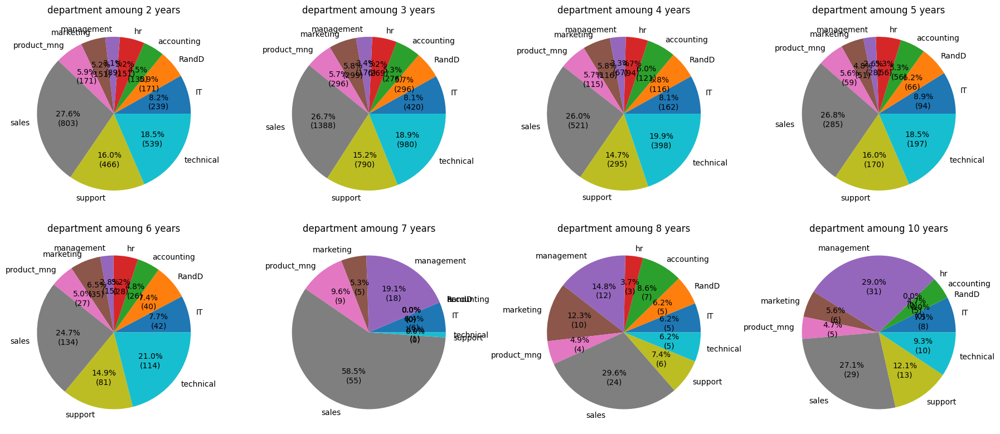

In [153]:
#####################################################
#P(department | time_spend_company)
#####################################################
result=pd.crosstab(df_drop['department'],df_drop['time_spend_company'],margins=False).reset_index()

display(result)
col_nm=df_drop['time_spend_company'].unique().tolist()
col_nm.sort()

#######################################
#Pie Chart
#######################################
colCnt=4
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["department"], autopct=autopct_format(result[col]))
    ax.set_title(f"department amoung {col} years")
plt.tight_layout()
plt.show()

In [154]:
# Levene test for equal variances.
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.levene.html
#H0:All input samples are from populations with equal variances
#HA:At least one input sample are from populations with different variance
significance_level=0.01
print('Levene test result of time_spend_company')
statistic, p_value = levene(*[df_drop['time_spend_company'][df_drop['department'] == item]
                                    for item in df_drop['department'].unique()])
show_test_result(statistic, p_value,significance_level)

Levene test result of time_spend_company
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=14.09)


In [155]:
# Kruskal-Wallis test
#H0:The population median of all of the groups are equal
#HA:At least one group has different median
#set significance_level 0.01
significance_level=0.01

print('Kruskal-Wallis testresult of time_spend_company')
statistic, p_value = kruskal(*[df_drop['time_spend_company'][df_drop['department'] == item]
                                    for item in df_drop['department'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis testresult of time_spend_company
Reject H0 at significance level 0.01 (Pvalue=0.002, Statistic=25.53)


In [156]:
# Kolmogorov-Smirnov
# https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.ks_2samp.html
#H0:The distributions of satisfaction_level for number_project are identical.
#HA:The distributions of satisfaction_level for number_project are different.
#set significance_level 0.01
significance_level=0.01

print('Kolmogorov-Smirnov test result of time_spend_company')

results = {}
for i, item1 in enumerate(sorted(df_drop['department'].unique())):
    for j, item2 in enumerate(sorted(df_drop['department'].unique())):
        if i < j:
            ks_stat, ks_p = ks_2samp(df_drop[df_drop['department'] == item1]['time_spend_company'], 
                                     df_drop[df_drop['department'] == item2]['time_spend_company'])
            if ks_p<=significance_level:
                ks_result='Reject H0'
            else:
                ks_result='Fail reject'
            results[f"{item1} vs {item2}"] = (ks_stat, ks_p ,ks_result)

# Convert the results into a DataFrame
ks_df = pd.DataFrame(results).transpose()
ks_df.columns = ['KS_Statistic', 'Pvalue','Result']
ks_df.reset_index(inplace=True)
ks_df.rename(columns={'index': 'department_compared'}, inplace=True)

ks_df[ks_df['Result']=='Reject H0']

#=>management department was different from other department

Kolmogorov-Smirnov test result of time_spend_company


,department_compared,KS_Statistic,Pvalue,Result
3,IT vs management,0.120441,0.000284,Reject H0
11,RandD vs management,0.132704,0.000141,Reject H0
18,accounting vs management,0.120585,0.001037,Reject H0
24,hr vs management,0.134917,0.000177,Reject H0
30,management vs marketing,0.108705,0.003481,Reject H0
31,management vs product_mng,0.113669,0.001834,Reject H0
32,management vs sales,0.106565,0.000295,Reject H0
33,management vs support,0.129474,0.000013,Reject H0
34,management vs technical,0.132778,0.000004,Reject H0


#####  time_spend_company vs salary

In [157]:
df_drop.groupby(['salary'])['time_spend_company'].agg(['min','max','std','mean','median','count'])

,min,max,std,mean,median,count
salary,,,,,,
low,2,10,1.216886,3.319686,3.0,5740
medium,2,10,1.363666,3.389850,3.0,5261
high,2,10,1.713995,3.493939,3.0,990


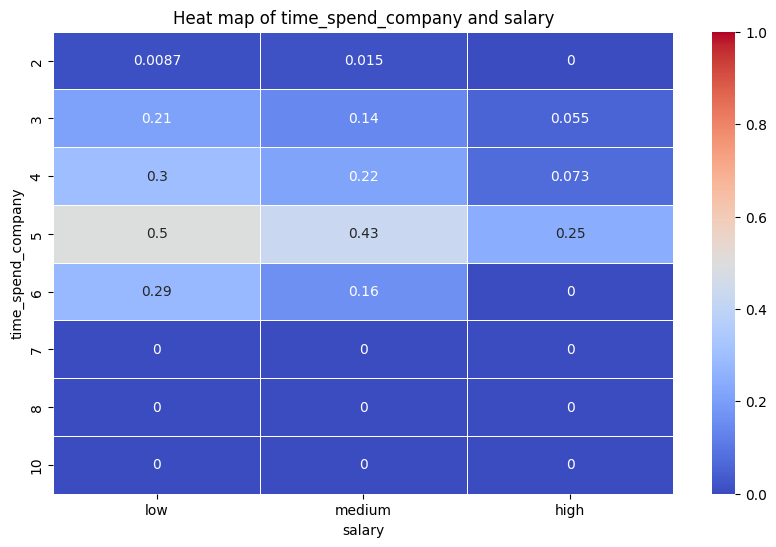

In [158]:
#############################################
#time_spend_company and salary
#############################################
plt.figure(figsize=(10,6))
df_heatmap = df_drop.pivot_table(values='left',index='time_spend_company',columns='salary',aggfunc=np.mean)
sns.heatmap(df_heatmap,annot=True, vmin=0, vmax=1,cmap="coolwarm", linewidth=.5)
plt.title('Heat map of time_spend_company and salary')
plt.show()

In [159]:
#$H_{0}$: No association between time_spend_company and salary
#$H_{A}$: There is an association time_spend_company and salary

result=pd.crosstab(df_drop['time_spend_company'], df_drop['salary'])
display(result)

#plt.figure(figsize=(10,6))
#sns.heatmap(result,annot=True, cmap="Greens", linewidth=.5, fmt=".1f")
#plt.title('count of time_spend_company and salary')
#plt.show()

significance_level=0.01
statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(result, correction=False)
show_test_result(statistic, pvalue,significance_level)

salary,low,medium,high
time_spend_company,,,
2,1374,1278,258
3,2519,2252,419
4,986,869,150
5,550,455,57
6,235,261,46
7,18,57,19
8,30,42,9
10,28,47,32


Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=137.58)


salary,time_spend_company,low,medium,high
0,2,1374,1278,258
1,3,2519,2252,419
2,4,986,869,150
3,5,550,455,57
4,6,235,261,46
5,7,18,57,19
6,8,30,42,9
7,10,28,47,32


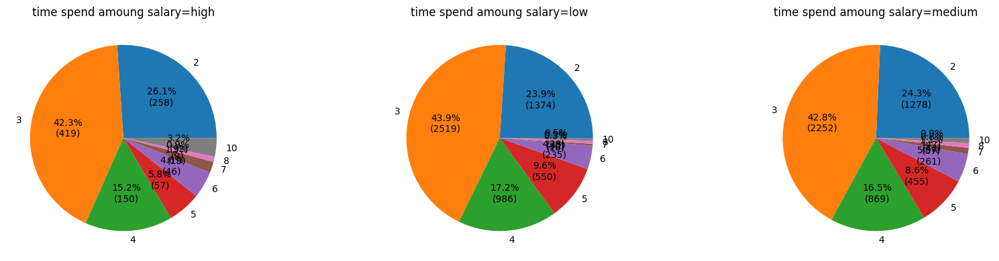

In [160]:
#####################################################
#P(time_spend_company | salary)
#####################################################
result=pd.crosstab(df_drop['time_spend_company'],df_drop['salary'],margins=False).reset_index()

display(result)
col_nm=df_drop['salary'].unique().tolist()
col_nm.sort()

#######################################
#Pie Chart
#######################################
colCnt=3
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["time_spend_company"], autopct=autopct_format(result[col]))
    ax.set_title(f"time spend amoung salary={col}")
plt.tight_layout()
plt.show()

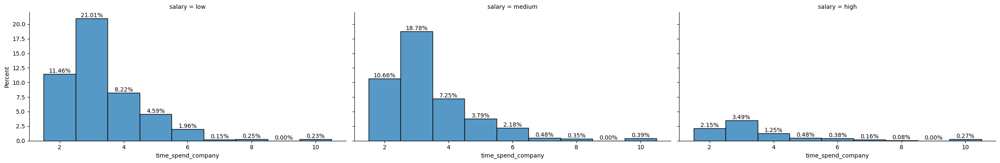

In [161]:
############################################
#time_spend_company 
#keep salary constant
############################################
g=sns.displot(
    data=df_drop, x='time_spend_company',col="salary", stat='percent',
    kind="hist", height=4, aspect=2,col_wrap=3, multiple='stack', discrete=True,
    facet_kws=dict(sharex=False)
)
axes = g.fig.axes

for ax in axes:
    for container in ax.containers:
        ax.bar_label(container, fmt='%.2f%%')
plt.show()

time_spend_company,salary,2,3,4,5,6,7,8,10
0,low,1374,2519,986,550,235,18,30,28
1,medium,1278,2252,869,455,261,57,42,47
2,high,258,419,150,57,46,19,9,32


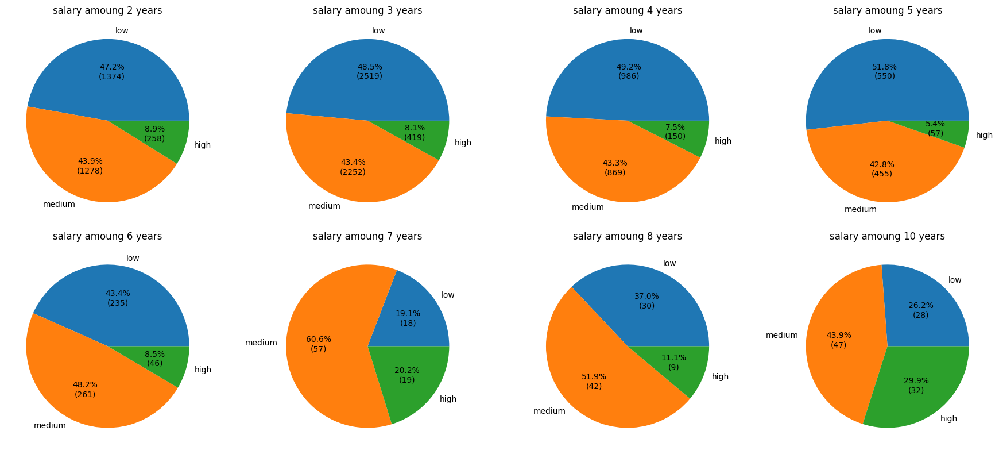

In [162]:
#####################################################
#P(salary | time_spend_company)
#####################################################
result=pd.crosstab(df_drop['salary'],df_drop['time_spend_company'],margins=False).reset_index()

display(result)
col_nm=df_drop['time_spend_company'].unique().tolist()
col_nm.sort()

#######################################
#Pie Chart
#######################################
colCnt=4
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["salary"], autopct=autopct_format(result[col]))
    ax.set_title(f"salary amoung {col} years")
plt.tight_layout()
plt.show()

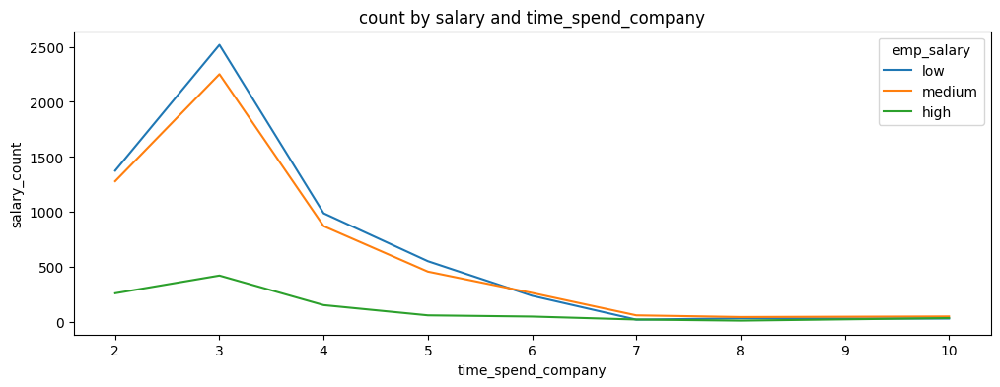

In [163]:
############################################
#salary count
############################################
plt.figure(figsize=(12,4))
result=pd.crosstab(df_drop['time_spend_company'],df_drop['salary'],margins=False).reset_index()
result.columns=['time_spend_company','salary_low','salary_medium','salary_high']
result=pd.wide_to_long(result, stubnames='salary', i=['time_spend_company'], j='emp_salary',sep='_', suffix=r'\w+').reset_index().rename(columns={
    'salary':'salary_count'
})
sns.lineplot(data=result, x="time_spend_company", y="salary_count",hue='emp_salary')
plt.title('count by salary and time_spend_company')
plt.show()

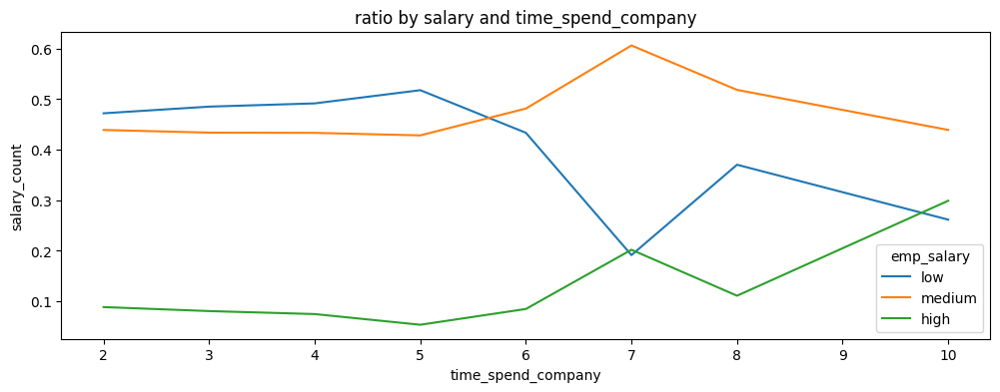

In [164]:
############################################
#salary ratio
############################################
plt.figure(figsize=(12,4))
result=pd.crosstab(df_drop['time_spend_company'],df_drop['salary'],margins=False,normalize='index').reset_index()
result.columns=['time_spend_company','salary_low','salary_medium','salary_high']
result=pd.wide_to_long(result, stubnames='salary', i=['time_spend_company'], j='emp_salary',sep='_', suffix=r'\w+').reset_index().rename(columns={
    'salary':'salary_count'
})
sns.lineplot(data=result, x="time_spend_company", y="salary_count",hue='emp_salary')
plt.title('ratio by salary and time_spend_company')
plt.show()

##### emp_type vs time_spend_company

In [165]:
df_drop.groupby(['emp_type'])['time_spend_company'].agg(['min','max','std','mean','median','count'])

,min,max,std,mean,median,count
emp_type,,,,,,
full time,2,10,1.360409,3.401679,3.0,8696
part time,2,10,1.242086,3.267678,3.0,3295


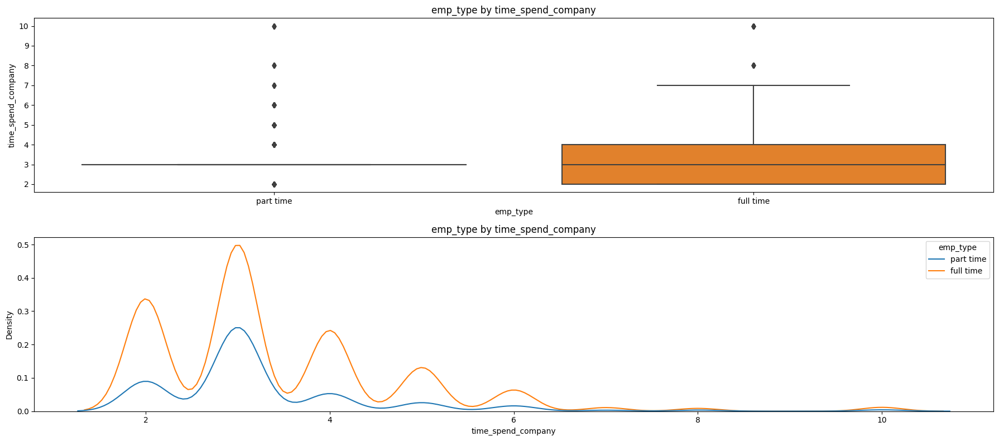

,emp_type,min,max,std,mean,median,count
0,full time,2,10,1.360409,3.401679,3.0,8696
1,part time,2,10,1.242086,3.267678,3.0,3295


In [166]:
#############################################
#satisfaction_level and time_spend_company
#############################################
fig, axs = plt.subplots(2,1,figsize=(18,8))

sns.boxplot(data=df_drop,y='time_spend_company',x='emp_type',ax=axs[0])
axs[0].set_title('emp_type by time_spend_company')

sns.kdeplot(data=df_drop,hue='emp_type',x='time_spend_company',palette='tab10',ax=axs[1])
axs[1].set_title('emp_type by time_spend_company')

plt.tight_layout()
plt.show()

display(df_drop.groupby(['emp_type'])['time_spend_company'].agg(['min','max','std','mean','median','count']).reset_index())

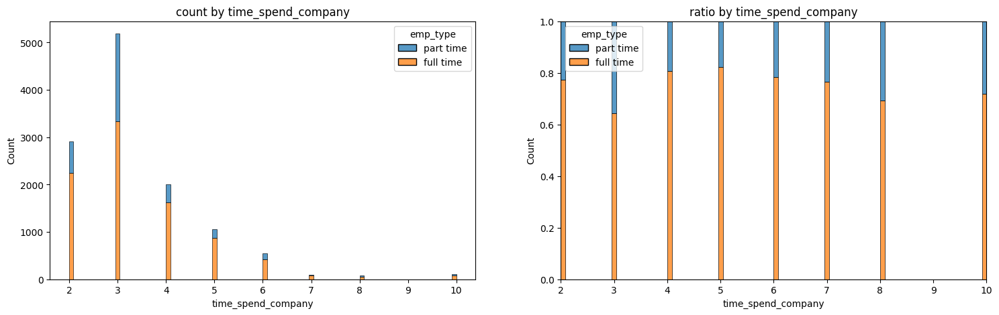

In [167]:
############################################
#number_project by emp_type
############################################
fig, axs = plt.subplots(1,2,figsize=(18,5))
sns.histplot(data=df_drop,hue='emp_type',x='time_spend_company',palette='tab10',multiple='stack',ax=axs[0])
axs[0].set_title('count by time_spend_company')
sns.histplot(data=df_drop,hue='emp_type',x='time_spend_company',palette='tab10',multiple='fill',ax=axs[1])
axs[1].set_title('ratio by time_spend_company')
plt.show()

time_spend_company,emp_type,2,3,4,5,6,7,8,10
0,full time,2247,3332,1615,873,424,72,56,77
1,part time,663,1858,390,189,118,22,25,30


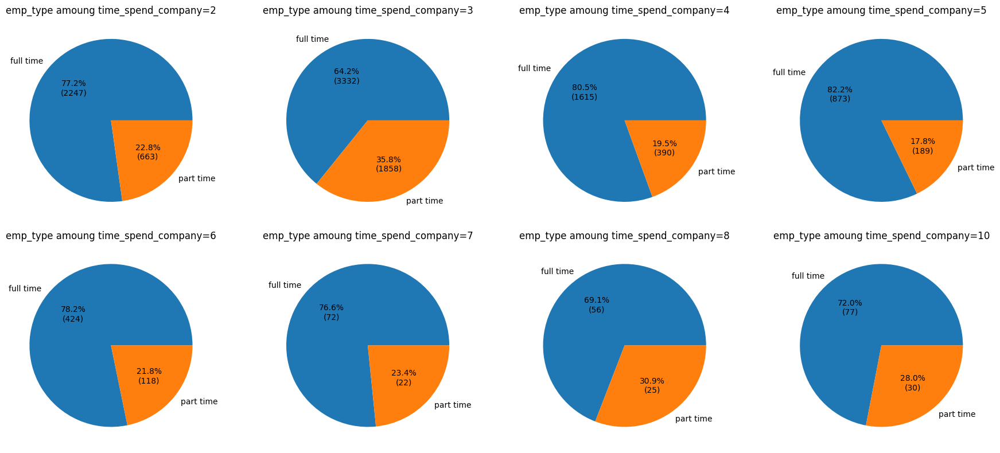

In [168]:
#######################################
#P(emp_type | time_spend_company)
#######################################
result=pd.crosstab(df_drop['emp_type'],df_drop['time_spend_company'],margins=False).reset_index()

display(result)
col_nm=df_drop['time_spend_company'].unique().tolist()
col_nm.sort()

#######################################
#Pie Chart
#######################################
colCnt=4
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["emp_type"], autopct=autopct_format(result[col]))
    ax.set_title(f"emp_type amoung time_spend_company={col}")
plt.tight_layout()
plt.show()

In [169]:
#$H_{0}$: No association between emp_type and time_spend_company
#$H_{A}$: There is an association between emp_type and time_spend_company
result=pd.crosstab(df_drop['emp_type'], df_drop['time_spend_company'])
display(result)

significance_level=0.01

statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(result, correction=False)

show_test_result(statistic, pvalue,significance_level)

time_spend_company,2,3,4,5,6,7,8,10
emp_type,,,,,,,,
full time,2247,3332,1615,873,424,72,56,77
part time,663,1858,390,189,118,22,25,30


Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=337.43)


#### work_accident
#####  work_accident vs promotion_last_5years

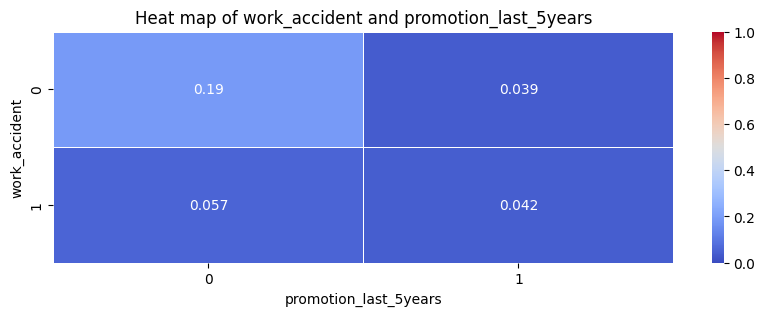

In [170]:
#############################################
#work_accident and promotion_last_5years
#############################################
plt.figure(figsize=(10,3))
df_heatmap = df_drop.pivot_table(values='left',index='work_accident',columns='promotion_last_5years',aggfunc=np.mean)
sns.heatmap(df_heatmap,annot=True, vmin=0, vmax=1,cmap="coolwarm", linewidth=.5)
plt.title('Heat map of work_accident and promotion_last_5years')
plt.show()

work_accident,promotion_last_5years,0,1
0,0,9986,1802
1,1,155,48


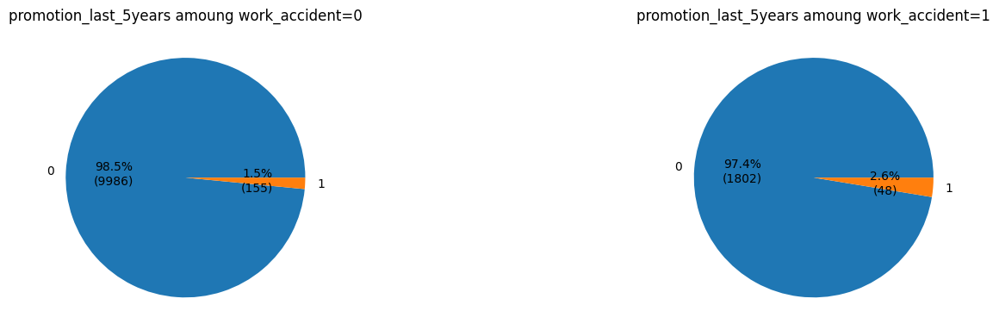

In [171]:
#######################################
#P(promotion_last_5years | work_accident)
#######################################
result=pd.crosstab(df_drop['promotion_last_5years'],df_drop['work_accident'],margins=False).reset_index()

display(result)
col_nm=df_drop['work_accident'].unique().tolist()

#######################################
#Pie Chart
#######################################
colCnt=2
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["promotion_last_5years"], autopct=autopct_format(result[col]))
    ax.set_title(f"promotion_last_5years amoung work_accident={col}")
plt.tight_layout()
plt.show()

promotion_last_5years,work_accident,0,1
0,0,9986,155
1,1,1802,48


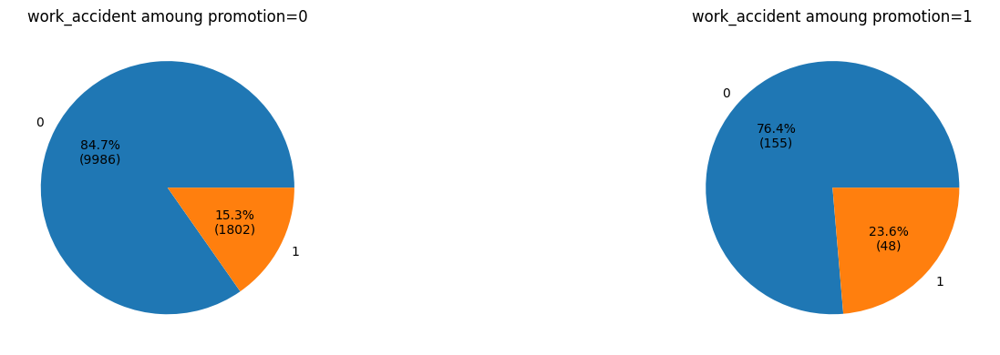

In [172]:
#######################################
#P(work_accident | promotion_last_5years)
#######################################
result=pd.crosstab(df_drop['work_accident'],df_drop['promotion_last_5years'],margins=False).reset_index()

display(result)
col_nm=df_drop['promotion_last_5years'].unique().tolist()

#######################################
#Pie Chart
#######################################
colCnt=2
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["work_accident"], autopct=autopct_format(result[col]))
    ax.set_title(f"work_accident amoung promotion={col}")
plt.tight_layout()
plt.show()

In [173]:
#$H_{0}$: No association between work_accident and promotion_last_5years
#$H_{A}$: There is an association work_accident and promotion_last_5years
result=pd.crosstab(df_drop['work_accident'], df_drop['promotion_last_5years'])
display(result)

#plt.figure(figsize=(10,4))
#sns.heatmap(result,annot=True, cmap="Greens", linewidth=.5, fmt=".1f")
#plt.title('count of work_accident and promotion_last_5years')
#plt.show()

significance_level=0.01
statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(result, correction=False)
show_test_result(statistic, pvalue,significance_level)

promotion_last_5years,0,1
work_accident,,
0,9986,155
1,1802,48


Reject H0 at significance level 0.01 (Pvalue=0.001, Statistic=10.69)


#####  work_accident vs department

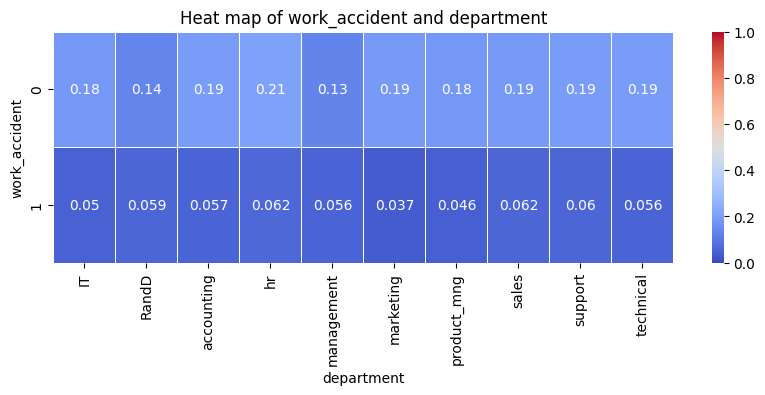

In [174]:
#############################################
#work_accident and department
#############################################
plt.figure(figsize=(10,3))
df_heatmap = df_drop.pivot_table(values='left',index='work_accident',columns='department',aggfunc=np.mean)
sns.heatmap(df_heatmap,annot=True, vmin=0, vmax=1,cmap="coolwarm", linewidth=.5)
plt.title('Heat map of work_accident and department')
plt.show()

Fail to reject H0 at significance level 0.01 (Pvalue=0.544, Statistic=7.91)


department,work_accident,IT,RandD,accounting,hr,management,marketing,product_mng,sales,support,technical
0,0,837,575,534,521,364,565,577,2741,1522,1905
1,1,139,119,87,80,72,108,109,498,299,339


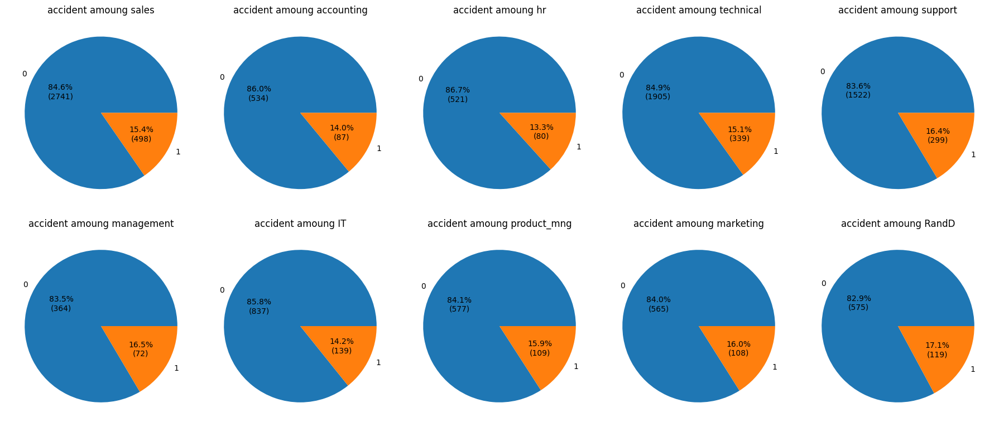

In [175]:
#$H_{0}$: No association between work_accident and department
#$H_{A}$: There is an association work_accident and department

result=pd.crosstab(df_drop['work_accident'], df_drop['department'])

significance_level=0.01
statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(result, correction=False)
show_test_result(statistic, pvalue,significance_level)

result=result.reset_index()
display(result)
#######################################
#Pie Chart
#######################################
col_nm=df_drop['department'].unique().tolist()
colCnt=5
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["work_accident"], autopct=autopct_format(result[col]))
    ax.set_title(f"accident amoung {col}")
plt.tight_layout()
plt.show()



#####  work_accident vs salary

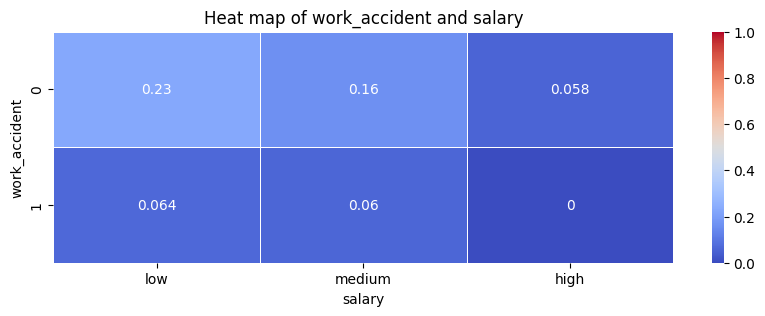

In [176]:
#############################################
#work_accident and salary
#############################################
plt.figure(figsize=(10,3))
df_heatmap = df_drop.pivot_table(values='left',index='work_accident',columns='salary',aggfunc=np.mean)
sns.heatmap(df_heatmap,annot=True, vmin=0, vmax=1,cmap="coolwarm", linewidth=.5)
plt.title('Heat map of work_accident and salary')
plt.show()

Fail to reject H0 at significance level 0.01 (Pvalue=0.922, Statistic=0.16)


salary,work_accident,low,medium,high
0,0,4851,4456,834
1,1,889,805,156


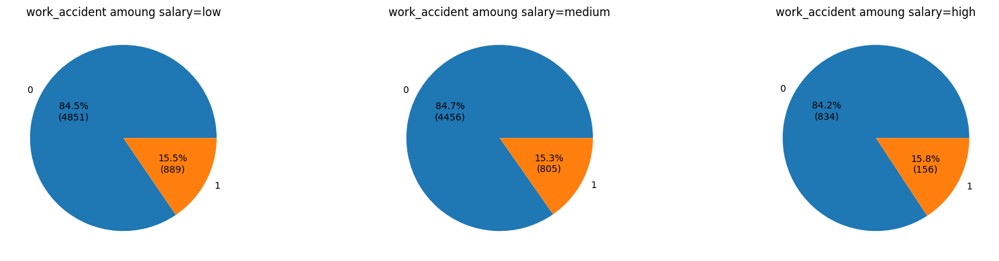

In [177]:
#$H_{0}$: No association between work_accident and salary
#$H_{A}$: There is an association work_accident and salary

result=pd.crosstab(df_drop['work_accident'], df_drop['salary'])

significance_level=0.01
statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(result, correction=False)
show_test_result(statistic, pvalue,significance_level)

result=result.reset_index()
display(result)
#######################################
#Pie Chart
#######################################
col_nm=df_drop['salary'].unique().tolist()
colCnt=3
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["work_accident"], autopct=autopct_format(result[col]))
    ax.set_title(f"work_accident amoung salary={col}")
plt.tight_layout()
plt.show()

work_accident,salary,0,1
0,low,4851,889
1,medium,4456,805
2,high,834,156


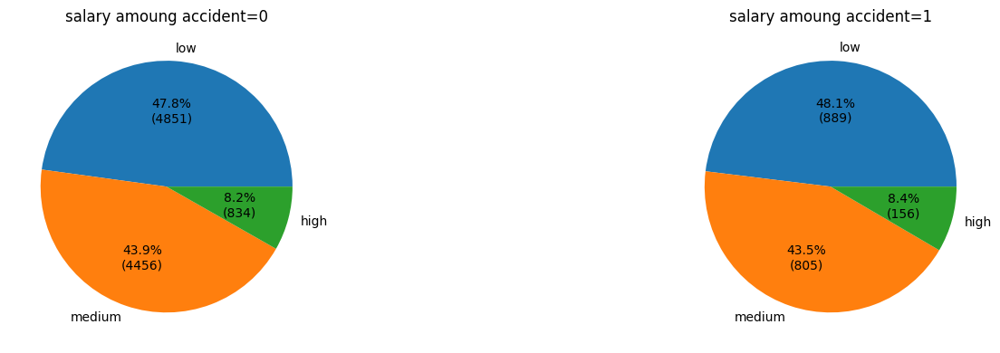

In [178]:
result=pd.crosstab(df_drop['salary'], df_drop['work_accident'])

result=result.reset_index()
display(result)
#######################################
#Pie Chart
#######################################
col_nm=df_drop['work_accident'].unique().tolist()
colCnt=2
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["salary"], autopct=autopct_format(result[col]))
    ax.set_title(f"salary amoung accident={col}")
plt.tight_layout()
plt.show()

##### work_accident vs emp_type

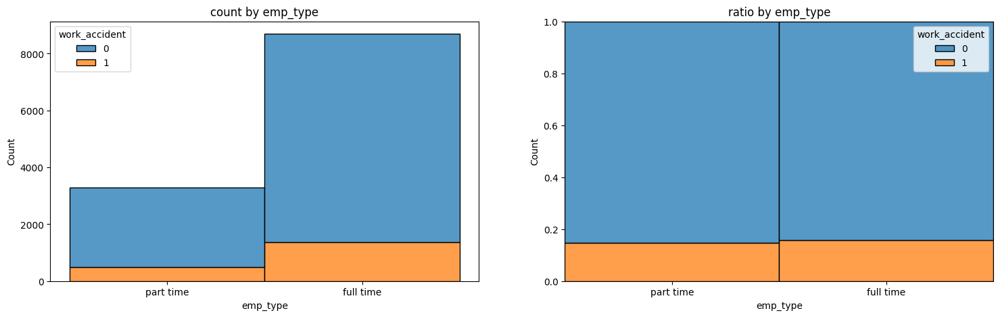

In [179]:
############################################
#work_accident by emp_type
############################################
fig, axs = plt.subplots(1,2,figsize=(18,5))
sns.histplot(data=df_drop,hue='work_accident',x='emp_type',palette='tab10',multiple='stack',binwidth=0.1,binrange=(0,1),ax=axs[0])
axs[0].set_title('count by emp_type')
sns.histplot(data=df_drop,hue='work_accident',x='emp_type',palette='tab10',multiple='fill',binwidth=0.1,binrange=(0,1),ax=axs[1])
axs[1].set_title('ratio by emp_type')
plt.show()

In [180]:
#$H_{0}$: No association between emp_type and work_accident
#$H_{A}$: There is an association between emp_type and work_accident
result=pd.crosstab(df_drop['emp_type'], df_drop['work_accident'])
display(result)

significance_level=0.01

statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(result, correction=False)

show_test_result(statistic, pvalue,significance_level)

work_accident,0,1
emp_type,,
full time,7335,1361
part time,2806,489


Fail to reject H0 at significance level 0.01 (Pvalue=0.273, Statistic=1.2)


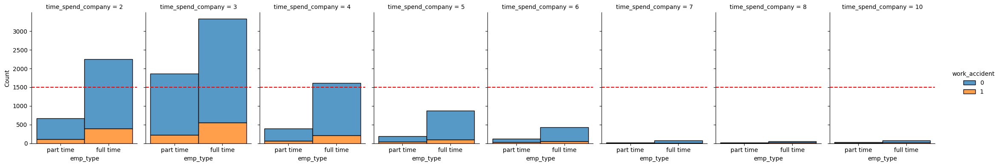

In [181]:
############################################
#work_accident by emp_type
#keep time_spend_company constant
############################################
g=sns.displot(
    data=df_drop, x='emp_type',  hue='work_accident',col="time_spend_company",
    kind="hist", height=4, aspect=.7,col_wrap=8, multiple='stack',
)
axes = g.fig.axes
avg_work_accident=(df_drop['work_accident'].count())/len(df_drop['time_spend_company'].unique())
for ax in axes:
    ax.axhline(avg_work_accident,color='red',linestyle='--')
plt.show()

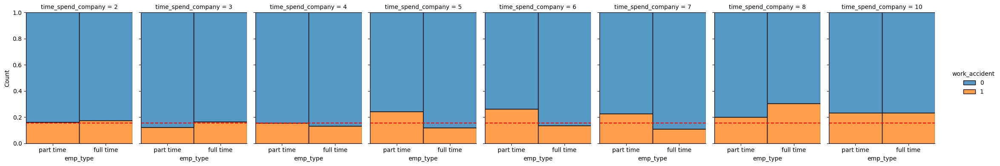

In [182]:
############################################
#work_accident by emp_type
#keep time_spend_company constant
############################################
g=sns.displot(
    data=df_drop, x='emp_type',  hue='work_accident',col="time_spend_company",
    kind="hist", height=4, aspect=.7,col_wrap=8, multiple='fill',
)
axes = g.fig.axes
total_work_accident_ratio=(df_drop['work_accident'].sum())/df_drop.shape[0]
for ax in axes:
    ax.axhline(total_work_accident_ratio,color='red',linestyle='--')
plt.show()

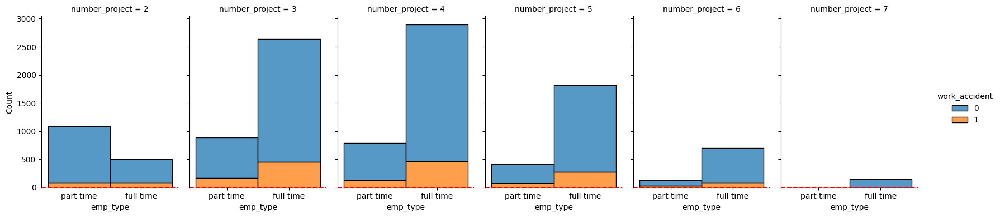

In [183]:
############################################
#work_accident by emp_type
#keep number_project constant
############################################
g=sns.displot(
    data=df_drop, x='emp_type',  hue='work_accident',col="number_project",
    kind="hist", height=4, aspect=.7,multiple='stack',
)
axes = g.fig.axes
avg_work_accident=(df_drop['work_accident'].count())/len(df_drop['number_project'].unique())
for ax in axes:
    ax.axhline(total_work_accident_ratio,color='red',linestyle='--')
plt.show()

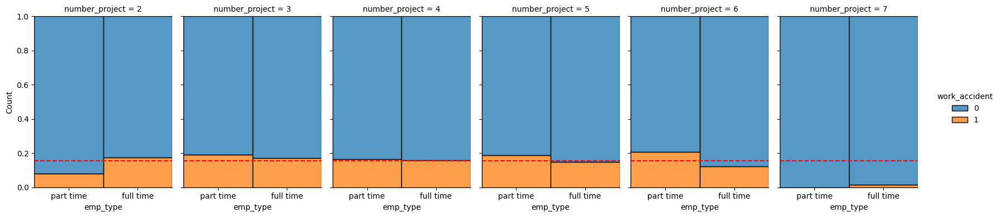

In [184]:
############################################
#work_accident by emp_type
#keep number_project constant
############################################
g=sns.displot(
    data=df_drop, x='emp_type',  hue='work_accident',col="number_project",
    kind="hist", height=4, aspect=.7,multiple='fill',
)
axes = g.fig.axes
total_work_accident_ratio=(df_drop['work_accident'].sum())/df_drop.shape[0]
for ax in axes:
    ax.axhline(total_work_accident_ratio,color='red',linestyle='--')
plt.show()

#### promotion_last_5years

#####  promotion_last_5years vs department

In [185]:
result=pd.crosstab(df_drop['department'], df_drop['promotion_last_5years'],margins=False,normalize='index').reset_index()
result=result.sort_values([1],ascending=False)
display(result)


promotion_last_5years,department,0,1
4,management,0.917431,0.082569
5,marketing,0.959881,0.040119
1,RandD,0.969741,0.030259
3,hr,0.981697,0.018303
7,sales,0.982093,0.017907
2,accounting,0.983897,0.016103
9,technical,0.990196,0.009804
8,support,0.991214,0.008786
0,IT,0.997951,0.002049
6,product_mng,1.000000,0.000000


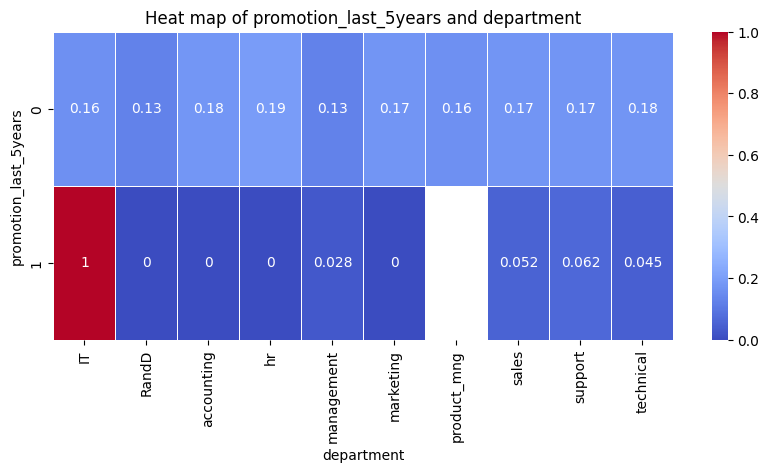

In [186]:
#############################################
#promotion_last_5years and department
#############################################
plt.figure(figsize=(10,4))
df_heatmap = df_drop.pivot_table(values='left',index='promotion_last_5years',columns='department',aggfunc=np.mean)
sns.heatmap(df_heatmap,annot=True, vmin=0, vmax=1,cmap="coolwarm", linewidth=.5)
plt.title('Heat map of promotion_last_5years and department')
plt.show()

Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=181.21)


department,promotion_last_5years,IT,RandD,accounting,hr,management,marketing,product_mng,sales,support,technical
0,0,974,673,611,590,400,646,686,3181,1805,2222
1,1,2,21,10,11,36,27,0,58,16,22


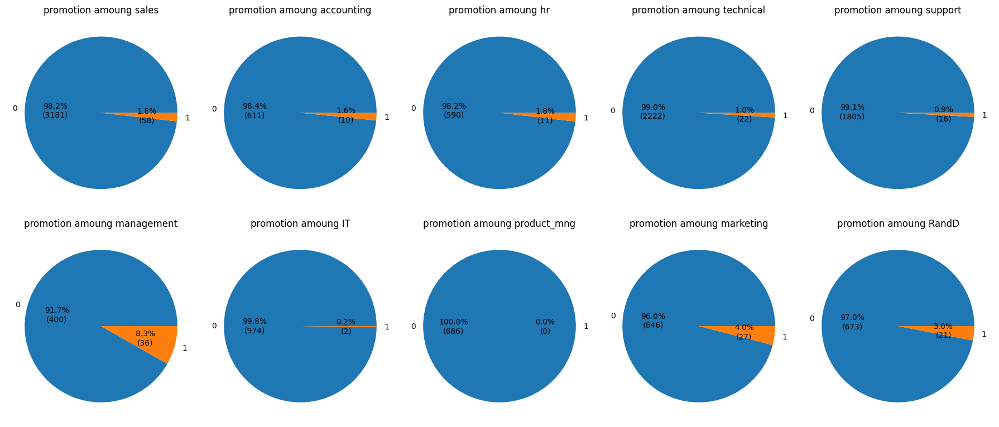

In [187]:
#$H_{0}$: No association between promotion_last_5years and department
#$H_{A}$: There is an association promotion_last_5years and department

result=pd.crosstab(df_drop['promotion_last_5years'], df_drop['department'])

significance_level=0.01
statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(result, correction=False)
show_test_result(statistic, pvalue,significance_level)

result=result.reset_index()
display(result)
#######################################
#Pie Chart
#######################################
col_nm=df_drop['department'].unique().tolist()
colCnt=5
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["promotion_last_5years"], autopct=autopct_format(result[col]))
    ax.set_title(f"promotion amoung {col}")
plt.tight_layout()
plt.show()

In [188]:
#post hoc test for proportion 

#https://www.statsmodels.org/dev/generated/statsmodels.stats.proportion.proportions_ztest.html
#$H_{0}$: promoted proportion of two compared departments were identical
#$H_{A}$: promoted proportion of two compared departments were not identical
significance_level=0.01

print('proportions_ztest test result of promotion_last_5years')
results = {}
cal_result=pd.crosstab(df_drop['department'], df_drop['promotion_last_5years']).reset_index()
cal_result['All']=cal_result[0]+cal_result[1]
display(cal_result)

for i, item1 in enumerate(sorted(cal_result['department'].unique().tolist())):
    for j, item2 in enumerate(sorted(cal_result['department'].unique().tolist())):
        if i < j:
            
            statistic, pvalue = proportions_ztest(cal_result[cal_result['department'].isin([item1,item2])][1],
                                                 cal_result[cal_result['department'].isin([item1,item2])]['All'])
            if pvalue<=significance_level:
                result='Reject H0'
            else:
                result='Fail reject'
            results[f"{item1} vs {item2}"] = (statistic, pvalue ,result)

# Convert the results into a DataFrame
result_df = pd.DataFrame(results).transpose()
result_df.columns = ['Statistic', 'Pvalue','Result']
result_df.reset_index(inplace=True)
result_df.rename(columns={'index': 'department_compared'}, inplace=True)

result_df

#=>management department different from all other department


proportions_ztest test result of promotion_last_5years


promotion_last_5years,department,0,1,All
0,IT,974,2,976
1,RandD,673,21,694
2,accounting,611,10,621
3,hr,590,11,601
4,management,400,36,436
5,marketing,646,27,673
6,product_mng,686,0,686
7,sales,3181,58,3239
8,support,1805,16,1821
9,technical,2222,22,2244


,department_compared,Statistic,Pvalue,Result
0,IT vs RandD,-4.874815,0.000001,Reject H0
1,IT vs accounting,-3.170401,0.001522,Reject H0
2,IT vs hr,-3.46688,0.000527,Reject H0
3,IT vs management,-8.637779,0.0,Reject H0
4,IT vs marketing,-5.780503,0.0,Reject H0
5,IT vs product_mng,1.186352,0.235483,Fail reject
6,IT vs sales,-3.666106,0.000246,Reject H0
7,IT vs support,-2.123856,0.033682,Fail reject
8,IT vs technical,-2.351379,0.018704,Fail reject
9,RandD vs accounting,1.689176,0.091186,Fail reject


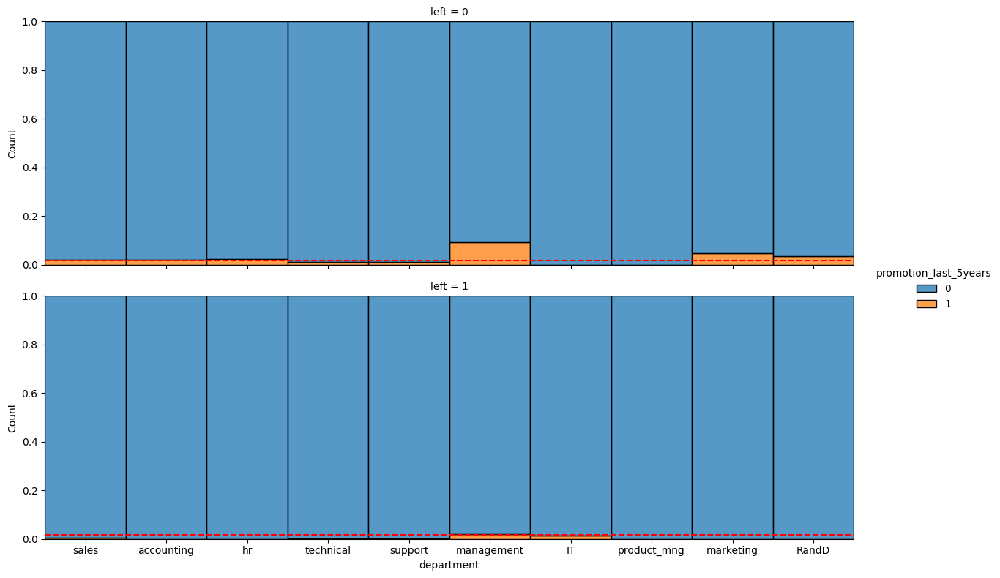

In [189]:
############################################
#promotion_last_5years by department
#keep left constant
############################################
g=sns.displot(
    data=df_drop, x='department',  hue='promotion_last_5years',row="left",
    kind="hist", height=4, aspect=3, multiple='fill',
)
axes = g.fig.axes
total_promotion_ratio=(df_drop['promotion_last_5years'].sum())/df_drop.shape[0]
for ax in axes:
    ax.axhline(total_promotion_ratio,color='red',linestyle='--')
plt.show()

#####  promotion_last_5years vs salary

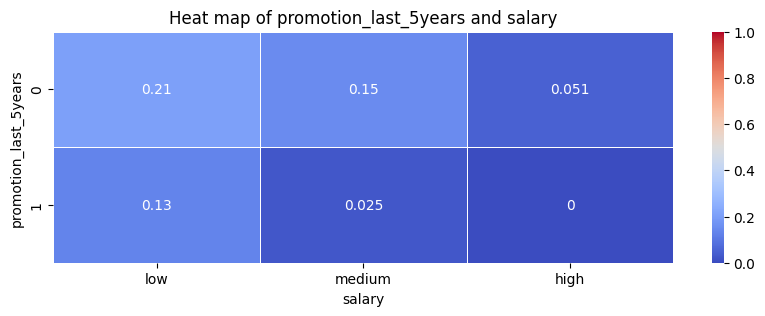

In [190]:
#############################################
#promotion_last_5years and salary
#############################################
plt.figure(figsize=(10,3))
df_heatmap = df_drop.pivot_table(values='left',index='promotion_last_5years',columns='salary',aggfunc=np.mean)
sns.heatmap(df_heatmap,annot=True, vmin=0, vmax=1,cmap="coolwarm", linewidth=.5)
plt.title('Heat map of promotion_last_5years and salary')
plt.show()

promotion_last_5years,salary,0,1
0,low,5702,38
1,medium,5140,121
2,high,946,44


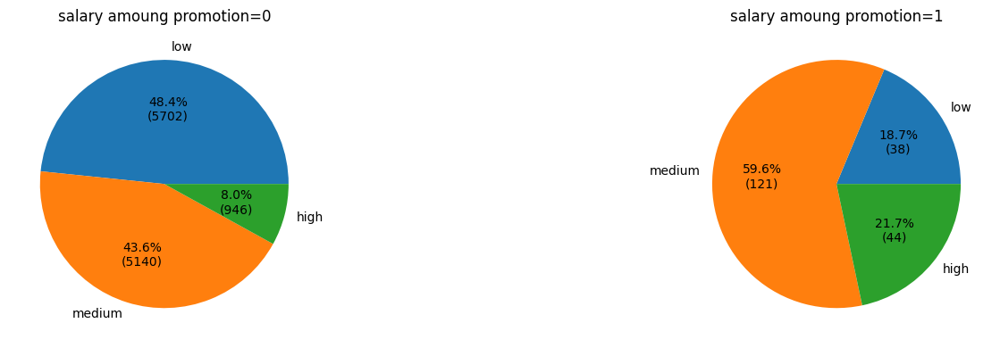

In [191]:
result=pd.crosstab(df_drop['salary'], df_drop['promotion_last_5years'])


result=result.reset_index()
display(result)
#######################################
#Pie Chart
#######################################
col_nm=df_drop['promotion_last_5years'].unique().tolist()
colCnt=2
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["salary"], autopct=autopct_format(result[col]))
    ax.set_title(f"salary amoung promotion={col}")
plt.tight_layout()
plt.show()

Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=93.34)


salary,promotion_last_5years,low,medium,high
0,0,5702,5140,946
1,1,38,121,44


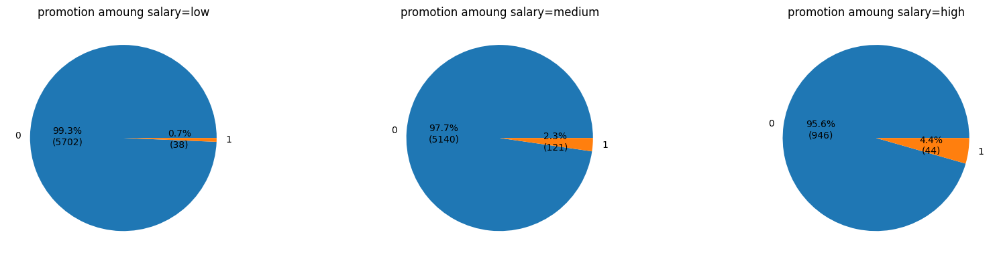

In [192]:
#$H_{0}$: No association between promotion_last_5years and salary
#$H_{A}$: There is an association promotion_last_5years and salary

result=pd.crosstab(df_drop['promotion_last_5years'], df_drop['salary'])

significance_level=0.01
statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(result, correction=False)
show_test_result(statistic, pvalue,significance_level)

result=result.reset_index()
display(result)
#######################################
#Pie Chart
#######################################
col_nm=df_drop['salary'].unique().tolist()
colCnt=3
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["promotion_last_5years"], autopct=autopct_format(result[col]))
    ax.set_title(f"promotion amoung salary={col}")
plt.tight_layout()
plt.show()

In [193]:
pd.crosstab(df_drop['salary'], df_drop['promotion_last_5years']).reset_index()

promotion_last_5years,salary,0,1
0,low,5702,38
1,medium,5140,121
2,high,946,44


In [194]:
#post hoc test for proportion 

#https://www.statsmodels.org/dev/generated/statsmodels.stats.proportion.proportions_ztest.html
#$H_{0}$: promoted proportion of two compared salary group were identical
#$H_{A}$: promoted proportion of two compared salary group were not identical
significance_level=0.01

print('proportions_ztest test result of promotion_last_5years')
results = {}
cal_result=pd.crosstab(df_drop['salary'], df_drop['promotion_last_5years']).reset_index()
cal_result['All']=cal_result[0]+cal_result[1]
display(cal_result)

for i, item1 in enumerate(sorted(cal_result['salary'].unique().tolist())):
    for j, item2 in enumerate(sorted(cal_result['salary'].unique().tolist())):
        if i < j:
            
            statistic, pvalue = proportions_ztest(cal_result[cal_result['salary'].isin([item1,item2])][1],
                                                 cal_result[cal_result['salary'].isin([item1,item2])]['All'])
            if pvalue<=significance_level:
                result='Reject H0'
            else:
                result='Fail reject'
            results[f"{item1} vs {item2}"] = (statistic, pvalue ,result)

# Convert the results into a DataFrame
result_df = pd.DataFrame(results).transpose()
result_df.columns = ['Statistic', 'Pvalue','Result']
result_df.reset_index(inplace=True)
result_df.rename(columns={'index': 'salary_compared'}, inplace=True)

result_df

proportions_ztest test result of promotion_last_5years


promotion_last_5years,salary,0,1,All
0,low,5702,38,5740
1,medium,5140,121,5261
2,high,946,44,990


,salary_compared,Statistic,Pvalue,Result
0,high vs low,-10.01841,0.0,Reject H0
1,high vs medium,-3.861401,0.000113,Reject H0
2,low vs medium,-7.190286,0.0,Reject H0


##### promotion_last_5years vs emp_type

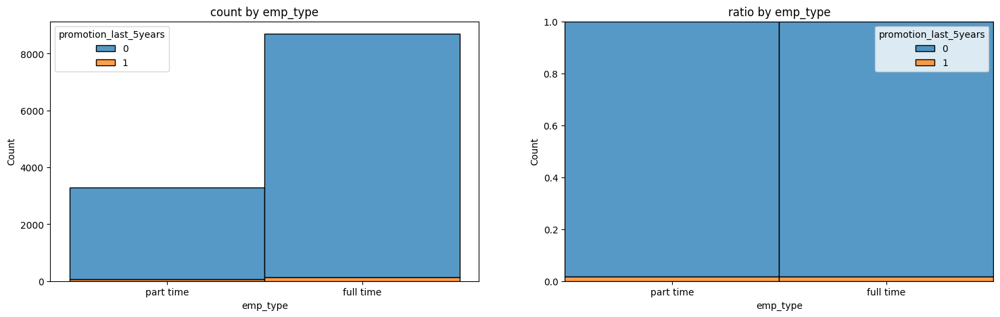

In [195]:
############################################
#promotion_last_5years by emp_type
############################################
fig, axs = plt.subplots(1,2,figsize=(18,5))
sns.histplot(data=df_drop,hue='promotion_last_5years',x='emp_type',palette='tab10',multiple='stack',ax=axs[0])
axs[0].set_title('count by emp_type')
sns.histplot(data=df_drop,hue='promotion_last_5years',x='emp_type',palette='tab10',multiple='fill',ax=axs[1])
axs[1].set_title('ratio by emp_type')
plt.show()

In [196]:
#$H_{0}$: No association between emp_type and promotion_last_5years
#$H_{A}$: There is an association between emp_type and promotion_last_5years
result=pd.crosstab(df_drop['emp_type'], df_drop['promotion_last_5years'])
display(result)

significance_level=0.01

statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(result, correction=False)

show_test_result(statistic, pvalue,significance_level)


promotion_last_5years,0,1
emp_type,,
full time,8549,147
part time,3239,56


Fail to reject H0 at significance level 0.01 (Pvalue=0.972, Statistic=0.0)


#####  keep department constant, promotion_last_5years vs salary

In [197]:
gp_department=df_drop.groupby(['department'])['promotion_last_5years'].agg(['sum','count']).reset_index()
gp_department.columns=['department','total_promoted_count','total_count']
display(gp_department)
result=df_drop.groupby(['department','salary'])['promotion_last_5years'].agg(['sum','count']).reset_index().rename(columns={
    'sum': 'promoted_count'})
result=result.merge(gp_department, left_on='department',right_on='department')
result['promoted_ratio_of_departmenttotal']=result['promoted_count']/result['total_count']
result['promoted_ratio']=result['promoted_count']/result['count']
result

,department,total_promoted_count,total_count
0,IT,2,976
1,RandD,21,694
2,accounting,10,621
3,hr,11,601
4,management,36,436
5,marketing,27,673
6,product_mng,0,686
7,sales,58,3239
8,support,16,1821
9,technical,22,2244


,department,salary,promoted_count,count,total_promoted_count,total_count,promoted_ratio_of_departmenttotal,promoted_ratio
0,IT,low,1,476,2,976,0.001025,0.002101
1,IT,medium,1,429,2,976,0.001025,0.002331
2,IT,high,0,71,2,976,0.000000,0.000000
3,RandD,low,3,322,21,694,0.004323,0.009317
4,RandD,medium,17,325,21,694,0.024496,0.052308
5,RandD,high,1,47,21,694,0.001441,0.021277
6,accounting,low,1,296,10,621,0.001610,0.003378
7,accounting,medium,4,262,10,621,0.006441,0.015267
8,accounting,high,5,63,10,621,0.008052,0.079365
9,hr,low,2,296,11,601,0.003328,0.006757


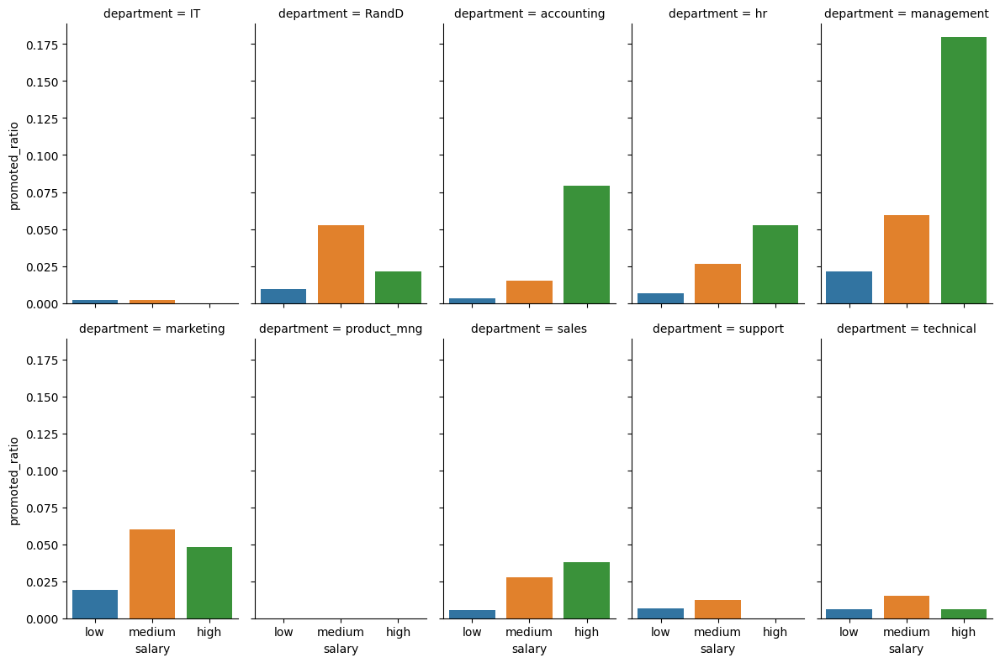

In [198]:
g = sns.catplot(
    data=result, x="salary", y="promoted_ratio", col="department",
    kind="bar", height=4, aspect=.6, col_wrap=5
)

####  department

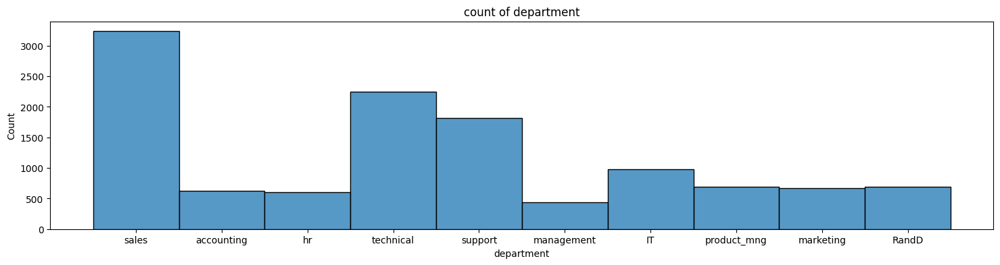

In [199]:
############################################
#department
############################################
plt.figure(figsize=(18,4))
sns.histplot(data=df_drop,x='department')
plt.title('count of department')
plt.show()

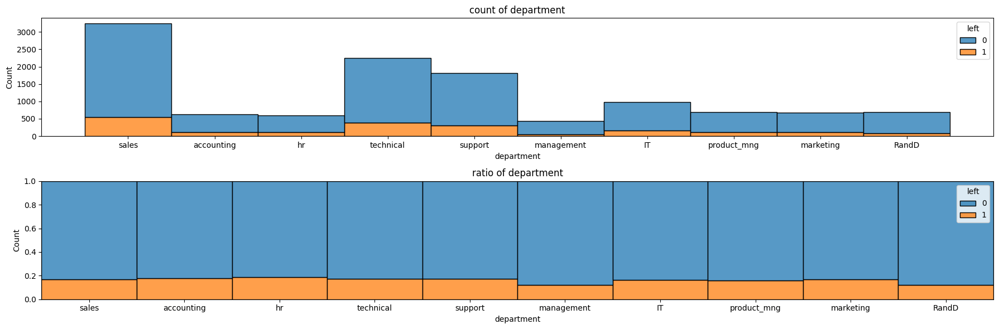

In [200]:
############################################
#department
############################################
fig, axs = plt.subplots(2,1,figsize=(18,6))
sns.histplot(data=df_drop,hue='left',x='department',palette='tab10',multiple='stack',ax=axs[0])
axs[0].set_title('count of department')
sns.histplot(data=df_drop,hue='left',x='department',palette='tab10',multiple='fill',ax=axs[1])
axs[1].set_title('ratio of department')
plt.tight_layout()
plt.show()

#####  department vs salary

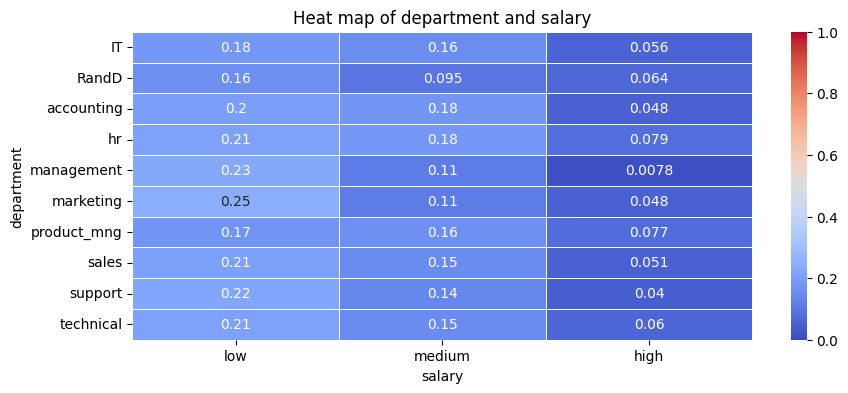

In [201]:
#############################################
#department and salary
#############################################
plt.figure(figsize=(10,4))
df_heatmap = df_drop.pivot_table(values='left',index='department',columns='salary',aggfunc=np.mean)
sns.heatmap(df_heatmap,annot=True, vmin=0, vmax=1,cmap="coolwarm", linewidth=.5)
plt.title('Heat map of department and salary')
plt.show()

Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=291.5)


department,salary,IT,RandD,accounting,hr,management,marketing,product_mng,sales,support,technical
0,low,476,322,296,296,139,310,343,1553,867,1138
1,medium,429,325,262,267,169,301,291,1449,828,940
2,high,71,47,63,38,128,62,52,237,126,166


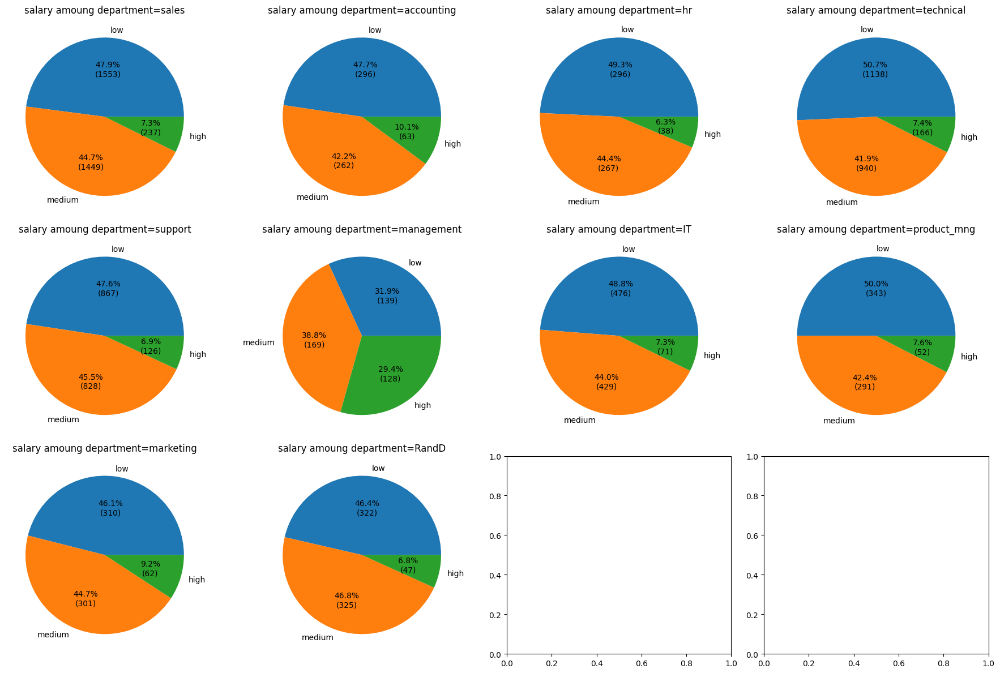

In [202]:
#$H_{0}$: No association between department and salary
#$H_{A}$: There is an association department and salary

result=pd.crosstab(df_drop['salary'], df_drop['department'])

significance_level=0.01
statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(result, correction=False)
show_test_result(statistic, pvalue,significance_level)

result=result.reset_index()
display(result)
#######################################
#Pie Chart
#######################################
col_nm=df_drop['department'].unique().tolist()
colCnt=4
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(18,rowCnt*4))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["salary"], autopct=autopct_format(result[col]))
    ax.set_title(f"salary amoung department={col}")
plt.tight_layout()
plt.show()

##### department vs emp_type

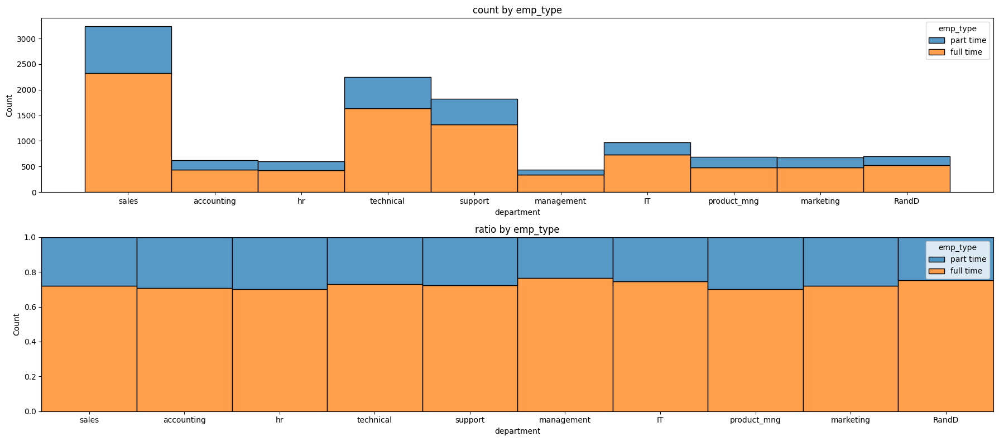

In [203]:
############################################
#department by emp_type
############################################
fig, axs = plt.subplots(2,1,figsize=(18,8))
sns.histplot(data=df_drop,hue='emp_type',x='department',palette='tab10',multiple='stack',ax=axs[0])
axs[0].set_title('count by emp_type')
sns.histplot(data=df_drop,hue='emp_type',x='department',palette='tab10',multiple='fill',ax=axs[1])
axs[1].set_title('ratio by emp_type')
plt.tight_layout()
plt.show()

In [204]:
#$H_{0}$: No association between emp_type and department
#$H_{A}$: There is an association between emp_type and department
result=pd.crosstab(df_drop['emp_type'], df_drop['department'])
display(result)

significance_level=0.01

statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(result, correction=False)

show_test_result(statistic, pvalue,significance_level)

department,IT,RandD,accounting,hr,management,marketing,product_mng,sales,support,technical
emp_type,,,,,,,,,,
full time,728,523,439,422,334,484,480,2330,1316,1640
part time,248,171,182,179,102,189,206,909,505,604


Fail to reject H0 at significance level 0.01 (Pvalue=0.105, Statistic=14.53)


##### salary vs emp_type

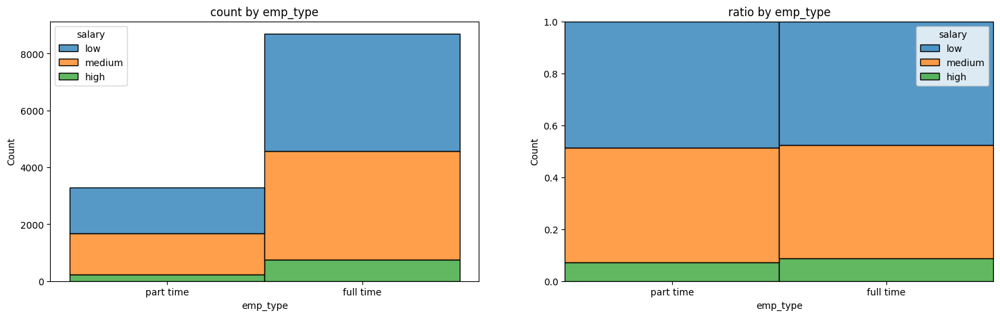

In [205]:
############################################
#salary by emp_type
############################################
fig, axs = plt.subplots(1,2,figsize=(18,5))
sns.histplot(data=df_drop,hue='salary',x='emp_type',palette='tab10',multiple='stack',binwidth=0.1,binrange=(0,1),ax=axs[0])
axs[0].set_title('count by emp_type')
sns.histplot(data=df_drop,hue='salary',x='emp_type',palette='tab10',multiple='fill',binwidth=0.1,binrange=(0,1),ax=axs[1])
axs[1].set_title('ratio by emp_type')
plt.show()

In [206]:
#$H_{0}$: No association between emp_type and salary
#$H_{A}$: There is an association between emp_type and salary
result=pd.crosstab(df_drop['emp_type'], df_drop['salary'])
display(result)

significance_level=0.01

statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(result, correction=False)

show_test_result(statistic, pvalue,significance_level)

salary,low,medium,high
emp_type,,,
full time,4134,3810,752
part time,1606,1451,238


Fail to reject H0 at significance level 0.01 (Pvalue=0.036, Statistic=6.62)


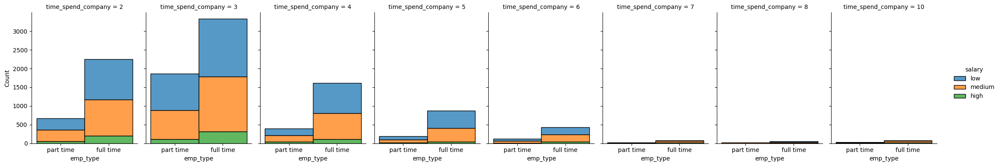

In [207]:
############################################
#salary by emp_type
#keep time_spend_company constant
############################################
g=sns.displot(
    data=df_drop, x='emp_type',  hue='salary',col="time_spend_company",
    kind="hist", height=4, aspect=.7,col_wrap=8, multiple='stack',
)
axes = g.fig.axes

plt.show()

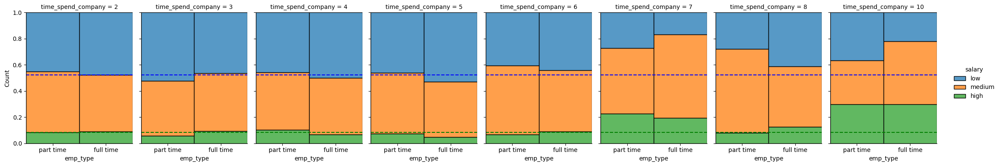

In [208]:
############################################
#salary by emp_type
#keep time_spend_company constant
############################################
g=sns.displot(
    data=df_drop, x='emp_type',  hue='salary',col="time_spend_company",
    kind="hist", height=4, aspect=.7,col_wrap=8, multiple='fill',
)
axes = g.fig.axes
high_ratio=(df_drop[df_drop['salary']=='high'].shape[0])/df_drop.shape[0]
low_ratio=(df_drop[df_drop['salary']=='low'].shape[0])/df_drop.shape[0]
for ax in axes:
    ax.axhline(high_ratio,color='green',linestyle='--')
    ax.axhline(1-low_ratio,color='blue',linestyle='--')
plt.show()

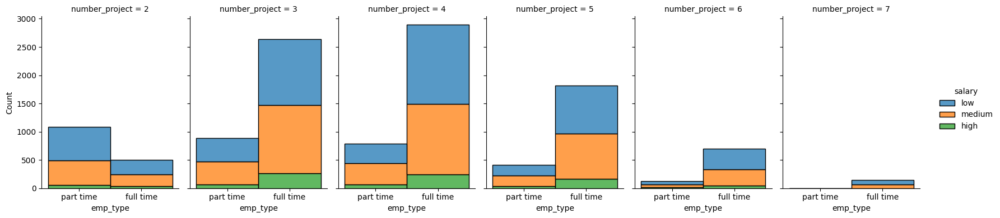

In [209]:
############################################
#salary by emp_type
#keep number_project constant
############################################
g=sns.displot(
    data=df_drop, x='emp_type',  hue='salary',col="number_project",
    kind="hist", height=4, aspect=.7, multiple='stack',
)
axes = g.fig.axes

plt.show()

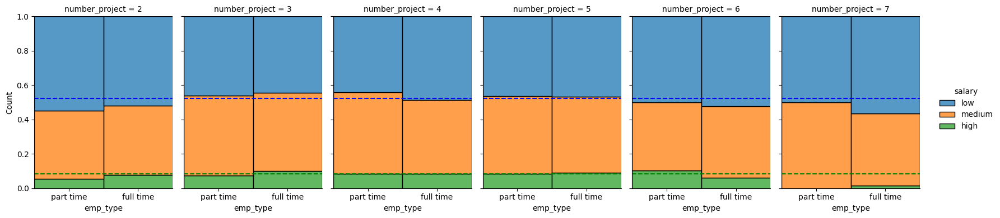

In [210]:
############################################
#salary by emp_type
#keep number_project constant
############################################
g=sns.displot(
    data=df_drop, x='emp_type',  hue='salary',col="number_project",
    kind="hist", height=4, aspect=.7, multiple='fill',
)
axes = g.fig.axes
high_ratio=(df_drop[df_drop['salary']=='high'].shape[0])/df_drop.shape[0]
low_ratio=(df_drop[df_drop['salary']=='low'].shape[0])/df_drop.shape[0]
for ax in axes:
    ax.axhline(high_ratio,color='green',linestyle='--')
    ax.axhline(1-low_ratio,color='blue',linestyle='--')
plt.show()

#### satisfaction_level
#####  satisfaction_level vs number_project

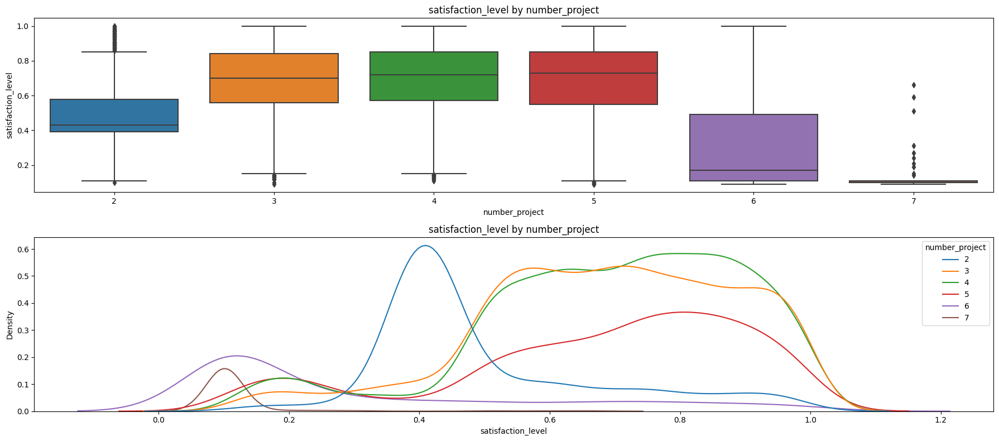

,number_project,min,max,std,mean,median,count
0,2,0.10,1.00,0.175465,0.499071,0.43,1582
1,3,0.09,1.00,0.195010,0.689418,0.70,3520
2,4,0.11,1.00,0.201637,0.694280,0.72,3685
3,5,0.09,1.00,0.235028,0.671155,0.73,2233
4,6,0.09,1.00,0.273092,0.314673,0.17,826
5,7,0.09,0.66,0.074806,0.116690,0.10,145


In [211]:
#############################################
#satisfaction_level and number_project
#############################################
fig, axs = plt.subplots(2,1,figsize=(18,8))

sns.boxplot(data=df_drop,x='number_project',y='satisfaction_level',ax=axs[0])
axs[0].set_title('satisfaction_level by number_project')

sns.kdeplot(data=df_drop,hue='number_project',x='satisfaction_level',palette='tab10',ax=axs[1])
axs[1].set_title('satisfaction_level by number_project')

plt.tight_layout()
plt.show()

display(df_drop.groupby(['number_project'])['satisfaction_level'].agg(['min','max','std','mean','median','count']).reset_index())

In [212]:
# Levene test for equal variances.
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.levene.html
#H0:All input samples are from populations with equal variances
#HA:At least one input sample are from populations with different variance
significance_level=0.01
print('Levene test result of satisfaction_level')
statistic, p_value = levene(*[df_drop['satisfaction_level'][df_drop['number_project'] == item]
                                    for item in df_drop['number_project'].unique()])
show_test_result(statistic, p_value,significance_level)

Levene test result of satisfaction_level
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=82.11)


In [213]:
# Kruskal-Wallis test
#H0:The population median of all of the groups are equal
#HA:At least one group has different median
#set significance_level 0.01
significance_level=0.01

print('Kruskal-Wallis testresult of satisfaction_level')
statistic, p_value = kruskal(*[df_drop['satisfaction_level'][df_drop['number_project'] == item]
                                    for item in df_drop['number_project'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis testresult of satisfaction_level
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=2448.59)


In [214]:
# Kolmogorov-Smirnov
# https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.ks_2samp.html
#H0:The distributions of satisfaction_level for number_project are identical.
#HA:The distributions of satisfaction_level for number_project are different.
#set significance_level 0.01
significance_level=0.01

print('Kolmogorov-Smirnov test result of satisfaction_level')

results = {}
for i, item1 in enumerate(sorted(df_drop['number_project'].unique())):
    for j, item2 in enumerate(sorted(df_drop['number_project'].unique())):
        if i < j:
            ks_stat, ks_p = ks_2samp(df_drop[df_drop['number_project'] == item1]['satisfaction_level'], 
                                     df_drop[df_drop['number_project'] == item2]['satisfaction_level'])
            if ks_p<=significance_level:
                ks_result='Reject H0'
            else:
                ks_result='Fail reject'
            results[f"{item1} vs {item2}"] = (ks_stat, ks_p ,ks_result)

# Convert the results into a DataFrame
ks_df = pd.DataFrame(results).transpose()
ks_df.columns = ['KS_Statistic', 'Pvalue','Result']
ks_df.reset_index(inplace=True)
ks_df.rename(columns={'index': 'project_number_compared'}, inplace=True)

ks_df

Kolmogorov-Smirnov test result of satisfaction_level


,project_number_compared,KS_Statistic,Pvalue,Result
0,2 vs 3,0.553291,0.0,Reject H0
1,2 vs 4,0.557631,0.0,Reject H0
2,2 vs 5,0.497886,0.0,Reject H0
3,2 vs 6,0.615334,0.0,Reject H0
4,2 vs 7,0.943969,0.0,Reject H0
5,3 vs 4,0.042241,0.003118,Reject H0
6,3 vs 5,0.07948,0.0,Reject H0
7,3 vs 6,0.642922,0.0,Reject H0
8,3 vs 7,0.934316,0.0,Reject H0
9,4 vs 5,0.068301,0.000004,Reject H0


#####  satisfaction_level vs time_spend_company

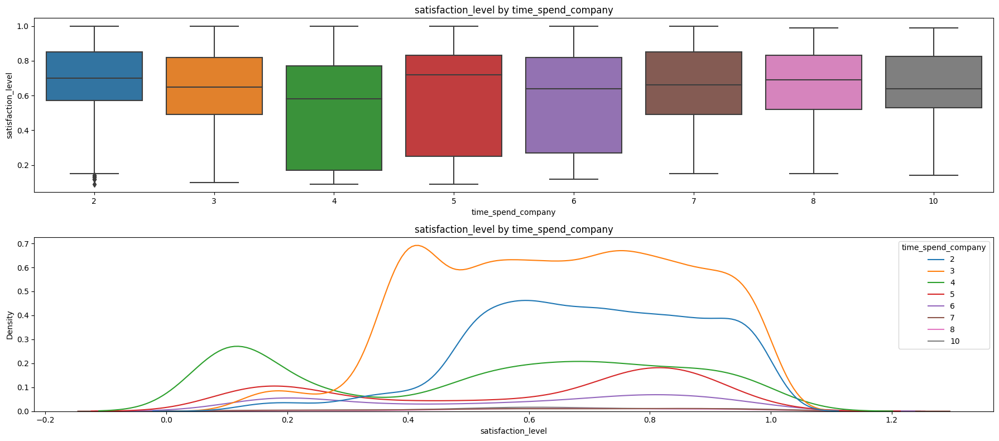

,time_spend_company,min,max,std,mean,median,count
0,2,0.09,1.00,0.184041,0.699165,0.70,2910
1,3,0.10,1.00,0.205101,0.648988,0.65,5190
2,4,0.09,1.00,0.307492,0.516090,0.58,2005
3,5,0.09,1.00,0.287610,0.583183,0.72,1062
4,6,0.12,1.00,0.279597,0.571107,0.64,542
5,7,0.15,1.00,0.245043,0.635957,0.66,94
6,8,0.15,0.99,0.212727,0.665062,0.69,81
7,10,0.14,0.99,0.218340,0.655327,0.64,107


In [215]:
#############################################
#satisfaction_level and time_spend_company
#############################################
fig, axs = plt.subplots(2,1,figsize=(18,8))

sns.boxplot(data=df_drop,x='time_spend_company',y='satisfaction_level',ax=axs[0])
axs[0].set_title('satisfaction_level by time_spend_company')

sns.kdeplot(data=df_drop,hue='time_spend_company',x='satisfaction_level',palette='tab10',ax=axs[1])
axs[1].set_title('satisfaction_level by time_spend_company')

plt.tight_layout()
plt.show()

display(df_drop.groupby(['time_spend_company'])['satisfaction_level'].agg(['min','max','std','mean','median','count']).reset_index())

In [216]:
# Levene test for equal variances.
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.levene.html
#H0:All input samples are from populations with equal variances
#HA:At least one input sample are from populations with different variance
significance_level=0.01
print('Levene test result of satisfaction_level')
statistic, p_value = levene(*[df_drop['satisfaction_level'][df_drop['time_spend_company'] == item]
                                    for item in df_drop['time_spend_company'].unique()])
show_test_result(statistic, p_value,significance_level)

Levene test result of satisfaction_level
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=189.27)


In [217]:
# Kruskal-Wallis test
#H0:The population median of all of the groups are equal
#HA:At least one group has different median
#set significance_level 0.01
significance_level=0.01

print('Kruskal-Wallis testresult of satisfaction_level')
statistic, p_value = kruskal(*[df_drop['satisfaction_level'][df_drop['time_spend_company'] == item]
                                    for item in df_drop['time_spend_company'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis testresult of satisfaction_level
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=452.26)


In [218]:
# Kolmogorov-Smirnov
# https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.ks_2samp.html
#H0:The distributions of satisfaction_level for time_spend_company are identical.
#HA:The distributions of satisfaction_level for time_spend_company are different.
#set significance_level 0.01
significance_level=0.01

print('Kolmogorov-Smirnov test result of satisfaction_level')

results = {}
for i, item1 in enumerate(sorted(df_drop['time_spend_company'].unique())):
    for j, item2 in enumerate(sorted(df_drop['time_spend_company'].unique())):
        if i < j:
            ks_stat, ks_p = ks_2samp(df_drop[df_drop['time_spend_company'] == item1]['satisfaction_level'], 
                                     df_drop[df_drop['time_spend_company'] == item2]['satisfaction_level'])
            if ks_p<=significance_level:
                ks_result='Reject H0'
            else:
                ks_result='Fail reject'
            results[f"{item1} vs {item2}"] = (ks_stat, ks_p,ks_result)

# Convert the results into a DataFrame
ks_df = pd.DataFrame(results).transpose()
ks_df.columns = ['KS_Statistic', 'Pvalue','Result']
ks_df.reset_index(inplace=True)
ks_df.rename(columns={'index': 'time_spend_company'}, inplace=True)

ks_df

Kolmogorov-Smirnov test result of satisfaction_level


,time_spend_company,KS_Statistic,Pvalue,Result
0,2 vs 3,0.157863,0.0,Reject H0
1,2 vs 4,0.316791,0.0,Reject H0
2,2 vs 5,0.275431,0.0,Reject H0
3,2 vs 6,0.293095,0.0,Reject H0
4,2 vs 7,0.17721,0.005664,Reject H0
5,2 vs 8,0.098829,0.398282,Fail reject
6,2 vs 10,0.131943,0.049929,Fail reject
7,3 vs 4,0.309129,0.0,Reject H0
8,3 vs 5,0.250389,0.0,Reject H0
9,3 vs 6,0.254221,0.0,Reject H0


#####  satisfaction_level vs work_accident

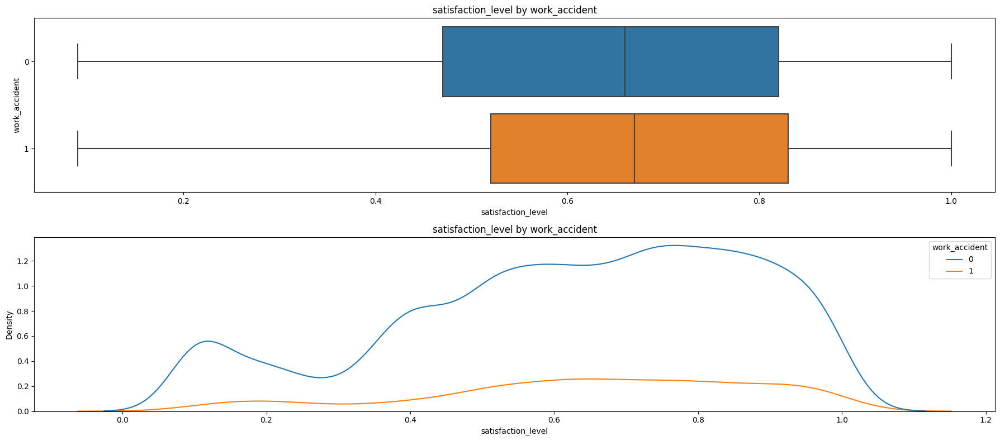

,work_accident,min,max,std,mean,median,count
0,0,0.09,1.0,0.243176,0.625546,0.66,10141
1,1,0.09,1.0,0.227933,0.652200,0.67,1850


In [219]:
#############################################
#satisfaction_level and work_accident
#############################################
fig, axs = plt.subplots(2,1,figsize=(18,8))

sns.boxplot(data=df_drop,y=df_drop['work_accident'].astype(str),x='satisfaction_level',ax=axs[0])
axs[0].set_title('satisfaction_level by work_accident')

sns.kdeplot(data=df_drop,hue='work_accident',x='satisfaction_level',palette='tab10',ax=axs[1])
axs[1].set_title('satisfaction_level by work_accident')

plt.tight_layout()
plt.show()

display(df_drop.groupby(['work_accident'])['satisfaction_level'].agg(['min','max','std','mean','median','count']).reset_index())

In [220]:
# Levene test for equal variances.
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.levene.html
#H0:All input samples are from populations with equal variances
#HA:At least one input sample are from populations with different variance
significance_level=0.01
print('Levene test result of satisfaction_level')
statistic, p_value = levene(*[df_drop['satisfaction_level'][df_drop['work_accident'] == item]
                                    for item in df_drop['work_accident'].unique()])
show_test_result(statistic, p_value,significance_level)

Levene test result of satisfaction_level
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=20.28)


In [221]:
# Kruskal-Wallis test
#H0:The population median of all of the groups are equal
#HA:At least one group has different median
#set significance_level 0.01
significance_level=0.01

print('Kruskal-Wallis testresult of satisfaction_level')
statistic, p_value = kruskal(*[df_drop['satisfaction_level'][df_drop['work_accident'] == item]
                                    for item in df_drop['work_accident'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis testresult of satisfaction_level
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=16.12)


In [222]:
# Kolmogorov-Smirnov
# https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.ks_2samp.html
#H0:The distributions of satisfaction_level for work_accident are identical.
#HA:The distributions of satisfaction_level for work_accident are different.
#set significance_level 0.01
significance_level=0.01

print('Kolmogorov-Smirnov test result of satisfaction_level')

results = {}
for i, item1 in enumerate(sorted(df_drop['work_accident'].unique())):
    for j, item2 in enumerate(sorted(df_drop['work_accident'].unique())):
        if i < j:
            ks_stat, ks_p = ks_2samp(df_drop[df_drop['work_accident'] == item1]['satisfaction_level'], 
                                     df_drop[df_drop['work_accident'] == item2]['satisfaction_level'])
            if ks_p<=significance_level:
                ks_result='Reject H0'
            else:
                ks_result='Fail reject'
            results[f"{item1} vs {item2}"] = (ks_stat, ks_p,ks_result)

# Convert the results into a DataFrame
ks_df = pd.DataFrame(results).transpose()
ks_df.columns = ['KS_Statistic', 'Pvalue','Result']
ks_df.reset_index(inplace=True)
ks_df.rename(columns={'index': 'work_accident'}, inplace=True)

ks_df

Kolmogorov-Smirnov test result of satisfaction_level


,work_accident,KS_Statistic,Pvalue,Result
0,0 vs 1,0.06594,0.000002,Reject H0


#####  satisfaction_level vs promotion_last_5years

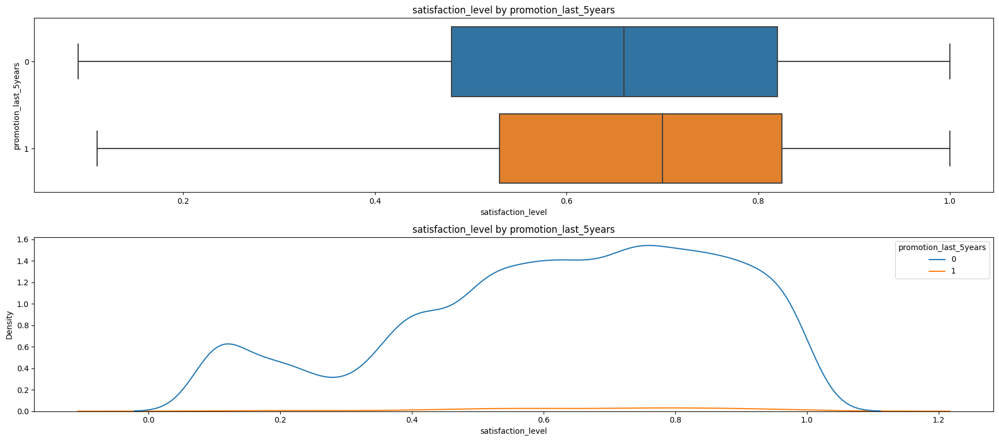

,promotion_last_5years,min,max,std,mean,median,count
0,0,0.09,1.0,0.241538,0.629032,0.66,11788
1,1,0.11,1.0,0.209470,0.666010,0.70,203


In [223]:
#############################################
#satisfaction_level and promotion_last_5years
#############################################
fig, axs = plt.subplots(2,1,figsize=(18,8))

sns.boxplot(data=df_drop,y=df_drop['promotion_last_5years'].astype(str),x='satisfaction_level',ax=axs[0])
axs[0].set_title('satisfaction_level by promotion_last_5years')

sns.kdeplot(data=df_drop,hue='promotion_last_5years',x='satisfaction_level',palette='tab10',ax=axs[1])
axs[1].set_title('satisfaction_level by promotion_last_5years')

plt.tight_layout()
plt.show()

display(df_drop.groupby(['promotion_last_5years'])['satisfaction_level'].agg(['min','max','std','mean','median','count']).reset_index())

In [224]:
# Levene test for equal variances.
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.levene.html
#H0:All input samples are from populations with equal variances
#HA:At least one input sample are from populations with different variance
significance_level=0.01
print('Levene test result of satisfaction_level')
statistic, p_value = levene(*[df_drop['satisfaction_level'][df_drop['promotion_last_5years'] == item]
                                    for item in df_drop['promotion_last_5years'].unique()])
show_test_result(statistic, p_value,significance_level)

Levene test result of satisfaction_level
Reject H0 at significance level 0.01 (Pvalue=0.008, Statistic=7.0)


In [225]:
# Kruskal-Wallis test
#H0:The population median of all of the groups are equal
#HA:At least one group has different median
#set significance_level 0.01
significance_level=0.01

print('Kruskal-Wallis testresult of satisfaction_level')
statistic, p_value = kruskal(*[df_drop['satisfaction_level'][df_drop['promotion_last_5years'] == item]
                                    for item in df_drop['promotion_last_5years'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis testresult of satisfaction_level
Fail to reject H0 at significance level 0.01 (Pvalue=0.071, Statistic=3.26)


In [226]:
# Kolmogorov-Smirnov
# https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.ks_2samp.html
#H0:The distributions of satisfaction_level for promotion_last_5years are identical.
#HA:The distributions of satisfaction_level for promotion_last_5years are different.
#set significance_level 0.01
significance_level=0.01

print('Kolmogorov-Smirnov test result of satisfaction_level')

results = {}
for i, item1 in enumerate(sorted(df_drop['promotion_last_5years'].unique())):
    for j, item2 in enumerate(sorted(df_drop['promotion_last_5years'].unique())):
        if i < j:
            ks_stat, ks_p = ks_2samp(df_drop[df_drop['promotion_last_5years'] == item1]['satisfaction_level'], 
                                     df_drop[df_drop['promotion_last_5years'] == item2]['satisfaction_level'])
            if ks_p<=significance_level:
                ks_result='Reject H0'
            else:
                ks_result='Fail reject'
            results[f"{item1} vs {item2}"] = (ks_stat, ks_p,ks_result)

# Convert the results into a DataFrame
ks_df = pd.DataFrame(results).transpose()
ks_df.columns = ['KS_Statistic', 'Pvalue','Result']
ks_df.reset_index(inplace=True)
ks_df.rename(columns={'index': 'promotion_last_5years'}, inplace=True)

ks_df

Kolmogorov-Smirnov test result of satisfaction_level


,promotion_last_5years,KS_Statistic,Pvalue,Result
0,0 vs 1,0.096709,0.044328,Fail reject


#####  satisfaction_level vs department

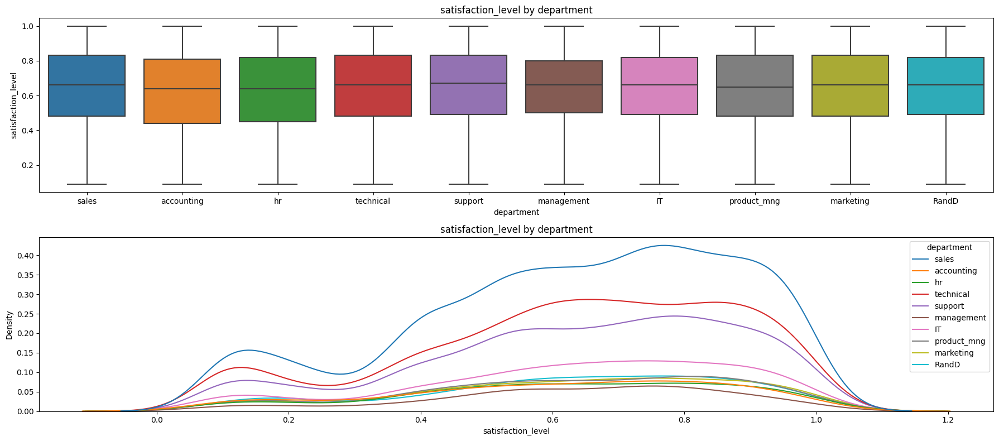

,department,min,max,std,mean,median,count
0,IT,0.09,1.0,0.239337,0.634016,0.66,976
1,RandD,0.09,1.0,0.240247,0.627176,0.66,694
2,accounting,0.09,1.0,0.244739,0.607939,0.64,621
3,hr,0.09,1.0,0.241492,0.621947,0.64,601
4,management,0.09,1.0,0.222921,0.631995,0.66,436
5,marketing,0.09,1.0,0.239505,0.634770,0.66,673
6,product_mng,0.09,1.0,0.238201,0.629825,0.65,686
7,sales,0.09,1.0,0.242549,0.631349,0.66,3239
8,support,0.09,1.0,0.240060,0.634822,0.67,1821
9,technical,0.09,1.0,0.244399,0.627937,0.66,2244


In [227]:
#############################################
#satisfaction_level and department
#############################################
fig, axs = plt.subplots(2,1,figsize=(18,8))

sns.boxplot(data=df_drop,x='department',y='satisfaction_level',ax=axs[0])
axs[0].set_title('satisfaction_level by department')

sns.kdeplot(data=df_drop,hue='department',x='satisfaction_level',palette='tab10',ax=axs[1])
axs[1].set_title('satisfaction_level by department')

plt.tight_layout()
plt.show()

display(df_drop.groupby(['department'])['satisfaction_level'].agg(['min','max','std','mean','median','count']).reset_index())

In [228]:
# Levene test for equal variances.
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.levene.html
#H0:All input samples are from populations with equal variances
#HA:At least one input sample are from populations with different variance
significance_level=0.01
print('Levene test result of satisfaction_level')
statistic, p_value = levene(*[df_drop['satisfaction_level'][df_drop['department'] == item]
                                    for item in df_drop['department'].unique()])
show_test_result(statistic, p_value,significance_level)

Levene test result of satisfaction_level
Fail to reject H0 at significance level 0.01 (Pvalue=0.376, Statistic=1.08)


In [229]:
# Kruskal-Wallis test
#H0:The population median of all of the groups are equal
#HA:At least one group has different median
#set significance_level 0.01
significance_level=0.01

print('Kruskal-Wallis testresult of satisfaction_level')
statistic, p_value = kruskal(*[df_drop['satisfaction_level'][df_drop['department'] == item]
                                    for item in df_drop['department'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis testresult of satisfaction_level
Fail to reject H0 at significance level 0.01 (Pvalue=0.574, Statistic=7.61)


In [230]:
# Kolmogorov-Smirnov
# https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.ks_2samp.html
#H0:The distributions of satisfaction_level for department are identical.
#HA:The distributions of satisfaction_level for department are different.
#set significance_level 0.01
significance_level=0.01

print('Kolmogorov-Smirnov test result of satisfaction_level')

results = {}
for i, item1 in enumerate(sorted(df_drop['department'].unique())):
    for j, item2 in enumerate(sorted(df_drop['department'].unique())):
        if i < j:
            ks_stat, ks_p = ks_2samp(df_drop[df_drop['department'] == item1]['satisfaction_level'], 
                                     df_drop[df_drop['department'] == item2]['satisfaction_level'])
            if ks_p<=significance_level:
                ks_result='Reject H0'
            else:
                ks_result='Fail reject'
            results[f"{item1} vs {item2}"] = (ks_stat, ks_p,ks_result)

# Convert the results into a DataFrame
ks_df = pd.DataFrame(results).transpose()
ks_df.columns = ['KS_Statistic', 'Pvalue','Result']
ks_df.reset_index(inplace=True)
ks_df.rename(columns={'index': 'department'}, inplace=True)

ks_df

Kolmogorov-Smirnov test result of satisfaction_level


,department,KS_Statistic,Pvalue,Result
0,IT vs RandD,0.026509,0.928431,Fail reject
1,IT vs accounting,0.067529,0.059379,Fail reject
2,IT vs hr,0.050745,0.281342,Fail reject
3,IT vs management,0.051145,0.39329,Fail reject
4,IT vs marketing,0.030074,0.849783,Fail reject
5,IT vs product_mng,0.037178,0.61593,Fail reject
6,IT vs sales,0.022792,0.820263,Fail reject
7,IT vs support,0.015135,0.998091,Fail reject
8,IT vs technical,0.021905,0.890724,Fail reject
9,RandD vs accounting,0.056338,0.23701,Fail reject


#####  satisfaction_level vs salary

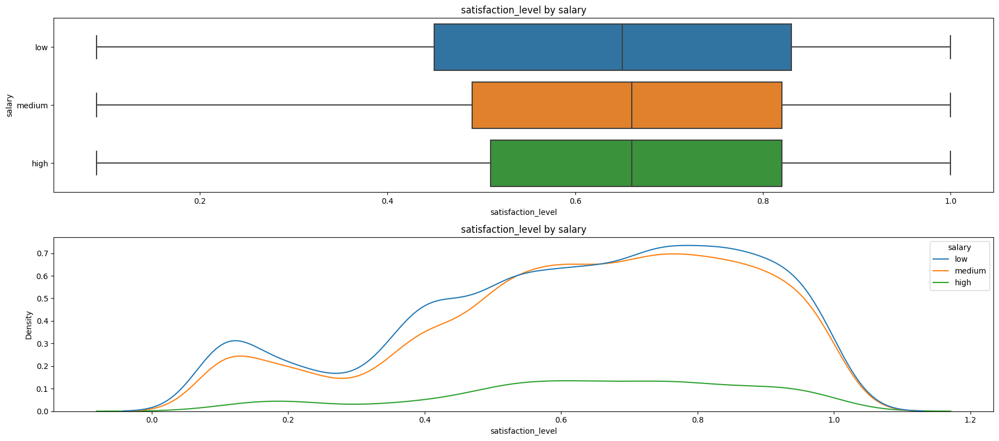

,salary,min,max,std,mean,median,count
0,low,0.09,1.0,0.246637,0.622655,0.65,5740
1,medium,0.09,1.0,0.237343,0.634723,0.66,5261
2,high,0.09,1.0,0.226611,0.643343,0.66,990


In [231]:
#############################################
#satisfaction_level and salary
#############################################
fig, axs = plt.subplots(2,1,figsize=(18,8))

sns.boxplot(data=df_drop,y=df_drop['salary'].astype(str),x='satisfaction_level',ax=axs[0])
axs[0].set_title('satisfaction_level by salary')

sns.kdeplot(data=df_drop,hue='salary',x='satisfaction_level',palette='tab10',ax=axs[1])
axs[1].set_title('satisfaction_level by salary')

plt.tight_layout()
plt.show()

display(df_drop.groupby(['salary'])['satisfaction_level'].agg(['min','max','std','mean','median','count']).reset_index())

In [232]:
# Levene test for equal variances.
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.levene.html
#H0:All input samples are from populations with equal variances
#HA:At least one input sample are from populations with different variance
significance_level=0.01
print('Levene test result of satisfaction_level')
statistic, p_value = levene(*[df_drop['satisfaction_level'][df_drop['salary'] == item]
                                    for item in df_drop['salary'].unique()])
show_test_result(statistic, p_value,significance_level)

Levene test result of satisfaction_level
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=13.0)


In [233]:
# Kruskal-Wallis test
#H0:The population median of all of the groups are equal
#HA:At least one group has different median
#set significance_level 0.01
significance_level=0.01

print('Kruskal-Wallis testresult of satisfaction_level')
statistic, p_value = kruskal(*[df_drop['satisfaction_level'][df_drop['salary'] == item]
                                    for item in df_drop['salary'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis testresult of satisfaction_level
Fail to reject H0 at significance level 0.01 (Pvalue=0.034, Statistic=6.75)


In [234]:
# Kolmogorov-Smirnov
# https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.ks_2samp.html
#H0:The distributions of satisfaction_level for department are identical.
#HA:The distributions of satisfaction_level for department are different.
#set significance_level 0.01
significance_level=0.01

print('Kolmogorov-Smirnov test result of satisfaction_level')

results = {}
for i, item1 in enumerate(sorted(df_drop['salary'].unique())):
    for j, item2 in enumerate(sorted(df_drop['salary'].unique())):
        if i < j:
            ks_stat, ks_p = ks_2samp(df_drop[df_drop['salary'] == item1]['satisfaction_level'], 
                                     df_drop[df_drop['salary'] == item2]['satisfaction_level'])
            if ks_p<=significance_level:
                ks_result='Reject H0'
            else:
                ks_result='Fail reject'
            results[f"{item1} vs {item2}"] = (ks_stat, ks_p,ks_result)

# Convert the results into a DataFrame
ks_df = pd.DataFrame(results).transpose()
ks_df.columns = ['KS_Statistic', 'Pvalue','Result']
ks_df.reset_index(inplace=True)
ks_df.rename(columns={'index': 'salary'}, inplace=True)

ks_df

Kolmogorov-Smirnov test result of satisfaction_level


,salary,KS_Statistic,Pvalue,Result
0,high vs low,0.076236,0.000102,Reject H0
1,high vs medium,0.037147,0.194846,Fail reject
2,low vs medium,0.039978,0.000298,Reject H0


#####  satisfaction_level vs last_evaluation

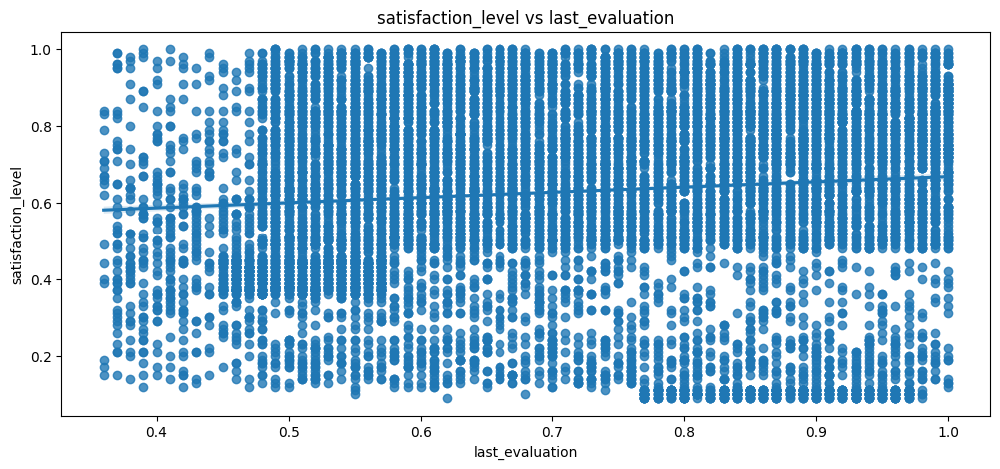

In [235]:
plt.figure(figsize=(12,5))
sns.regplot(data=df_drop, x="last_evaluation", y="satisfaction_level")
plt.title('satisfaction_level vs last_evaluation')
plt.show()

In [236]:
#H0: There is no correlation between the two variables in the population.
#H1: There is a significant correlation between the two variables in the population.
significance_level=0.01
statistic, p_value=stats.spearmanr(df_drop['last_evaluation'], df_drop['satisfaction_level'])
show_test_result(statistic, p_value, significance_level)

Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=0.14)


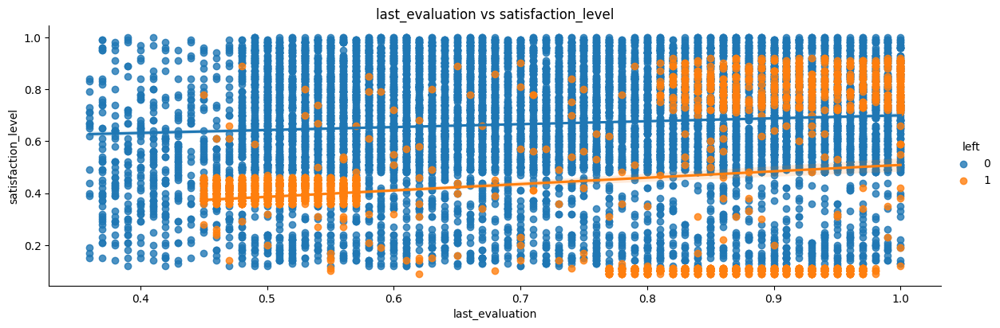

In [237]:
sns.lmplot(data=df_drop, x="last_evaluation", y="satisfaction_level",
           hue='left',height=4,aspect=3)
plt.title('last_evaluation vs satisfaction_level')
plt.show()

#=>we can observe 3 patterns, middle evaluation middle satisfaction, high evaluation low satisfaction and high evaluation high satisfaction

#Group1: low-middle last_evaluation, low-middle satisfaction_level
#0.45<=last_evaluation<=0.57
#0.36<=satisfaction_level<=0.46
#number_project=2
#time_spend_company=3

#Group2: high last_evaluation, low satisfaction_level
#0.77<=last_evaluation<=0.98
#0.09<=satisfaction_level<=0.11
#number_project=5,6,7
#time_spend_company=4,5

#Group3: high last_evaluation, high satisfaction_level
#0.81<=last_evaluation<=1
#0.72<=satisfaction_level<=0.92
#number_project=4,5
#time_spend_company=5,6

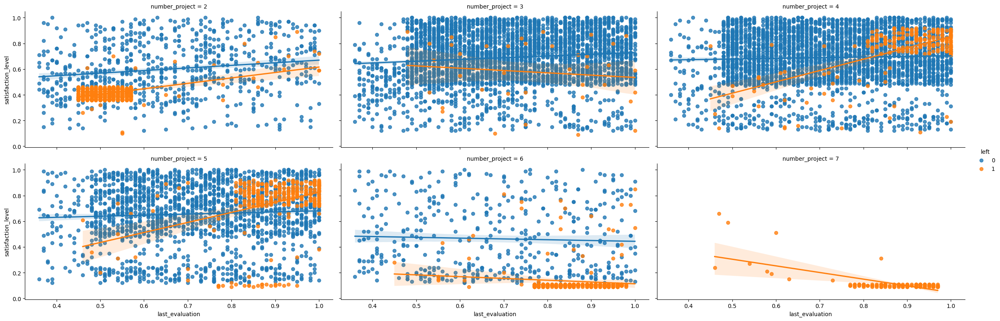

In [238]:
#############################################
# satisfaction_level vs last_evaluation
# by left
# keep number_project constant
#############################################
sns.lmplot(data=df_drop, x="last_evaluation", y="satisfaction_level",
           col='number_project',col_wrap=3,
           hue='left',height=4,aspect=2)
plt.show()
#=>we can observe left bottom pattern in number_project=2
#=>we can observe right top pattern in number_project=4,5
#=>we can observe right bottom pattern in number_project=5(maybe),6,7

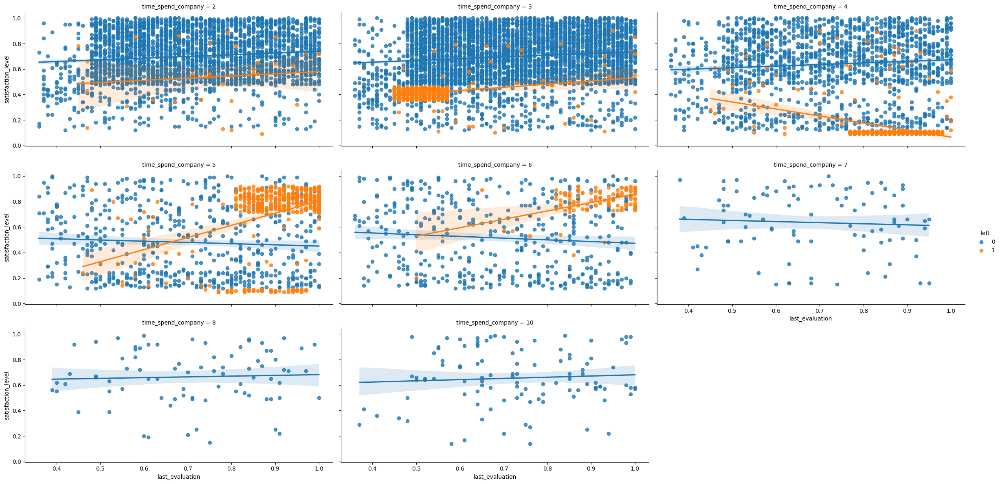

In [239]:
#############################################
# satisfaction_level vs last_evaluation
# by left
# keep time_spend_company constant
#############################################
sns.lmplot(data=df_drop, x="last_evaluation", y="satisfaction_level",
           col='time_spend_company',col_wrap=3,
           hue='left',height=4,aspect=2)
plt.show()
#=>we can observe left bottom pattern in time_spend_company=3
#=>we can observe right top pattern in time_spend_company=5,6
#=>we can observe right bottom pattern in time_spend_company=4,5

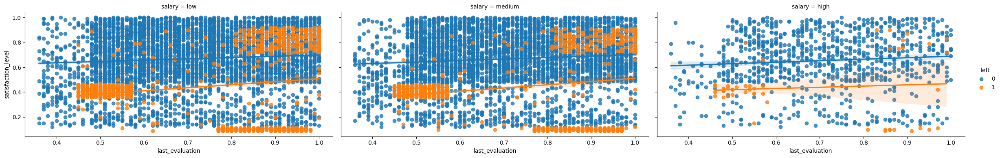

In [240]:
#############################################
# satisfaction_level vs last_evaluation
# by left
# keep salary constant
#############################################
sns.lmplot(data=df_drop, x="last_evaluation", y="satisfaction_level",
           col='salary',col_wrap=3,
           hue='left',height=4,aspect=2)
plt.show()
#=>can observe similar patterns in all salary

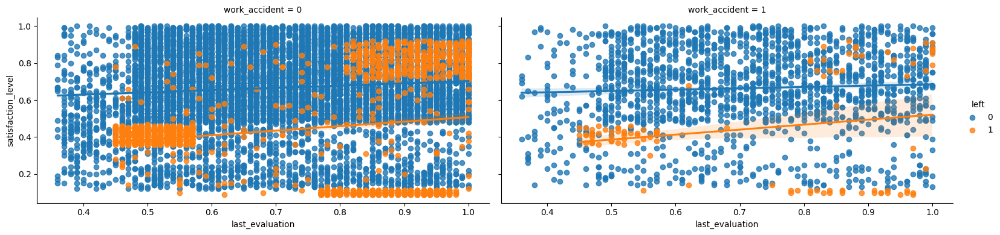

In [241]:
#############################################
# satisfaction_level vs last_evaluation
# by left
# keep work_accident constant
#############################################
sns.lmplot(data=df_drop, x="last_evaluation", y="satisfaction_level",
           col='work_accident',col_wrap=2,
           hue='left',height=4,aspect=2)
plt.show()
#=>can observe similar patterns in work_accident=0 or 1

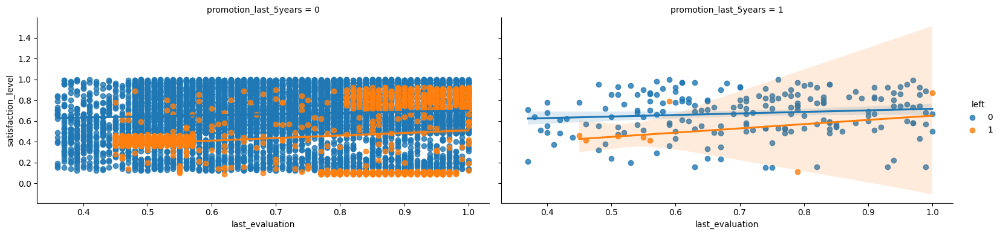

In [242]:
#############################################
# satisfaction_level vs last_evaluation
# by left
# keep promotion_last_5years constant
#############################################
sns.lmplot(data=df_drop, x="last_evaluation", y="satisfaction_level",
           col='promotion_last_5years',col_wrap=2,
           hue='left',height=4,aspect=2)
plt.show()
#=>can observe similar patterns in promotion_last_5years=0
#=>only a few records in promotion_last_5years=1, difficult to confirm pattern(no clear pattern)
#=>maybe promotion_last_5years=1 we can observe left bottom pattern

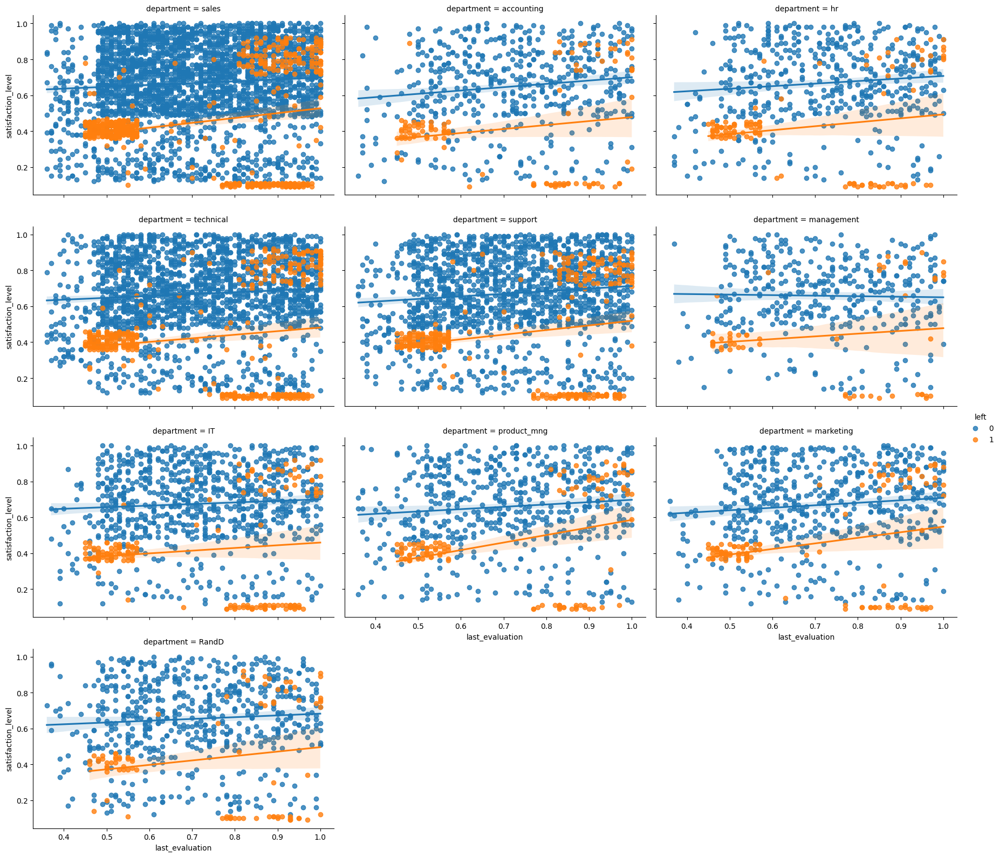

In [243]:
#############################################
# satisfaction_level vs last_evaluation
# by left
# keep department constant
#############################################
sns.lmplot(data=df_drop, x="last_evaluation", y="satisfaction_level",
           col='department',col_wrap=3,
           hue='left',height=4,aspect=1.5)
plt.show()
#=>we can observe similar patterns in all departments

#####  satisfaction_level vs average_monthly_hours

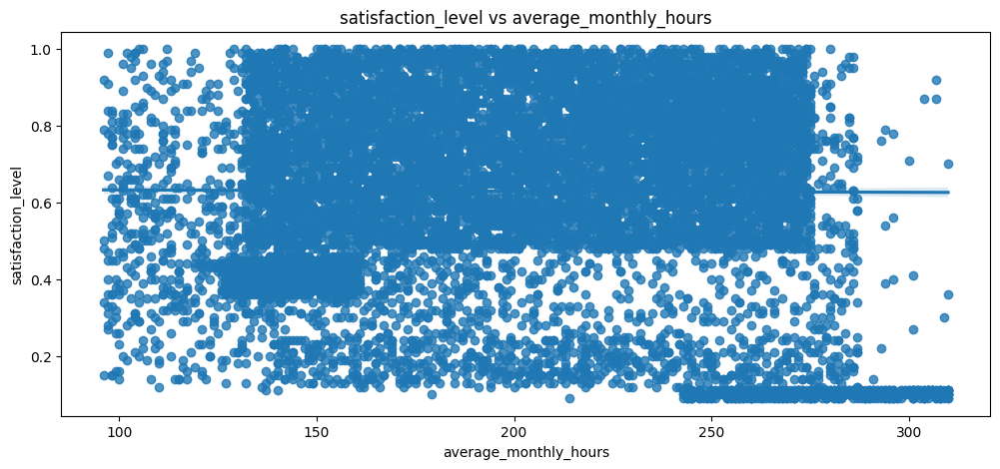

In [244]:
plt.figure(figsize=(12,5))
sns.regplot(data=df_drop, x="average_monthly_hours", y="satisfaction_level")
plt.title('satisfaction_level vs average_monthly_hours')
plt.show()

In [245]:
#H0: There is no correlation between the two variables in the population.
#H1: There is a significant correlation between the two variables in the population.
significance_level=0.01
statistic, p_value=stats.spearmanr(df_drop['average_monthly_hours'], df_drop['satisfaction_level'])
show_test_result(statistic, p_value, significance_level)

Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=0.06)


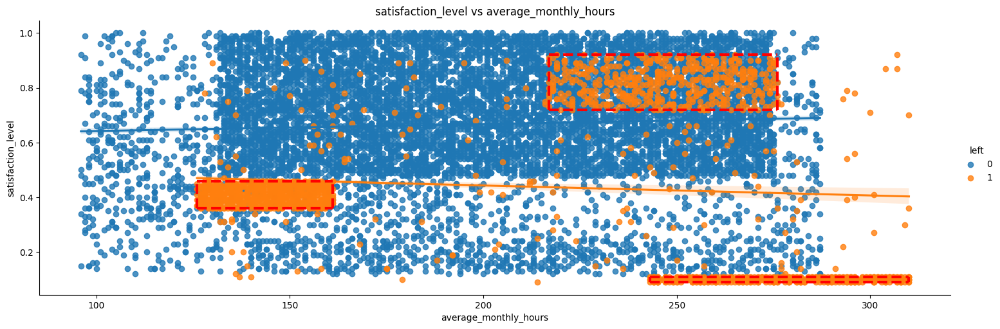

In [246]:
g=sns.lmplot(data=df_drop, x="average_monthly_hours", y="satisfaction_level",
           hue='left',height=5,aspect=3)
axes = g.fig.axes
for ax in axes:
    x_min,x_max=ax.get_xlim()
    x_width=x_max-x_min
    y_min,y_max=ax.get_ylim()
    y_width=y_max-y_min
    #add line to group 1
    gp1_hstart=(126-x_min)/x_width
    gp1_hend=(161-x_min)/x_width
    ax.axhline(0.36,gp1_hstart,gp1_hend,color='red',linestyle='--',lw=3)
    ax.axhline(0.46,gp1_hstart,gp1_hend,color='red',linestyle='--',lw=3)
    gp1_vstart=(0.36-y_min)/y_width
    gp1_vend=(0.46-y_min)/y_width
    ax.axvline(126,gp1_vstart,gp1_vend,color='red',linestyle='--',lw=3)
    ax.axvline(161,gp1_vstart,gp1_vend,color='red',linestyle='--',lw=3)
    
    #add line to group 2
    gp2_hstart=(243-x_min)/x_width
    gp2_hend=(310-x_min)/x_width
    ax.axhline(0.09,gp2_hstart,gp2_hend,color='red',linestyle='--',lw=3)
    ax.axhline(0.11,gp2_hstart,gp2_hend,color='red',linestyle='--',lw=3)
    gp2_vstart=(0.09-y_min)/y_width
    gp2_vend=(0.11-y_min)/y_width
    ax.axvline(243,gp2_vstart,gp2_vend,color='red',linestyle='--',lw=3)
    ax.axvline(310,gp2_vstart,gp2_vend,color='red',linestyle='--',lw=3)
    
    #add line to group 3
    gp3_hstart=(217-x_min)/x_width
    gp3_hend=(276-x_min)/x_width
    ax.axhline(0.72,gp3_hstart,gp3_hend,color='red',linestyle='--',lw=3)
    ax.axhline(0.92,gp3_hstart,gp3_hend,color='red',linestyle='--',lw=3)
    gp3_vstart=(0.72-y_min)/y_width
    gp3_vend=(0.92-y_min)/y_width
    ax.axvline(217,gp3_vstart,gp3_vend,color='red',linestyle='--',lw=3)
    ax.axvline(276,gp3_vstart,gp3_vend,color='red',linestyle='--',lw=3)
plt.title('satisfaction_level vs average_monthly_hours')
plt.show()
#=>we can observe 3 patterns(orange rectangles)
#Group1: low-middle average_monthly_hours, low-middle satisfaction_level
#126<= average_monthly_hours <=161
#0.36<=satisfaction_level<=0.46
#number_project=2
#time_spend_company=3

#Group2: high average_monthly_hours, low satisfaction_level
#243<= average_monthly_hours <=310
#0.09<=satisfaction_level<=0.11
#number_project=5,6,7
#time_spend_company=4,5

#Group3: high average_monthly_hours, high satisfaction_level
#217<= average_monthly_hours <=276
#0.72<=satisfaction_level<=0.92
#number_project=4,5
#time_spend_company=5,6


In [247]:
df_drop.to_csv('SalifortMotors.csv', index=True)
df_drop.describe()

,satisfaction_level,last_evaluation,number_project,average_monthly_hours,time_spend_company,work_accident,left,promotion_last_5years,salary_encoding
count,11991.000000,11991.000000,11991.000000,11991.000000,11991.000000,11991.000000,11991.000000,11991.000000,11991.00000
mean,0.629658,0.716683,3.802852,200.473522,3.364857,0.154282,0.166041,0.016929,0.60387
std,0.241070,0.168343,1.163238,48.727813,1.330240,0.361234,0.372133,0.129012,0.63590
min,0.090000,0.360000,2.000000,96.000000,2.000000,0.000000,0.000000,0.000000,0.00000
25%,0.480000,0.570000,3.000000,157.000000,3.000000,0.000000,0.000000,0.000000,0.00000
50%,0.660000,0.720000,4.000000,200.000000,3.000000,0.000000,0.000000,0.000000,1.00000
75%,0.820000,0.860000,5.000000,243.000000,4.000000,0.000000,0.000000,0.000000,1.00000
max,1.000000,1.000000,7.000000,310.000000,10.000000,1.000000,1.000000,1.000000,2.00000


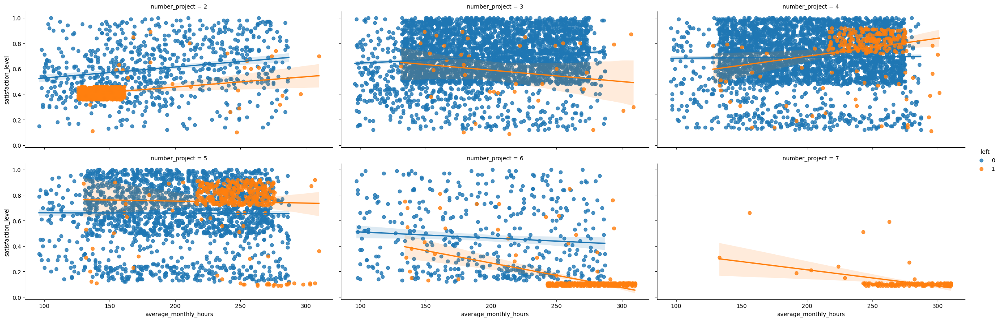

In [248]:
#############################################
# satisfaction_level vs average_monthly_hours
# by left
# keep number_project constant
#############################################
sns.lmplot(data=df_drop, x="average_monthly_hours", y="satisfaction_level",
           col='number_project',col_wrap=3,
           hue='left',height=4,aspect=2)
plt.show()
#=>we can observe left bottom pattern in number_project=2
#=>we can observe right top pattern in number_project=4,5
#=>we can observe right bottom pattern in number_project=5(maybe),6,7

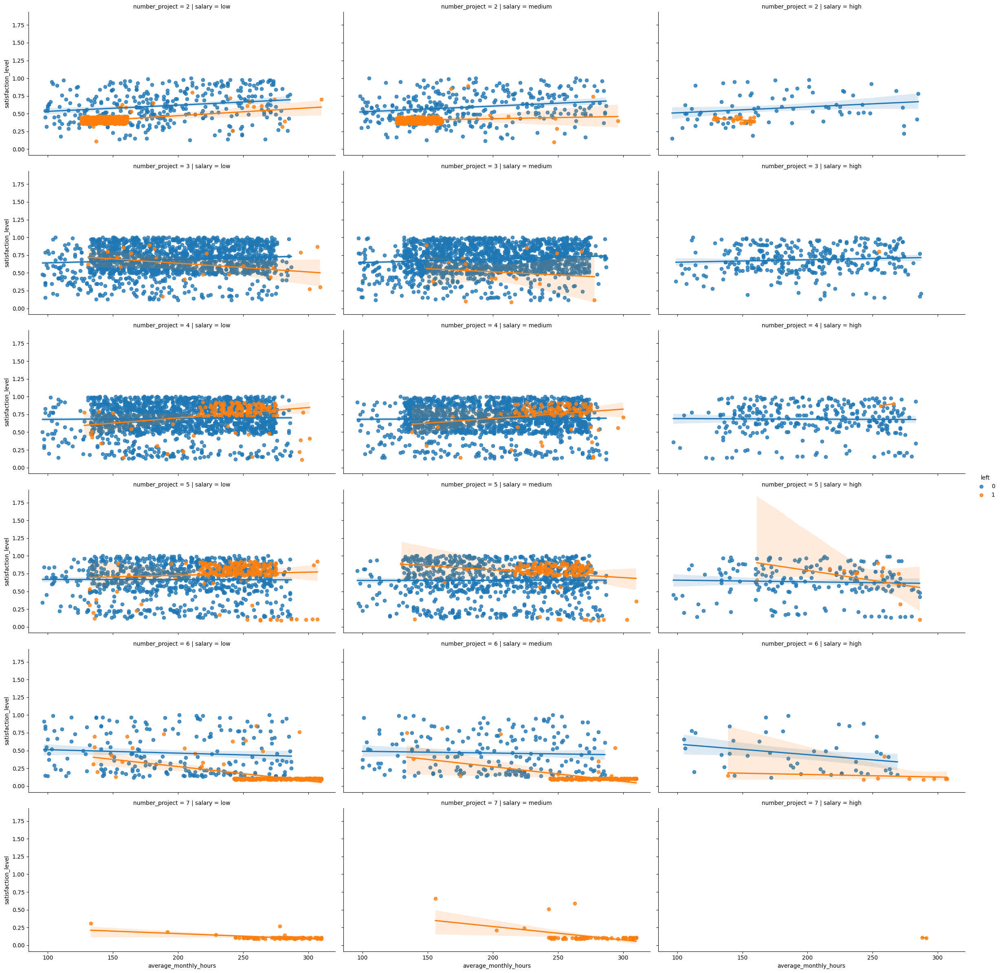

In [249]:
#############################################
# satisfaction_level vs average_monthly_hours
# by left
# keep number_project and salary constant
#############################################
sns.lmplot(data=df_drop, x="average_monthly_hours", y="satisfaction_level",
           row='number_project',col='salary',
           hue='left',height=4,aspect=2)
plt.show()
#=>we can observe left bottom pattern in number_project=2 for all salary
#=>we can observe right top pattern in number_project=4,5 for low and medium salary
#=>we can observe right bottom pattern in number_project=5,6,7 for low and medium (difficult to comfirm pattern in high salary, maybe have)

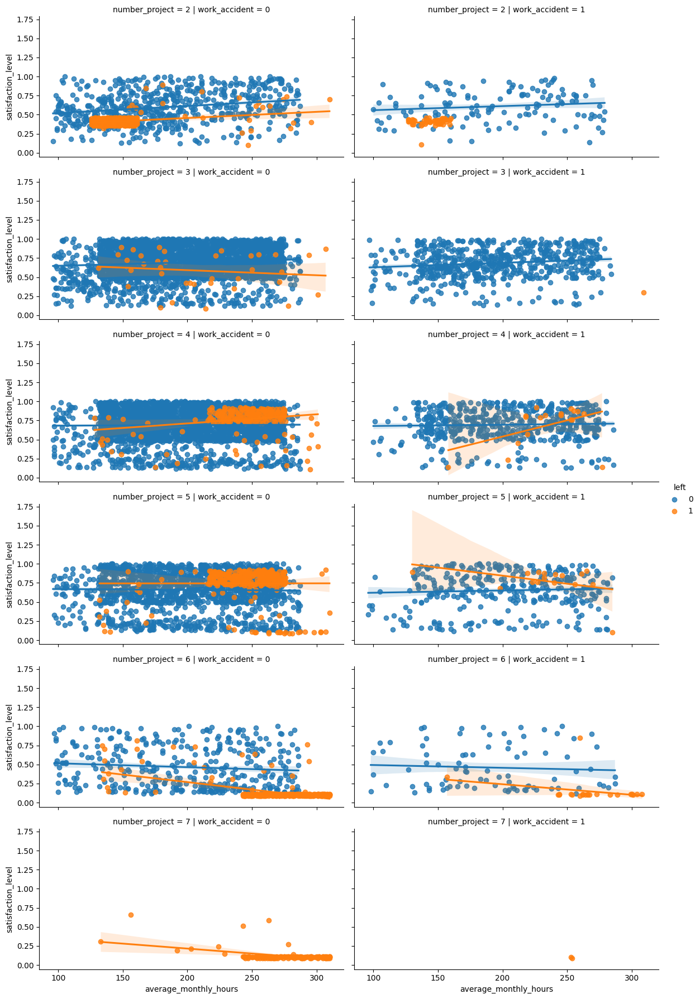

In [250]:
#############################################
# satisfaction_level vs average_monthly_hours
# by left
# keep number_project and work_accident constant
#############################################
sns.lmplot(data=df_drop, x="average_monthly_hours", y="satisfaction_level",
           row='number_project',col='work_accident',
           hue='left',height=3,aspect=2)
plt.show()
#=>we can observe patterns in work_accident=1 or work_accident=0


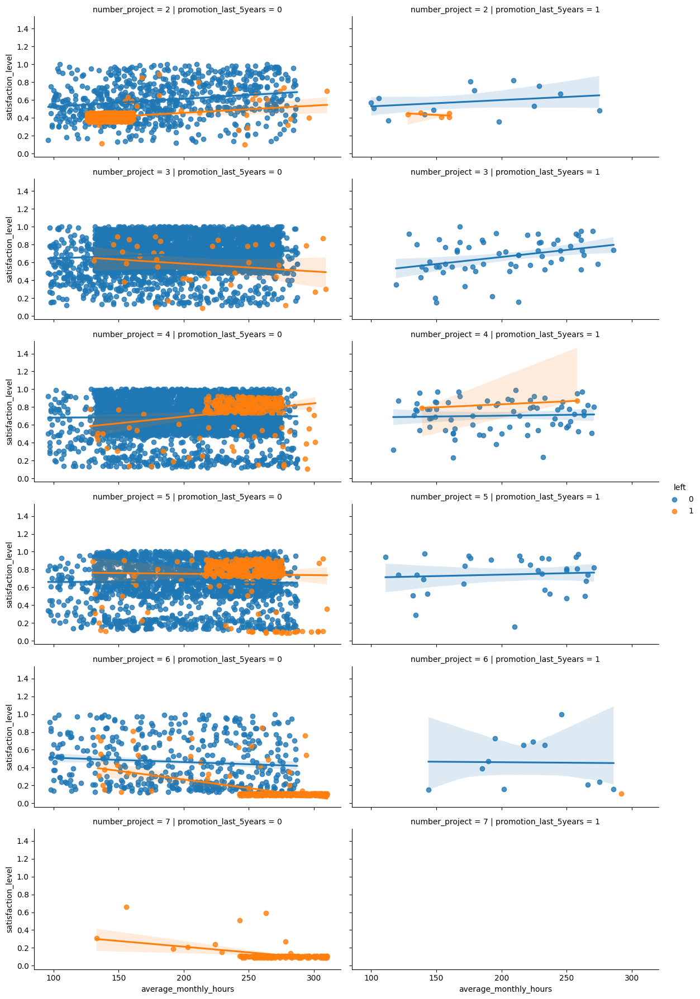

In [251]:
#############################################
# satisfaction_level vs average_monthly_hours
# by left
# keep number_project and promotion_last_5years constant
#############################################
sns.lmplot(data=df_drop, x="average_monthly_hours", y="satisfaction_level",
           row='number_project',col='promotion_last_5years',
           hue='left',height=3,aspect=2)
plt.show()
#=>we can observe left bottom pattern in number_project=2 and promotion_last_5years=0 or 1
#=>we can observe right top pattern in number_project=4,5 and promotion_last_5years=0
#=>we can observe right bottom pattern in number_project=5,6,7 and promotion_last_5years=0

#promotion_last_5years might be a condition

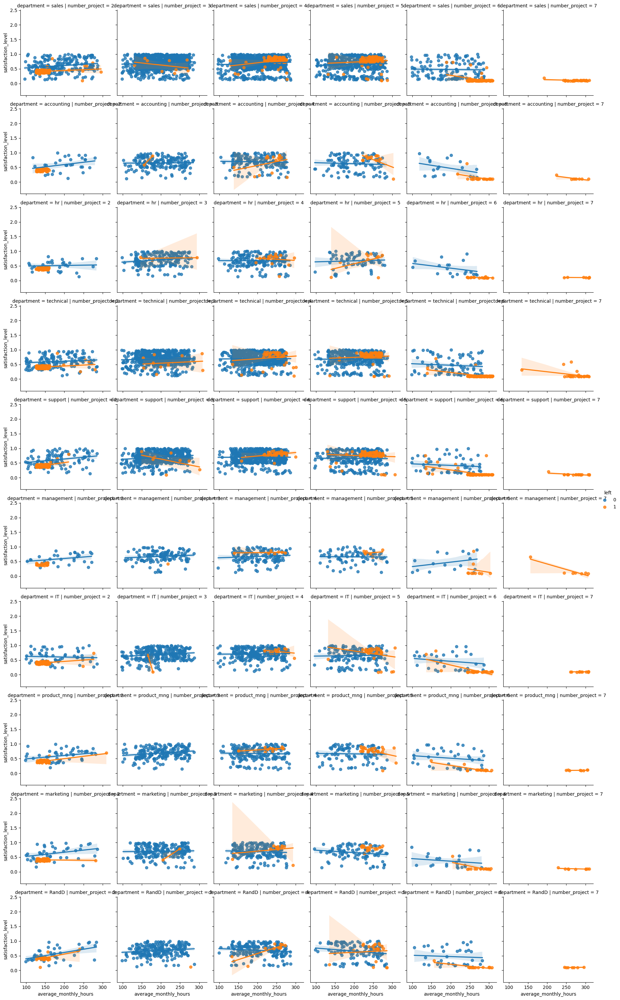

In [252]:
#############################################
# satisfaction_level vs average_monthly_hours
# by left
# keep number_project and department constant
#############################################
sns.lmplot(data=df_drop, x="average_monthly_hours", y="satisfaction_level",
           col='number_project',row='department',
           hue='left',height=3,aspect=1)
plt.show()

#=>we can observe left bottom pattern in number_project=2 across all department
#=>we can observe right top pattern in number_project=4,5 across all department
#=>we can observe right bottom pattern in number_project=6,7 across all department (number_project=5 difficult to observe pattern)

#=>Since all departments had similar pattern, it might be layoff due to restructuring.

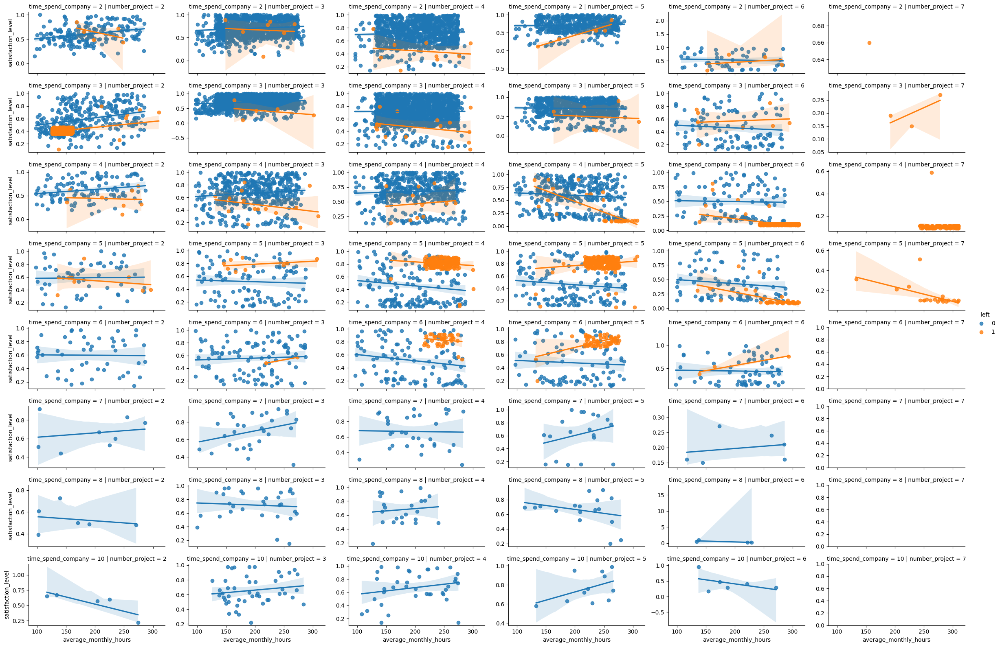

In [253]:
#############################################
# satisfaction_level vs average_monthly_hours
# by left
# keep number_project and time_spend_company constant
#############################################
sns.lmplot(data=df_drop, x="average_monthly_hours", y="satisfaction_level",
           col='number_project',row='time_spend_company',
           hue='left',height=2,aspect=2,
          facet_kws=dict(sharey=False))
plt.show()

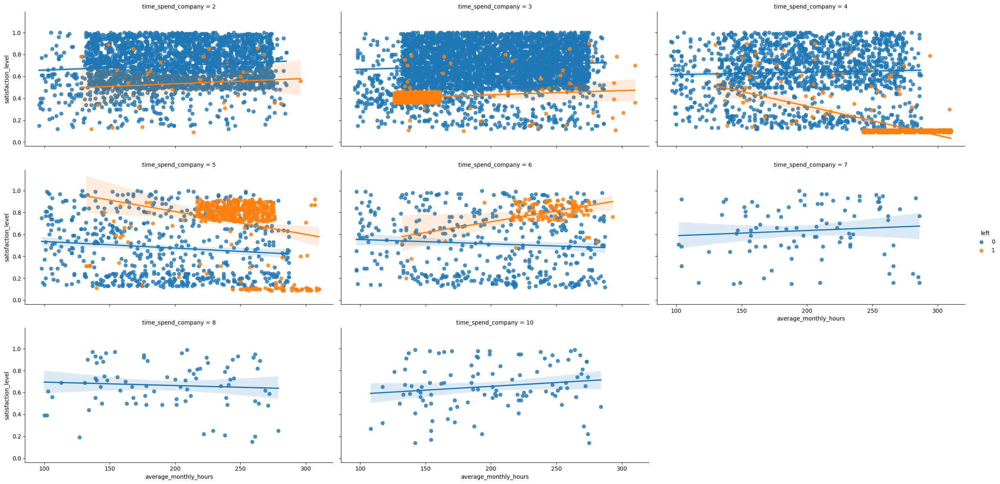

In [254]:
#############################################
# satisfaction_level vs average_monthly_hours
# by left
# keep time_spend_company constant
#############################################
sns.lmplot(data=df_drop, x="average_monthly_hours", y="satisfaction_level",
           col='time_spend_company',col_wrap=3,
           hue='left',height=4,aspect=2)
plt.show()

#=>we can observe left bottom pattern in time_spend_company=3
#=>we can observe right top pattern in time_spend_company=5,6
#=>we can observe right bottom pattern in time_spend_company=4,5

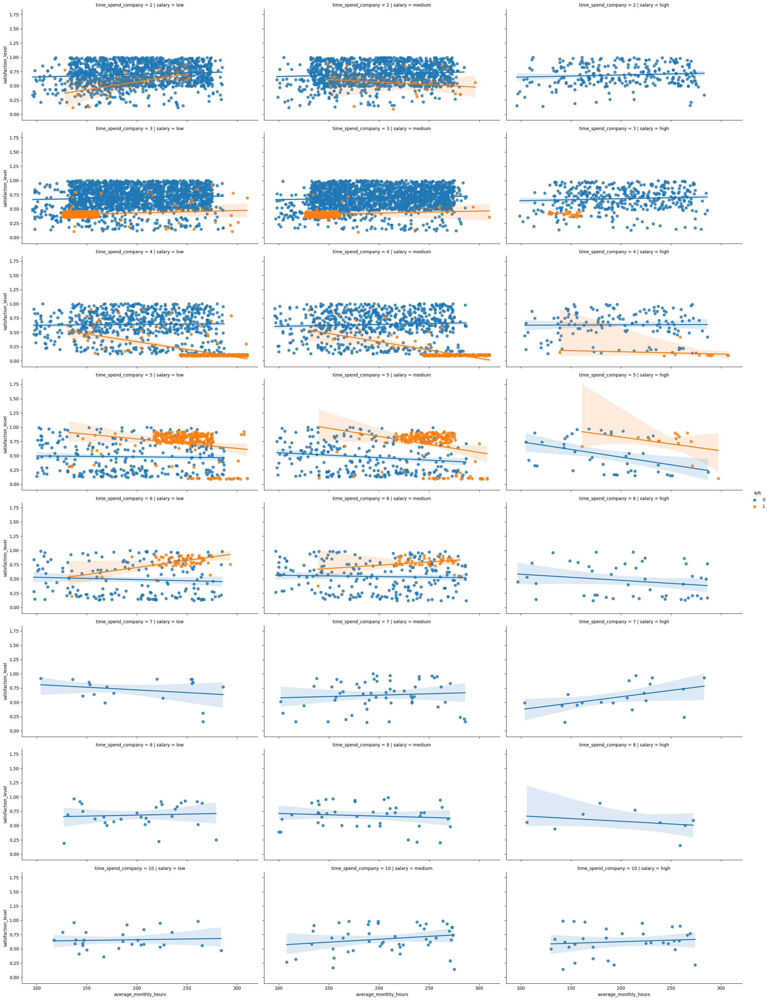

In [255]:
#############################################
# satisfaction_level vs average_monthly_hours
# by left
# keep time_spend_company and salary constant
#############################################
sns.lmplot(data=df_drop, x="average_monthly_hours", y="satisfaction_level",
           row='time_spend_company',col='salary',
           hue='left',height=4,aspect=2)
plt.show()
#=>we can observe left bottom pattern in time_spend_company=3 across all salary
#=>we can observe right top pattern in time_spend_company=5,6 in low and medium salary (Not sure time_spend_company=5 | salary=high)
#=>we can observe right bottom pattern in time_spend_company=4,5  in low and medium salary

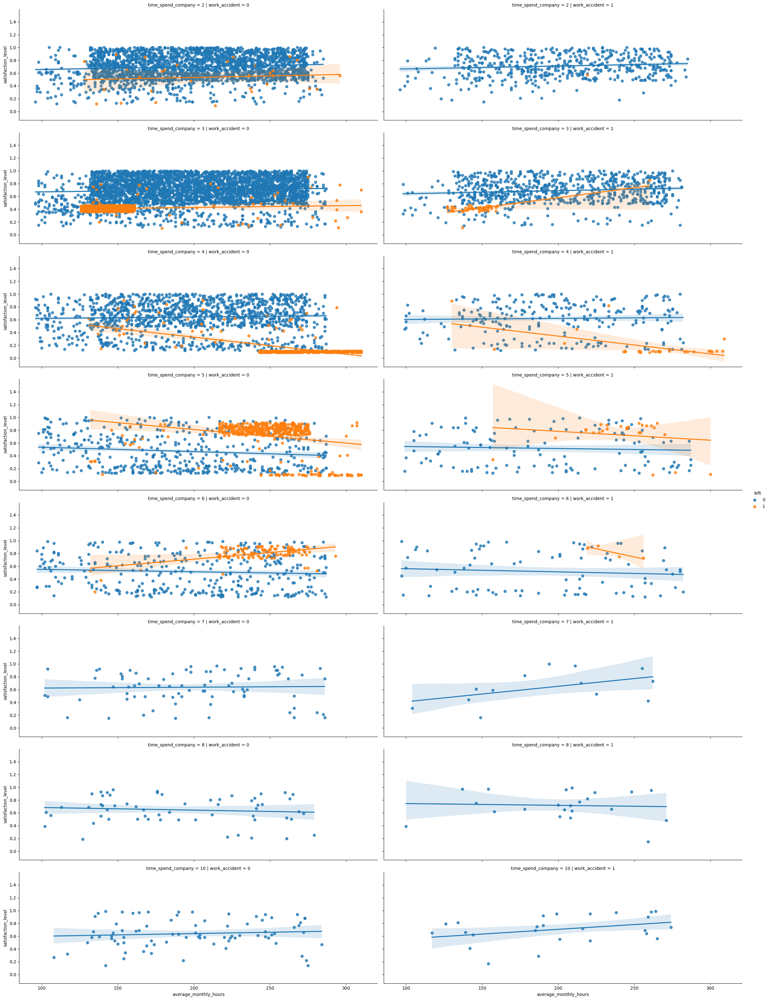

In [256]:
#############################################
# satisfaction_level vs average_monthly_hours
# by left
# keep time_spend_company and work_accident constant
#############################################
sns.lmplot(data=df_drop, x="average_monthly_hours", y="satisfaction_level",
           row='time_spend_company',col='work_accident',
           hue='left',height=4,aspect=3)
plt.show()
#=>we can observe pattern in work_accident=0 or 1

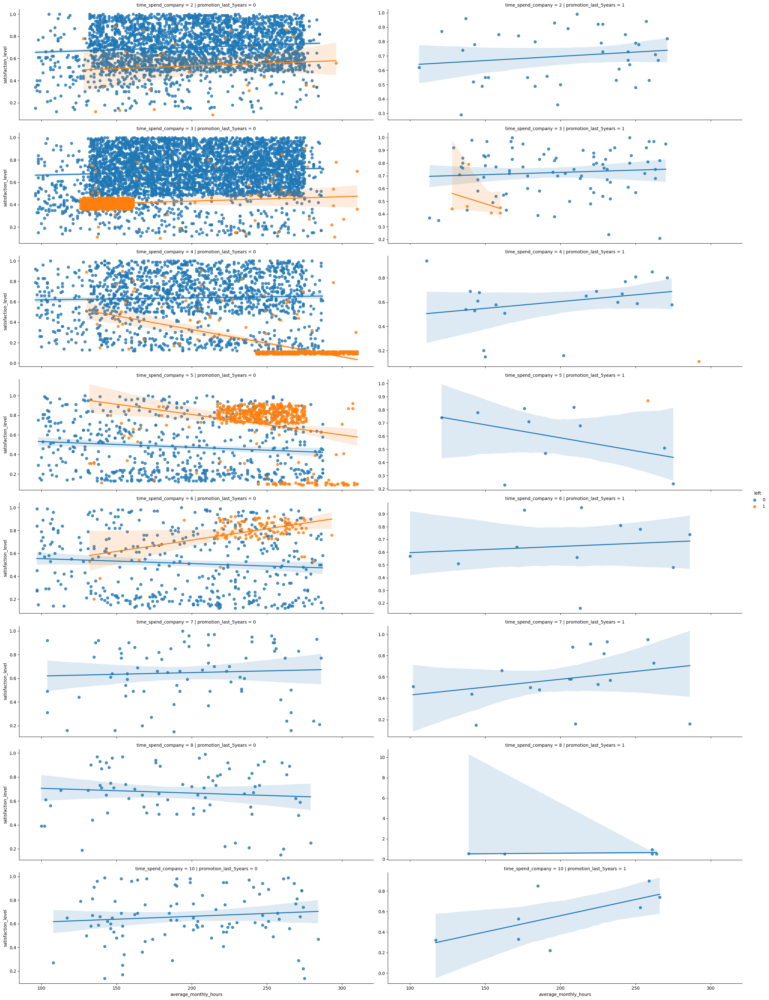

In [257]:
#############################################
# satisfaction_level vs average_monthly_hours
# by left
# keep time_spend_company and promotion_last_5years constant
#############################################
sns.lmplot(data=df_drop, x="average_monthly_hours", y="satisfaction_level",
           row='time_spend_company',col='promotion_last_5years',
           hue='left',height=4,aspect=3,
           facet_kws=dict(sharey=False))
plt.show()

#=>we can observe left bottom pattern in time_spend_company=3 and promotion_last_5years=0 or 1(maybe)
#=>we can observe right top pattern in time_spend_company=5,6 and promotion_last_5years=0
#=>we can observe right bottom pattern in time_spend_company=4,5 and promotion_last_5years=0


##### satisfaction_level vs emp_type

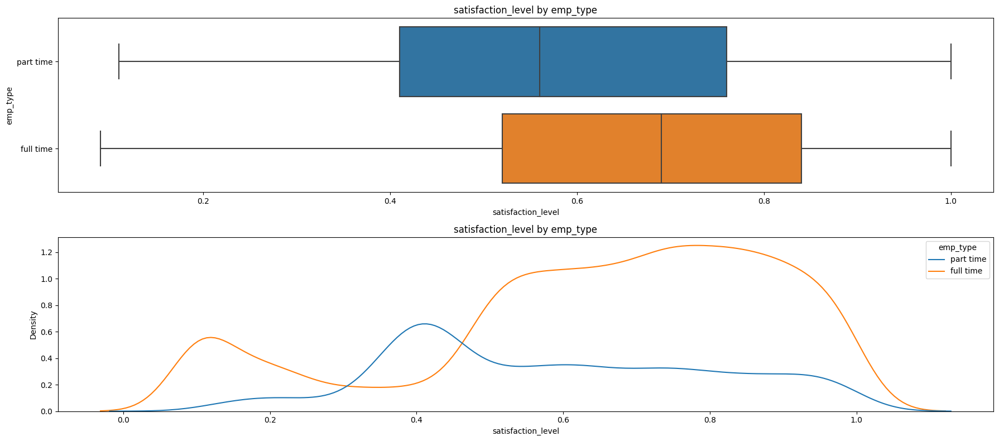

,emp_type,min,max,std,mean,median,count
0,full time,0.09,1.0,0.247703,0.646201,0.69,8696
1,part time,0.11,1.0,0.216670,0.586000,0.56,3295


In [258]:
#############################################
#satisfaction_level and salary
#############################################
fig, axs = plt.subplots(2,1,figsize=(18,8))

sns.boxplot(data=df_drop,y=df_drop['emp_type'].astype(str),x='satisfaction_level',ax=axs[0])
axs[0].set_title('satisfaction_level by emp_type')

sns.kdeplot(data=df_drop,hue='emp_type',x='satisfaction_level',palette='tab10',ax=axs[1])
axs[1].set_title('satisfaction_level by emp_type')

plt.tight_layout()
plt.show()

display(df_drop.groupby(['emp_type'])['satisfaction_level'].agg(['min','max','std','mean','median','count']).reset_index())

In [259]:
# Levene test for equal variances.
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.levene.html
#H0:All input samples are from populations with equal variances
#HA:At least one input sample are from populations with different variance
significance_level=0.01
print('Levene test result of satisfaction_level')
statistic, p_value = levene(*[df_drop['satisfaction_level'][df_drop['emp_type'] == item]
                                    for item in df_drop['emp_type'].unique()])
show_test_result(statistic, p_value,significance_level)

Levene test result of satisfaction_level
Reject H0 at significance level 0.01 (Pvalue=0.001, Statistic=10.72)


In [260]:
# Kruskal-Wallis test
#H0:The population median of all of the groups are equal
#HA:At least one group has different median
#set significance_level 0.01
significance_level=0.01

print('Kruskal-Wallis testresult of satisfaction_level')
statistic, p_value = kruskal(*[df_drop['satisfaction_level'][df_drop['emp_type'] == item]
                                    for item in df_drop['emp_type'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis testresult of satisfaction_level
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=269.42)


In [261]:
# Kolmogorov-Smirnov
# https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.ks_2samp.html
#H0:The distributions of satisfaction_level for emp_type are identical.
#HA:The distributions of satisfaction_level for emp_type are different.
#set significance_level 0.01
significance_level=0.01

print('Kolmogorov-Smirnov test result of satisfaction_level')

results = {}
for i, item1 in enumerate(sorted(df_drop['emp_type'].unique())):
    for j, item2 in enumerate(sorted(df_drop['emp_type'].unique())):
        if i < j:
            ks_stat, ks_p = ks_2samp(df_drop[df_drop['emp_type'] == item1]['satisfaction_level'], 
                                     df_drop[df_drop['emp_type'] == item2]['satisfaction_level'])
            if ks_p<=significance_level:
                ks_result='Reject H0'
            else:
                ks_result='Fail reject'
            results[f"{item1} vs {item2}"] = (ks_stat, ks_p,ks_result)

# Convert the results into a DataFrame
ks_df = pd.DataFrame(results).transpose()
ks_df.columns = ['KS_Statistic', 'Pvalue','Result']
ks_df.reset_index(inplace=True)
ks_df.rename(columns={'index': 'emp_type'}, inplace=True)

ks_df

Kolmogorov-Smirnov test result of satisfaction_level


,emp_type,KS_Statistic,Pvalue,Result
0,full time vs part time,0.220828,0.0,Reject H0


In [262]:
# Mann-Whitney U rank test
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.mannwhitneyu.html
#H0:The population median of full time employee less equal than part time employee
#HA:The population median of full time employee greater than part time employee
significance_level=0.01
print('Mann-Whitney test result of satisfaction_level')
statistic, p_value = mannwhitneyu(df_drop[df_drop['emp_type']=='full time']['satisfaction_level'], 
                                  df_drop[df_drop['emp_type']=='part time']['satisfaction_level'],
                                  alternative="greater")
show_test_result(statistic, p_value,significance_level)

Mann-Whitney test result of satisfaction_level
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=17103905.0)


#### last_evaluation
#####  last_evaluation vs number_project

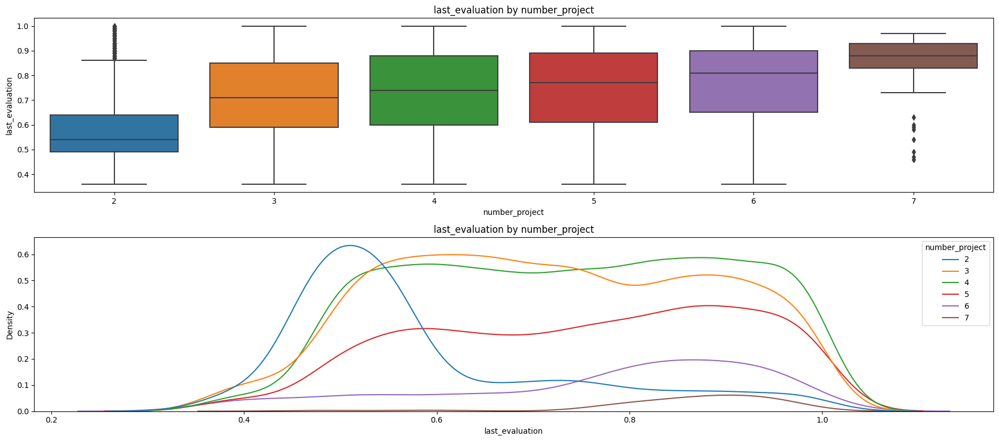

,number_project,min,max,std,mean,median,count
0,2,0.36,1.00,0.145815,0.584640,0.54,1582
1,3,0.36,1.00,0.159446,0.717415,0.71,3520
2,4,0.36,1.00,0.161471,0.735682,0.74,3685
3,5,0.36,1.00,0.162764,0.750072,0.77,2233
4,6,0.36,1.00,0.169316,0.765654,0.81,826
5,7,0.46,0.97,0.097322,0.863517,0.88,145


In [263]:
#############################################
#last_evaluation and number_project
#############################################
fig, axs = plt.subplots(2,1,figsize=(18,8))

sns.boxplot(data=df_drop,x='number_project',y='last_evaluation',ax=axs[0])
axs[0].set_title('last_evaluation by number_project')

sns.kdeplot(data=df_drop,hue='number_project',x='last_evaluation',palette='tab10',ax=axs[1])
axs[1].set_title('last_evaluation by number_project')

plt.tight_layout()
plt.show()

display(df_drop.groupby(['number_project'])['last_evaluation'].agg(['min','max','std','mean','median','count']).reset_index())

In [264]:
# Levene test for equal variances.
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.levene.html
#H0:All input samples are from populations with equal variances
#HA:At least one input sample are from populations with different variance
significance_level=0.01
print('Levene test result of last_evaluation')
statistic, p_value = levene(*[df_drop['last_evaluation'][df_drop['number_project'] == item]
                                    for item in df_drop['number_project'].unique()])
show_test_result(statistic, p_value,significance_level)

Levene test result of last_evaluation
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=60.11)


In [265]:
# Kruskal-Wallis test
#H0:The population median of all of the groups are equal
#HA:At least one group has different median
#set significance_level 0.01
significance_level=0.01

print('Kruskal-Wallis testresult of last_evaluation')
statistic, p_value = kruskal(*[df_drop['last_evaluation'][df_drop['number_project'] == item]
                                    for item in df_drop['number_project'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis testresult of last_evaluation
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=1328.11)


In [266]:
# Kolmogorov-Smirnov
# https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.ks_2samp.html
#H0:The distributions of satisfaction_level for department are identical.
#HA:The distributions of satisfaction_level for department are different.
#set significance_level 0.01
significance_level=0.01

print('Kolmogorov-Smirnov test result of last_evaluation')

results = {}
for i, item1 in enumerate(sorted(df_drop['number_project'].unique())):
    for j, item2 in enumerate(sorted(df_drop['number_project'].unique())):
        if i < j:
            ks_stat, ks_p = ks_2samp(df_drop[df_drop['number_project'] == item1]['last_evaluation'], 
                                     df_drop[df_drop['number_project'] == item2]['last_evaluation'])
            if ks_p<=significance_level:
                ks_result='Reject H0'
            else:
                ks_result='Fail reject'
            results[f"{item1} vs {item2}"] = (ks_stat, ks_p,ks_result)

# Convert the results into a DataFrame
ks_df = pd.DataFrame(results).transpose()
ks_df.columns = ['KS_Statistic', 'Pvalue','Result']
ks_df.reset_index(inplace=True)
ks_df.rename(columns={'index': 'number_project'}, inplace=True)

ks_df

Kolmogorov-Smirnov test result of last_evaluation


,number_project,KS_Statistic,Pvalue,Result
0,2 vs 3,0.466246,0.0,Reject H0
1,2 vs 4,0.485831,0.0,Reject H0
2,2 vs 5,0.505681,0.0,Reject H0
3,2 vs 6,0.523902,0.0,Reject H0
4,2 vs 7,0.795074,0.0,Reject H0
5,3 vs 4,0.060448,0.000004,Reject H0
6,3 vs 5,0.106706,0.0,Reject H0
7,3 vs 6,0.22697,0.0,Reject H0
8,3 vs 7,0.540204,0.0,Reject H0
9,4 vs 5,0.052873,0.000802,Reject H0


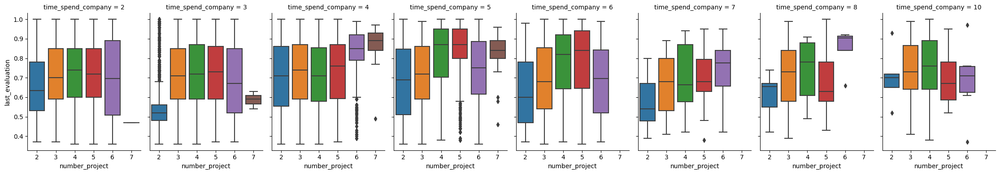

In [267]:
#############################################
#last_evaluation by number_project
#keep time_spend_company constant
#############################################
sns.catplot(
    data=df_drop, x='number_project',y="last_evaluation",  col="time_spend_company",
    kind="box", height=4, aspect=.7,col_wrap=8
)
plt.show()

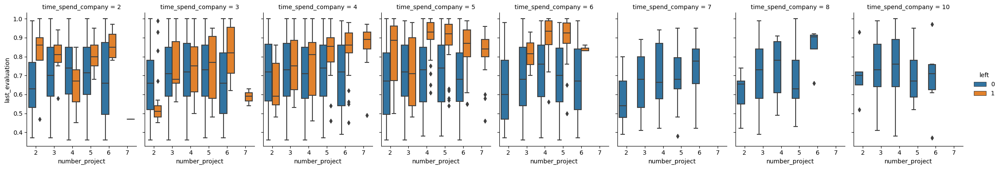

In [268]:
#############################################
#last_evaluation by number_project
#keep time_spend_company constant
#############################################
sns.catplot(
    data=df_drop, x='number_project',y="last_evaluation", hue="left", col="time_spend_company",
    kind="box", height=4, aspect=.7,col_wrap=8
)
plt.show()

#####  last_evaluation vs time_spend_company

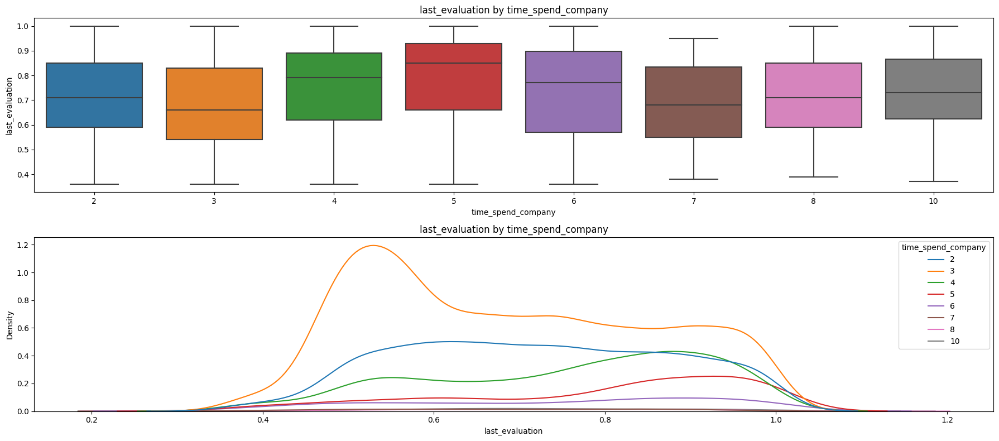

,time_spend_company,min,max,std,mean,median,count
0,2,0.36,1.00,0.156373,0.717986,0.71,2910
1,3,0.36,1.00,0.166038,0.684333,0.66,5190
2,4,0.36,1.00,0.162504,0.754354,0.79,2005
3,5,0.36,1.00,0.174338,0.791864,0.85,1062
4,6,0.36,1.00,0.185456,0.736439,0.77,542
5,7,0.38,0.95,0.161501,0.682766,0.68,94
6,8,0.39,1.00,0.163121,0.711975,0.71,81
7,10,0.37,1.00,0.157892,0.731495,0.73,107


In [269]:
#############################################
#last_evaluation and time_spend_company
#############################################
fig, axs = plt.subplots(2,1,figsize=(18,8))

sns.boxplot(data=df_drop,x='time_spend_company',y='last_evaluation',ax=axs[0])
axs[0].set_title('last_evaluation by time_spend_company')

sns.kdeplot(data=df_drop,hue='time_spend_company',x='last_evaluation',palette='tab10',ax=axs[1])
axs[1].set_title('last_evaluation by time_spend_company')

plt.tight_layout()
plt.show()

display(df_drop.groupby(['time_spend_company'])['last_evaluation'].agg(['min','max','std','mean','median','count']).reset_index())

In [270]:
# Levene test for equal variances.
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.levene.html
#H0:All input samples are from populations with equal variances
#HA:At least one input sample are from populations with different variance
significance_level=0.01
print('Levene test result of last_evaluation')
statistic, p_value = levene(*[df_drop['last_evaluation'][df_drop['time_spend_company'] == item]
                                    for item in df_drop['time_spend_company'].unique()])
show_test_result(statistic, p_value,significance_level)

Levene test result of last_evaluation
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=7.95)


In [271]:
# Kruskal-Wallis test
#H0:The population median of all of the groups are equal
#HA:At least one group has different median
#set significance_level 0.01
significance_level=0.01

print('Kruskal-Wallis testresult of last_evaluation')
statistic, p_value = kruskal(*[df_drop['last_evaluation'][df_drop['time_spend_company'] == item]
                                    for item in df_drop['time_spend_company'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis testresult of last_evaluation
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=535.74)


In [272]:
# Kolmogorov-Smirnov
# https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.ks_2samp.html
#H0:The distributions of satisfaction_level for time_spend_company are identical.
#HA:The distributions of satisfaction_level for time_spend_company are different.
#set significance_level 0.01
significance_level=0.01

print('Kolmogorov-Smirnov test result of last_evaluation')

results = {}
for i, item1 in enumerate(sorted(df_drop['time_spend_company'].unique())):
    for j, item2 in enumerate(sorted(df_drop['time_spend_company'].unique())):
        if i < j:
            ks_stat, ks_p = ks_2samp(df_drop[df_drop['time_spend_company'] == item1]['last_evaluation'], 
                                     df_drop[df_drop['time_spend_company'] == item2]['last_evaluation'])
            if ks_p<=significance_level:
                ks_result='Reject H0'
            else:
                ks_result='Fail reject'
            results[f"{item1} vs {item2}"] = (ks_stat, ks_p,ks_result)

# Convert the results into a DataFrame
ks_df = pd.DataFrame(results).transpose()
ks_df.columns = ['KS_Statistic', 'Pvalue','Result']
ks_df.reset_index(inplace=True)
ks_df.rename(columns={'index': 'time_spend_company'}, inplace=True)

ks_df

Kolmogorov-Smirnov test result of last_evaluation


,time_spend_company,KS_Statistic,Pvalue,Result
0,2 vs 3,0.138142,0.0,Reject H0
1,2 vs 4,0.152187,0.0,Reject H0
2,2 vs 5,0.269742,0.0,Reject H0
3,2 vs 6,0.12705,0.000001,Reject H0
4,2 vs 7,0.112466,0.184685,Fail reject
5,2 vs 8,0.055836,0.95474,Fail reject
6,2 vs 10,0.089244,0.361457,Fail reject
7,3 vs 4,0.217836,0.0,Reject H0
8,3 vs 5,0.319974,0.0,Reject H0
9,3 vs 6,0.177083,0.0,Reject H0


#####  last_evaluation vs work_accident

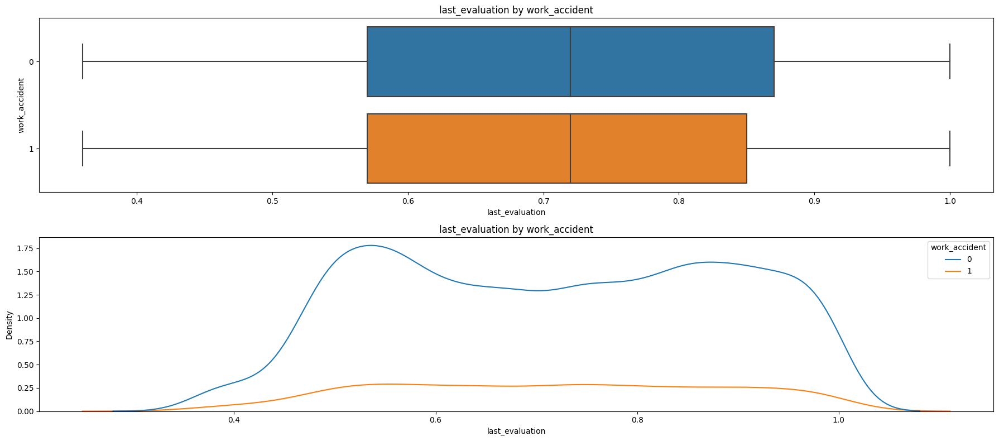

,work_accident,min,max,std,mean,median,count
0,0,0.36,1.0,0.16882,0.717092,0.72,10141
1,1,0.36,1.0,0.16573,0.714438,0.72,1850


In [273]:
#############################################
#last_evaluation and work_accident
#############################################
fig, axs = plt.subplots(2,1,figsize=(18,8))

sns.boxplot(data=df_drop,y=df_drop['work_accident'].astype(str),x='last_evaluation',ax=axs[0])
axs[0].set_title('last_evaluation by work_accident')

sns.kdeplot(data=df_drop,hue='work_accident',x='last_evaluation',palette='tab10',ax=axs[1])
axs[1].set_title('last_evaluation by work_accident')

plt.tight_layout()
plt.show()

display(df_drop.groupby(['work_accident'])['last_evaluation'].agg(['min','max','std','mean','median','count']).reset_index())

In [274]:
# Levene test for equal variances.
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.levene.html
#H0:All input samples are from populations with equal variances
#HA:At least one input sample are from populations with different variance
significance_level=0.01
print('Levene test result of last_evaluation')
statistic, p_value = levene(*[df_drop['last_evaluation'][df_drop['work_accident'] == item]
                                    for item in df_drop['work_accident'].unique()])
show_test_result(statistic, p_value,significance_level)

Levene test result of last_evaluation
Fail to reject H0 at significance level 0.01 (Pvalue=0.011, Statistic=6.54)


In [275]:
# Kruskal-Wallis test
#H0:The population median of all of the groups are equal
#HA:At least one group has different median
#set significance_level 0.01
significance_level=0.01

print('Kruskal-Wallis testresult of last_evaluation')
statistic, p_value = kruskal(*[df_drop['last_evaluation'][df_drop['work_accident'] == item]
                                    for item in df_drop['work_accident'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis testresult of last_evaluation
Fail to reject H0 at significance level 0.01 (Pvalue=0.6, Statistic=0.28)


In [276]:
# Kolmogorov-Smirnov
# https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.ks_2samp.html
#H0:The distributions of satisfaction_level for time_spend_company are identical.
#HA:The distributions of satisfaction_level for time_spend_company are different.
#set significance_level 0.01
significance_level=0.01

print('Kolmogorov-Smirnov test result of last_evaluation')

results = {}
for i, item1 in enumerate(sorted(df_drop['work_accident'].unique())):
    for j, item2 in enumerate(sorted(df_drop['work_accident'].unique())):
        if i < j:
            ks_stat, ks_p = ks_2samp(df_drop[df_drop['work_accident'] == item1]['last_evaluation'], 
                                     df_drop[df_drop['work_accident'] == item2]['last_evaluation'])
            if ks_p<=significance_level:
                ks_result='Reject H0'
            else:
                ks_result='Fail reject'
            results[f"{item1} vs {item2}"] = (ks_stat, ks_p,ks_result)

# Convert the results into a DataFrame
ks_df = pd.DataFrame(results).transpose()
ks_df.columns = ['KS_Statistic', 'Pvalue','Result']
ks_df.reset_index(inplace=True)
ks_df.rename(columns={'index': 'work_accident'}, inplace=True)

ks_df

Kolmogorov-Smirnov test result of last_evaluation


,work_accident,KS_Statistic,Pvalue,Result
0,0 vs 1,0.029155,0.137062,Fail reject


#####  last_evaluation vs promotion_last_5years

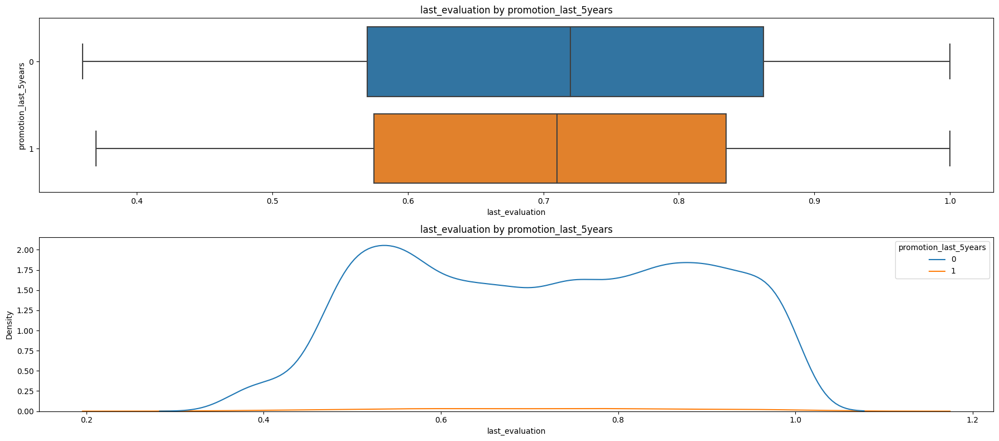

,promotion_last_5years,min,max,std,mean,median,count
0,0,0.36,1.0,0.168346,0.716842,0.72,11788
1,1,0.37,1.0,0.168318,0.707438,0.71,203


In [277]:
#############################################
#last_evaluation and promotion_last_5years
#############################################
fig, axs = plt.subplots(2,1,figsize=(18,8))

sns.boxplot(data=df_drop,y=df_drop['promotion_last_5years'].astype(str),x='last_evaluation',ax=axs[0])
axs[0].set_title('last_evaluation by promotion_last_5years')

sns.kdeplot(data=df_drop,hue='promotion_last_5years',x='last_evaluation',palette='tab10',ax=axs[1])
axs[1].set_title('last_evaluation by promotion_last_5years')

plt.tight_layout()
plt.show()

display(df_drop.groupby(['promotion_last_5years'])['last_evaluation'].agg(['min','max','std','mean','median','count']).reset_index())

In [278]:
# Levene test for equal variances.
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.levene.html
#H0:All input samples are from populations with equal variances
#HA:At least one input sample are from populations with different variance
significance_level=0.01
print('Levene test result of last_evaluation')
statistic, p_value = levene(*[df_drop['last_evaluation'][df_drop['promotion_last_5years'] == item]
                                    for item in df_drop['promotion_last_5years'].unique()])
show_test_result(statistic, p_value,significance_level)

Levene test result of last_evaluation
Fail to reject H0 at significance level 0.01 (Pvalue=0.454, Statistic=0.56)


In [279]:
# Kruskal-Wallis test
#H0:The population median of all of the groups are equal
#HA:At least one group has different median
#set significance_level 0.01
significance_level=0.01

print('Kruskal-Wallis testresult of last_evaluation')
statistic, p_value = kruskal(*[df_drop['last_evaluation'][df_drop['promotion_last_5years'] == item]
                                    for item in df_drop['promotion_last_5years'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis testresult of last_evaluation
Fail to reject H0 at significance level 0.01 (Pvalue=0.51, Statistic=0.43)


In [280]:
# Kolmogorov-Smirnov
# https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.ks_2samp.html
#H0:The distributions of satisfaction_level for promotion_last_5years are identical.
#HA:The distributions of satisfaction_level for promotion_last_5years are different.
#set significance_level 0.01
significance_level=0.01

print('Kolmogorov-Smirnov test result of last_evaluation')

results = {}
for i, item1 in enumerate(sorted(df_drop['promotion_last_5years'].unique())):
    for j, item2 in enumerate(sorted(df_drop['promotion_last_5years'].unique())):
        if i < j:
            ks_stat, ks_p = ks_2samp(df_drop[df_drop['promotion_last_5years'] == item1]['last_evaluation'], 
                                     df_drop[df_drop['promotion_last_5years'] == item2]['last_evaluation'])
            if ks_p<=significance_level:
                ks_result='Reject H0'
            else:
                ks_result='Fail reject'
            results[f"{item1} vs {item2}"] = (ks_stat, ks_p,ks_result)

# Convert the results into a DataFrame
ks_df = pd.DataFrame(results).transpose()
ks_df.columns = ['KS_Statistic', 'Pvalue','Result']
ks_df.reset_index(inplace=True)
ks_df.rename(columns={'index': 'promotion_last_5years'}, inplace=True)

ks_df

Kolmogorov-Smirnov test result of last_evaluation


,promotion_last_5years,KS_Statistic,Pvalue,Result
0,0 vs 1,0.067263,0.311911,Fail reject


#####  last_evaluation vs department

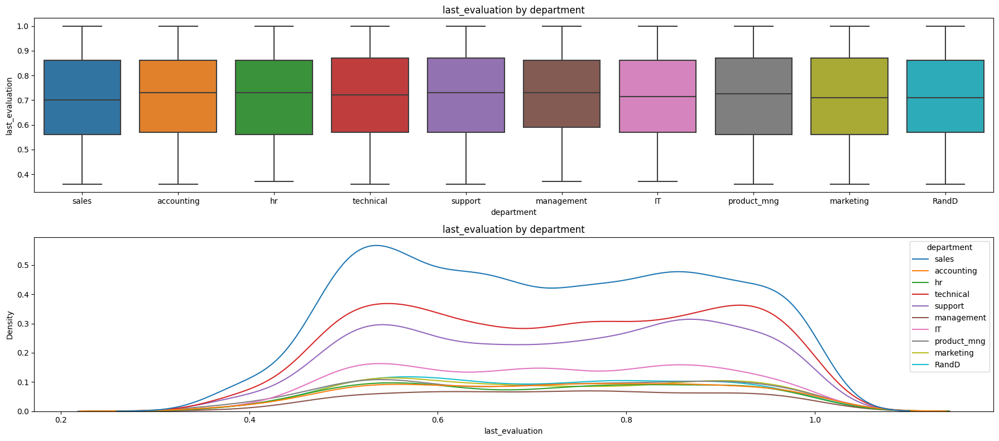

,department,min,max,std,mean,median,count
0,IT,0.37,1.0,0.162254,0.715051,0.715,976
1,RandD,0.36,1.0,0.164317,0.712983,0.710,694
2,accounting,0.36,1.0,0.168196,0.721900,0.730,621
3,hr,0.37,1.0,0.169209,0.715691,0.730,601
4,management,0.37,1.0,0.160934,0.726307,0.730,436
5,marketing,0.36,1.0,0.170008,0.718440,0.710,673
6,product_mng,0.36,1.0,0.174482,0.713790,0.725,686
7,sales,0.36,1.0,0.168546,0.710398,0.700,3239
8,support,0.36,1.0,0.168654,0.722998,0.730,1821
9,technical,0.36,1.0,0.170355,0.719791,0.720,2244


In [281]:
#############################################
#last_evaluation and department
#############################################
fig, axs = plt.subplots(2,1,figsize=(18,8))

sns.boxplot(data=df_drop,x='department',y='last_evaluation',ax=axs[0])
axs[0].set_title('last_evaluation by department')

sns.kdeplot(data=df_drop,hue='department',x='last_evaluation',palette='tab10',ax=axs[1])
axs[1].set_title('last_evaluation by department')

plt.tight_layout()
plt.show()

display(df_drop.groupby(['department'])['last_evaluation'].agg(['min','max','std','mean','median','count']).reset_index())

In [282]:
# Levene test for equal variances.
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.levene.html
#H0:All input samples are from populations with equal variances
#HA:At least one input sample are from populations with different variance
significance_level=0.01
print('Levene test result of last_evaluation')
statistic, p_value = levene(*[df_drop['last_evaluation'][df_drop['department'] == item]
                                    for item in df_drop['department'].unique()])
show_test_result(statistic, p_value,significance_level)

Levene test result of last_evaluation
Fail to reject H0 at significance level 0.01 (Pvalue=0.047, Statistic=1.9)


In [283]:
# Kruskal-Wallis test
#H0:The population median of all of the groups are equal
#HA:At least one group has different median
#set significance_level 0.01
significance_level=0.01

print('Kruskal-Wallis testresult of last_evaluation')
statistic, p_value = kruskal(*[df_drop['last_evaluation'][df_drop['department'] == item]
                                    for item in df_drop['department'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis testresult of last_evaluation
Fail to reject H0 at significance level 0.01 (Pvalue=0.306, Statistic=10.58)


In [284]:
# Kolmogorov-Smirnov
# https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.ks_2samp.html
#H0:The distributions of satisfaction_level for department are identical.
#HA:The distributions of satisfaction_level for department are different.
#set significance_level 0.01
significance_level=0.01

print('Kolmogorov-Smirnov test result of last_evaluation')

results = {}
for i, item1 in enumerate(sorted(df_drop['department'].unique())):
    for j, item2 in enumerate(sorted(df_drop['department'].unique())):
        if i < j:
            ks_stat, ks_p = ks_2samp(df_drop[df_drop['department'] == item1]['last_evaluation'], 
                                     df_drop[df_drop['department'] == item2]['last_evaluation'])
            if ks_p<=significance_level:
                ks_result='Reject H0'
            else:
                ks_result='Fail reject'
            results[f"{item1} vs {item2}"] = (ks_stat, ks_p,ks_result)

# Convert the results into a DataFrame
ks_df = pd.DataFrame(results).transpose()
ks_df.columns = ['KS_Statistic', 'Pvalue','Result']
ks_df.reset_index(inplace=True)
ks_df.rename(columns={'index': 'department'}, inplace=True)

ks_df

Kolmogorov-Smirnov test result of last_evaluation


,department,KS_Statistic,Pvalue,Result
0,IT vs RandD,0.02961,0.855217,Fail reject
1,IT vs accounting,0.036372,0.678965,Fail reject
2,IT vs hr,0.029086,0.899451,Fail reject
3,IT vs management,0.053335,0.342907,Fail reject
4,IT vs marketing,0.040253,0.521618,Fail reject
5,IT vs product_mng,0.036551,0.637112,Fail reject
6,IT vs sales,0.034152,0.336759,Fail reject
7,IT vs support,0.044177,0.1612,Fail reject
8,IT vs technical,0.044636,0.128169,Fail reject
9,RandD vs accounting,0.039014,0.68064,Fail reject


#####  last_evaluation vs salary

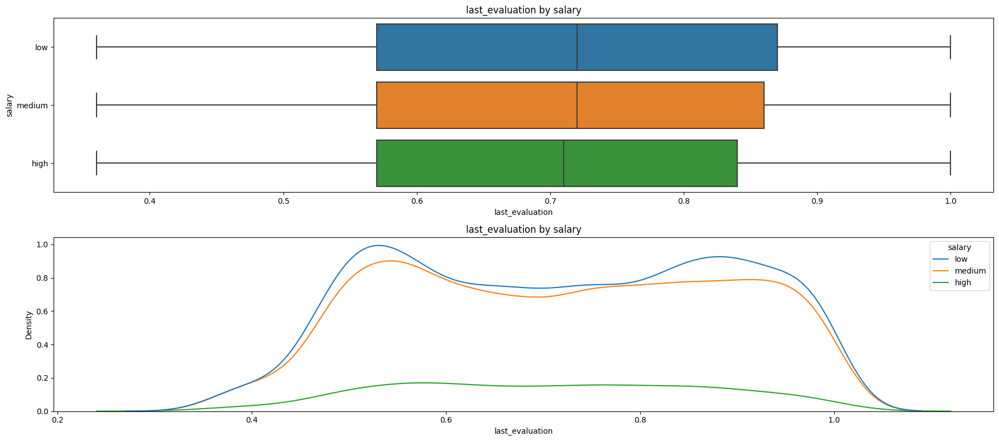

,salary,min,max,std,mean,median,count
0,low,0.36,1.0,0.169913,0.718512,0.72,5740
1,medium,0.36,1.0,0.168320,0.716539,0.72,5261
2,high,0.36,1.0,0.158864,0.706838,0.71,990


In [285]:
#############################################
#last_evaluation and salary
#############################################
fig, axs = plt.subplots(2,1,figsize=(18,8))

sns.boxplot(data=df_drop,y=df_drop['salary'].astype(str),x='last_evaluation',ax=axs[0])
axs[0].set_title('last_evaluation by salary')

sns.kdeplot(data=df_drop,hue='salary',x='last_evaluation',palette='tab10',ax=axs[1])
axs[1].set_title('last_evaluation by salary')

plt.tight_layout()
plt.show()

display(df_drop.groupby(['salary'])['last_evaluation'].agg(['min','max','std','mean','median','count']).reset_index())

In [286]:
# Levene test for equal variances.
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.levene.html
#H0:All input samples are from populations with equal variances
#HA:At least one input sample are from populations with different variance
significance_level=0.01
print('Levene test result of last_evaluation')
statistic, p_value = levene(*[df_drop['last_evaluation'][df_drop['salary'] == item]
                                    for item in df_drop['salary'].unique()])
show_test_result(statistic, p_value,significance_level)

Levene test result of last_evaluation
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=9.84)


In [287]:
# Kruskal-Wallis test
#H0:The population median of all of the groups are equal
#HA:At least one group has different median
#set significance_level 0.01
significance_level=0.01

print('Kruskal-Wallis testresult of last_evaluation')
statistic, p_value = kruskal(*[df_drop['last_evaluation'][df_drop['salary'] == item]
                                    for item in df_drop['salary'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis testresult of last_evaluation
Fail to reject H0 at significance level 0.01 (Pvalue=0.154, Statistic=3.75)


In [288]:
# Kolmogorov-Smirnov
# https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.ks_2samp.html
#H0:The distributions of satisfaction_level for department are identical.
#HA:The distributions of satisfaction_level for department are different.
#set significance_level 0.01
significance_level=0.01

print('Kolmogorov-Smirnov test result of last_evaluation')

results = {}
for i, item1 in enumerate(sorted(df_drop['salary'].unique())):
    for j, item2 in enumerate(sorted(df_drop['salary'].unique())):
        if i < j:
            ks_stat, ks_p = ks_2samp(df_drop[df_drop['salary'] == item1]['last_evaluation'], 
                                     df_drop[df_drop['salary'] == item2]['last_evaluation'])
            if ks_p<=significance_level:
                ks_result='Reject H0'
            else:
                ks_result='Fail reject'
            results[f"{item1} vs {item2}"] = (ks_stat, ks_p,ks_result)

# Convert the results into a DataFrame
ks_df = pd.DataFrame(results).transpose()
ks_df.columns = ['KS_Statistic', 'Pvalue','Result']
ks_df.reset_index(inplace=True)
ks_df.rename(columns={'index': 'salary'}, inplace=True)

ks_df

Kolmogorov-Smirnov test result of last_evaluation


,salary,KS_Statistic,Pvalue,Result
0,high vs low,0.060201,0.004189,Reject H0
1,high vs medium,0.051266,0.024072,Fail reject
2,low vs medium,0.017712,0.349763,Fail reject


#####  last_evaluation vs average_monthly_hours

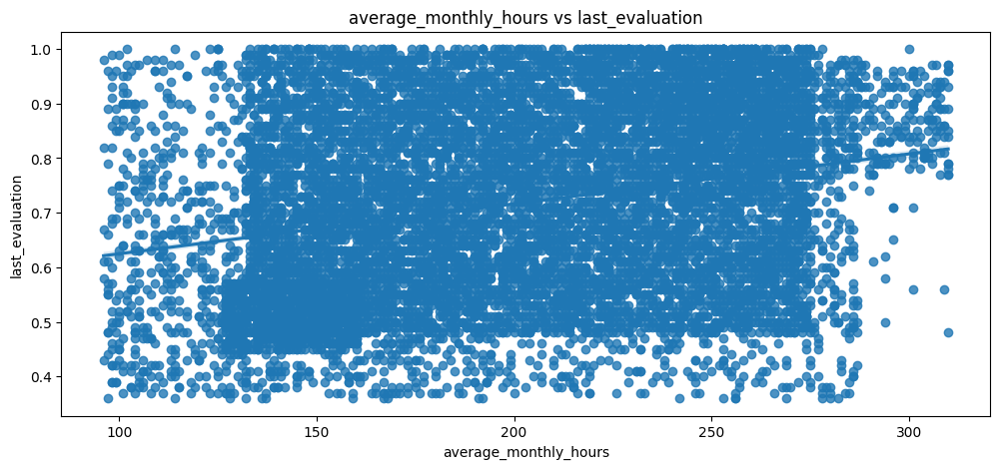

In [289]:
#############################################
# last_evaluation vs average_monthly_hours
#############################################
plt.figure(figsize=(12,5))
sns.regplot(data=df_drop, x="average_monthly_hours", y="last_evaluation")
plt.title('average_monthly_hours vs last_evaluation')
plt.show()

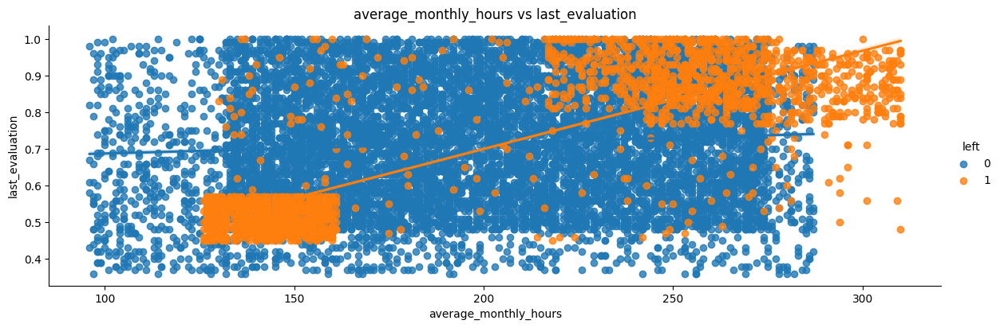

In [290]:
#############################################
# last_evaluation vs average_monthly_hours
#############################################
sns.lmplot(data=df_drop, x="average_monthly_hours", y="last_evaluation",hue='left',
           height=4,aspect=3)
plt.title('average_monthly_hours vs last_evaluation')
plt.show()

#=>There are 3 groups(confirmed in tableau)
#Group1: low-middle average_monthly_hours, low-middle last_evaluation
#126<= average_monthly_hours <=161
#0.36<=satisfaction_level<=0.46
#0.45<=last_evaluation<=0.57
#number_project=2
#time_spend_company=3

#Group2: high average_monthly_hours, high last_evaluation
#243<= average_monthly_hours <=310
#0.09<=satisfaction_level<=0.11
#0.77<=last_evaluation<=0.98
#number_project=5,6,7
#time_spend_company=4,5

#Group3: high average_monthly_hours, high last_evaluation
#217<= average_monthly_hours <=276
#0.72<=satisfaction_level<=0.92
#0.81<=last_evaluation<=1
#number_project=4,5
#time_spend_company=5,6


In [291]:
#H0: There is no correlation between the two variables in the population.
#H1: There is a significant correlation between the two variables in the population.
significance_level=0.01
statistic, p_value=stats.spearmanr(df_drop['average_monthly_hours'], df_drop['last_evaluation'])
show_test_result(statistic, p_value, significance_level)

Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=0.27)


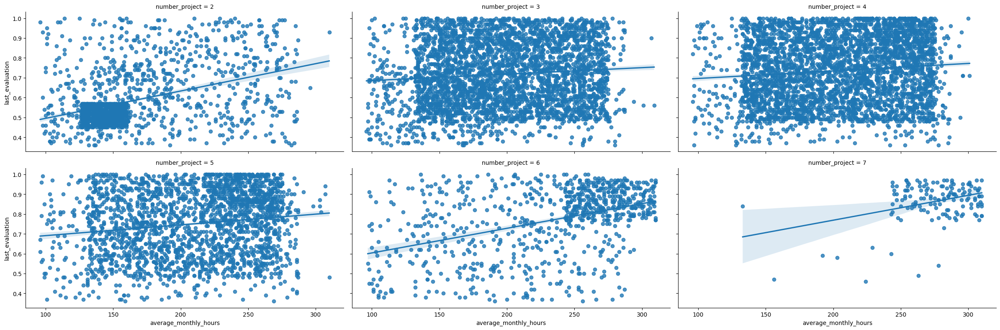

In [292]:
#############################################
# last_evaluation vs average_monthly_hours
# keep number_project constant
#############################################

sns.lmplot(data=df_drop, x="average_monthly_hours", y="last_evaluation",col='number_project',
           height=4,aspect=2,col_wrap=3)
plt.show()


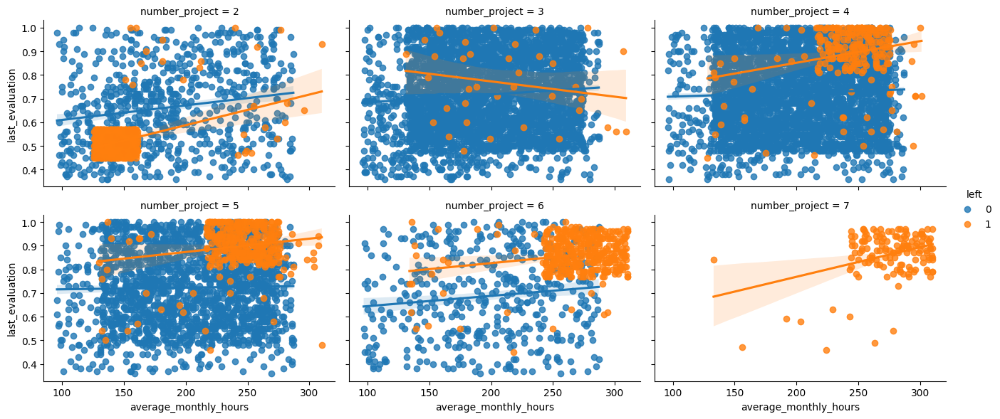

In [293]:
#############################################
# last_evaluation vs average_monthly_hours
# by left
# keep number_project constant
#############################################

sns.lmplot(data=df_drop, x="average_monthly_hours", y="last_evaluation",col='number_project',
           hue='left',height=3,aspect=1.5,col_wrap=3)
plt.show()

#we can observe some patterns(some orange rectangles)
#=>number_project>=4, many average_monthly_hours>230 and last_evaluation >=0.8 left
#=>number_project=2, many average_monthly_hours between 130-160 and last_evaluation between 0.45-0.55 left
#=>since orange rectangles didn't look random, maybe the company let them go
#(e.g. maybe the right top rectangles means cut a service/team/restructuring, left bottom means poor performance)

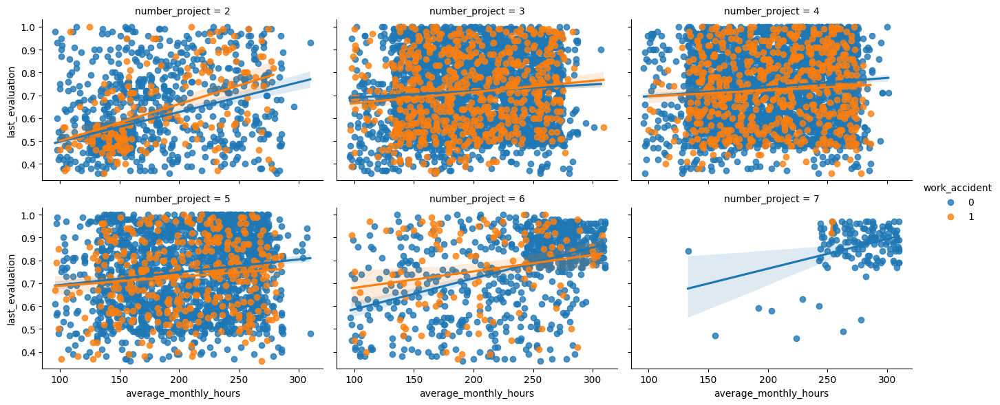

In [294]:
#############################################
# last_evaluation vs average_monthly_hours
# by work_accident
# keep number_project constant
#############################################

sns.lmplot(data=df_drop, x="average_monthly_hours", y="last_evaluation",col='number_project',
           hue='work_accident',height=3,aspect=1.5,col_wrap=3)
plt.show()

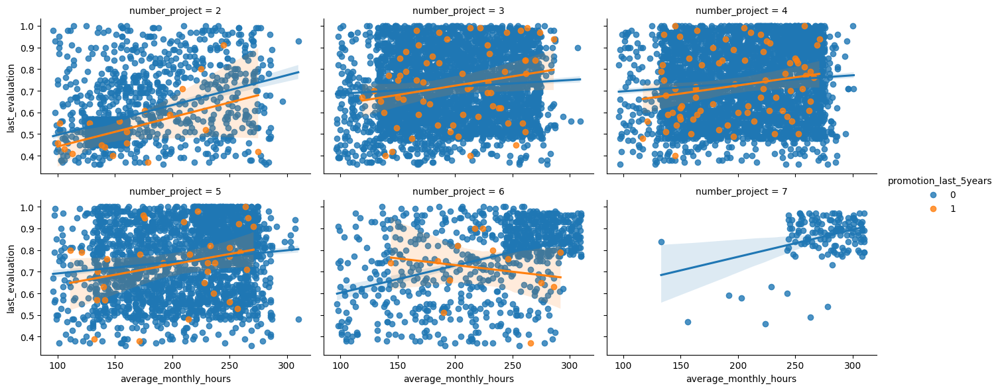

In [295]:
#############################################
# last_evaluation vs average_monthly_hours
# by promotion_last_5years
# keep number_project constant
#############################################

sns.lmplot(data=df_drop, x="average_monthly_hours", y="last_evaluation",col='number_project',
           hue='promotion_last_5years',height=3,aspect=1.5,col_wrap=3)
plt.show()

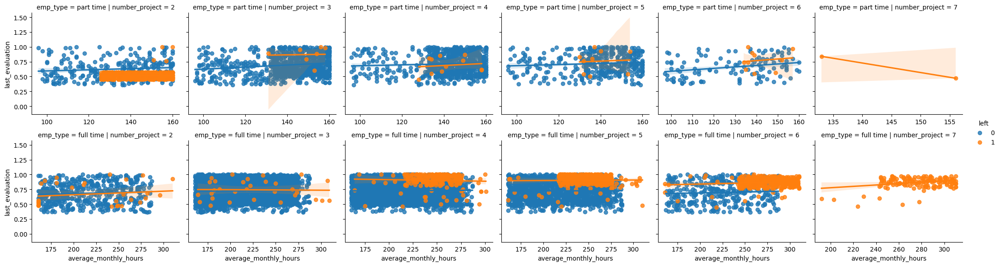

In [296]:
#############################################
# last_evaluation vs average_monthly_hours
# by left
# keep number_project and emp_type constant
#############################################

sns.lmplot(data=df_drop, x="average_monthly_hours", y="last_evaluation",col='number_project',
           hue='left',height=3,aspect=1.2,row='emp_type',
           facet_kws=dict(sharex=False))
plt.show()


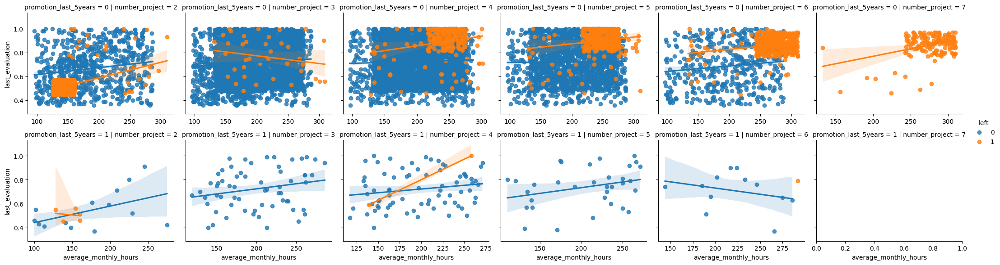

In [297]:
#############################################
# last_evaluation vs average_monthly_hours
# by left
# keep number_project and promotion_last_5years constant
#############################################

sns.lmplot(data=df_drop, x="average_monthly_hours", y="last_evaluation",col='number_project',
           hue='left',height=3,aspect=1.2,row='promotion_last_5years',
           facet_kws=dict(sharex=False))
plt.show()
#=>number_project had similar patterns

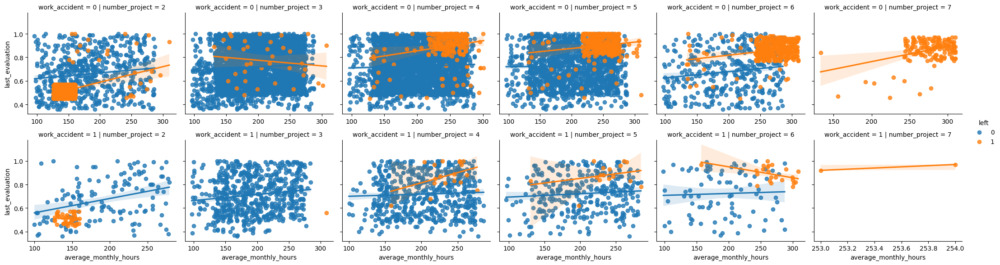

In [298]:
#############################################
# last_evaluation vs average_monthly_hours
# by left
# keep number_project and work_accident constant
#############################################

sns.lmplot(data=df_drop, x="average_monthly_hours", y="last_evaluation",col='number_project',
           hue='left',height=3,aspect=1.2,row='work_accident',
           facet_kws=dict(sharex=False))
plt.show()
#=>number_project had similar patterns

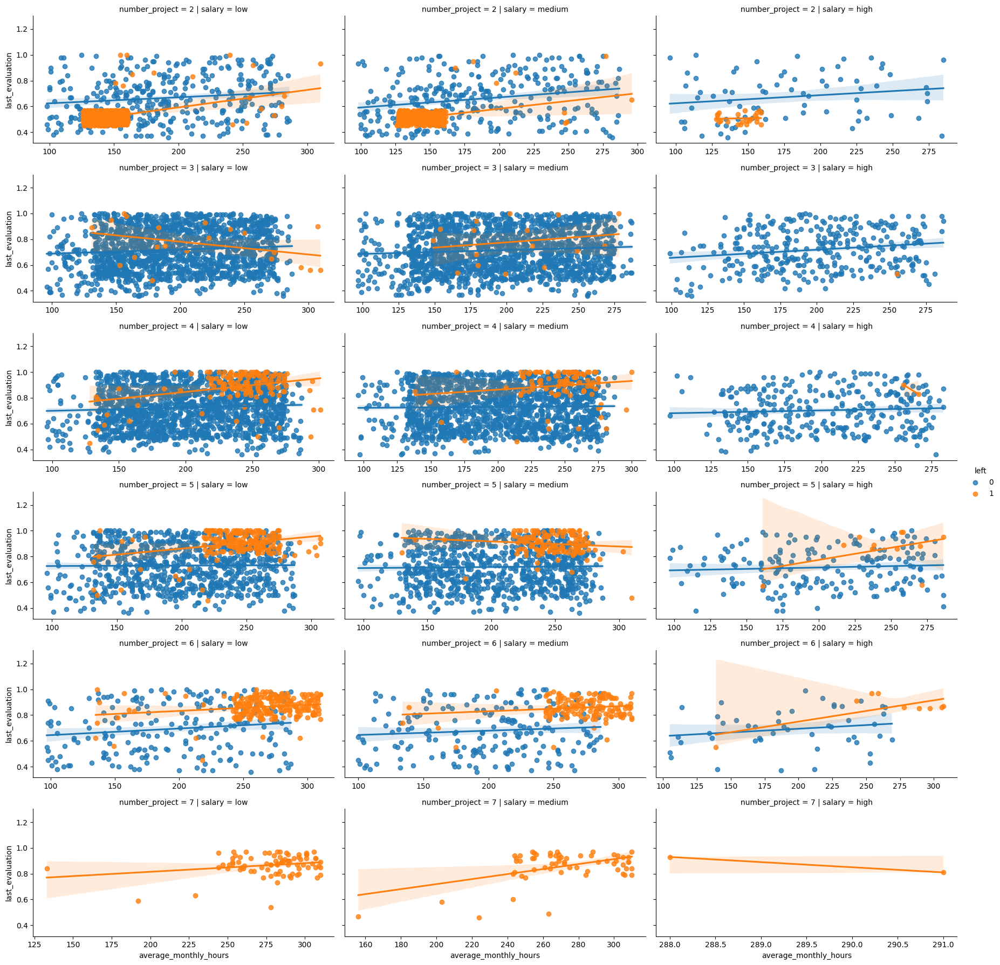

In [299]:
#############################################
# last_evaluation vs average_monthly_hours
# by left
# keep number_project and salary constant
#############################################

sns.lmplot(data=df_drop, x="average_monthly_hours", y="last_evaluation",row='number_project',
           hue='left',height=3,aspect=2,col='salary',
           facet_kws=dict(sharex=False))
plt.show()
#=>number_project=2 had pattern(left bottom) across all salary, it might be a condition
#=>number_project=4,5,6,7 had pattern(right top) for low and medium salary, it might be a condition

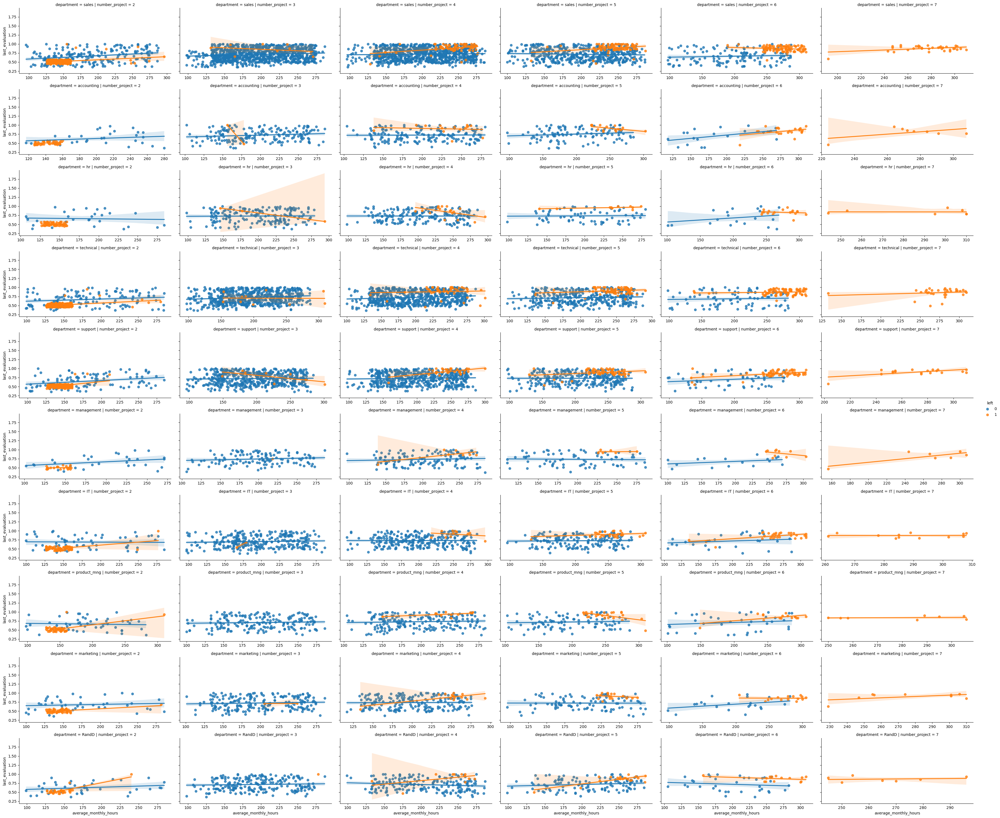

In [300]:
#############################################
# last_evaluation vs average_monthly_hours
# by left
# keep number_project and department constant
#############################################

sns.lmplot(data=df_drop, x="average_monthly_hours", y="last_evaluation",row='department',
           hue='left',height=3,aspect=2,col='number_project',
           facet_kws=dict(sharex=False))
plt.show()

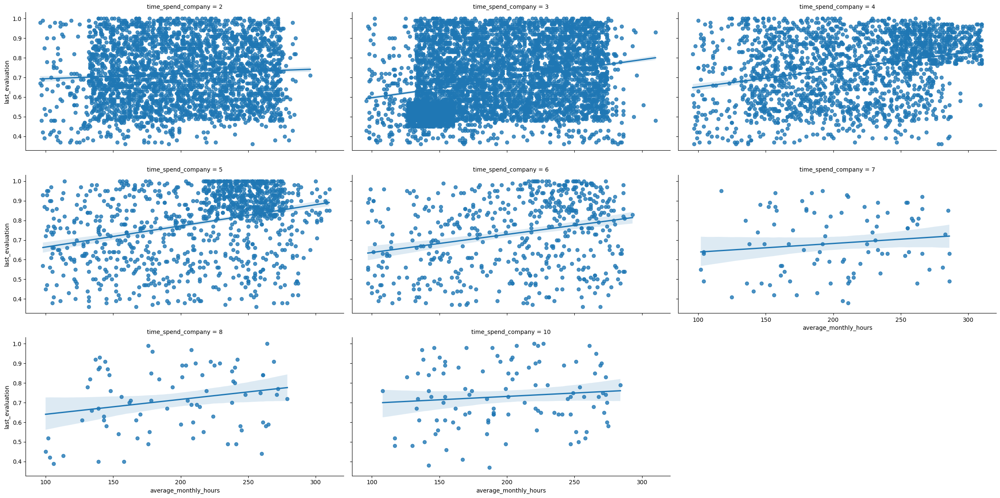

In [301]:
#############################################
# last_evaluation vs average_monthly_hours
# keep time_spend_company constant
#############################################

sns.lmplot(data=df_drop, x="average_monthly_hours", y="last_evaluation",col='time_spend_company',
           height=4,aspect=2,col_wrap=3)
plt.show()

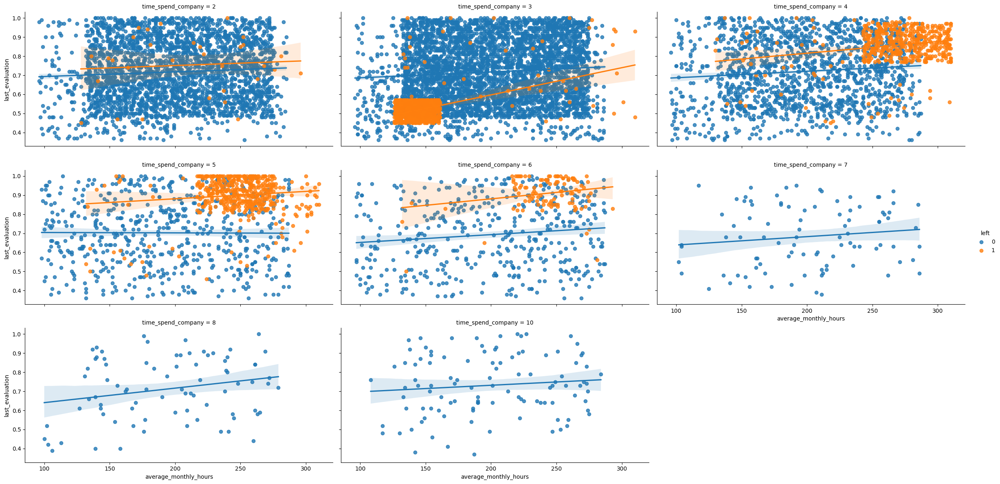

In [302]:
#############################################
# last_evaluation vs average_monthly_hours
# by left
# keep time_spend_company constant
#############################################

sns.lmplot(data=df_drop, x="average_monthly_hours", y="last_evaluation",col='time_spend_company',
           hue='left',height=4,aspect=2,col_wrap=3)
plt.show()
#=>time_spend_company=3 had patterns, it might be a condition
#=>time_spend_company=4,5,6 had patterns, it might be a condition

In [303]:
#check Group1:low-middle average_monthly_hours, low-middle last_evaluation, low-middle satisfaction_level
#126<=average_monthly_hours<=161
#0.45<=last_evaluation<=0.57
#0.36<=satisfaction_level<=0.46
#number_project=2
#time_spend_company=3
mask=(df_drop['average_monthly_hours']<=161)& \
     (df_drop['average_monthly_hours']>=126)& \
     (df_drop['last_evaluation']>=0.45)& \
     (df_drop['last_evaluation']<=0.57)& \
     (df_drop['satisfaction_level']>=0.36)& \
     (df_drop['satisfaction_level']<=0.46)& \
     (df_drop['number_project']==2)& \
     (df_drop['time_spend_company']==3)
print(df_drop[mask]['left'].value_counts())
print(df_drop[mask]['time_spend_company'].value_counts())
#=>most of them were 3 years
print(df_drop[mask]['work_accident'].value_counts())
#=>most of them no accident
print(df_drop[mask]['promotion_last_5years'].value_counts())
#=>most of them no promotion
print(df_drop[mask]['department'].value_counts())
print(df_drop[mask]['salary'].value_counts())
print(df_drop[mask]['number_project'].value_counts())
display(df_drop[mask].describe())
df_drop[mask].head()

left
1    829
0      4
Name: count, dtype: int64
time_spend_company
3    833
Name: count, dtype: int64
work_accident
0    788
1     45
Name: count, dtype: int64
promotion_last_5years
0    828
1      5
Name: count, dtype: int64
department
sales          242
technical      142
support        124
IT              69
hr              58
marketing       54
product_mng     49
accounting      45
RandD           29
management      21
Name: count, dtype: int64
salary
low       495
medium    313
high       25
Name: count, dtype: int64
number_project
2    833
Name: count, dtype: int64


,satisfaction_level,last_evaluation,number_project,average_monthly_hours,time_spend_company,work_accident,left,promotion_last_5years,salary_encoding
count,833.000000,833.000000,833.0,833.000000,833.0,833.000000,833.000000,833.000000,833.000000
mean,0.408319,0.510516,2.0,143.614646,3.0,0.054022,0.995198,0.006002,0.435774
std,0.029804,0.036289,0.0,10.137237,0.0,0.226196,0.069171,0.077289,0.553414
min,0.360000,0.450000,2.0,126.000000,3.0,0.000000,0.000000,0.000000,0.000000
25%,0.380000,0.480000,2.0,135.000000,3.0,0.000000,1.000000,0.000000,0.000000
50%,0.410000,0.510000,2.0,144.000000,3.0,0.000000,1.000000,0.000000,0.000000
75%,0.430000,0.540000,2.0,152.000000,3.0,0.000000,1.000000,0.000000,1.000000
max,0.460000,0.570000,2.0,161.000000,3.0,1.000000,1.000000,1.000000,2.000000


,satisfaction_level,last_evaluation,number_project,average_monthly_hours,time_spend_company,work_accident,left,promotion_last_5years,department,salary,salary_encoding,emp_type,evaluation_range,average_monthly_hours_range,time_spend_company_range
0,0.38,0.53,2,157,3,0,1,0,sales,low,0,part time,"(0.4,0.6]","(125,160]",3
4,0.37,0.52,2,159,3,0,1,0,sales,low,0,part time,"(0.4,0.6]","(125,160]",3
5,0.41,0.50,2,153,3,0,1,0,sales,low,0,part time,"(0.4,0.6]","(125,160]",3
9,0.42,0.53,2,142,3,0,1,0,sales,low,0,part time,"(0.4,0.6]","(125,160]",3
10,0.45,0.54,2,135,3,0,1,0,sales,low,0,part time,"(0.4,0.6]","(125,160]",3


In [304]:
mask=(df_drop['average_monthly_hours']<=161)& \
     (df_drop['average_monthly_hours']>=126)& \
     (df_drop['last_evaluation']>=0.45)& \
     (df_drop['last_evaluation']<=0.57)& \
     (df_drop['satisfaction_level']>=0.36)& \
     (df_drop['satisfaction_level']<=0.46)& \
     (df_drop['number_project']==2)& \
     (df_drop['time_spend_company']==3)& \
     (df_drop['left']==1)
     #(df_drop['satisfaction_level']<0.5)
display(df_drop[mask][['satisfaction_level']].describe())
print(df_drop[mask]['left'].value_counts())
df_drop[mask].describe()

,satisfaction_level
count,829.000000
mean,0.408432
std,0.029789
min,0.360000
25%,0.380000
50%,0.410000
75%,0.430000
max,0.460000


left
1    829
Name: count, dtype: int64


,satisfaction_level,last_evaluation,number_project,average_monthly_hours,time_spend_company,work_accident,left,promotion_last_5years,salary_encoding
count,829.000000,829.000000,829.0,829.000000,829.0,829.000000,829.0,829.000000,829.000000
mean,0.408432,0.510531,2.0,143.618818,3.0,0.053076,1.0,0.006031,0.433052
std,0.029789,0.036255,0.0,10.140769,0.0,0.224320,0.0,0.077474,0.548972
min,0.360000,0.450000,2.0,126.000000,3.0,0.000000,1.0,0.000000,0.000000
25%,0.380000,0.480000,2.0,135.000000,3.0,0.000000,1.0,0.000000,0.000000
50%,0.410000,0.510000,2.0,144.000000,3.0,0.000000,1.0,0.000000,0.000000
75%,0.430000,0.540000,2.0,152.000000,3.0,0.000000,1.0,0.000000,1.000000
max,0.460000,0.570000,2.0,161.000000,3.0,1.000000,1.0,1.000000,2.000000


In [305]:
#check the left bottom orange rectangle(same condition but didn't leave)
mask=(df_drop['average_monthly_hours']<=161)& \
     (df_drop['average_monthly_hours']>=126)& \
     (df_drop['last_evaluation']>=0.45)& \
     (df_drop['last_evaluation']<=0.57)& \
     (df_drop['satisfaction_level']>=0.36)& \
     (df_drop['satisfaction_level']<=0.46)& \
     (df_drop['number_project']==2)& \
     (df_drop['time_spend_company']==3)& \
     (df_drop['left']==0)
print(df_drop[mask]['time_spend_company'].value_counts())
#=>most of them were 3 years
print(df_drop[mask]['work_accident'].value_counts())
#=>most of them no accident
print(df_drop[mask]['promotion_last_5years'].value_counts())
#=>most of them no promotion
print(df_drop[mask]['department'].value_counts())
print(df_drop[mask]['salary'].value_counts())
print(df_drop[mask]['number_project'].value_counts())
display(df_drop[mask][['satisfaction_level']].describe())
df_drop[mask].head()

time_spend_company
3    4
Name: count, dtype: int64
work_accident
0    3
1    1
Name: count, dtype: int64
promotion_last_5years
0    4
Name: count, dtype: int64
department
support    2
sales      1
IT         1
Name: count, dtype: int64
salary
low       2
high      2
medium    0
Name: count, dtype: int64
number_project
2    4
Name: count, dtype: int64


,satisfaction_level
count,4.000000
mean,0.385000
std,0.026458
min,0.360000
25%,0.367500
50%,0.380000
75%,0.397500
max,0.420000


,satisfaction_level,last_evaluation,number_project,average_monthly_hours,time_spend_company,work_accident,left,promotion_last_5years,department,salary,salary_encoding,emp_type,evaluation_range,average_monthly_hours_range,time_spend_company_range
6466,0.39,0.57,2,132,3,0,0,0,support,low,0,part time,"(0.4,0.6]","(125,160]",3
7989,0.36,0.45,2,135,3,1,0,0,support,high,2,part time,"(0.4,0.6]","(125,160]",3
9781,0.42,0.50,2,151,3,0,0,0,sales,low,0,part time,"(0.4,0.6]","(125,160]",3
10671,0.37,0.51,2,153,3,0,0,0,IT,high,2,part time,"(0.4,0.6]","(125,160]",3


In [306]:
#check Group2: high average_monthly_hours, high last_evaluation, low satisfaction_level
#243<= average_monthly_hours <=310
#0.09<=satisfaction_level<=0.11
#0.77<=last_evaluation<=0.98
#number_project=5,6,7
#time_spend_company=4,5
mask=(df_drop['average_monthly_hours']<=310)& \
     (df_drop['average_monthly_hours']>=243)& \
     (df_drop['last_evaluation']>=0.77)& \
     (df_drop['last_evaluation']<=0.98)& \
     (df_drop['satisfaction_level']>=0.09)& \
     (df_drop['satisfaction_level']<=0.11)& \
     (df_drop['number_project'].isin([5,6,7]))& \
     (df_drop['time_spend_company'].isin([4,5]))
print(df_drop[mask]['left'].value_counts())
print(df_drop[mask]['time_spend_company'].value_counts())
print(df_drop[mask]['work_accident'].value_counts())
print(df_drop[mask]['promotion_last_5years'].value_counts())
print(df_drop[mask]['department'].value_counts())
print(df_drop[mask]['salary'].value_counts())
print(df_drop[mask]['number_project'].value_counts())
display(df_drop[mask].describe())
df_drop[mask].head()

left
1    493
Name: count, dtype: int64
time_spend_company
4    441
5     52
Name: count, dtype: int64
work_accident
0    469
1     24
Name: count, dtype: int64
promotion_last_5years
0    492
1      1
Name: count, dtype: int64
department
sales          124
technical      111
support         77
IT              45
accounting      29
hr              25
product_mng     23
RandD           23
marketing       22
management      14
Name: count, dtype: int64
salary
low       289
medium    194
high       10
Name: count, dtype: int64
number_project
6    337
7    135
5     21
Name: count, dtype: int64


,satisfaction_level,last_evaluation,number_project,average_monthly_hours,time_spend_company,work_accident,left,promotion_last_5years,salary_encoding
count,493.000000,493.000000,493.000000,493.000000,493.000000,493.000000,493.0,493.000000,493.000000
mean,0.101542,0.872779,6.231237,276.707911,4.105477,0.048682,1.0,0.002028,0.434077
std,0.007548,0.060181,0.513316,19.904750,0.307479,0.215420,0.0,0.045038,0.535541
min,0.090000,0.770000,5.000000,243.000000,4.000000,0.000000,1.0,0.000000,0.000000
25%,0.100000,0.830000,6.000000,260.000000,4.000000,0.000000,1.0,0.000000,0.000000
50%,0.100000,0.870000,6.000000,277.000000,4.000000,0.000000,1.0,0.000000,0.000000
75%,0.110000,0.930000,7.000000,293.000000,4.000000,0.000000,1.0,0.000000,1.000000
max,0.110000,0.980000,7.000000,310.000000,5.000000,1.000000,1.0,1.000000,2.000000


,satisfaction_level,last_evaluation,number_project,average_monthly_hours,time_spend_company,work_accident,left,promotion_last_5years,department,salary,salary_encoding,emp_type,evaluation_range,average_monthly_hours_range,time_spend_company_range
2,0.11,0.88,7,272,4,0,1,0,sales,medium,1,full time,"(0.8,1]","(240,280]",4
6,0.10,0.77,6,247,4,0,1,0,sales,low,0,full time,"(0.6,0.8]","(240,280]",4
11,0.11,0.81,6,305,4,0,1,0,sales,low,0,full time,"(0.8,1]","(280,inf)",4
20,0.11,0.83,6,282,4,0,1,0,sales,low,0,full time,"(0.8,1]","(280,inf)",4
22,0.09,0.95,6,304,4,0,1,0,sales,low,0,full time,"(0.8,1]","(280,inf)",4


In [307]:
#check Group3: high average_monthly_hours, high last_evaluation, high satisfaction_level
#217<= average_monthly_hours <=276
#0.72<=satisfaction_level<=0.92
#0.81<=last_evaluation<=1
#number_project=4,5
#time_spend_company=5,6
mask=(df_drop['average_monthly_hours']<=276)& \
     (df_drop['average_monthly_hours']>=217)& \
     (df_drop['last_evaluation']>=0.81)& \
     (df_drop['last_evaluation']<=1)& \
     (df_drop['satisfaction_level']>=0.72)& \
     (df_drop['satisfaction_level']<=0.92)& \
     (df_drop['number_project'].isin([4,5]))& \
     (df_drop['time_spend_company'].isin([5,6]))
print(df_drop[mask]['left'].value_counts())
print(df_drop[mask]['time_spend_company'].value_counts())
print(df_drop[mask]['work_accident'].value_counts())
print(df_drop[mask]['promotion_last_5years'].value_counts())
print(df_drop[mask]['department'].value_counts())
print(df_drop[mask]['salary'].value_counts())
print(df_drop[mask]['number_project'].value_counts())
display(df_drop[mask].describe())
mask2=mask&(df_drop['left']==0)
df_drop[mask2].head(15)

left
1    478
0     11
Name: count, dtype: int64
time_spend_company
5    387
6    102
Name: count, dtype: int64
work_accident
0    462
1     27
Name: count, dtype: int64
promotion_last_5years
0    488
1      1
Name: count, dtype: int64
department
sales          141
technical       97
support         84
IT              34
product_mng     30
marketing       28
accounting      24
RandD           22
hr              18
management      11
Name: count, dtype: int64
salary
low       281
medium    198
high       10
Name: count, dtype: int64
number_project
5    291
4    198
Name: count, dtype: int64


,satisfaction_level,last_evaluation,number_project,average_monthly_hours,time_spend_company,work_accident,left,promotion_last_5years,salary_encoding
count,489.000000,489.000000,489.000000,489.000000,489.000000,489.000000,489.000000,489.000000,489.000000
mean,0.819877,0.922986,4.595092,246.897751,5.208589,0.055215,0.977505,0.002045,0.445808
std,0.057879,0.058887,0.491377,16.465245,0.406716,0.228633,0.148438,0.045222,0.537171
min,0.720000,0.810000,4.000000,217.000000,5.000000,0.000000,0.000000,0.000000,0.000000
25%,0.770000,0.870000,4.000000,234.000000,5.000000,0.000000,1.000000,0.000000,0.000000
50%,0.820000,0.930000,5.000000,247.000000,5.000000,0.000000,1.000000,0.000000,0.000000
75%,0.870000,0.980000,5.000000,260.000000,5.000000,0.000000,1.000000,0.000000,1.000000
max,0.920000,1.000000,5.000000,276.000000,6.000000,1.000000,1.000000,1.000000,2.000000


,satisfaction_level,last_evaluation,number_project,average_monthly_hours,time_spend_company,work_accident,left,promotion_last_5years,department,salary,salary_encoding,emp_type,evaluation_range,average_monthly_hours_range,time_spend_company_range
2415,0.92,0.97,4,238,5,1,0,0,support,medium,1,full time,"(0.8,1]","(200,240]",5
3780,0.86,0.96,5,238,5,0,0,0,technical,low,0,full time,"(0.8,1]","(200,240]",5
5847,0.77,0.85,5,221,5,0,0,0,technical,low,0,full time,"(0.8,1]","(200,240]",5
5994,0.80,0.99,4,255,5,1,0,0,technical,low,0,full time,"(0.8,1]","(240,280]",5
6263,0.90,0.87,4,231,5,0,0,0,management,low,0,full time,"(0.8,1]","(200,240]",5
6358,0.81,0.98,5,243,6,0,0,0,sales,medium,1,full time,"(0.8,1]","(240,280]",>=6
7443,0.85,0.96,4,240,6,0,0,0,technical,medium,1,full time,"(0.8,1]","(200,240]",>=6
7762,0.82,0.87,5,273,6,0,0,0,support,medium,1,full time,"(0.8,1]","(240,280]",>=6
10098,0.73,0.83,5,266,5,0,0,0,sales,low,0,full time,"(0.8,1]","(240,280]",5
10237,0.88,0.81,4,235,6,0,0,0,sales,medium,1,full time,"(0.8,1]","(200,240]",>=6


In [308]:
#Group1: low-middle average_monthly_hours, low-middle last_evaluation, low-middle satisfaction_level
#126<= average_monthly_hours <=161
#0.36<=satisfaction_level<=0.46
#0.45<=last_evaluation<=0.57
#number_project=2
#time_spend_company=3

#Group2: high average_monthly_hours, high last_evaluation, low satisfaction_level
#243<= average_monthly_hours <=310
#0.09<=satisfaction_level<=0.11
#0.77<=last_evaluation<=0.98
#number_project=5,6,7
#time_spend_company=4,5

#Group3: high average_monthly_hours, high last_evaluation, high satisfaction_level
#217<= average_monthly_hours <=276
#0.72<=satisfaction_level<=0.92
#0.81<=last_evaluation<=1
#number_project=4,5
#time_spend_company=5,6
def compute_left_group(average_monthly_hours,
                       satisfaction_level,
                       last_evaluation,
                       number_project,
                       time_spend_company,
                       left):
    if left==0:
        result='not left'
    elif (average_monthly_hours>=126) & \
        (average_monthly_hours<=161) & \
        (satisfaction_level>=0.36) & \
        (satisfaction_level<=0.46) & \
        (last_evaluation>=0.45) & \
        (last_evaluation<=0.57) & \
        (number_project in [2]) & \
        (time_spend_company in [3]):
        result='group1'
    elif (average_monthly_hours>=243) & \
        (average_monthly_hours<=310) & \
        (satisfaction_level>=0.09) & \
        (satisfaction_level<=0.11) & \
        (last_evaluation>=0.77) & \
        (last_evaluation<=0.98) & \
        (number_project in [5,6,7]) & \
        (time_spend_company in [4,5]):
        result='group2'
    elif (average_monthly_hours>=217) & \
        (average_monthly_hours<=276) & \
        (satisfaction_level>=0.72) & \
        (satisfaction_level<=0.92) & \
        (last_evaluation>=0.81) & \
        (last_evaluation<=1) & \
        (number_project in [4,5]) & \
        (time_spend_company in [5,6]):
        result='group3'
    else:
        result='others'
    return result
    
#compute whether an employee quit or laid off
def compute_left_type(average_monthly_hours,
                       satisfaction_level,
                       last_evaluation,
                       number_project,
                       time_spend_company,
                       left):
    left_group=compute_left_group(average_monthly_hours,
                       satisfaction_level,
                       last_evaluation,
                       number_project,
                       time_spend_company,
                       left)
    if left_group=='not left':
        result='not left'
    elif left_group == 'others':
        result='personal'
    else:
        result='company'
    return result

df_drop['left_group']=df_drop[['average_monthly_hours',
                               'satisfaction_level',
                               'last_evaluation',
                               'number_project',
                               'time_spend_company',
                               'left']].apply(lambda x: compute_left_group(x["average_monthly_hours"],
                                                                           x["satisfaction_level"],
                                                                           x["last_evaluation"],
                                                                           x["number_project"],
                                                                           x["time_spend_company"],
                                                                           x["left"],), axis=1)
df_drop['left_type']=df_drop[['average_monthly_hours',
                               'satisfaction_level',
                               'last_evaluation',
                               'number_project',
                               'time_spend_company',
                               'left']].apply(lambda x: compute_left_type(x["average_monthly_hours"],
                                                                           x["satisfaction_level"],
                                                                           x["last_evaluation"],
                                                                           x["number_project"],
                                                                           x["time_spend_company"],
                                                                           x["left"],), axis=1)
df_drop.info()

<class 'pandas.core.frame.DataFrame'>
Index: 11991 entries, 0 to 11999
Data columns (total 17 columns):
 #   Column                       Non-Null Count  Dtype   
---  ------                       --------------  -----   
 0   satisfaction_level           11991 non-null  float64 
 1   last_evaluation              11991 non-null  float64 
 2   number_project               11991 non-null  int64   
 3   average_monthly_hours        11991 non-null  int64   
 4   time_spend_company           11991 non-null  int64   
 5   work_accident                11991 non-null  int64   
 6   left                         11991 non-null  int64   
 7   promotion_last_5years        11991 non-null  int64   
 8   department                   11991 non-null  object  
 9   salary                       11991 non-null  category
 10  salary_encoding              11991 non-null  int8    
 11  emp_type                     11991 non-null  object  
 12  evaluation_range             11991 non-null  category
 13  averag

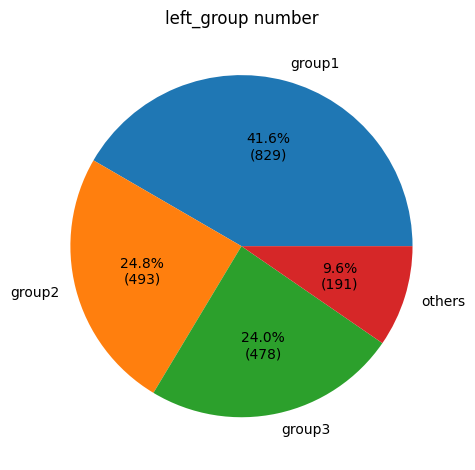

In [309]:
############################################
#left_group
############################################
mask=df_drop['left']==1
result=df_drop[mask].groupby(['left_group'])[['number_project']].count().reset_index().rename(columns={'number_project':'count'})
plt.pie(result['count'],labels = result["left_group"], autopct=autopct_format(result['count']))
plt.title(f"left_group number")
plt.tight_layout()
plt.show()

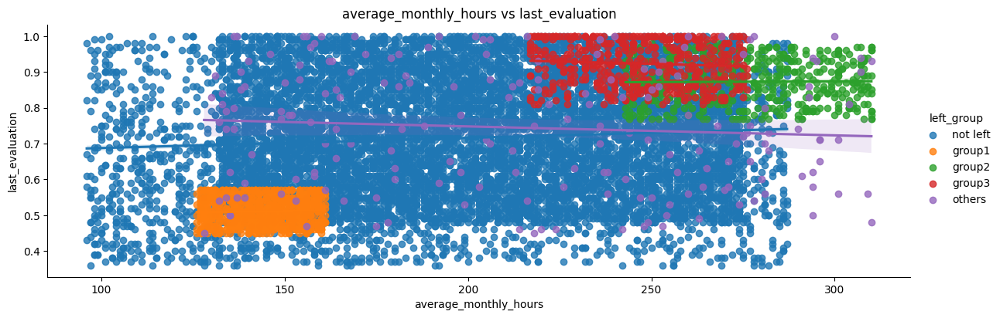

In [310]:
#############################################
# last_evaluation vs average_monthly_hours
# by left_group
#############################################
order=['not left','group1','group2','group3','others']
sns.lmplot(data=df_drop, x="average_monthly_hours", y="last_evaluation",hue='left_group',
           height=4,aspect=3,hue_order=order)
plt.title('average_monthly_hours vs last_evaluation')
plt.show()

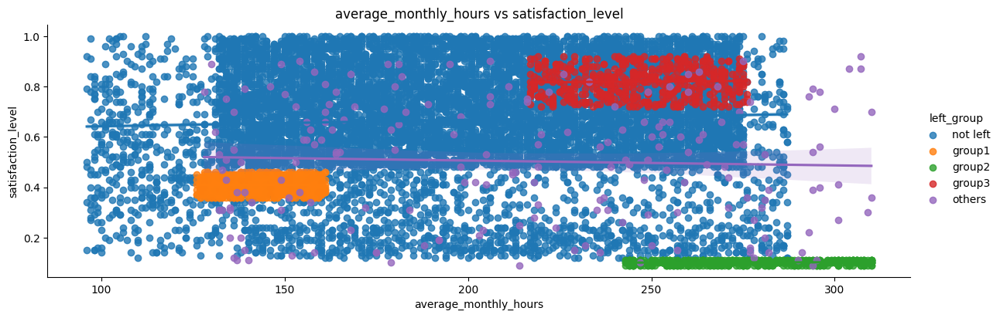

In [311]:
#############################################
# satisfaction_level vs average_monthly_hours
# by left_group
#############################################
order=['not left','group1','group2','group3','others']
sns.lmplot(data=df_drop, x="average_monthly_hours", y="satisfaction_level",hue='left_group',
           height=4,aspect=3,hue_order=order)
plt.title('average_monthly_hours vs satisfaction_level')
plt.show()

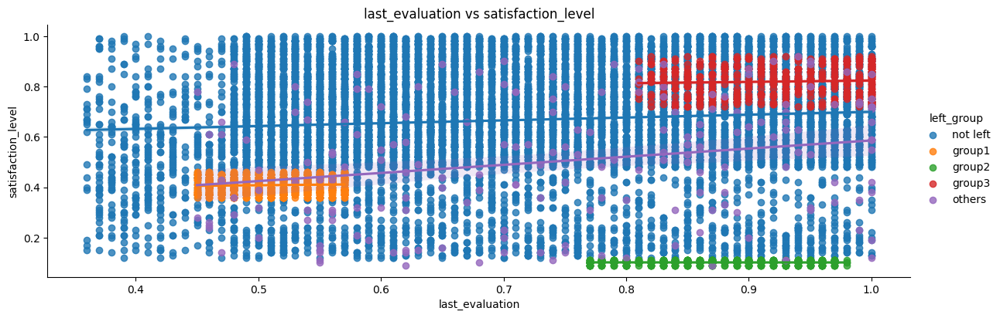

In [312]:
#############################################
# satisfaction_level vs last_evaluation
# by left_group
#############################################
order=['not left','group1','group2','group3','others']
sns.lmplot(data=df_drop, x="last_evaluation", y="satisfaction_level",hue='left_group',
           height=4,aspect=3,hue_order=order)
plt.title('last_evaluation vs satisfaction_level')
plt.show()

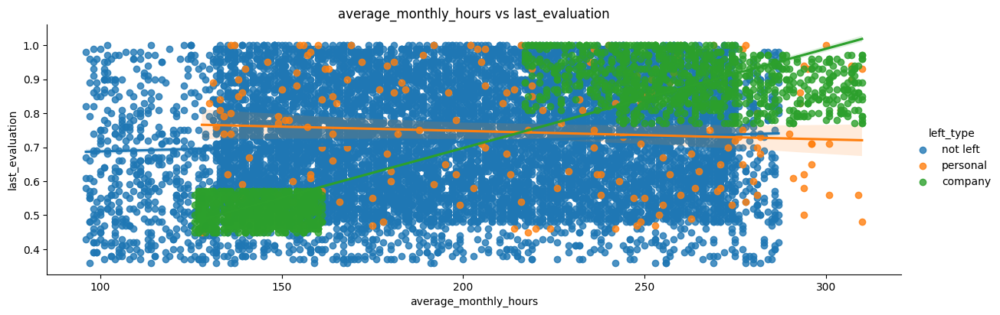

In [313]:
#############################################
# last_evaluation vs average_monthly_hours
# by left_type
#############################################
order=['not left','personal','company']
sns.lmplot(data=df_drop, x="average_monthly_hours", y="last_evaluation",hue='left_type',
           height=4,aspect=3,hue_order=order)
plt.title('average_monthly_hours vs last_evaluation')
plt.show()

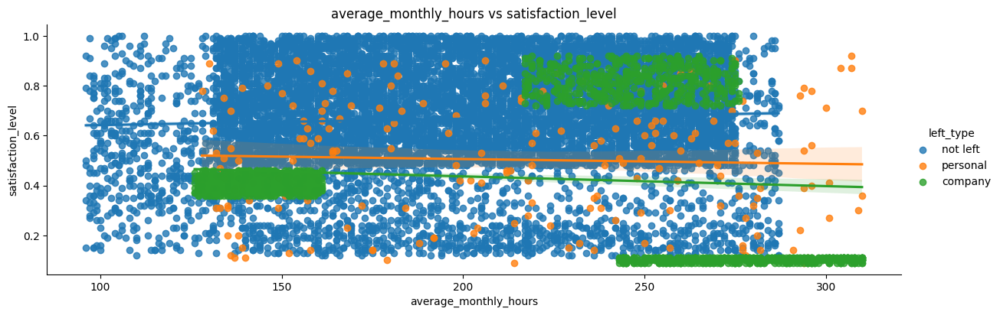

In [314]:
#############################################
# satisfaction_level vs average_monthly_hours
# by left_type
#############################################
order=['not left','personal','company']
sns.lmplot(data=df_drop, x="average_monthly_hours", y="satisfaction_level",hue='left_type',
           height=4,aspect=3,hue_order=order)
plt.title('average_monthly_hours vs satisfaction_level')
plt.show()

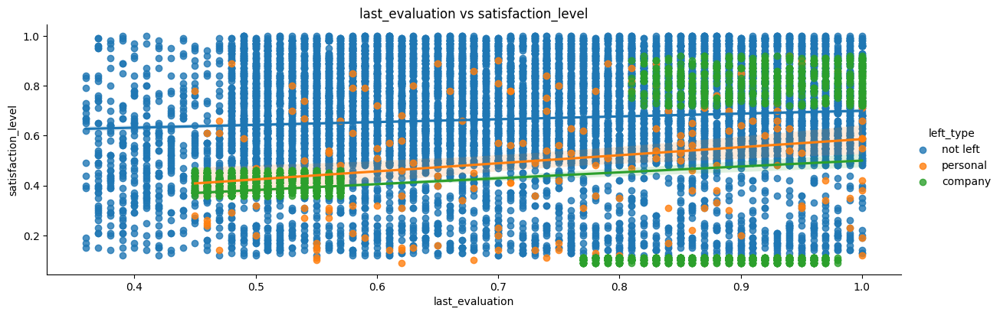

In [315]:
#############################################
# satisfaction_level vs last_evaluation
# by left_type
#############################################
order=['not left','personal','company']
sns.lmplot(data=df_drop, x="last_evaluation", y="satisfaction_level",hue='left_type',
           height=4,aspect=3,hue_order=order)
plt.title('last_evaluation vs satisfaction_level')
plt.show()

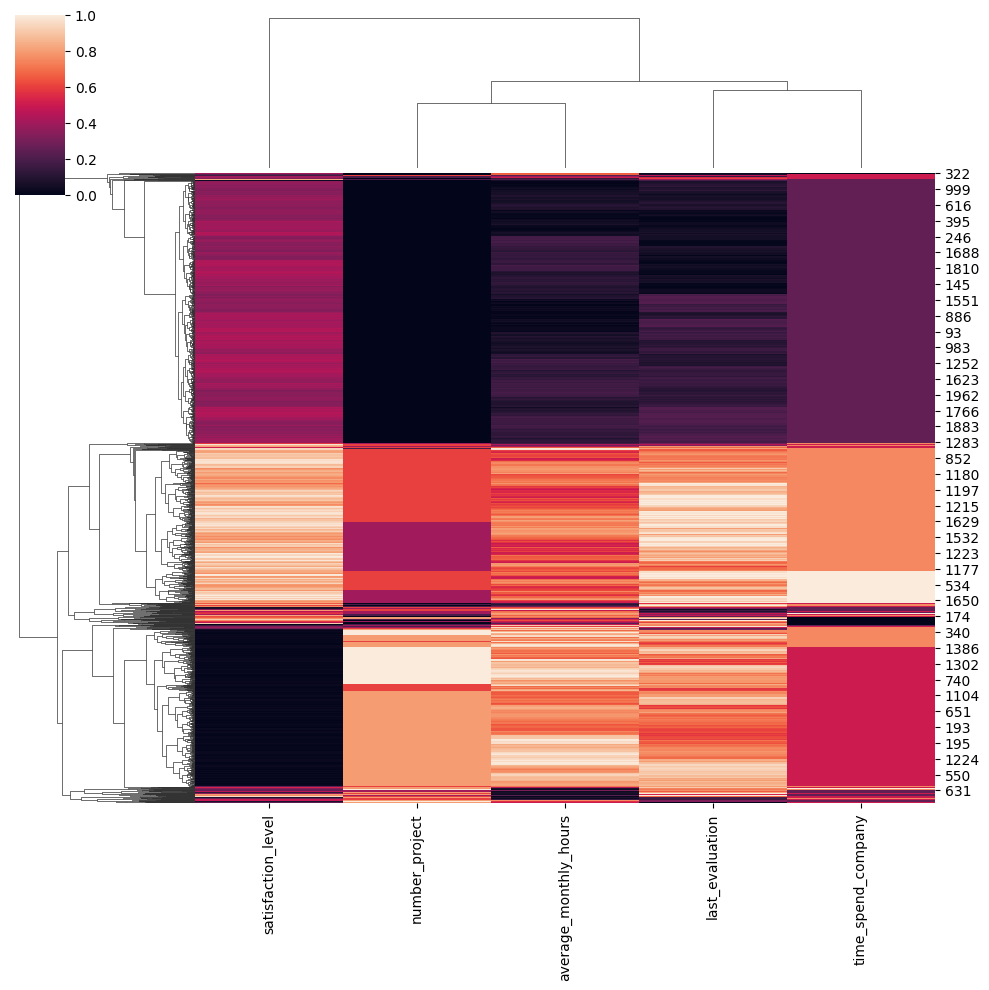

In [316]:
######################################################################
#Cluster map by left group
######################################################################
mask=df_drop['left']==1
t_columns=['satisfaction_level', 'last_evaluation', 'number_project',
       'average_monthly_hours', 'time_spend_company',]
sns.clustermap(df_drop[mask][t_columns], standard_scale=1)
plt.show()

##### last_evaluation vs emp_type

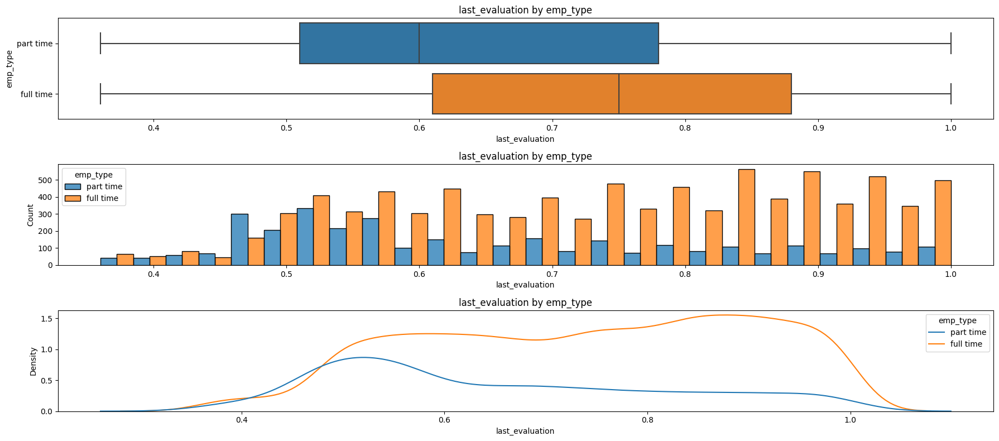

,emp_type,min,max,std,mean,median,count
0,full time,0.36,1.0,0.161916,0.741824,0.75,8696
1,part time,0.36,1.0,0.166967,0.650331,0.60,3295


In [317]:
#############################################
#last_evaluation and emp_type
#############################################
fig, axs = plt.subplots(3,1,figsize=(18,8))

sns.boxplot(data=df_drop,y='emp_type',x='last_evaluation',ax=axs[0])
axs[0].set_title('last_evaluation by emp_type')

sns.histplot(data=df_drop,hue='emp_type',x='last_evaluation',palette='tab10',multiple='dodge',ax=axs[1])
axs[1].set_title('last_evaluation by emp_type')

sns.kdeplot(data=df_drop,hue='emp_type',x='last_evaluation',palette='tab10',ax=axs[2])
axs[2].set_title('last_evaluation by emp_type')

plt.tight_layout()
plt.show()

display(df_drop.groupby(['emp_type'])['last_evaluation'].agg(['min','max','std','mean','median','count']).reset_index())


In [318]:
# Levene test for equal variances.
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.levene.html
#H0:All input samples are from populations with equal variances
#HA:At least one input sample are from populations with different variance
significance_level=0.01
print('Levene test result of last_evaluation')
statistic, p_value = levene(*[df_drop['last_evaluation'][df_drop['emp_type'] == item]
                                    for item in df_drop['emp_type'].unique()])
show_test_result(statistic, p_value,significance_level)

Levene test result of last_evaluation
Fail to reject H0 at significance level 0.01 (Pvalue=0.598, Statistic=0.28)


In [319]:
# Kruskal-Wallis test
#H0:The population median of all of the groups are equal
#HA:At least one group has different median
#set significance_level 0.01
significance_level=0.01

print('Kruskal-Wallis testresult of last_evaluation')
statistic, p_value = kruskal(*[df_drop['last_evaluation'][df_drop['emp_type'] == item]
                                    for item in df_drop['emp_type'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis testresult of last_evaluation
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=720.05)


In [320]:
# Mann-Whitney U rank test
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.mannwhitneyu.html
#H0:The population median of full time employee less equal than part time employee
#HA:The population median of full time employee greater than part time employee
significance_level=0.01
print('Mann-Whitney test result of last_evaluation')
statistic, p_value = mannwhitneyu(df_drop[df_drop['emp_type']=='full time']['last_evaluation'], 
                                  df_drop[df_drop['emp_type']=='part time']['last_evaluation'],
                                  alternative="greater")
show_test_result(statistic, p_value,significance_level)

Mann-Whitney test result of last_evaluation
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=18866670.5)


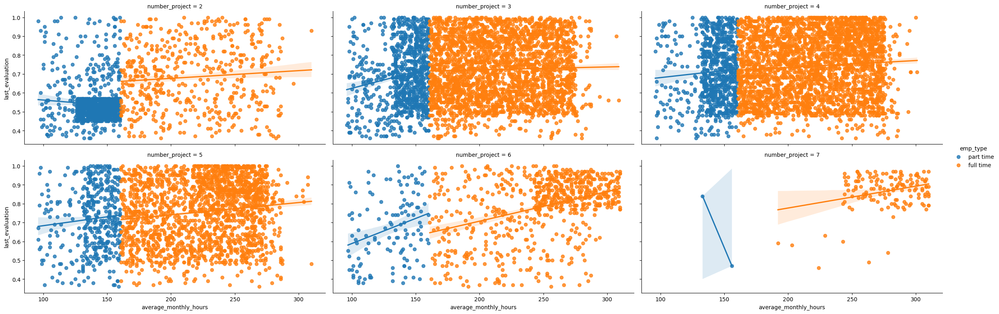

In [321]:
#############################################
# last_evaluation vs average_monthly_hours
# keep number_project constant
#############################################

sns.lmplot(data=df_drop, x="average_monthly_hours", y="last_evaluation",col='number_project',
           hue='emp_type',height=4,aspect=2,col_wrap=3)
plt.show()

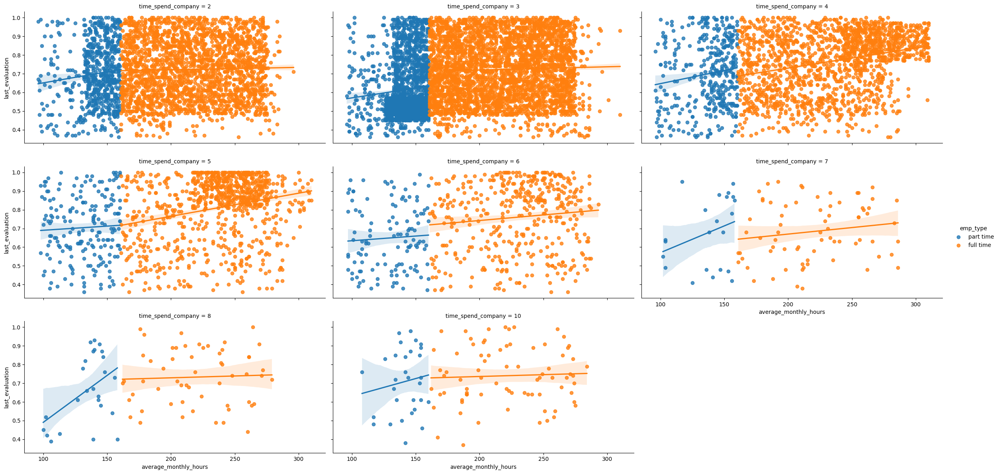

In [322]:
#############################################
# last_evaluation vs average_monthly_hours
# keep time_spend_company constant
#############################################

sns.lmplot(data=df_drop, x="average_monthly_hours", y="last_evaluation",col='time_spend_company',
           hue='emp_type',height=4,aspect=2,col_wrap=3)
plt.show()

#### average_monthly_hours

In [323]:
df_drop[['average_monthly_hours']].describe()

,average_monthly_hours
count,11991.000000
mean,200.473522
std,48.727813
min,96.000000
25%,157.000000
50%,200.000000
75%,243.000000
max,310.000000


#####  average_monthly_hours vs number_project

In [324]:
df_drop.groupby(['number_project'])['average_monthly_hours'].agg(['min','max','std','mean','median','count']).reset_index()


,number_project,min,max,std,mean,median,count
0,2,96,310,42.224733,164.812263,151.0,1582
1,3,96,309,44.626776,197.337784,196.0,3520
2,4,96,301,44.753572,203.872456,205.0,3685
3,5,96,310,46.039297,209.125392,217.0,2233
4,6,97,310,56.227901,230.392252,247.0,826
5,7,133,310,27.596817,275.620690,281.0,145


In [325]:
df_drop.groupby(['number_project','left'])['average_monthly_hours'].agg(['min','max','std','mean','median','count']).reset_index()


,number_project,left,min,max,std,mean,median,count
0,2,0,96,287,50.462044,186.880000,182.0,725
1,2,1,126,310,19.438837,146.143524,145.0,857
2,3,0,96,287,44.539192,197.177197,196.0,3482
3,3,1,131,309,50.549920,212.052632,203.5,38
4,4,0,96,287,44.358216,201.241879,201.0,3448
5,4,1,128,301,30.886419,242.143460,247.0,237
6,5,0,96,287,45.754055,202.706349,203.0,1890
7,5,1,130,310,28.071637,244.495627,247.0,343
8,6,0,97,287,51.495508,198.617582,205.0,455
9,6,1,134,310,32.115316,269.361186,272.0,371


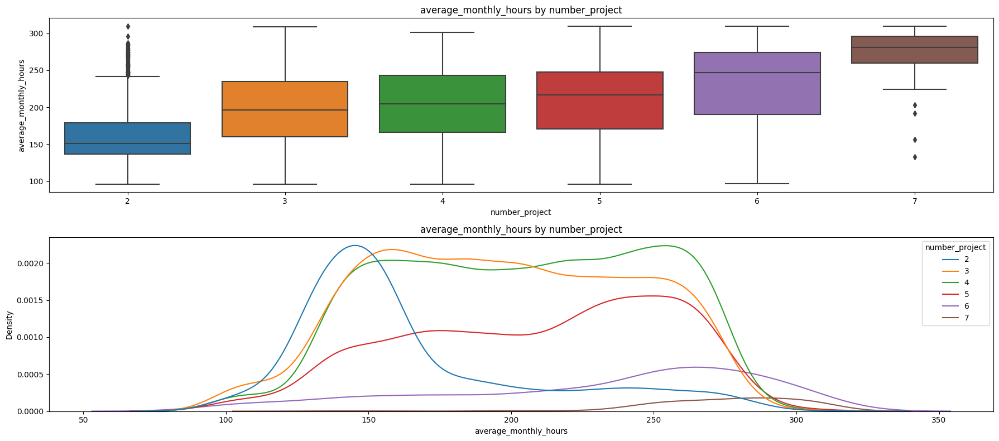

,number_project,min,max,std,mean,median,count
0,2,96,310,42.224733,164.812263,151.0,1582
1,3,96,309,44.626776,197.337784,196.0,3520
2,4,96,301,44.753572,203.872456,205.0,3685
3,5,96,310,46.039297,209.125392,217.0,2233
4,6,97,310,56.227901,230.392252,247.0,826
5,7,133,310,27.596817,275.620690,281.0,145


In [326]:
#############################################
#average_monthly_hours and number_project
#############################################
fig, axs = plt.subplots(2,1,figsize=(18,8))

sns.boxplot(data=df_drop,x='number_project',y='average_monthly_hours',ax=axs[0])
axs[0].set_title('average_monthly_hours by number_project')

sns.kdeplot(data=df_drop,hue='number_project',x='average_monthly_hours',palette='tab10',ax=axs[1])
axs[1].set_title('average_monthly_hours by number_project')

plt.tight_layout()
plt.show()

display(df_drop.groupby(['number_project'])['average_monthly_hours'].agg(['min','max','std','mean','median','count']).reset_index())

#=>more projects, higher average monthly hours
#=>7 projects had vary high average_monthly_hours and all of them left
#=>overtime work might be an factor

In [327]:
# Levene test for equal variances.
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.levene.html
#H0:All input samples are from populations with equal variances
#HA:At least one input sample are from populations with different variance
significance_level=0.01
print('Levene test result of average_monthly_hours')
statistic, p_value = levene(*[df_drop['average_monthly_hours'][df_drop['number_project'] == item]
                                    for item in df_drop['number_project'].unique()])
show_test_result(statistic, p_value,significance_level)

Levene test result of average_monthly_hours
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=63.06)


In [328]:
# Kruskal-Wallis test
#H0:The population median of all of the groups are equal
#HA:At least one group has different median
#set significance_level 0.01
significance_level=0.01

print('Kruskal-Wallis testresult of average_monthly_hours')
statistic, p_value = kruskal(*[df_drop['average_monthly_hours'][df_drop['number_project'] == item]
                                    for item in df_drop['number_project'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis testresult of average_monthly_hours
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=1587.54)


In [329]:
# Kolmogorov-Smirnov
# https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.ks_2samp.html
#H0:The distributions of average_monthly_hours for department are identical.
#HA:The distributions of average_monthly_hours for department are different.
#set significance_level 0.01
significance_level=0.01

print('Kolmogorov-Smirnov test result of average_monthly_hours')

results = {}
for i, item1 in enumerate(sorted(df_drop['number_project'].unique())):
    for j, item2 in enumerate(sorted(df_drop['number_project'].unique())):
        if i < j:
            ks_stat, ks_p = ks_2samp(df_drop[df_drop['number_project'] == item1]['average_monthly_hours'], 
                                     df_drop[df_drop['number_project'] == item2]['average_monthly_hours'])
            if ks_p<=significance_level:
                ks_result='Reject H0'
            else:
                ks_result='Fail reject'
            results[f"{item1} vs {item2}"] = (ks_stat, ks_p,ks_result)

# Convert the results into a DataFrame
ks_df = pd.DataFrame(results).transpose()
ks_df.columns = ['KS_Statistic', 'Pvalue','Result']
ks_df.reset_index(inplace=True)
ks_df.rename(columns={'index': 'number_project'}, inplace=True)

ks_df

Kolmogorov-Smirnov test result of average_monthly_hours


,number_project,KS_Statistic,Pvalue,Result
0,2 vs 3,0.435784,0.0,Reject H0
1,2 vs 4,0.469833,0.0,Reject H0
2,2 vs 5,0.500123,0.0,Reject H0
3,2 vs 6,0.541634,0.0,Reject H0
4,2 vs 7,0.867597,0.0,Reject H0
5,3 vs 4,0.071464,0.0,Reject H0
6,3 vs 5,0.139304,0.0,Reject H0
7,3 vs 6,0.347771,0.0,Reject H0
8,3 vs 7,0.755496,0.0,Reject H0
9,4 vs 5,0.076747,0.0,Reject H0


In [330]:
df_drop.groupby(['time_spend_company','number_project'])["average_monthly_hours"].agg(['min','max','std','mean','median','count']).reset_index()

,time_spend_company,number_project,min,max,std,mean,median,count
0,2,2,96,285,47.102699,188.405000,185.0,200
1,2,3,98,284,43.036278,197.668138,198.0,1133
2,2,4,97,296,43.212026,202.522080,203.0,1019
3,2,5,96,285,43.551144,204.874251,208.0,501
4,2,6,107,283,50.506548,192.125000,189.0,56
5,2,7,156,156,NaN,156.000000,156.0,1
6,3,2,98,310,33.649950,155.257750,147.0,1129
7,3,3,96,301,43.424893,196.881420,194.0,1577
8,3,4,96,296,43.545284,201.705031,201.0,1590
9,3,5,97,310,44.302230,205.216883,206.0,770


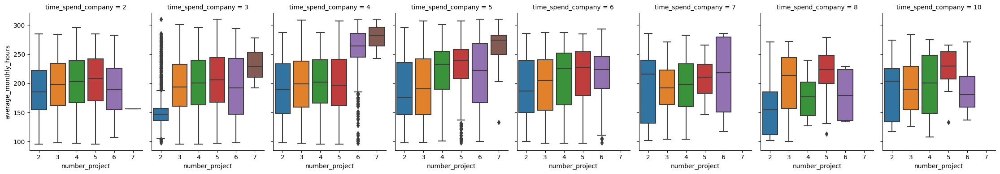

In [331]:
#############################################
#average_monthly_hours by number_project
#keep time_spend_company constant
#############################################
sns.catplot(
    data=df_drop, x='number_project',y="average_monthly_hours",  col="time_spend_company",
    kind="box", height=4, aspect=.7,col_wrap=8
)
plt.show()

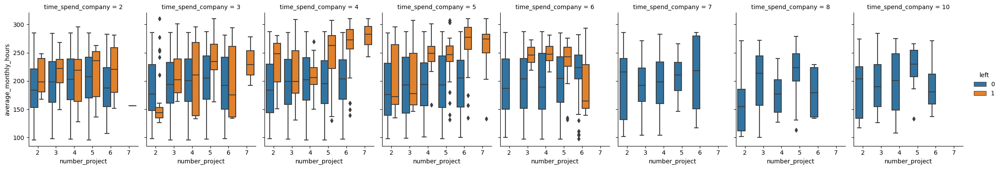

In [332]:
#############################################
#average_monthly_hours by number_project
#keep time_spend_company constant
#############################################
sns.catplot(
    data=df_drop, x='number_project',y="average_monthly_hours", hue="left", col="time_spend_company",
    kind="box", height=4, aspect=.7,col_wrap=8
)
plt.show()

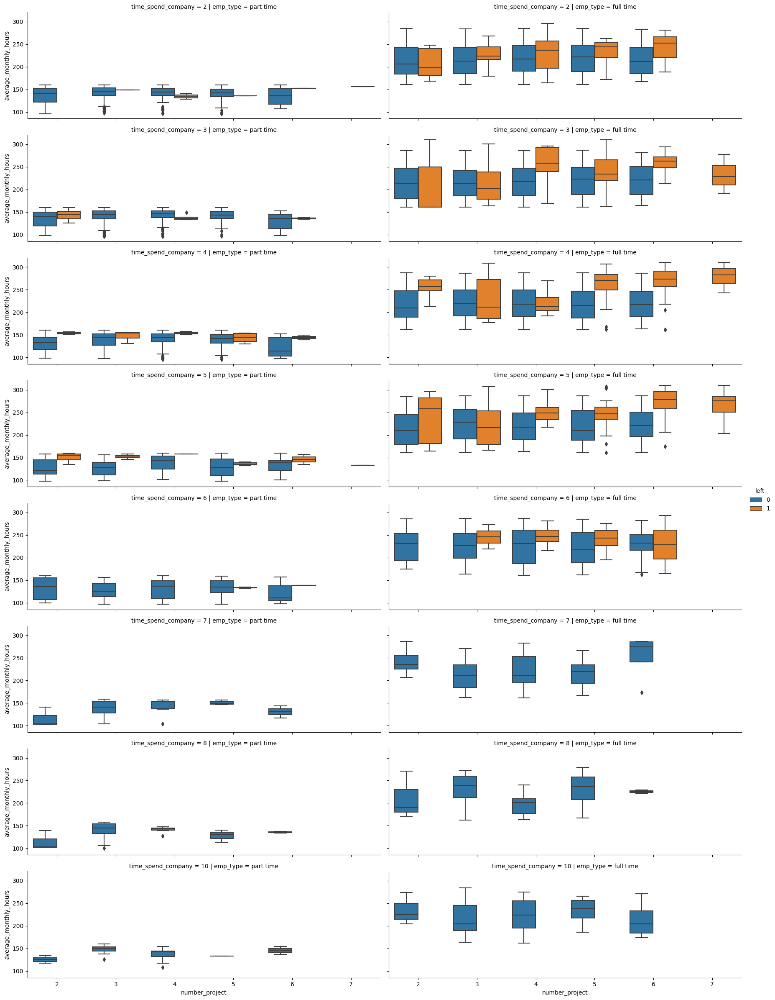

In [333]:
#############################################
#average_monthly_hours by number_project
#keep time_spend_company and emp_type constant
#############################################
sns.catplot(
    data=df_drop, x='number_project',y="average_monthly_hours", hue="left", row="time_spend_company",
    col='emp_type',
    kind="box", height=3, aspect=3,
    #facet_kws=dict(sharey=False)
)
plt.show()

#=> we can observe that in most cases, left employees had higher average_monthly_hours than who didn't leave
#=>some didn't follow this rule(left employee had lower work hours), it might due to they leave for some other reasons or the company let them go

#####  average_monthly_hours vs time_spend_company

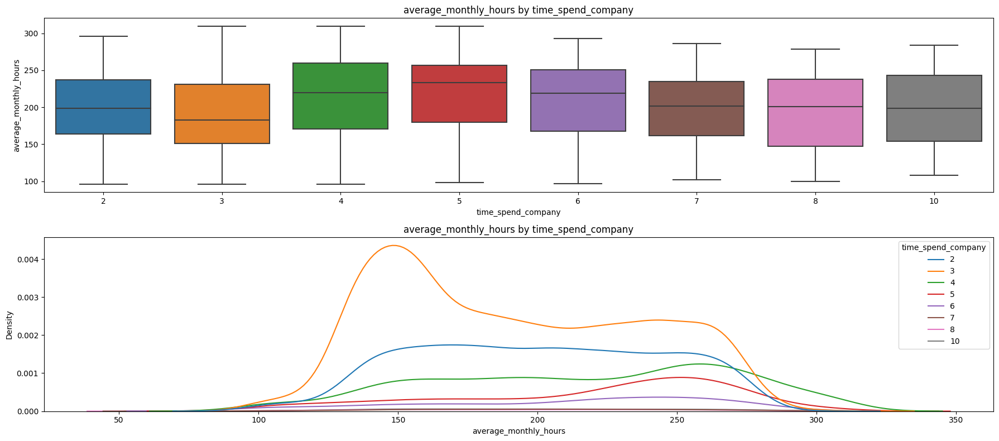

,time_spend_company,min,max,std,mean,median,count
0,2,96,296,43.814491,199.850859,199.0,2910
1,3,96,310,45.957116,190.505780,183.0,5190
2,4,96,310,53.421198,215.950623,220.0,2005
3,5,98,310,50.823065,218.212806,233.0,1062
4,6,97,293,51.776965,208.448339,219.0,542
5,7,102,286,47.690295,200.744681,202.0,94
6,8,100,279,49.284485,193.802469,201.0,81
7,10,108,284,47.569871,199.224299,199.0,107


In [334]:
#############################################
#average_monthly_hours and time_spend_company
#############################################
fig, axs = plt.subplots(2,1,figsize=(18,8))

sns.boxplot(data=df_drop,x='time_spend_company',y='average_monthly_hours',ax=axs[0])
axs[0].set_title('average_monthly_hours by time_spend_company')

sns.kdeplot(data=df_drop,hue='time_spend_company',x='average_monthly_hours',palette='tab10',ax=axs[1])
axs[1].set_title('average_monthly_hours by time_spend_company')

plt.tight_layout()
plt.show()

display(df_drop.groupby(['time_spend_company'])['average_monthly_hours'].agg(['min','max','std','mean','median','count']).reset_index())

In [335]:
display(df_drop.groupby(['emp_type','time_spend_company'])['average_monthly_hours'].agg(['min','max','std','mean','median','count']).reset_index())

,emp_type,time_spend_company,min,max,std,mean,median,count
0,full time,2,161,296,33.666718,217.002670,216.0,2247
1,full time,3,161,310,34.429141,217.359544,217.0,3332
2,full time,4,161,310,40.266315,234.886068,241.0,1615
3,full time,5,161,310,33.517986,236.797251,243.0,873
4,full time,6,161,293,33.501975,230.292453,234.0,424
5,full time,7,161,286,35.603010,219.944444,215.0,72
6,full time,8,162,279,33.302154,220.196429,218.0,56
7,full time,10,162,284,35.483835,221.766234,221.0,77
8,part time,2,96,160,14.403831,141.720965,144.0,663
9,part time,3,96,160,12.694151,142.348224,144.0,1858


In [336]:
# Levene test for equal variances.
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.levene.html
#H0:All input samples are from populations with equal variances
#HA:At least one input sample are from populations with different variance
significance_level=0.01
print('Levene test result of average_monthly_hours')
statistic, p_value = levene(*[df_drop['average_monthly_hours'][df_drop['time_spend_company'] == item]
                                    for item in df_drop['time_spend_company'].unique()])
show_test_result(statistic, p_value,significance_level)

Levene test result of average_monthly_hours
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=19.63)


In [337]:
# Kruskal-Wallis test
#H0:The population median of all of the groups are equal
#HA:At least one group has different median
#set significance_level 0.01
significance_level=0.01

print('Kruskal-Wallis testresult of average_monthly_hours')
statistic, p_value = kruskal(*[df_drop['average_monthly_hours'][df_drop['time_spend_company'] == item]
                                    for item in df_drop['time_spend_company'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis testresult of average_monthly_hours
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=580.14)


In [338]:
# Kolmogorov-Smirnov
# https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.ks_2samp.html
#H0:The distributions of average_monthly_hours for time_spend_company are identical.
#HA:The distributions of average_monthly_hours for time_spend_company are different.
#set significance_level 0.01
significance_level=0.01

print('Kolmogorov-Smirnov test result of average_monthly_hours')

results = {}
for i, item1 in enumerate(sorted(df_drop['time_spend_company'].unique())):
    for j, item2 in enumerate(sorted(df_drop['time_spend_company'].unique())):
        if i < j:
            ks_stat, ks_p = ks_2samp(df_drop[df_drop['time_spend_company'] == item1]['average_monthly_hours'], 
                                     df_drop[df_drop['time_spend_company'] == item2]['average_monthly_hours'])
            if ks_p<=significance_level:
                ks_result='Reject H0'
            else:
                ks_result='Fail reject'
            results[f"{item1} vs {item2}"] = (ks_stat, ks_p,ks_result)

# Convert the results into a DataFrame
ks_df = pd.DataFrame(results).transpose()
ks_df.columns = ['KS_Statistic', 'Pvalue','Result']
ks_df.reset_index(inplace=True)
ks_df.rename(columns={'index': 'time_spend_company'}, inplace=True)

ks_df

Kolmogorov-Smirnov test result of average_monthly_hours


,time_spend_company,KS_Statistic,Pvalue,Result
0,2 vs 3,0.133099,0.0,Reject H0
1,2 vs 4,0.179317,0.0,Reject H0
2,2 vs 5,0.243283,0.0,Reject H0
3,2 vs 6,0.156832,0.0,Reject H0
4,2 vs 7,0.060532,0.871615,Fail reject
5,2 vs 8,0.131399,0.119927,Fail reject
6,2 vs 10,0.079963,0.498145,Fail reject
7,3 vs 4,0.206539,0.0,Reject H0
8,3 vs 5,0.297919,0.0,Reject H0
9,3 vs 6,0.222577,0.0,Reject H0


#####  average_monthly_hours vs work_accident

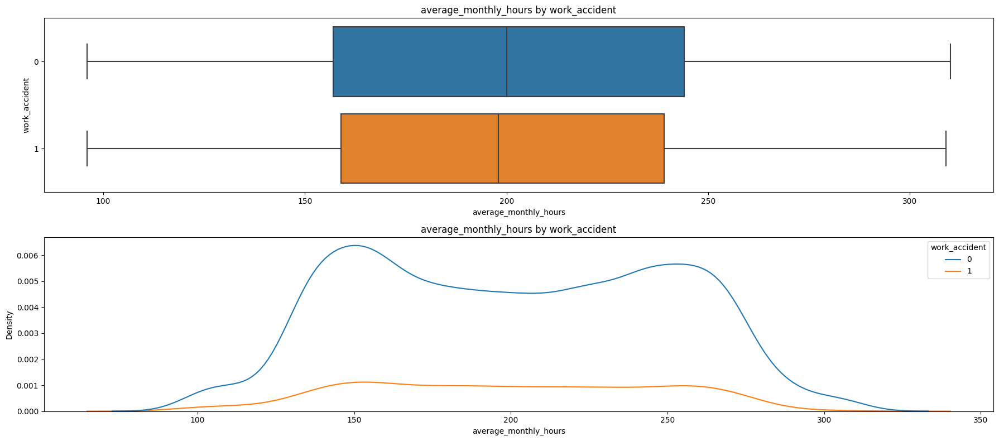

,work_accident,min,max,std,mean,median,count
0,0,96,310,49.045076,200.741150,200.0,10141
1,1,96,309,46.936386,199.006486,198.0,1850


In [339]:
#############################################
#average_monthly_hours and work_accident
#############################################
fig, axs = plt.subplots(2,1,figsize=(18,8))

sns.boxplot(data=df_drop,y=df_drop['work_accident'].astype(str),x='average_monthly_hours',ax=axs[0])
axs[0].set_title('average_monthly_hours by work_accident')

sns.kdeplot(data=df_drop,hue='work_accident',x='average_monthly_hours',palette='tab10',ax=axs[1])
axs[1].set_title('average_monthly_hours by work_accident')

plt.tight_layout()
plt.show()

display(df_drop.groupby(['work_accident'])['average_monthly_hours'].agg(['min','max','std','mean','median','count']).reset_index())

In [340]:
# Levene test for equal variances.
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.levene.html
#H0:All input samples are from populations with equal variances
#HA:At least one input sample are from populations with different variance
significance_level=0.01
print('Levene test result of average_monthly_hours')
statistic, p_value = levene(*[df_drop['average_monthly_hours'][df_drop['work_accident'] == item]
                                    for item in df_drop['work_accident'].unique()])
show_test_result(statistic, p_value,significance_level)

Levene test result of average_monthly_hours
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=13.99)


In [341]:
# Kruskal-Wallis test
#H0:The population median of all of the groups are equal
#HA:At least one group has different median
#set significance_level 0.01
significance_level=0.01

print('Kruskal-Wallis testresult of average_monthly_hours')
statistic, p_value = kruskal(*[df_drop['average_monthly_hours'][df_drop['work_accident'] == item]
                                    for item in df_drop['work_accident'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis testresult of average_monthly_hours
Fail to reject H0 at significance level 0.01 (Pvalue=0.298, Statistic=1.09)


In [342]:
# Kolmogorov-Smirnov
# https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.ks_2samp.html
#H0:The distributions of average_monthly_hours for time_spend_company are identical.
#HA:The distributions of average_monthly_hours for time_spend_company are different.
#set significance_level 0.01
significance_level=0.01

print('Kolmogorov-Smirnov test result of average_monthly_hours')

results = {}
for i, item1 in enumerate(sorted(df_drop['work_accident'].unique())):
    for j, item2 in enumerate(sorted(df_drop['work_accident'].unique())):
        if i < j:
            ks_stat, ks_p = ks_2samp(df_drop[df_drop['work_accident'] == item1]['average_monthly_hours'], 
                                     df_drop[df_drop['work_accident'] == item2]['average_monthly_hours'])
            if ks_p<=significance_level:
                ks_result='Reject H0'
            else:
                ks_result='Fail reject'
            results[f"{item1} vs {item2}"] = (ks_stat, ks_p,ks_result)

# Convert the results into a DataFrame
ks_df = pd.DataFrame(results).transpose()
ks_df.columns = ['KS_Statistic', 'Pvalue','Result']
ks_df.reset_index(inplace=True)
ks_df.rename(columns={'index': 'work_accident'}, inplace=True)

ks_df

Kolmogorov-Smirnov test result of average_monthly_hours


,work_accident,KS_Statistic,Pvalue,Result
0,0 vs 1,0.033605,0.057023,Fail reject


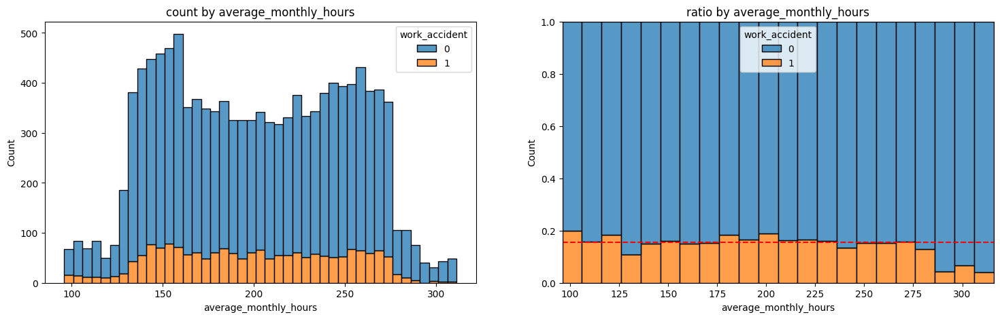

In [343]:
#############################################
#work_accident ratio by average_monthly_hours
#############################################
fig, axs = plt.subplots(1,2,figsize=(18,5))
sns.histplot(data=df_drop,hue='work_accident',x='average_monthly_hours',palette='tab10',multiple='stack',binwidth=5,ax=axs[0])
axs[0].set_title('count by average_monthly_hours')

work_accident_ratio=df_drop['work_accident'].sum()/df_drop.shape[0]
sns.histplot(data=df_drop,hue='work_accident',x='average_monthly_hours',palette='tab10',multiple='fill',binwidth=10,ax=axs[1])
axs[1].axhline(work_accident_ratio,color='red',linestyle='--')
axs[1].set_title('ratio by average_monthly_hours')
plt.show()

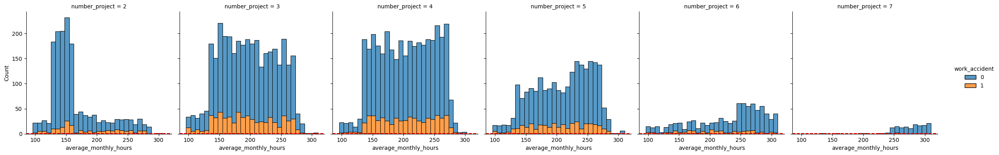

In [344]:
############################################
#work_accident ratio by average_monthly_hours
#keep number_project constant
############################################
g=sns.displot(
    data=df_drop, x='average_monthly_hours',  hue='work_accident',col="number_project",
    kind="hist", height=4, aspect=1,col_wrap=6, multiple='stack',
    facet_kws=dict(sharex=False)
)
axes = g.fig.axes

work_accident_ratio=df_drop['work_accident'].sum()/df_drop.shape[0]
for ax in axes:
    ax.axhline(work_accident_ratio,color='red',linestyle='--')
plt.show()

#=>we can observe that amoung employees who did 2 projects, many of them worked for 130-160 hours
#=>maybe there were higher part time worker proportion in 2 projects

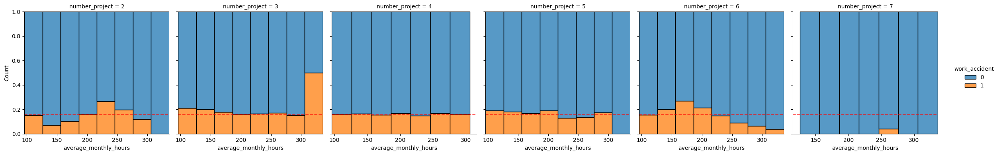

In [345]:
############################################
#work_accident ratio by average_monthly_hours
#keep number_project constant
############################################
g=sns.displot(
    data=df_drop, x='average_monthly_hours',  hue='work_accident',col="number_project",
    kind="hist", height=4, aspect=1,col_wrap=6, multiple='fill',binwidth=30,
    facet_kws=dict(sharex=False)
)
axes = g.fig.axes

work_accident_ratio=df_drop['work_accident'].sum()/df_drop.shape[0]
for ax in axes:
    ax.axhline(work_accident_ratio,color='red',linestyle='--')
plt.show()

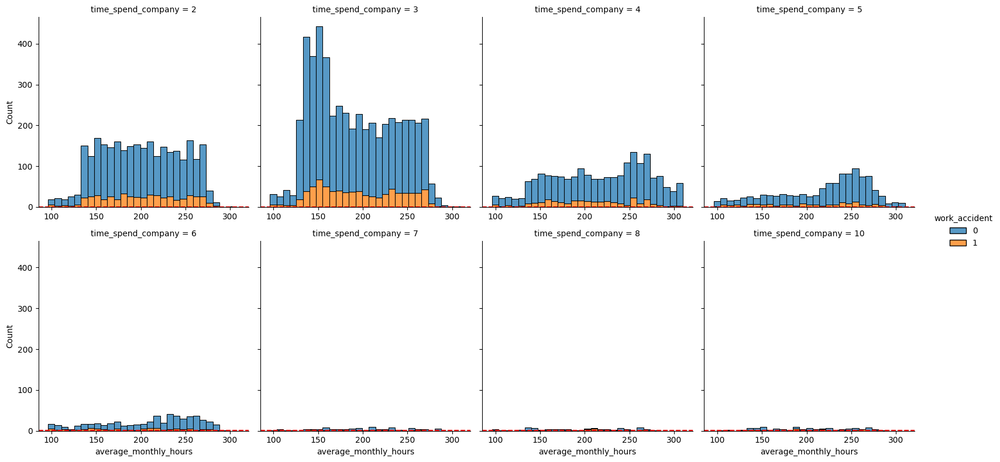

In [346]:
############################################
#work_accident ratio by average_monthly_hours
#keep time_spend_company constant
############################################
g=sns.displot(
    data=df_drop, x='average_monthly_hours',  hue='work_accident',col="time_spend_company",
    kind="hist", height=4, aspect=1,col_wrap=4, multiple='stack',
    facet_kws=dict(sharex=False)
)
axes = g.fig.axes

work_accident_ratio=df_drop['work_accident'].sum()/df_drop.shape[0]
for ax in axes:
    ax.axhline(work_accident_ratio,color='red',linestyle='--')
plt.show()

#=>we can observe that amoung employees who stay 3 years, many of them worked for 130-160 hours
#=>maybe there were higher part time worker proportion in 3 years

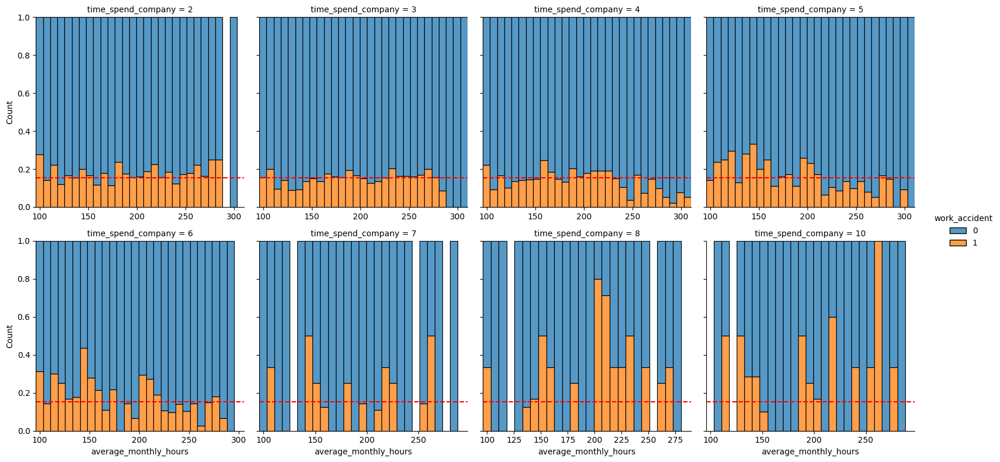

In [347]:
############################################
#work_accident ratio by average_monthly_hours
#keep time_spend_company constant
############################################
g=sns.displot(
    data=df_drop, x='average_monthly_hours',  hue='work_accident',col="time_spend_company",
    kind="hist", height=4, aspect=1,col_wrap=4, multiple='fill',
    facet_kws=dict(sharex=False)
)
axes = g.fig.axes

work_accident_ratio=df_drop['work_accident'].sum()/df_drop.shape[0]
for ax in axes:
    ax.axhline(work_accident_ratio,color='red',linestyle='--')
plt.show()

#####  average_monthly_hours vs promotion_last_5years

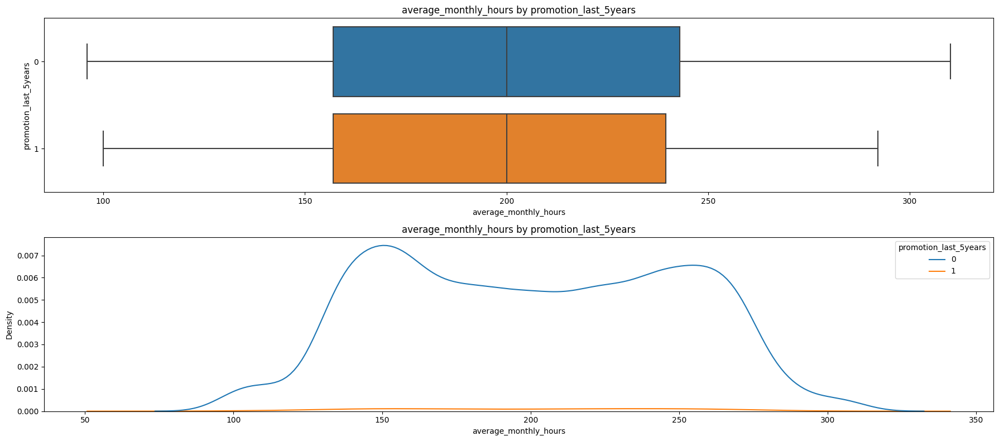

,promotion_last_5years,min,max,std,mean,median,count
0,0,96,310,48.749052,200.505260,200.0,11788
1,1,100,292,47.559202,198.630542,200.0,203


In [348]:
#############################################
#average_monthly_hours and promotion_last_5years
#############################################
fig, axs = plt.subplots(2,1,figsize=(18,8))

sns.boxplot(data=df_drop,y=df_drop['promotion_last_5years'].astype(str),x='average_monthly_hours',ax=axs[0])
axs[0].set_title('average_monthly_hours by promotion_last_5years')

sns.kdeplot(data=df_drop,hue='promotion_last_5years',x='average_monthly_hours',palette='tab10',ax=axs[1])
axs[1].set_title('average_monthly_hours by promotion_last_5years')

plt.tight_layout()
plt.show()

display(df_drop.groupby(['promotion_last_5years'])['average_monthly_hours'].agg(['min','max','std','mean','median','count']).reset_index())

In [349]:
# Levene test for equal variances.
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.levene.html
#H0:All input samples are from populations with equal variances
#HA:At least one input sample are from populations with different variance
significance_level=0.01
print('Levene test result of average_monthly_hours')
statistic, p_value = levene(*[df_drop['average_monthly_hours'][df_drop['promotion_last_5years'] == item]
                                    for item in df_drop['promotion_last_5years'].unique()])
show_test_result(statistic, p_value,significance_level)

Levene test result of average_monthly_hours
Fail to reject H0 at significance level 0.01 (Pvalue=0.648, Statistic=0.21)


In [350]:
# Kruskal-Wallis test
#H0:The population median of all of the groups are equal
#HA:At least one group has different median
#set significance_level 0.01
significance_level=0.01

print('Kruskal-Wallis testresult of average_monthly_hours')
statistic, p_value = kruskal(*[df_drop['average_monthly_hours'][df_drop['promotion_last_5years'] == item]
                                    for item in df_drop['promotion_last_5years'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis testresult of average_monthly_hours
Fail to reject H0 at significance level 0.01 (Pvalue=0.612, Statistic=0.26)


In [351]:
# Kolmogorov-Smirnov
# https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.ks_2samp.html
#H0:The distributions of average_monthly_hours for promotion_last_5years are identical.
#HA:The distributions of average_monthly_hours for promotion_last_5years are different.
#set significance_level 0.01
significance_level=0.01

print('Kolmogorov-Smirnov test result of average_monthly_hours')

results = {}
for i, item1 in enumerate(sorted(df_drop['promotion_last_5years'].unique())):
    for j, item2 in enumerate(sorted(df_drop['promotion_last_5years'].unique())):
        if i < j:
            ks_stat, ks_p = ks_2samp(df_drop[df_drop['promotion_last_5years'] == item1]['average_monthly_hours'], 
                                     df_drop[df_drop['promotion_last_5years'] == item2]['average_monthly_hours'])
            if ks_p<=significance_level:
                ks_result='Reject H0'
            else:
                ks_result='Fail reject'
            results[f"{item1} vs {item2}"] = (ks_stat, ks_p,ks_result)

# Convert the results into a DataFrame
ks_df = pd.DataFrame(results).transpose()
ks_df.columns = ['KS_Statistic', 'Pvalue','Result']
ks_df.reset_index(inplace=True)
ks_df.rename(columns={'index': 'promotion_last_5years'}, inplace=True)

ks_df

Kolmogorov-Smirnov test result of average_monthly_hours


,promotion_last_5years,KS_Statistic,Pvalue,Result
0,0 vs 1,0.044309,0.810453,Fail reject


#####  average_monthly_hours vs department

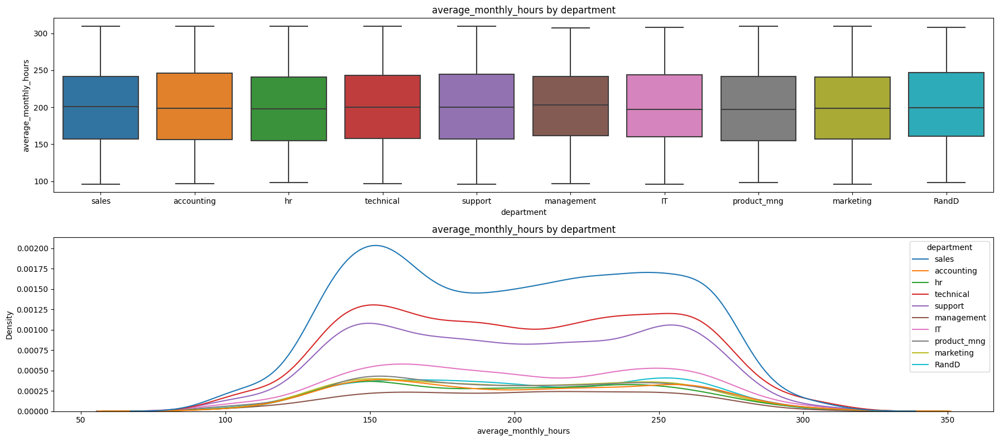

,department,min,max,std,mean,median,count
0,IT,96,308,49.452109,200.638320,197.0,976
1,RandD,98,308,48.155340,201.291066,199.5,694
2,accounting,97,310,49.474541,200.877617,199.0,621
3,hr,98,310,48.466969,199.371048,198.0,601
4,management,97,307,46.797205,201.529817,203.5,436
5,marketing,96,310,47.989770,199.487370,199.0,673
6,product_mng,98,310,49.179060,198.893586,197.0,686
7,sales,96,310,48.474620,200.242050,201.0,3239
8,support,96,310,48.919579,200.627128,200.0,1821
9,technical,97,310,49.176088,201.115419,200.0,2244


In [352]:
#############################################
#average_monthly_hours and department
#############################################
fig, axs = plt.subplots(2,1,figsize=(18,8))

sns.boxplot(data=df_drop,x='department',y='average_monthly_hours',ax=axs[0])
axs[0].set_title('average_monthly_hours by department')

sns.kdeplot(data=df_drop,hue='department',x='average_monthly_hours',palette='tab10',ax=axs[1])
axs[1].set_title('average_monthly_hours by department')

plt.tight_layout()
plt.show()

display(df_drop.groupby(['department'])['average_monthly_hours'].agg(['min','max','std','mean','median','count']).reset_index())

In [353]:
# Levene test for equal variances.
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.levene.html
#H0:All input samples are from populations with equal variances
#HA:At least one input sample are from populations with different variance
significance_level=0.01
print('Levene test result of average_monthly_hours')
statistic, p_value = levene(*[df_drop['average_monthly_hours'][df_drop['department'] == item]
                                    for item in df_drop['department'].unique()])
show_test_result(statistic, p_value,significance_level)

Levene test result of average_monthly_hours
Fail to reject H0 at significance level 0.01 (Pvalue=0.608, Statistic=0.81)


In [354]:
# Kruskal-Wallis test
#H0:The population median of all of the groups are equal
#HA:At least one group has different median
#set significance_level 0.01
significance_level=0.01

print('Kruskal-Wallis testresult of average_monthly_hours')
statistic, p_value = kruskal(*[df_drop['average_monthly_hours'][df_drop['department'] == item]
                                    for item in df_drop['department'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis testresult of average_monthly_hours
Fail to reject H0 at significance level 0.01 (Pvalue=0.975, Statistic=2.71)


In [355]:
# Kolmogorov-Smirnov
# https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.ks_2samp.html
#H0:The distributions of average_monthly_hours for promotion_last_5years are identical.
#HA:The distributions of average_monthly_hours for promotion_last_5years are different.
#set significance_level 0.01
significance_level=0.01

print('Kolmogorov-Smirnov test result of average_monthly_hours')

results = {}
for i, item1 in enumerate(sorted(df_drop['department'].unique())):
    for j, item2 in enumerate(sorted(df_drop['department'].unique())):
        if i < j:
            ks_stat, ks_p = ks_2samp(df_drop[df_drop['department'] == item1]['average_monthly_hours'], 
                                     df_drop[df_drop['department'] == item2]['average_monthly_hours'])
            if ks_p<=significance_level:
                ks_result='Reject H0'
            else:
                ks_result='Fail reject'
            results[f"{item1} vs {item2}"] = (ks_stat, ks_p,ks_result)

# Convert the results into a DataFrame
ks_df = pd.DataFrame(results).transpose()
ks_df.columns = ['KS_Statistic', 'Pvalue','Result']
ks_df.reset_index(inplace=True)
ks_df.rename(columns={'index': 'department'}, inplace=True)

ks_df

Kolmogorov-Smirnov test result of average_monthly_hours


,department,KS_Statistic,Pvalue,Result
0,IT vs RandD,0.024094,0.966688,Fail reject
1,IT vs accounting,0.039561,0.574967,Fail reject
2,IT vs hr,0.047329,0.360929,Fail reject
3,IT vs management,0.046896,0.502784,Fail reject
4,IT vs marketing,0.032715,0.770868,Fail reject
5,IT vs product_mng,0.046235,0.341794,Fail reject
6,IT vs sales,0.026601,0.651278,Fail reject
7,IT vs support,0.026005,0.770324,Fail reject
8,IT vs technical,0.022713,0.864113,Fail reject
9,RandD vs accounting,0.046678,0.454327,Fail reject


#####  average_monthly_hours vs salary

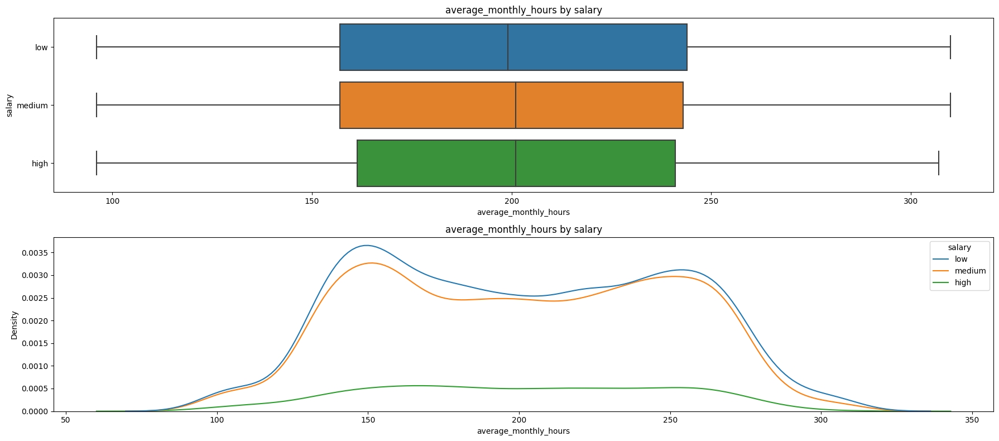

,salary,min,max,std,mean,median,count
0,low,96,310,49.271065,200.439199,199.0,5740
1,medium,96,310,48.371399,200.587341,201.0,5261
2,high,96,307,47.477252,200.067677,201.0,990


In [356]:
#############################################
#average_monthly_hours and salary
#############################################
fig, axs = plt.subplots(2,1,figsize=(18,8))

sns.boxplot(data=df_drop,y=df_drop['salary'].astype(str),x='average_monthly_hours',ax=axs[0])
axs[0].set_title('average_monthly_hours by salary')

sns.kdeplot(data=df_drop,hue='salary',x='average_monthly_hours',palette='tab10',ax=axs[1])
axs[1].set_title('average_monthly_hours by salary')

plt.tight_layout()
plt.show()

display(df_drop.groupby(['salary'])['average_monthly_hours'].agg(['min','max','std','mean','median','count']).reset_index())

In [357]:
# Levene test for equal variances.
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.levene.html
#H0:All input samples are from populations with equal variances
#HA:At least one input sample are from populations with different variance
significance_level=0.01
print('Levene test result of average_monthly_hours')
statistic, p_value = levene(*[df_drop['average_monthly_hours'][df_drop['salary'] == item]
                                    for item in df_drop['salary'].unique()])
show_test_result(statistic, p_value,significance_level)

Levene test result of average_monthly_hours
Fail to reject H0 at significance level 0.01 (Pvalue=0.031, Statistic=3.49)


In [358]:
# Kruskal-Wallis test
#H0:The population median of all of the groups are equal
#HA:At least one group has different median
#set significance_level 0.01
significance_level=0.01

print('Kruskal-Wallis testresult of average_monthly_hours')
statistic, p_value = kruskal(*[df_drop['average_monthly_hours'][df_drop['salary'] == item]
                                    for item in df_drop['salary'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis testresult of average_monthly_hours
Fail to reject H0 at significance level 0.01 (Pvalue=0.96, Statistic=0.08)


In [359]:
# Kolmogorov-Smirnov
# https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.ks_2samp.html
#H0:The distributions of average_monthly_hours for salary are identical.
#HA:The distributions of average_monthly_hours for salary are different.
#set significance_level 0.01
significance_level=0.01

print('Kolmogorov-Smirnov test result of average_monthly_hours')

results = {}
for i, item1 in enumerate(sorted(df_drop['salary'].unique())):
    for j, item2 in enumerate(sorted(df_drop['salary'].unique())):
        if i < j:
            ks_stat, ks_p = ks_2samp(df_drop[df_drop['salary'] == item1]['average_monthly_hours'], 
                                     df_drop[df_drop['salary'] == item2]['average_monthly_hours'])
            if ks_p<=significance_level:
                ks_result='Reject H0'
            else:
                ks_result='Fail reject'
            results[f"{item1} vs {item2}"] = (ks_stat, ks_p,ks_result)

# Convert the results into a DataFrame
ks_df = pd.DataFrame(results).transpose()
ks_df.columns = ['KS_Statistic', 'Pvalue','Result']
ks_df.reset_index(inplace=True)
ks_df.rename(columns={'index': 'salary'}, inplace=True)

ks_df

Kolmogorov-Smirnov test result of average_monthly_hours


,salary,KS_Statistic,Pvalue,Result
0,high vs low,0.039387,0.141313,Fail reject
1,high vs medium,0.035556,0.236373,Fail reject
2,low vs medium,0.01423,0.627491,Fail reject


##### average_monthly_hours vs emp_type

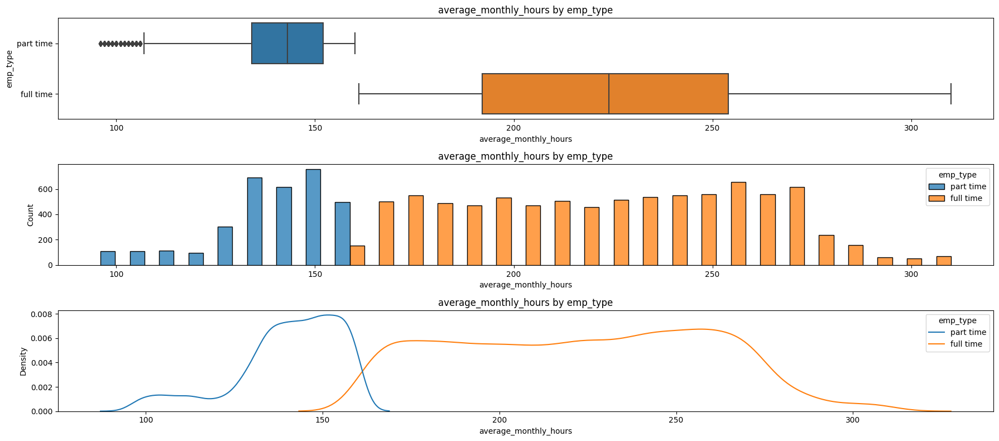

,emp_type,min,max,std,mean,median,count
0,full time,161,310,36.235845,223.182958,224.0,8696
1,part time,96,160,14.904559,140.539909,143.0,3295


In [360]:
#############################################
#last_evaluation and emp_type
#############################################
fig, axs = plt.subplots(3,1,figsize=(18,8))

sns.boxplot(data=df_drop,y='emp_type',x='average_monthly_hours',ax=axs[0])
axs[0].set_title('average_monthly_hours by emp_type')

sns.histplot(data=df_drop,hue='emp_type',x='average_monthly_hours',palette='tab10',multiple='dodge',ax=axs[1])
axs[1].set_title('average_monthly_hours by emp_type')

sns.kdeplot(data=df_drop,hue='emp_type',x='average_monthly_hours',palette='tab10',ax=axs[2])
axs[2].set_title('average_monthly_hours by emp_type')

plt.tight_layout()
plt.show()

display(df_drop.groupby(['emp_type'])['average_monthly_hours'].agg(['min','max','std','mean','median','count']).reset_index())


#### keep department constant

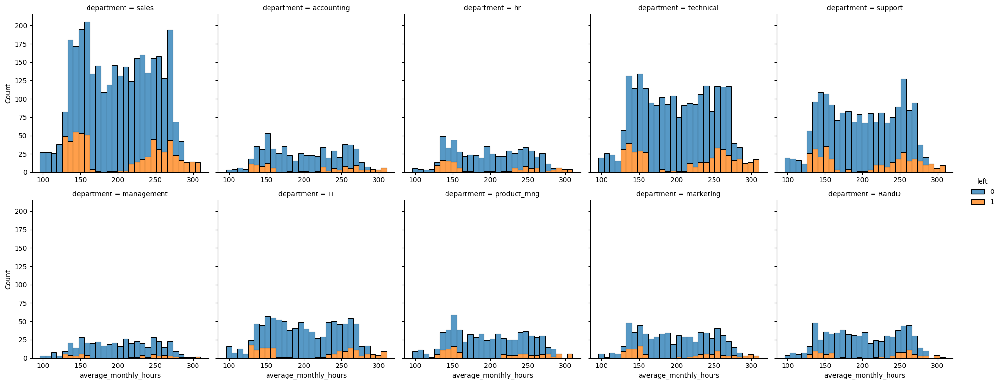

In [361]:
############################################
#average_monthly_hours by left
#keep department constant
############################################
g=sns.displot(
    data=df_drop, x='average_monthly_hours',  hue='left',col="department",
    kind="hist", height=4, aspect=1,col_wrap=5, multiple='stack',
    facet_kws=dict(sharex=False)
)
axes = g.fig.axes

plt.show()

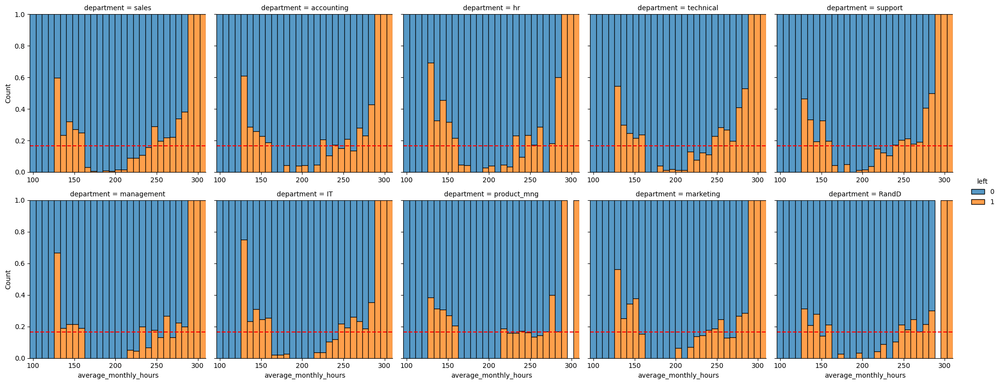

In [362]:
############################################
#average_monthly_hours by left
#keep department constant
############################################
g=sns.displot(
    data=df_drop, x='average_monthly_hours',  hue='left',col="department",
    kind="hist", height=4, aspect=1,col_wrap=5, multiple='fill',
    facet_kws=dict(sharex=False)
)
axes = g.fig.axes

total_left_ratio=(df_drop['left'].sum())/df_drop.shape[0]
for ax in axes:
    ax.axhline(total_left_ratio,color='red',linestyle='--')
plt.show()

#### keep department and salary constant

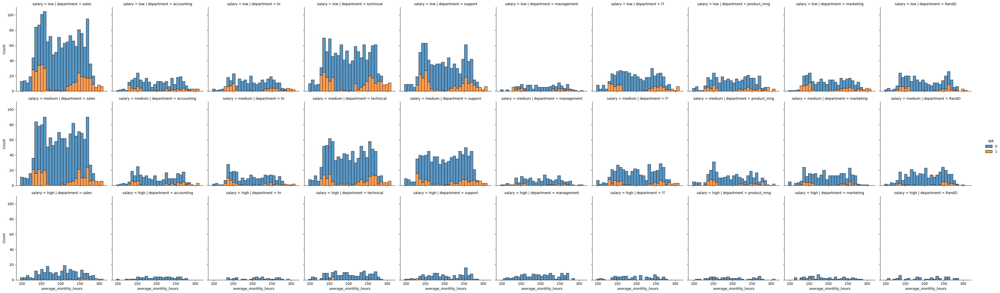

In [363]:
############################################
#average_monthly_hours by left
#keep department and salary constant
############################################
g=sns.displot(
    data=df_drop, x='average_monthly_hours',  hue='left',col="department",row='salary',
    kind="hist", height=4, aspect=1, multiple='stack',
    facet_kws=dict(sharex=True)
)
axes = g.fig.axes

plt.show()

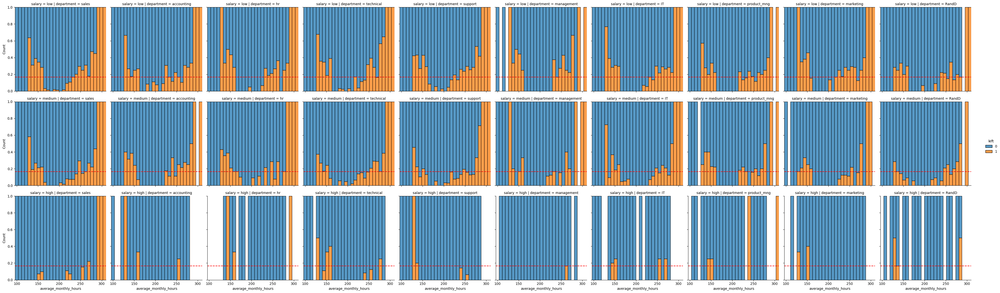

In [364]:
############################################
#average_monthly_hours by left
#keep department and salary constant
############################################
g=sns.displot(
    data=df_drop, x='average_monthly_hours',  hue='left',col="department",row='salary',
    kind="hist", height=4, aspect=1, multiple='fill',
    facet_kws=dict(sharex=True)
)
axes = g.fig.axes

total_left_ratio=(df_drop['left'].sum())/df_drop.shape[0]
for ax in axes:
    ax.axhline(total_left_ratio,color='red',linestyle='--')
plt.show()

#=>it seems when work hour is above 270/280 hours employees tend to leave no matter salary is low or high
#=>when work hour is not too high(e.g. above 280 hours), low and median salary tend to leave when work hour increase
#=>high salary didn't show this trend

#### Confirm `personal` leave

In [365]:
mask=df_drop['left']==1
df_drop[mask].describe(include='all')

,satisfaction_level,last_evaluation,number_project,average_monthly_hours,time_spend_company,work_accident,left,promotion_last_5years,department,salary,salary_encoding,emp_type,evaluation_range,average_monthly_hours_range,time_spend_company_range,left_group,left_type
count,1991.000000,1991.000000,1991.000000,1991.000000,1991.000000,1991.000000,1991.0,1991.000000,1991,1991,1991.000000,1991,1991,1991,1991,1991,1991
unique,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10,3,NaN,2,3,5,5,4,2
top,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,sales,low,NaN,full time,"(0.8,1]","(125,160]",3,group1,company
freq,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,550,1174,NaN,1125,961,866,874,829,1800
mean,0.440271,0.721783,3.883476,208.162230,3.881467,0.052737,1.0,0.004018,NaN,NaN,0.434455,NaN,NaN,NaN,NaN,NaN,NaN
std,0.265207,0.197436,1.817139,61.295145,0.974041,0.223565,0.0,0.063277,NaN,NaN,0.542281,NaN,NaN,NaN,NaN,NaN,NaN
min,0.090000,0.450000,2.000000,126.000000,2.000000,0.000000,1.0,0.000000,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN
25%,0.110000,0.520000,2.000000,146.000000,3.000000,0.000000,1.0,0.000000,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN
50%,0.410000,0.790000,4.000000,226.000000,4.000000,0.000000,1.0,0.000000,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN
75%,0.730000,0.910000,6.000000,262.500000,5.000000,0.000000,1.0,0.000000,NaN,NaN,1.000000,NaN,NaN,NaN,NaN,NaN,NaN


In [366]:
mask=df_drop['left_type']=='personal'
df_drop[mask].describe(include='all')

,satisfaction_level,last_evaluation,number_project,average_monthly_hours,time_spend_company,work_accident,left,promotion_last_5years,department,salary,salary_encoding,emp_type,evaluation_range,average_monthly_hours_range,time_spend_company_range,left_group,left_type
count,191.000000,191.000000,191.000000,191.000000,191.000000,191.000000,191.0,191.000000,191,191,191.000000,191,191,191,191,191,191
unique,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10,3,NaN,2,3,5,5,1,1
top,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,sales,low,NaN,full time,"(0.8,1]","(240,280]",4,others,personal
freq,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,48,116,NaN,146,79,46,54,191,191
mean,0.503351,0.744398,4.209424,214.157068,3.816754,0.062827,1.0,0.005236,NaN,NaN,0.418848,NaN,NaN,NaN,NaN,NaN,NaN
std,0.236655,0.166943,1.457509,54.733002,1.162091,0.243290,0.0,0.072357,NaN,NaN,0.545277,NaN,NaN,NaN,NaN,NaN,NaN
min,0.090000,0.450000,2.000000,128.000000,2.000000,0.000000,1.0,0.000000,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN
25%,0.310000,0.600000,3.000000,161.500000,3.000000,0.000000,1.0,0.000000,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN
50%,0.530000,0.750000,4.000000,216.000000,4.000000,0.000000,1.0,0.000000,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN
75%,0.700000,0.885000,5.000000,260.000000,5.000000,0.000000,1.0,0.000000,NaN,NaN,1.000000,NaN,NaN,NaN,NaN,NaN,NaN


In [367]:
def compute_personal_left(left_type):
    if left_type=='personal':
        result=1
    else:
        result=0
    return result
df_drop['personal_left']=df_drop['left_type'].apply(compute_personal_left)
df_drop.info()
df_drop.head(10)

<class 'pandas.core.frame.DataFrame'>
Index: 11991 entries, 0 to 11999
Data columns (total 18 columns):
 #   Column                       Non-Null Count  Dtype   
---  ------                       --------------  -----   
 0   satisfaction_level           11991 non-null  float64 
 1   last_evaluation              11991 non-null  float64 
 2   number_project               11991 non-null  int64   
 3   average_monthly_hours        11991 non-null  int64   
 4   time_spend_company           11991 non-null  int64   
 5   work_accident                11991 non-null  int64   
 6   left                         11991 non-null  int64   
 7   promotion_last_5years        11991 non-null  int64   
 8   department                   11991 non-null  object  
 9   salary                       11991 non-null  category
 10  salary_encoding              11991 non-null  int8    
 11  emp_type                     11991 non-null  object  
 12  evaluation_range             11991 non-null  category
 13  averag

,satisfaction_level,last_evaluation,number_project,average_monthly_hours,time_spend_company,work_accident,left,promotion_last_5years,department,salary,salary_encoding,emp_type,evaluation_range,average_monthly_hours_range,time_spend_company_range,left_group,left_type,personal_left
0,0.38,0.53,2,157,3,0,1,0,sales,low,0,part time,"(0.4,0.6]","(125,160]",3,group1,company,0
1,0.80,0.86,5,262,6,0,1,0,sales,medium,1,full time,"(0.8,1]","(240,280]",>=6,group3,company,0
2,0.11,0.88,7,272,4,0,1,0,sales,medium,1,full time,"(0.8,1]","(240,280]",4,group2,company,0
3,0.72,0.87,5,223,5,0,1,0,sales,low,0,full time,"(0.8,1]","(200,240]",5,group3,company,0
4,0.37,0.52,2,159,3,0,1,0,sales,low,0,part time,"(0.4,0.6]","(125,160]",3,group1,company,0
5,0.41,0.50,2,153,3,0,1,0,sales,low,0,part time,"(0.4,0.6]","(125,160]",3,group1,company,0
6,0.10,0.77,6,247,4,0,1,0,sales,low,0,full time,"(0.6,0.8]","(240,280]",4,group2,company,0
7,0.92,0.85,5,259,5,0,1,0,sales,low,0,full time,"(0.8,1]","(240,280]",5,group3,company,0
8,0.89,1.00,5,224,5,0,1,0,sales,low,0,full time,"(0.8,1]","(200,240]",5,group3,company,0
9,0.42,0.53,2,142,3,0,1,0,sales,low,0,part time,"(0.4,0.6]","(125,160]",3,group1,company,0


In [368]:
df_drop.head()

,satisfaction_level,last_evaluation,number_project,average_monthly_hours,time_spend_company,work_accident,left,promotion_last_5years,department,salary,salary_encoding,emp_type,evaluation_range,average_monthly_hours_range,time_spend_company_range,left_group,left_type,personal_left
0,0.38,0.53,2,157,3,0,1,0,sales,low,0,part time,"(0.4,0.6]","(125,160]",3,group1,company,0
1,0.80,0.86,5,262,6,0,1,0,sales,medium,1,full time,"(0.8,1]","(240,280]",>=6,group3,company,0
2,0.11,0.88,7,272,4,0,1,0,sales,medium,1,full time,"(0.8,1]","(240,280]",4,group2,company,0
3,0.72,0.87,5,223,5,0,1,0,sales,low,0,full time,"(0.8,1]","(200,240]",5,group3,company,0
4,0.37,0.52,2,159,3,0,1,0,sales,low,0,part time,"(0.4,0.6]","(125,160]",3,group1,company,0


### Insights of EDA

* Some typical departments like Manufacturing, Packaging, Qulity control, Supply Chain and Logistics , etc are not in this dataset, this dataset may not be representative
* Higher salary, lower left ratio
* Higher evaluation score, higher saatisfaction level
* Employees who left company had lower satisfaction level than employees who didn't leave
    * median satisfaction level of left employees 95% CI [0.4, 0.42], n=1991, std=0.265
    * mean satisfaction level of left employees 95% CI [0.43, 0.45], n=1991, std=0.265
    * median satisfaction level of not left employees 95% CI [0.68, 0.69], n=10000, std=0.217
    * mean satisfaction level of not left employees 95% CI [0.66, 0.67], n=10000, std=0.217
* Employees who left company had higher average monthly hours than employees who didn't leave
    * median average monthly hours of left employees 95% CI [219.0, 232.0], n=1991, std=61.295
    * mean average monthly hours of left employees 95% CI [205.48, 210.9], n=1991, std=61.295
    * median average monthly hours of not left employees 95% CI [197.0, 200.0], n=10000, std=45.666
    * mean average monthly hours of not left employees 95% CI [198.05, 199.83], n=10000, std=45.666
* More projects, higher average monthly hours
* Employees who had promotion in the last five years had higher median and high salary ratio
* Employees who had promotion in the last five years had lower left ratio
* Management department had higher median and high salary ratio
* Management department had higher average time_spend_company than other departments
* When work hour is above 287 hours, employess tend to leave no matter how much the salary it is
* When work hour is within a certain range, low and median salary tend to leave when work hour increase. However high salary didn't show this trend.
* This dataset may have different employment type.
* average_monthly_hours tend to increase from 2-5 years, 5 years was the peak.
* There were 4 groups(3 patterns and the other) amoung the left employees
    * Group1: low-middle average_monthly_hours, low-middle last_evaluation, low-middle satisfaction_level
        * 126<= average_monthly_hours <=161
        * 0.36<=satisfaction_level<=0.46
        * 0.45<=last_evaluation<=0.57
        * number_project=2
        * time_spend_company=3
    * Group2: high average_monthly_hours, high last_evaluation, low satisfaction_level
        * 243<= average_monthly_hours <=310
        * 0.09<=satisfaction_level<=0.11
        * 0.77<=last_evaluation<=0.98
        * number_project=5,6,7
        * time_spend_company=4,5
    * Group3: high average_monthly_hours, high last_evaluation, high satisfaction_level
        * 217<= average_monthly_hours <=276
        * 0.72<=satisfaction_level<=0.92
        * 0.81<=last_evaluation<=1
        * number_project=4,5
        * time_spend_company=5,6
    * Group4: employess who didn't belong to the above 3 groups
    * Group1, Group2, Group3(total 1800 employees) looks like rectangles in some case, it might indicate lay off, data fraud or not randomly sampled data or not independent data(e.g. share survey results with other employees).
    * All departments appeared to have the same patterns, Group2 and Group3 had high evaluation score, if this dataset is a representative random sampled data it might due to restructuring/reduce cost. 
    * Group4 looks randomly spread, they might be personal leave.

In [369]:
#Save cleaned data
display(df_drop.info())
df_drop.to_csv('employee_data_clean.csv', index=False)

<class 'pandas.core.frame.DataFrame'>
Index: 11991 entries, 0 to 11999
Data columns (total 18 columns):
 #   Column                       Non-Null Count  Dtype   
---  ------                       --------------  -----   
 0   satisfaction_level           11991 non-null  float64 
 1   last_evaluation              11991 non-null  float64 
 2   number_project               11991 non-null  int64   
 3   average_monthly_hours        11991 non-null  int64   
 4   time_spend_company           11991 non-null  int64   
 5   work_accident                11991 non-null  int64   
 6   left                         11991 non-null  int64   
 7   promotion_last_5years        11991 non-null  int64   
 8   department                   11991 non-null  object  
 9   salary                       11991 non-null  category
 10  salary_encoding              11991 non-null  int8    
 11  emp_type                     11991 non-null  object  
 12  evaluation_range             11991 non-null  category
 13  averag

None